<a href="https://colab.research.google.com/github/Deepu1992/VideoClassification/blob/master/Model_VGG_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#SETUP AND CONFIGURATION

##TURN SECTIONS ON/OFF

In [ ]:
MOUNT_GDRIVE         = True
CHECK_GPU_INFO       = False
DOWNLOAD_VIDEOS      = False
FOLDER               = 'mini'

#ROI EXTRACTION
DO_TEST_TRAIN_SPLIT  = False
EXTRACT_ROI          = False

#FEATURE EXTRACTION
EXTRACT_FEATURES     = False

#MODEL TRAINING
TRAIN_MODEL          = True
CONTINUE_TRAINING    = False

##PARAMETER DEFINITION

In [ ]:
#ROI EXTRACTION
ROI_ROT              = False 
ERASE_ROI_COLOUR     = False  


#FEATURE EXTRACTION
DEPTH_OF_BASE        = 18  # > 18 means use full network
DEPTH_OF_BASE        = min(DEPTH_OF_BASE,18)
RESIZE_SHAPE         = (70, 70, 3)
TRAIN_STREAM_SIZE    = 1200
TEST_STREAM_SIZE     = 600
PREPROCESS           = True #turn on keras library preprocessing

#MODEL TRAINING
MODEL_VERSION        =  "MODEL_V101_"
MINI_BATCH_SIZE      =  100
LEARNING_RATE        =  .001
#KEEP_POOLING_LAYERS  =  True
WEIGHT_BY_FRAME      =  False 
CLASS_WTS            =  {0: 2, 1: 98}
FRAME_SUBSET_TYPE    =  'last_n' #['last_n_subset','last_n','random',
                                        #'even_spaced', 'random_subsection']
MIN_FRAME_COUNT      =  30 #Videos less than this threshold are not used for training.
EPOCH_PER_SET        =  10
VALIDATION_SIZE      =  .99
GLOBAL_ITER          =  40 
FIT_1_SAMPLE         =  False
MINI_BATCH_ITERATION =  False


EARLY_STOP_PATIENCE       =   10
RESTORE_BEST_WEIGHTS      =   False
LSTM_L1_REGULARIZATION    =  0#.0001
LSTM_L2_REGULARIZATION    =  0#.0001
L1_REGULARIZATION         = .00001
L2_REGULARIZATION         = .00001
assert not(MINI_BATCH_ITERATION and FIT_1_SAMPLE)

##CHECK GPU USAGE

In [ ]:
if CHECK_GPU_INFO:
    # memory footprint support libraries/code
    !ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
    !pip install gputil
    !pip install psutil
    !pip install humanize
    import psutil
    import humanize
    import os
    import GPUtil as GPU
    GPUs = GPU.getGPUs()
    # XXX: only one GPU on Colab and isn’t guaranteed
    gpu = GPUs[0]
    def printm():
      process = psutil.Process(os.getpid())
      print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
      print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
    printm() 

    #!cat /proc/meminfo
    #!cat /proc/cpuinfo

##MOUNT GOOGLE DRIVE

In [ ]:
if MOUNT_GDRIVE:
  from google.colab import drive 
  drive.mount('/content/gdrive') 

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


##PATH VARIABLES DEFINITION


In [ ]:
from os import mkdir
from os.path import isdir

#define paths
PATH_PROJ = "/content/gdrive/My Drive/Google Colab Data/StallCatcher/"
PATH_ROOT = PATH_PROJ + "{}/".format(FOLDER)
VIDEO_FILES_PATH =  PATH_ROOT + "VIDEO_FOLDER/"                   #PATH TO VIDEO FILES IN GDRIVE

#TRAIN_TEST_LABEL_INFO
PATH_TRAIN_TEST_LABEL = PATH_ROOT + "TRAIN_TEST_METADATA/" +  'TRAIN_TEST_SPLIT.csv'

#ROI
roi_rot   = ("ROI{}_rotated/"  if ROI_ROT else "ROI{}/")
roi_erase = roi_rot.format('_ERASED' if ERASE_ROI_COLOUR else '')
ROI_PATH = PATH_ROOT + "ROI_FOLDER/" + roi_erase                #PATH TO ROI DATA
if not isdir(ROI_PATH):
  mkdir(ROI_PATH)
  mkdir(ROI_PATH+"train/")
  mkdir(ROI_PATH+"test/")
  mkdir(ROI_PATH+"images/")
  print("Folder" , ROI_PATH , "and subfolders created")
PATH_ROI_PROCESS_LOGGER = ROI_PATH  + 'ROI_PROCESS_LOGGER.csv'


FEATURE_USED = "features_depth_{}_{}_{}/".format(DEPTH_OF_BASE,roi_erase[:-1],RESIZE_SHAPE[0])
if PREPROCESS:
   FEATURE_USED = FEATURE_USED[:-1] + "_P/"

FEATURE_PATH = PATH_ROOT  + "FEATURE_FOLDER/" + FEATURE_USED #PATH TO FEATURES EXTRACTED FROM ROI
#FEATURE_PATH = PATH_ROOT + "FEATURE_FOLDER/" + 'extracted_features_full_depth/'
if not isdir(FEATURE_PATH):
  mkdir(FEATURE_PATH)
  mkdir(FEATURE_PATH+"train/")
  mkdir(FEATURE_PATH+"test/")
  print("Folder" , FEATURE_PATH , "created")
PATH_FEATURE_PROCESS_LOGGER = FEATURE_PATH  + 'VGG_FEATURE_PROCESS_LOGGER.csv'

MODEL_FOLDER = PATH_ROOT + "MODEL_FOLDER/"
UTILS_PATH = "/content/gdrive/My Drive/Colab Notebooks/StallCatcher/"
LOGS_DIR = MODEL_FOLDER + "logs/fit/"


#define filenames
METADATA_FILENAME = PATH_ROOT + 'train_metadata_{}.csv'.format(FOLDER) #FILES LISTED WILL BE USED FOR TRAINING AND VALIDATION
LABELS_FILENAME   = PATH_PROJ + 'train_labels.csv'

MODEL_SUB_FODLER  = MODEL_FOLDER + MODEL_VERSION[:-1] + "/"
MODEL_FILENAME    = MODEL_SUB_FODLER + MODEL_VERSION
BEST_MODEL_FILE   = MODEL_SUB_FODLER + 'MODEL_BEST'

if not isdir(MODEL_SUB_FODLER):
  mkdir(MODEL_SUB_FODLER)
  print("Folder" , MODEL_SUB_FODLER , "created")

MODEL_RESULTS     = MODEL_SUB_FODLER + "MODEL_RESULTS/"
HYP_PARAM_FILE    = MODEL_RESULTS + 'MODEL_SETTING_HYPER_PARAM.csv'

if not isdir(MODEL_RESULTS):
  mkdir(MODEL_RESULTS)
  print("Folder", MODEL_RESULTS , "created")

for i in ['PERFORMANCE', 'MCC', 'LOSS_GRAPH', 'ACC_GRAPH', 'MCC_GRAPH','OUT_HIST']:
      if not isdir(MODEL_RESULTS + i):
        mkdir(MODEL_RESULTS + i)
        print("Folder", MODEL_RESULTS + i , "created")

#RESULTS FORMATS
PERF_FILE_FORMAT  = MODEL_RESULTS + "PERFORMANCE/" + "Perf_"
MODEL_PERF_FILE   = PERF_FILE_FORMAT + MODEL_VERSION + "{}.csv"

MODEL_MCC_FORMAT     = MODEL_RESULTS + "MCC/" + MODEL_VERSION + "{}.csv"
LOSS_IMAGE_NAME      = MODEL_RESULTS + "LOSS_GRAPH/" + MODEL_VERSION + "{}.jpeg"
ACC_IMAGE_NAME       = MODEL_RESULTS + "ACC_GRAPH/"  + MODEL_VERSION + "{}.jpeg"
MCC_IMAGE_NAME       = MODEL_RESULTS + "MCC_GRAPH/"  + MODEL_VERSION + "{}.jpeg"
OUT_DIST_IMAGE_NAME  = MODEL_RESULTS + "OUT_HIST/"   + MODEL_VERSION + "{}.jpeg"
CONFUSION_MAT_PATH   = MODEL_RESULTS + "CONFUSION_MAT.csv" 

##IMPORT LIBRARIES

In [ ]:
import pandas as pd
import os
import h5py
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import datetime
import warnings
import regex as re
from math import ceil

#warnings.filterwarnings('ignore') #u

from tensorflow.keras import models,layers,optimizers,losses
from tensorflow.keras.applications import VGG16
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.layers import LSTM, Input, Flatten
from tensorflow.keras.regularizers import L1L2
from random import shuffle
from sklearn.metrics import confusion_matrix,matthews_corrcoef
from tqdm.notebook import tqdm
from time import sleep
from skimage.transform import resize   # for resizing images
from os import listdir
from os.path import isfile, join
from sklearn.model_selection import train_test_split
from random import sample,choice,randint

#check if running on GPU
if tf.test.gpu_device_name() == '/device:GPU:0':
  print("Tensorflow GPU Loaded") 

Tensorflow GPU Loaded


##LOAD USER DEFINED FUNCTIONS

In [ ]:
if False:
  import sys
  sys.path.append(UTILS_PATH)
  from utilities import extract_roi_and_store_tensors

##LOAD METADATA

In [ ]:
train_metadata = pd.read_csv( METADATA_FILENAME)
list_of_files = list(train_metadata.filename)
train_metadata.set_index('filename',inplace = True)

#DOWNLOADING AND PREPROCESSING

##DOWNLOAD VIDEOS

In [ ]:
if DOWNLOAD_VIDEOS :
  #import library to interact with s3
  import boto3

  #setup s3 access
  s3r = boto3.resource('s3',
                      aws_access_key_id='',
                      aws_secret_access_key= '')
  buck = s3r.Bucket('drivendata-competition-clog-loss')

  failed = []
  
  already_downloaded_files = [f for f in listdir(VIDEO_FILES_PATH) if isfile(join(VIDEO_FILES_PATH, f))]
  videos_to_download = set.difference(set(list_of_files),set(already_downloaded_files)) 

  for f in tqdm(videos_to_download, position=0, leave=True):
      try:
        s3_path_of_video = "train/" + f
        buck.download_file(s3_path_of_video,VIDEO_FILES_PATH + f) 
      except:
        print("Failed - ", f)
        failed.append(f)
        print(".", sep = "", end = "")
  if len(failed) > 0:
    print(str(len(failed)) + " files failed to load." )

## ROI FUNCTIONS

In [ ]:
def get_roi(frame, save = False, path = ''):
    
    #get orange coloured cells as 255 and rest as 0                                                                                                                                    
    th = cv2.inRange(frame, (0, 13, 104), (98, 143, 255))  

    #return row and column indices of orange cells                                                                                             
    points = np.where(th>0)            
    if ERASE_ROI_COLOUR:
      frame[points] = 0
    #get coordinates                                                                                                                                  
    p2 = zip(points[0], points[1])                                                                                                                                       
    p2 = [p for p in p2]               

    #get bounding box                                                                                                                                  
    rect = cv2.boundingRect(np.float32(p2))
    
    #get rectangle
    row_min,row_max,col_min,col_max = rect[0],rect[0]+rect[2],rect[1],rect[1]+rect[3]

    roi = frame[row_min:row_max,col_min:col_max,:]  
  
    if save:
        #cv2.imshow("short", roi)                                                                                                                                                  
        #cv2.waitKey(1000)            
        #cv2.destroyAllWindows()
        cv2.imwrite(path, roi)
        print(".",end = "")
    return roi

In [ ]:
def extract_roi_and_store_tensors(filenames_list, 
                                  sample_type,
                                  roi_path, 
                                  video_path, 
                                  batch_size = 1000,
                                  start_at = None,
                                  submission = False):

    print("Extracting ROI and loading to ", sample_type, "\n")
    sleep(1)

    roi_log_path = PATH_SUB_ROI_PROCESS_LOGGER if submission else PATH_ROI_PROCESS_LOGGER

    #sub function to log roi progress
    def log_progress(batch_success_files, h5_file_count):
              #update logger
              logger = pd.read_csv(roi_log_path, index_col= 0)
              logger.loc[batch_success_files,'ROI_PROCESSED'] = True
              logger.loc[batch_success_files,'ROI_FILENAME'] = sample_type + str(h5_file_count) + '.h5'
              logger.to_csv(roi_log_path, index = True)

    #check if any files are already processed and remove them
    logger = pd.read_csv(roi_log_path, index_col= 0)
    if any(logger.loc[filenames_list,'ROI_PROCESSED'].to_list()):
              sub = logger.loc[filenames_list]
              dup = sub[sub.ROI_PROCESSED]
              print("Avoiding files already processed: ", dup.index.to_list())
              filenames_list = sub[~sub.ROI_PROCESSED].index.to_list()

              if len(filenames_list) == 0:
                print("All files are already processed")
                return

    assert len(filenames_list) > 0
    
    print("Number of files to be processed: ", len(filenames_list))

    #path to save roi
    temp_path = roi_path + sample_type + "/" + sample_type
    
    #h5 file id
    batch_success_files = []    
    if start_at is None: #auto determine if left as none

        logger   = pd.read_csv(roi_log_path, index_col= 0)

        st    = logger[logger.sample_type == sample_type]
        used  = st[st.ROI_FILENAME != 'NOT_AVAILABLE']

        if used.shape[0] > 0:
          last_file  = max([ int((re.findall('\d+', s ))[0]) for s in used.ROI_FILENAME])
          start_at = last_file + 1
        else:
          start_at = 0
    
    #id of the file file to be written
    h5_file_count = start_at      

    #file writer object
    h5f   = h5py.File( temp_path + str(h5_file_count) + '.h5', 'w')    
    ind = 0

    print("Files Saved: ")
    for videoFile in tqdm(filenames_list):               
        

        #initiate next batch
        if ind%batch_size == 0 and ind != 0:
           print(sample_type+str(h5_file_count), end = " | ")
           
           h5f.close()

           #log progress
           log_progress(batch_success_files, h5_file_count)

           #refresh list
           batch_success_files =  []

           h5_file_count       += 1
           h5f                 =  h5py.File(temp_path + str(h5_file_count) + '.h5', 'w')        
        
        #update iteration count
        ind += 1

        #id image
        count = 0    
        
        #full video path
        video_input_path = video_path + videoFile
        
        # read video
        cap = cv2.VideoCapture(video_input_path)           
        
        #number of frames
        n_frame = int(cap.get(7))

        #to get shape of tensor
        do_once = True

        while(cap.isOpened()):
            #frameId = cap.get(1)
            ret, frame = cap.read()
            if (ret == False):
                break
           
            if True: #sample frame here if required using frameId
                
                #subset roi from image
                if ROI_ROT:
                  roi = get_ROI_inclined_rect(frame)
                else:
                  imname = ROI_PATH+"images/" + videoFile.split('.')[0] + '.jpg'
                  roi = get_roi(frame, save = do_once, path = imname)

                if do_once:
                  #placeholder to store roi frames
                  h,w,c = roi.shape
                  roi_tensor = np.zeros((n_frame, h,w,c)) 
                  do_once = False 
                  

                if roi.shape[0] != h or roi.shape[1] != w:
                  roi = resize(roi, (h, w), 
                           preserve_range = True,
                           anti_aliasing=False) 

                #write image
                roi_tensor[count] = roi

                #update counter
                count+=1

        if not do_once:
                #normalize and save
                h5f.create_dataset(videoFile, data= roi_tensor)                      
                
                #release cap object
                cap.release()

                #append filename to success list
                batch_success_files.append(videoFile)

    print(sample_type+str(h5_file_count), end = " | ")
    h5f.close()      
    log_progress(batch_success_files, h5_file_count)
    sleep(1)

## TRAIN_TEST_SPLIT

In [ ]:
if EXTRACT_ROI  and DO_TEST_TRAIN_SPLIT:
    #get list of video files available   
    video_filenames  = list(train_metadata.index)

    #split test train
    train,test = train_test_split(video_filenames,test_size = 0.15) #-- run only during project setup
    
    #mark all undecided 
    TEST_TRAIN_SPLIT                = train_metadata
    TEST_TRAIN_SPLIT['sample_type'] = 'UNDECIDED'

    TEST_TRAIN_SPLIT.loc[train,'sample_type'] = 'train'
    TEST_TRAIN_SPLIT.loc[test ,'sample_type'] = 'test'

    #save to disk
    TEST_TRAIN_SPLIT.to_csv(PATH_TRAIN_TEST_LABEL, index = True)

    #ROI PROCESS LOGGER
    TEST_TRAIN_SPLIT['ROI_PROCESSED'] = False
    TEST_TRAIN_SPLIT['ROI_FILENAME'] = 'NOT_AVAILABLE'
    TEST_TRAIN_SPLIT.to_csv(PATH_ROI_PROCESS_LOGGER, index = True)

    DO_TEST_TRAIN_SPLIT = False
    print("TEST_TRAIN_SPLIT uploaded")

##EXTRACT ROI 

In [ ]:
if EXTRACT_ROI and (not DO_TEST_TRAIN_SPLIT):

    #read roi log file and remove already processed files
    logger        = pd.read_csv(PATH_ROI_PROCESS_LOGGER, index_col= 0)
    logger        = logger[~logger.ROI_PROCESSED]

    #files yet to be processed
    train         = logger[logger.sample_type == 'train'].index.tolist()
    test          = logger[logger.sample_type == 'test'].index.tolist()
         
 
    if len(test) > 0:
      
      #extract roi and save for train and test   
      extract_roi_and_store_tensors(filenames_list = test,  
                                      sample_type = 'test', 
                                      roi_path     = ROI_PATH, 
                                      video_path   = VIDEO_FILES_PATH,
                                      batch_size   = TEST_STREAM_SIZE)
    else:
      print("Test file already ROI processed")
  
    if len(train)> 0:
      extract_roi_and_store_tensors(filenames_list = train, 
                                    sample_type    = 'train', 
                                    roi_path       = ROI_PATH, 
                                    video_path     = VIDEO_FILES_PATH,
                                    batch_size     = TRAIN_STREAM_SIZE)
    else:
      print("Train file already ROI processed")

## FEATURE EXTRACTION FUNCTIONS

In [ ]:
#sub function to log roi progress
def log_feature_batch(files, h5_file_name = "FAILED",submission = False):
          #""" record success or failure of a batch """

          feat_log_path= PATH_SUB_FEATURE_PROCESS_LOGGER if submission else PATH_FEATURE_PROCESS_LOGGER

          #update logger
          logger = pd.read_csv(feat_log_path, index_col = 0)  
          logger.loc[files,'FEATURE_FILENAME']  = h5_file_name
          logger.to_csv(feat_log_path, index    = True)

#sub function to log succes/failure of roi to feature convertion
def log_feature_sample(files, feature_processed,submission = False):

          feat_log_path= PATH_SUB_FEATURE_PROCESS_LOGGER if submission else PATH_FEATURE_PROCESS_LOGGER

          #update logger
          logger = pd.read_csv(feat_log_path, index_col = 0)              
          logger.loc[files,'FEATURE_PROCESSED']               = feature_processed              
          logger.to_csv(feat_log_path, index    = True)


def extract_features(roi_files,
                     conv_base,
                     sample_type, 
                     roi_path, 
                     feature_path,
                     flatten_features = False,
                     resize_to_shape =  (100,100,3),
                     batch_size = 200,
                     start_at = None,
                     submission = False):
  
    feat_log_path= PATH_SUB_FEATURE_PROCESS_LOGGER if submission else PATH_FEATURE_PROCESS_LOGGER

    if start_at is None: #auto determine if left as none

        logger   = pd.read_csv(feat_log_path, index_col= 0)

        st    = logger[logger.sample_type == sample_type]
        used  = st[st.FEATURE_FILENAME != 'NOT_AVAILABLE']

        if used.shape[0] > 0:
          files_used = [i for i in used.FEATURE_FILENAME.unique() if sample_type in i]
          last_file  = max([ int((re.findall('\d+', s ))[0]) for s in files_used])
          start_at = last_file + 1
         
        else:
          start_at = 0


    #TRAIN/TEST folder in ROI folder
    input_folder_path = roi_path + sample_type + "/"
    
    #TRAIN/TEST folder in FEATURE folder
    output_folder_path = feature_path + sample_type + "/"
    
    failed_roi_files    = []
    failed_samples      = []

    print(f"\n\nRunning feature extraction on {sample_type} ROI tensors")
    sleep(1)
        
    #print_format = "Processing batch {}/" + str(len(roi_files))

    #path to save roi
    temp_path = feature_path + sample_type + "/" + sample_type

    #h5 file id
    write_file_count = start_at
    feature_write   = h5py.File( temp_path + str(write_file_count) + '.h5', 'w')
    
    samples_processed = 0

    for roi_file_name in tqdm(roi_files):

            #print(print_format.format(batch+1)) #(enumerate on roi_file for batch value)
            #if True:
            try:       
                #create h5py read object for roi data
                if 'roi_read' in locals():
                  roi_read.close()
                roi_read = h5py.File(input_folder_path  + roi_file_name,'r')
            
                #get video files in object
                shortFiles = []
                dirFILES   = []

                files_in_obj = list(roi_read.keys())
                logger_ = pd.read_csv(feat_log_path, index_col = 0)    
                logger_ = logger_.loc[files_in_obj]
                na_files = logger_[logger_.FEATURE_FILENAME == 'NOT_AVAILABLE'].index
                del logger_

                if not submission:
                  for i in na_files:
                    if train_metadata.loc[i, 'num_frames'] >= MIN_FRAME_COUNT:
                      dirFILES.append(i)
                    else:
                      shortFiles.append(i)

                  #records files discarded due to  FRAME_COUNT < MIN_FRAME_COUNT
                  log_feature_sample(shortFiles, 
                                      feature_processed = 'INADEQUATE_FRAME_COUNT',
                                      submission = submission) 
                else:
                  dirFILES = files_in_obj
                  shortFiles = []         
                
                
                for file_ in dirFILES:

                    #initiate next batch
                    if samples_processed%batch_size == 0 and samples_processed != 0:
                      
                      #name of successfully processed feature file
                      success_file_name = sample_type + str(write_file_count) + '.h5'
                      print(success_file_name , end = " | ")

                      #log success of feature batch
                      files = list(feature_write.keys())
                      log_feature_batch(files, 
                                        h5_file_name = success_file_name,
                                        submission = submission)

                      #close writer
                      feature_write.close()
                      
                      #update feature filename and open feature file writer
                      write_file_count +=1
                      feature_write = h5py.File(temp_path + str(write_file_count) + '.h5', 'w')  

                    try:
                        #read roi
                        roi_tensor = roi_read[file_][:]

                        if submission and roi_tensor.shape[0] < MIN_FRAME_COUNT:
                          shortFiles.append(file_)

                        else:
                          roi_tensor = roi_tensor[-MIN_FRAME_COUNT:]
                          #resize_value will hold the resized frames of the roi tensor
                          resized_tensor = np.zeros((MIN_FRAME_COUNT, resize_to_shape[0],
                                                  resize_to_shape[1],resize_to_shape[2]))
                          
                          for frame in range(roi_tensor.shape[0]):

                              if PREPROCESS:
                                image_ = preprocess_input(roi_tensor[frame])
                              else:
                                image_ = roi_tensor[frame]

                              #resize    
                              resized_tensor[frame] = resize(image_,
                                                  resize_to_shape, 
                                                  preserve_range = True,
                                                  anti_aliasing=False)  
                              
                          #apply pre trained model on roi frame of sample            
                          feature = conv_base.predict(np.array(resized_tensor))
             
                          #reshape to (n_frames, 3*3*512)
                          if flatten_features:
                            OUT_SIZE = np.product(feature.shape[1:])
                            feature = feature.reshape(feature.shape[0], OUT_SIZE)


                          feature_write.create_dataset(file_, data= feature)   
                          samples_processed += 1
                          print(".",end = "")
                    except Exception as e:
                          failed_samples.append(file_)   
                          print("-fail-",str(e),end = "")
                          print(1/0)

                #failed files
                log_feature_sample(failed_samples, feature_processed = "FAILED",
                      submission = submission)

                #successfully processed files
                proc = [i for i in dirFILES if i not in failed_samples]
                log_feature_sample(proc, feature_processed = "SUCCESS",submission = submission)


                #close roi read object                
                roi_read.close()
            #else:   
            except:
              failed_roi_files.append(roi_file_name)
              print("roi ", roi_file_name , "failed", end = " | ")
              logger = pd.read_csv(feat_log_path, index_col = 0) 
              logger.loc[logger.ROI_FILENAME == roi_file_name,'FEATURE_FILENAME']   =  'ROI_READ_FAIL'
              logger.loc[logger.ROI_FILENAME == roi_file_name,'FEATURE_PROCESSED']  =  'ROI_READ_FAIL'
              logger.to_csv(feat_log_path, index  = True)

 
    #name of successfully processed feature file
    success_file_name = sample_type + str(write_file_count) + '.h5'
    print(success_file_name , end = " | ")

    #log success of feature batch
    files = list(feature_write.keys())
    log_feature_batch(files, 
                      h5_file_name = success_file_name,
                      submission = submission)
                      
    #close last feature write file
    feature_write.close()

    return failed_samples,failed_roi_files,OUT_SIZE

##EXTRACT FEATURES 

In [ ]:
if EXTRACT_FEATURES:
    #READ FEATURE LOGGER
    try:
      FEATURE_PROCESS_LOGGER = pd.read_csv(PATH_FEATURE_PROCESS_LOGGER, 
                                           index_col = 0)
      
      #refresh ROI_PROCESSED INFORMATION
      roi_log         = pd.read_csv(PATH_ROI_PROCESS_LOGGER, index_col= 0)
      cols_to_refresh = ['ROI_PROCESSED','ROI_FILENAME']
      FEATURE_PROCESS_LOGGER.drop(columns=cols_to_refresh, inplace = True)
      FEATURE_PROCESS_LOGGER = pd.merge(FEATURE_PROCESS_LOGGER,roi_log[cols_to_refresh],
                                        on = 'filename', 
                                        validate = 'one_to_one')


      print("Loaded FEATURE_PROCESS_LOGGER")

    except FileNotFoundError:
      print("No FEATURE_PROCESS_LOGGER available. Creating new one..")

      #create feature logger from ROI logger
      FEATURE_PROCESS_LOGGER                      = pd.read_csv(PATH_ROI_PROCESS_LOGGER, index_col= 0)

      FEATURE_PROCESS_LOGGER['FEATURE_PROCESSED'] = 'UNATTEMPTED'  #False refers to unattempted files
      FEATURE_PROCESS_LOGGER['FEATURE_FILENAME']  = 'NOT_AVAILABLE'

      #save to disk
      FEATURE_PROCESS_LOGGER.to_csv(PATH_FEATURE_PROCESS_LOGGER, index = True)


    #find unprocessed files
    unattempted            = FEATURE_PROCESS_LOGGER[FEATURE_PROCESS_LOGGER.FEATURE_PROCESSED == 'UNATTEMPTED']

    #find records with ROI available
    unattempted            = unattempted[unattempted.ROI_PROCESSED]

    #get train and test ROI FILENAMES
    train = unattempted[unattempted.sample_type == 'train'].ROI_FILENAME.unique().tolist()
    test  = unattempted[unattempted.sample_type == 'test' ].ROI_FILENAME.unique().tolist()


In [ ]:
if EXTRACT_FEATURES:

    #load model
    conv_base = VGG16(weights='imagenet', include_top=False,input_shape=RESIZE_SHAPE)

    #conv_base.summary()
    #ith layer is the last layer of an output shape
    base_depth_options = [i for i,str_ in enumerate(conv_base.layers) if 'MaxPooling2D' in str(str_)]
    print("Depth of base options: ", base_depth_options)
    sleep(1)

    #extract first few layers
    shallow_base = models.Sequential(conv_base.layers[:DEPTH_OF_BASE+1])


    if len(test)>0:
        print(f"Processing {len(test)} test files")
        #extract feature for train,test   
        omitted_test_files,unread_roi_test,________  = extract_features(        
                        roi_files        = test,
                        conv_base        = shallow_base,
                        sample_type      = 'test', 
                        roi_path         = ROI_PATH, 
                        feature_path     = FEATURE_PATH,
                        flatten_features = True,
                        resize_to_shape  = RESIZE_SHAPE,
                        batch_size       = TEST_STREAM_SIZE,
                        start_at         = None,
                        submission       = False)
    else:
         print("Test files are already processed")

    sleep(1)
    if len(train) > 0:
      print(f"Processing {len(train)} train files")
      omitted_train_files,unread_roi_trian,OUT_SIZE = extract_features( 
                      roi_files        = train,
                      conv_base        = shallow_base,
                      sample_type      = 'train', 
                      roi_path         = ROI_PATH, 
                      feature_path     = FEATURE_PATH,
                      flatten_features = True,
                      resize_to_shape  = RESIZE_SHAPE,
                      batch_size       = TRAIN_STREAM_SIZE,
                      start_at         = None,
                      submission       = False)
    else:
        print("Train files are already processed")

#MODEL TRAINING

##SETUP TENSORBOARD

In [ ]:
# Load the TensorBoard notebook extension
#%load_ext tensorboard

In [ ]:
# Clear any logs from previous runs
#!rm -rf ./logs/ 

##MODEL ARCHITECTURE

In [ ]:
def get_OUT_SIZE():
      ######TEST##########
      sample_type  = 'test'
      sub_path     = FEATURE_PATH + sample_type + "/"
      options      = [f for f in listdir(sub_path) if isfile(join(sub_path, f))]
      feature_read = h5py.File(sub_path + options[0],'r')
      for key,value in feature_read.items():
          value = value[:]
          break
      feature_read.close()
      return np.product(value.shape[1:])

In [ ]:
if TRAIN_MODEL:
    es = EarlyStopping(monitor='val_loss', mode='min', 
                       verbose=1, patience=EARLY_STOP_PATIENCE,
                       restore_best_weights      =RESTORE_BEST_WEIGHTS)
    if 'OUT_SIZE' in globals() or 'OUT_SIZE' in locals():
      pass
    else:
        OUT_SIZE = get_OUT_SIZE() #or manually enter value
        print("OUT_SIZE of conv base" , OUT_SIZE)
    if CONTINUE_TRAINING:
        models_available = [f for f in listdir(MODEL_SUB_FODLER) if f.startswith(MODEL_VERSION)]
        models_keys      = [s.split('_')[2:] for s in models_available]
        models_keys      = sorted(models_keys, key = lambda k: (int(k[0]),int(k[1]),int(k[2]))) 
        latest_model     = models_keys[-1]
        model_name       = MODEL_VERSION + '_'.join(latest_model)
        model            = models.load_model(MODEL_SUB_FODLER +model_name)
        print("Successfully loaded model ", model_name)
    else:
        #os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' #turn off warnings  
        tf.get_logger().setLevel('INFO')

        #load pretrained keras model
        conv_base = VGG16(weights='imagenet', include_top=False,input_shape=RESIZE_SHAPE)
        
        for layer in conv_base.layers:
          layers.trainable = False
          
        #define model architecture
        #model = models.Sequential(conv_base.layers[DEPTH_OF_BASE:])
        #model.add(Flatten())

        model = models.Sequential()

        if FIT_1_SAMPLE:
           model.add(LSTM(1000, input_shape = (None,OUT_SIZE),                    
                              kernel_initializer='glorot_uniform',          
                              kernel_regularizer=L1L2(l1=LSTM_L1_REGULARIZATION,
                                                      l2=LSTM_L2_REGULARIZATION),
                              name = "1_LSTM"))         
        else:
          model.add(LSTM(1000, input_shape = (MIN_FRAME_COUNT,OUT_SIZE),                    
                              kernel_initializer='glorot_uniform',
                              kernel_regularizer=L1L2(l1=LSTM_L1_REGULARIZATION,
                                                      l2=LSTM_L2_REGULARIZATION),
                              name = "1_LSTM"))
        
        model.add(layers.Dense(128, activation='relu',                                                   
                               kernel_initializer='glorot_uniform',
                               kernel_regularizer=L1L2(l1=L1_REGULARIZATION,
                                                      l2=L2_REGULARIZATION),
                               name = "2_Dense"))
        
        model.add(layers.Dropout(0.5, name = "3_Dropout"))

        model.add(layers.Dense(32, activation='relu',                                                   
                               kernel_initializer='glorot_uniform',
                               kernel_regularizer=L1L2(l1=L1_REGULARIZATION,
                                                      l2=L2_REGULARIZATION),
                               name = "4_Dense"))
        
        model.add(layers.Dropout(0.5, name = "5_Dropout"))

        model.add(layers.Dense(1, activation='sigmoid',                                                   
                               kernel_initializer='glorot_uniform',
                               kernel_regularizer=L1L2(l1=L1_REGULARIZATION,
                                                      l2=L2_REGULARIZATION),
                               name = "6_Dense"))
        
        model.compile(optimizer=optimizers.Adam(learning_rate=LEARNING_RATE),
                                                      loss='binary_crossentropy',
                                                      metrics=['acc'])
    model.summary()

OUT_SIZE of conv base 2048
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
1_LSTM (LSTM)                (None, 1000)              12196000  
_________________________________________________________________
2_Dense (Dense)              (None, 128)               128128    
_________________________________________________________________
3_Dropout (Dropout)          (None, 128)               0         
_________________________________________________________________
4_Dense (Dense)              (None, 32)                4128      
_________________________________________________________________
5_Dropout (Dropout)          (None, 32)                0         
_________________________________________________________________
6_Dense (Dense)              (None, 1)                 33        
Total params: 12,328,289
Trainable params: 12,328,289
Non-trainable params: 0
_________________

In [ ]:
tf.initializers.GlorotNormal()

##FUNCTION TO LOAD DATA

In [ ]:
if TRAIN_MODEL:    
    
    sub_path = FEATURE_PATH + 'train' + "/"
    train_options = [f for f in listdir(sub_path) if isfile(join(sub_path, f))]

    #load label dataframe      
    DF_LABEL = pd.read_csv(LABELS_FILENAME)      
    DF_LABEL.set_index('filename', inplace = True)
     
    def load_data(choice_train_set, test_prop = .3):

      #fetch train,test  features

      ######TEST##########
      sample_type  = 'test'
      sub_path     = FEATURE_PATH + sample_type + "/"
      options      = [f for f in listdir(sub_path) if isfile(join(sub_path, f))]
      feature_read = h5py.File(sub_path + choice(options),'r')
      
      test           = list(feature_read.keys())      
      test           = [i for i in test if i in train_metadata.index]

      #min_ = int(test_prop*len(test)) 
      #test = sample(test,min_) #sample down
      test_features = [feature_read[key][:] for key in test]

      #get wts
      test_min_rec   = min([i.shape[0] for i in test_features])
      test_wts = (test_min_rec/train_metadata.loc[test,'num_frames']).values
      feature_read.close()
      print("Test features loaded")


      ######TRAIN##########
      sample_type = 'train'
      sub_path     = FEATURE_PATH + sample_type + "/"
      feature_read = h5py.File(sub_path + choice_train_set,'r')
      
      train          = [i for i,v in feature_read.items() if v[:].shape[0]>=MIN_FRAME_COUNT]
      train          = [i for i in train if i in train_metadata.index]
      train_features = [feature_read[key][:] for key in train]

      #get wts
      train_min_rec   = min([i.shape[0] for i in train_features])
      train_wts = (train_min_rec/train_metadata.loc[train,'num_frames']).values
      feature_read.close()
      print("Train features loaded")

      #convert to arrays
      train_features = np.array(train_features)
      test_features  = np.array(test_features)

      #fetch train,test labels
      test_labels  = np.array( list(DF_LABEL.loc[[i  for i in test]].stalled) )
      print("Test Labels loaded")
      train_labels = np.array( list(DF_LABEL.loc[[i  for i in train]].stalled))
      print("Train Labels loaded")

      return train_features, train_labels, test_features,\
            test_labels, train_wts, train_min_rec, test_wts, test_min_rec

##FUNCTIONS FOR FITTING

In [ ]:
#log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
#tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
def plot_tuple(d, path, save = False, ylim_ = (-1,-1)):
  import matplotlib.pyplot as plt
  for (k, v) in d:
      if k not in ['test_mcc', 'train_mcc']:
       k = k if k[0] == 'v' else 'train_' + k
      plt.plot(range(1, len(v) + 1), v, '.-', label=k)
      # NOTE: changed `range(1, 4)` to mach actual values count
  plt.legend()  # To draw legend
  if ylim_[1]>0:
    plt.ylim(ylim_[0],ylim_[1])
  if save:
    plt.savefig(path)
  plt.show()
  del plt

def takespread(sequence, num):    
    sequence = list(range(sequence))
    length   = float(len(sequence))
    return np.array([sequence[int(ceil(i * length / num))] for i in range(num)])

def get_mcc(features,labels,type_ = FRAME_SUBSET_TYPE,
            FIT_1_SAMPLE = FIT_1_SAMPLE):
  try:
    #prepare index for batch processing

    features,labels = process_batch(features,labels,type_)
    pred = [model.predict([i]) for i in features]\
                   if FIT_1_SAMPLE else model.predict(features)
    pred = [item for sublist in pred for item in sublist]
    pred = [1 if i>.5 else 0 for i in pred]    

    labels = np.array(labels)
 
    return np.round(matthews_corrcoef(labels, pred),2)   
  except:
    return -2

def plot_output_hist(train_features,test_features,path, 
                     save = False, FIT_1_SAMPLE = FIT_1_SAMPLE):
    import matplotlib.pyplot as plt
    bins = np.linspace(0, 1, 20)
    
    prediction = [model.predict([i]) for i in train_features]\
                   if FIT_1_SAMPLE else model.predict(train_features)                   
    pred_train = [item for sublist in prediction for item in sublist]
    
    prediction = [model.predict([i]) for i in test_features]\
                   if FIT_1_SAMPLE else model.predict(test_features) 
    pred_test = [item for sublist in prediction for item in sublist]

    plt.hist(pred_train, bins, alpha=0.5, label='train', density=True, color = "skyblue", ec="skyblue")
    plt.hist(pred_test, bins, alpha=0.5, label='test', density=True,color = "red", ec="red")

    plt.legend(loc='upper right')
    plt.title("Output Distribution")
    if save:
       plt.savefig(path)
    plt.show()
    del plt

In [ ]:
def process_batch(features,labels, type_ = 'even_spaced'):

    min_rec        = min([i.shape[0] for i in features])

    if type_ == 'even_spaced':          
          chosen_indexes = [takespread(i.shape[0],min_rec) for i in features]
          features       = np.array([features[i][chosen_indexes[i]] for i in range(features.shape[0])])

    elif type_ == 'random':
          chosen_indexes = [sorted(sample(list(range(i.shape[0])),min_rec)) for i in features]
          features       = np.array([features[i][chosen_indexes[i]] for i in range(features.shape[0])])

    elif type_ == 'last_n':
          features       = np.array([features[i][-min_rec:] for i in range(features.shape[0])])

    elif type_ == 'last_n_subset':
          features       = np.array([features[i][-min_rec::2] for i in range(features.shape[0])])

    elif type_ == 'random_subsection':
          chosen_indexes = [randint(0,i.shape[0] - min_rec) for i in features]
          features = [f[chosen_indexes[i]: chosen_indexes[i] + min_rec] for i,f in enumerate(features)]
          features = np.array(features)
    return features,labels



In [ ]:
if False: #only for testing

  for i in range(len(train_options)):
      train_features, train_labels, test_features, test_labels,_,_,_,_ = load_data(train_options[i],
                                                                      .7)
      print("\n\nSet: ", i)
      for t in ['last_n','random', 'even_spaced','random_subsection']:
        test_mcc  = get_mcc(test_features,test_labels,t) #random, even_spaced
        train_mcc = get_mcc(train_features,train_labels,t)
        print(t,"\t\ttest:",test_mcc,"\ttrain:",train_mcc)

##TRAINING SETUP

In [ ]:
if TRAIN_MODEL:
          
  n_sets = len(train_options)
  test_mcc_list  = []
  train_mcc_list = []
  train_features, train_labels, test_features,\
    test_labels, train_wts, train_min_rec, test_wts, test_min_rec = load_data(train_options[0],
                                                                      VALIDATION_SIZE)
  SAMPLES_IN_TRAIN_STREAM = train_features.shape[0]

  hyper_param = pd.DataFrame({
      'EPOCH_PER_SET'         : EPOCH_PER_SET,
      'GLOBAL_ITER'           : GLOBAL_ITER,
      'FRAME_SUBSET_TYPE'     : FRAME_SUBSET_TYPE,
      'MIN_FRAME_COUNT'       : MIN_FRAME_COUNT,
      'LSTM_L1_REGULARIZATION': LSTM_L1_REGULARIZATION,
      'LSTM_L2_REGULARIZATION': LSTM_L2_REGULARIZATION,
      'L1_REGULARIZATION'     : L1_REGULARIZATION,
      'L2_REGULARIZATION'     : L2_REGULARIZATION,
      'MINI_BATCH_SIZE'       : MINI_BATCH_SIZE,
      'CLASS_WTS'             : str(CLASS_WTS),
      'FEATURE_USED'          : FEATURE_USED,
      'ROI_ROT'               : ROI_ROT,
      'PREPROCESS'            : PREPROCESS,
      'LEARNING_RATE'         : LEARNING_RATE,
      'WEIGHT_BY_FRAME'       : WEIGHT_BY_FRAME,
      'DEPTH_OF_BASE'         : DEPTH_OF_BASE,
      'RESIZE_SHAPE'          : str(RESIZE_SHAPE),
      'TEST_STREAM_SIZE'      : int(test_features.shape[0]/VALIDATION_SIZE),
      'TRAIN_STREAM_SIZE'     : train_features.shape[0],
      'OUT_SIZE'              : OUT_SIZE,
      'FIT_1_SAMPLE'          : FIT_1_SAMPLE,
      'MINI_BATCH_ITERATION'  : MINI_BATCH_ITERATION
                              },\
                              index = ['Value'])
  hyper_param.T.to_csv(HYP_PARAM_FILE)

  try:  
    HISTORY = pd.read_csv(PERF_FILE_FORMAT + model_name + '.csv')
    HISTORY = HISTORY.to_dict()
    for key,value in HISTORY.items():
        HISTORY[key] = list(value.values())
    

    print("Loaded performance history of ", model_name)
  except:
    HISTORY = {'loss':[], 'acc':[], 'val_loss':[], 'val_acc':[]}
  
  try:
    iters_completed = int(model_name.split("_")[-3]) 
    sets_completed  = int(model_name.split("_")[-2]) + 1
    print("Already completed-  Iterations: {} Set_Number: {}".format(iters_completed,
                                                               sets_completed))
  except:
    iters_completed = 0
    sets_completed  = 0

  do_once_ = True
  fname_list = []

Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded


In [ ]:

def maxper(validation_labels, pred):
    # Save image in set directory 
    l = []
    max_ = -1
    best = -1
    for thres in range(1,100):
        pred = np.array(pred).flatten()
        pred_ = [1 if i> thres/100 else 0 for i in pred]
        try:
            m = matthews_corrcoef(validation_labels, pred_)
            if m> max_ :
              max_ = m
              best = thres
            l.append(m)
        except:
            pass
    print("MCC: " , np.round(max(l),2))
    return np.round(max(l),2),best,l

##FITTING MODEL




Global Iteration: (0/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 3s 244ms/step - loss: 6.1589 - acc: 0.8633 - val_loss: 3.0702 - val_acc: 0.9717
Epoch 2/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1300 - acc: 0.7367 - val_loss: 2.7723 - val_acc: 0.8867
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6877 - acc: 0.7325 - val_loss: 2.9305 - val_acc: 0.9183
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.1283 - acc: 0.8158 - val_loss: 3.3942 - val_acc: 0.9233
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7402 - acc: 0.7483 - val_loss: 3.4470 - val_acc: 0.8317
Epoch 6/10
12/12 [==============================] - 2s 175ms/step - loss: 1.7244 - acc: 0.8

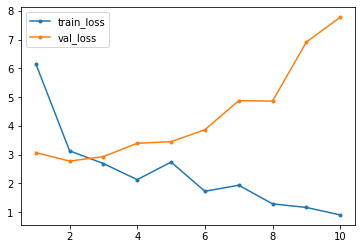

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_0_10


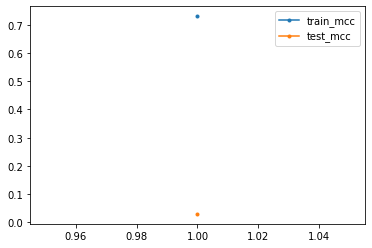

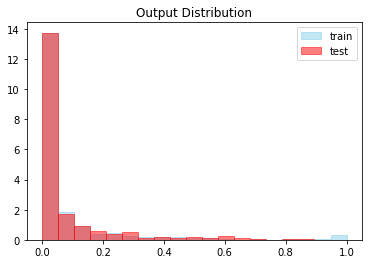




Global Iteration: (0/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Failed:  (1, 'train1.h5')



Global Iteration: (0/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 201ms/step - loss: 4.6012 - acc: 0.5992 - val_loss: 3.3943 - val_acc: 0.8988
Epoch 2/10
12/12 [==============================] - 2s 156ms/step - loss: 3.1447 - acc: 0.7808 - val_loss: 3.9530 - val_acc: 0.9572
Epoch 3/10
12/12 [==============================] - 2s 156ms/step - loss: 2.3673 - acc: 0.7725 - val_loss: 3.6255 - val_acc: 0.8366
Epoch 4/10
12/12 [==============================] - 2s 155ms/step - loss: 2.2435 - acc: 0.7100 - val_loss: 4.7874 - val_acc: 0.9611
Epoch 5/10
12/12 [==============================] - 2s 157ms/step - loss: 1.7678 - acc: 0.7642 - val_l

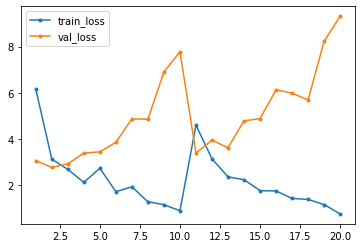

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_2_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_2_10


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:900: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


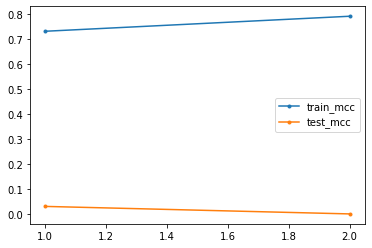

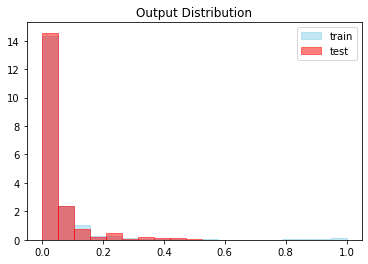




Global Iteration: (0/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 156ms/step - loss: 3.8780 - acc: 0.7200 - val_loss: 2.9208 - val_acc: 0.3619
Epoch 2/10
12/12 [==============================] - 2s 154ms/step - loss: 2.7022 - acc: 0.7442 - val_loss: 4.8412 - val_acc: 0.9689
Epoch 3/10
12/12 [==============================] - 2s 152ms/step - loss: 2.0980 - acc: 0.8200 - val_loss: 3.6779 - val_acc: 0.9261
Epoch 4/10
12/12 [==============================] - 2s 156ms/step - loss: 2.5778 - acc: 0.6225 - val_loss: 3.1081 - val_acc: 0.7471
Epoch 5/10
12/12 [==============================] - 2s 154ms/step - loss: 2.5105 - acc: 0.8125 - val_loss: 4.1808 - val_acc: 0.9572
Epoch 6/10
12/12 [==============================] - 2s 156ms/step - loss: 1.9487 - acc: 0.7

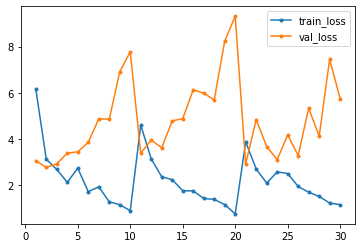

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_3_10


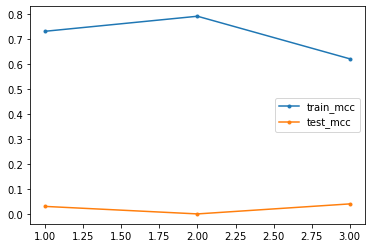

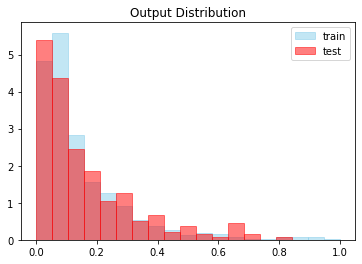




Global Iteration: (0/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 3.4427 - acc: 0.7733 - val_loss: 4.3742 - val_acc: 0.9600
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.2687 - acc: 0.6517 - val_loss: 3.9486 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.4556 - acc: 0.9033 - val_loss: 3.7993 - val_acc: 0.9717
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.1796 - acc: 0.8050 - val_loss: 3.5562 - val_acc: 0.9667
Epoch 5/10
12/12 [==============================] - 2s 175ms/step - loss: 2.0946 - acc: 0.8800 - val_loss: 3.5805 - val_acc: 0.9700
Epoch 6/10
12/12 [==============================] - 2s 175ms/step - loss: 1.8521 - acc: 0.8

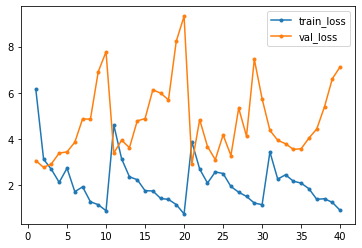

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_4_10


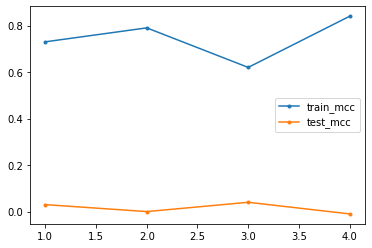

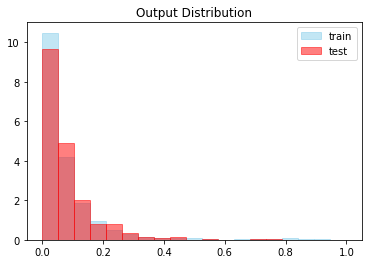




Global Iteration: (0/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 4.6763 - acc: 0.4950 - val_loss: 3.0053 - val_acc: 0.6583
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 3.1998 - acc: 0.4767 - val_loss: 2.9518 - val_acc: 0.1117
Epoch 3/10
12/12 [==============================] - 2s 177ms/step - loss: 2.6682 - acc: 0.4967 - val_loss: 2.9745 - val_acc: 0.6283
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7351 - acc: 0.7217 - val_loss: 3.0173 - val_acc: 0.6817
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.2745 - acc: 0.5408 - val_loss: 3.3636 - val_acc: 0.8583
Epoch 6/10
12/12 [==============================] - 2s 174ms/step - loss: 2.2821 - acc: 0.7

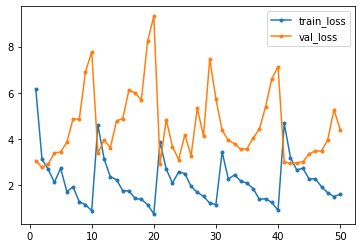

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_5_10


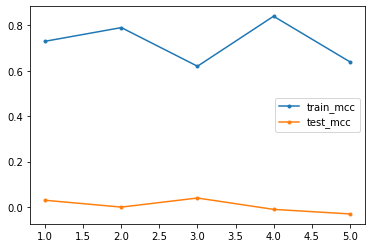

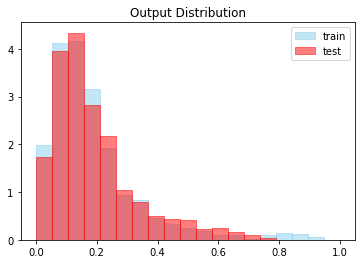




Global Iteration: (0/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 3.6549 - acc: 0.6475 - val_loss: 2.8291 - val_acc: 0.2683
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 3.1570 - acc: 0.4550 - val_loss: 2.9396 - val_acc: 0.8383
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 3.2120 - acc: 0.7433 - val_loss: 2.9436 - val_acc: 0.4767
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8132 - acc: 0.4942 - val_loss: 3.0062 - val_acc: 0.4967
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7103 - acc: 0.6183 - val_loss: 3.3088 - val_acc: 0.6800
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4843 - acc: 0.6

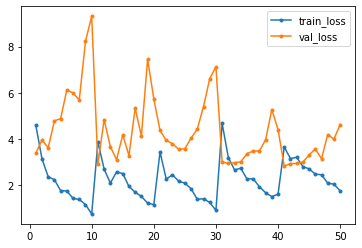

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_6_10


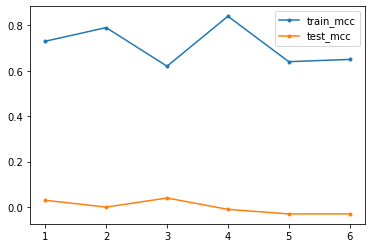

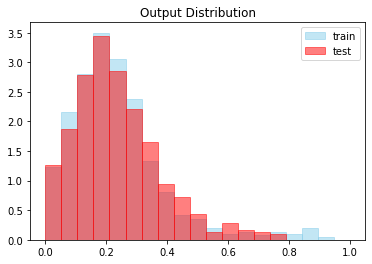




Global Iteration: (0/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 3.6935 - acc: 0.5075 - val_loss: 3.2196 - val_acc: 0.2783
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8490 - acc: 0.6283 - val_loss: 3.1610 - val_acc: 0.9417
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8653 - acc: 0.7217 - val_loss: 2.8758 - val_acc: 0.4600
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8477 - acc: 0.6483 - val_loss: 2.8210 - val_acc: 0.6650
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6188 - acc: 0.6883 - val_loss: 2.8115 - val_acc: 0.8700
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4009 - acc: 0.5

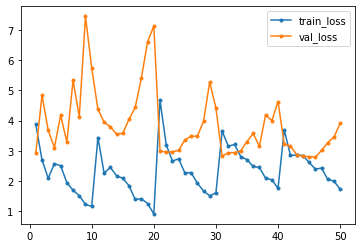

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_7_10


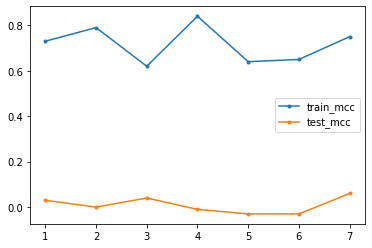

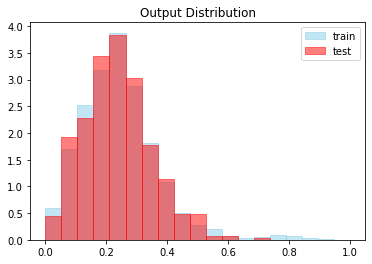




Global Iteration: (0/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0165 - acc: 0.6875 - val_loss: 2.6032 - val_acc: 0.7100
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.3882 - acc: 0.7183 - val_loss: 2.5910 - val_acc: 0.9533
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.2585 - acc: 0.7400 - val_loss: 2.5761 - val_acc: 0.9650
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.1895 - acc: 0.7467 - val_loss: 2.5403 - val_acc: 0.9533
Epoch 5/10
12/12 [==============================] - 2s 174ms/step - loss: 1.9184 - acc: 0.8550 - val_loss: 2.5562 - val_acc: 0.9300
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 1.9762 - acc: 0.7

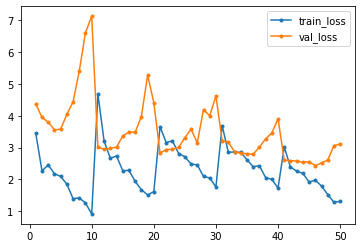

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_8_10


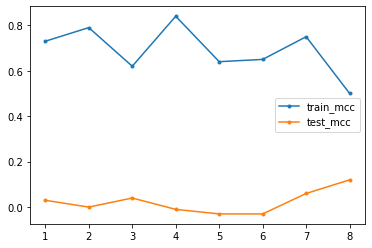

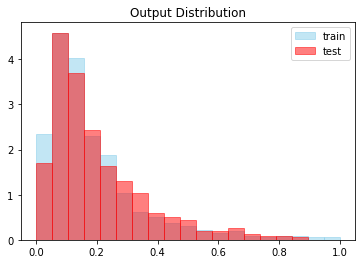




Global Iteration: (0/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.2159 - acc: 0.6517 - val_loss: 2.7689 - val_acc: 0.7067
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6031 - acc: 0.6575 - val_loss: 2.6765 - val_acc: 0.9217
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4266 - acc: 0.6550 - val_loss: 2.6667 - val_acc: 0.8400
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.2274 - acc: 0.7042 - val_loss: 2.7291 - val_acc: 0.9150
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.3367 - acc: 0.8475 - val_loss: 2.6748 - val_acc: 0.7267
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 1.9354 - acc: 0.6

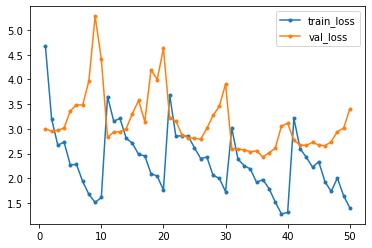

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_9_10


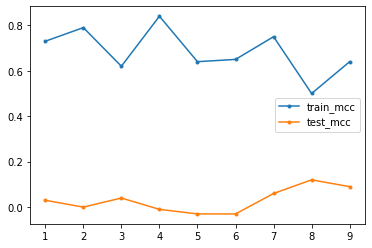

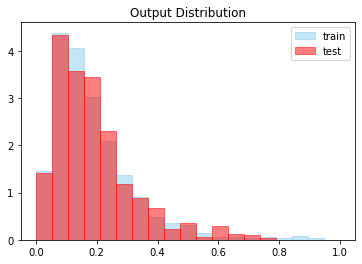




Global Iteration: (0/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 3.9843 - acc: 0.5483 - val_loss: 3.0388 - val_acc: 0.3983
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7778 - acc: 0.6250 - val_loss: 3.2251 - val_acc: 0.8550
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5662 - acc: 0.6500 - val_loss: 3.1128 - val_acc: 0.6983
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4543 - acc: 0.6875 - val_loss: 3.2164 - val_acc: 0.7667
Epoch 5/10
12/12 [==============================] - 2s 176ms/step - loss: 2.5072 - acc: 0.6242 - val_loss: 3.2583 - val_acc: 0.7250
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.0391 - acc: 0

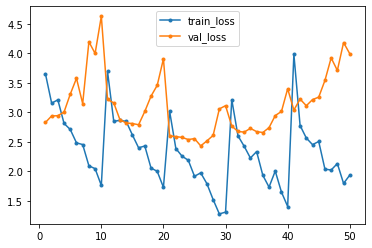

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_10_10


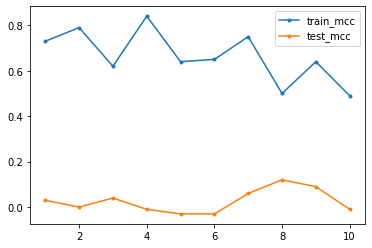

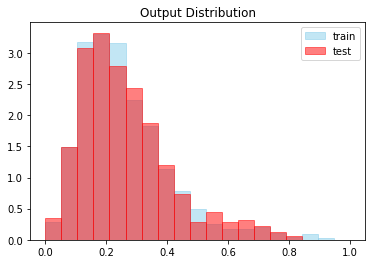




Global Iteration: (0/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 157ms/step - loss: 3.4202 - acc: 0.5842 - val_loss: 2.9194 - val_acc: 0.5058
Epoch 2/10
12/12 [==============================] - 2s 152ms/step - loss: 2.5693 - acc: 0.6608 - val_loss: 3.2503 - val_acc: 0.8249
Epoch 3/10
12/12 [==============================] - 2s 153ms/step - loss: 2.4301 - acc: 0.5800 - val_loss: 3.1596 - val_acc: 0.5370
Epoch 4/10
12/12 [==============================] - 2s 153ms/step - loss: 2.4687 - acc: 0.6575 - val_loss: 3.1846 - val_acc: 0.7082
Epoch 5/10
12/12 [==============================] - 2s 154ms/step - loss: 2.4750 - acc: 0.6158 - val_loss: 3.1945 - val_acc: 0.7704
Epoch 6/10
12/12 [==============================] - 2s 153ms/step - loss: 2.3301 - acc: 0

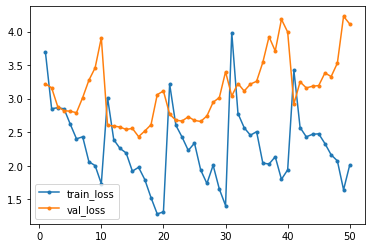

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_11_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_11_10


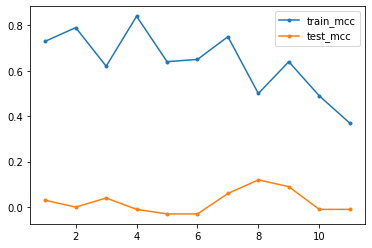

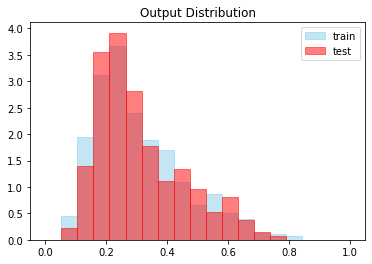




Global Iteration: (0/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0663 - acc: 0.4908 - val_loss: 2.3464 - val_acc: 0.6033
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7173 - acc: 0.5342 - val_loss: 2.3709 - val_acc: 0.5450
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7131 - acc: 0.5925 - val_loss: 2.3482 - val_acc: 0.7717
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6943 - acc: 0.6200 - val_loss: 2.3143 - val_acc: 0.6867
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.3275 - acc: 0.6692 - val_loss: 2.3266 - val_acc: 0.7850
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.1214 - acc: 0

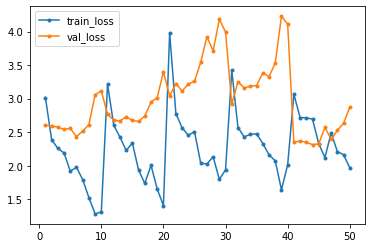

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_12_10


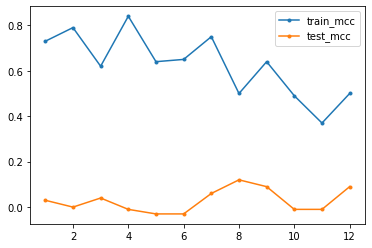

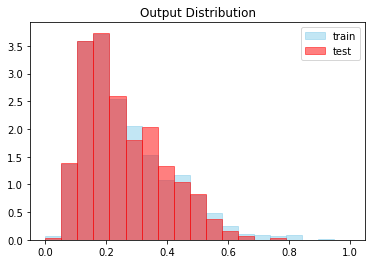




Global Iteration: (0/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 3.0628 - acc: 0.5767 - val_loss: 3.1137 - val_acc: 0.4567
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6457 - acc: 0.4733 - val_loss: 3.2519 - val_acc: 0.7917
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4834 - acc: 0.6208 - val_loss: 3.1439 - val_acc: 0.7433
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.2041 - acc: 0.7233 - val_loss: 3.5765 - val_acc: 0.9317
Epoch 5/10
12/12 [==============================] - 2s 174ms/step - loss: 2.3096 - acc: 0.8400 - val_loss: 3.2105 - val_acc: 0.8733
Epoch 6/10
12/12 [==============================] - 2s 175ms/step - loss: 2.2966 - acc: 0

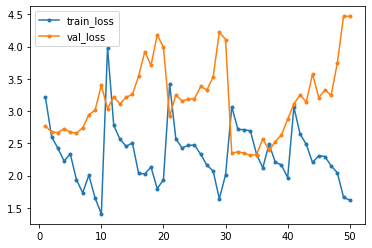

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_13_10


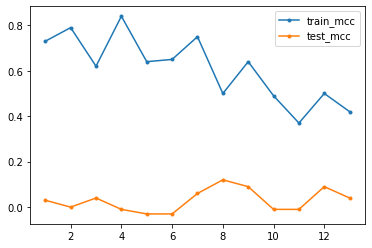

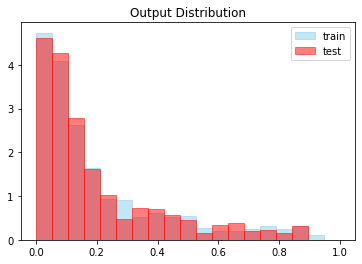




Global Iteration: (0/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.9754 - acc: 0.6583 - val_loss: 2.0924 - val_acc: 0.5183
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0145 - acc: 0.4883 - val_loss: 2.0570 - val_acc: 0.7233
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8752 - acc: 0.3925 - val_loss: 2.1172 - val_acc: 0.4400
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7845 - acc: 0.4908 - val_loss: 2.0798 - val_acc: 0.5383
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9775 - acc: 0.2717 - val_loss: 2.3224 - val_acc: 0.1317
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8295 - acc: 0

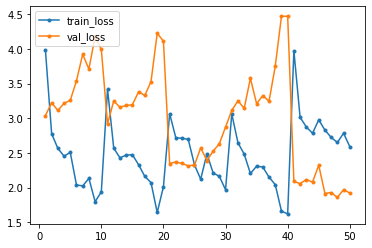

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_14_10


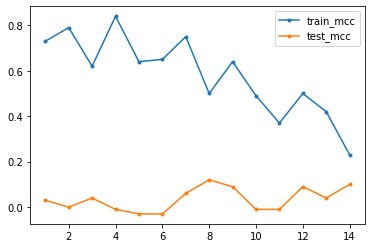

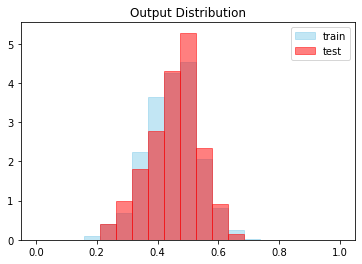




Global Iteration: (0/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.6691 - acc: 0.7150 - val_loss: 2.4615 - val_acc: 0.7533
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5303 - acc: 0.5958 - val_loss: 2.4042 - val_acc: 0.7650
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4886 - acc: 0.5575 - val_loss: 2.4321 - val_acc: 0.6833
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.3088 - acc: 0.5350 - val_loss: 2.3943 - val_acc: 0.8283
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.1979 - acc: 0.6767 - val_loss: 2.3557 - val_acc: 0.8350
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.1477 - acc: 0

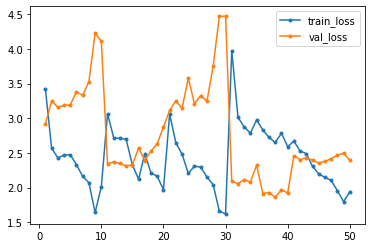

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_15_10


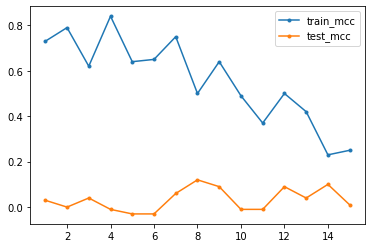

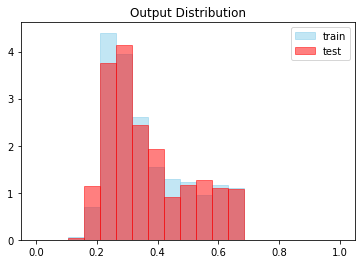




Global Iteration: (0/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8910 - acc: 0.6933 - val_loss: 2.1441 - val_acc: 0.5167
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6078 - acc: 0.4583 - val_loss: 2.0316 - val_acc: 0.7667
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8883 - acc: 0.6525 - val_loss: 2.1442 - val_acc: 0.3350
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6258 - acc: 0.4950 - val_loss: 1.9542 - val_acc: 0.7717
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7187 - acc: 0.6242 - val_loss: 1.9562 - val_acc: 0.7117
Epoch 6/10
12/12 [==============================] - 2s 177ms/step - loss: 2.2189 - acc: 0

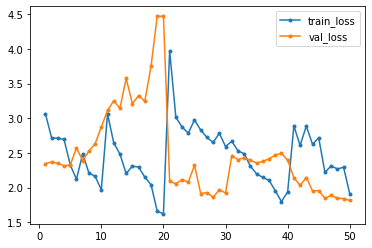

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_16_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_16_10


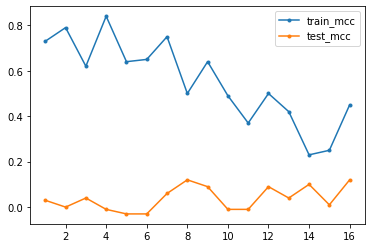

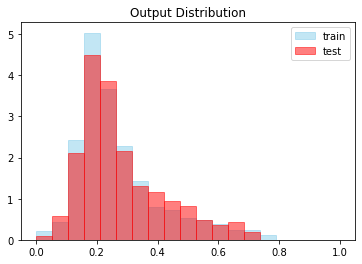




Global Iteration: (0/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 3.0927 - acc: 0.6192 - val_loss: 2.9463 - val_acc: 0.1667
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 3.0123 - acc: 0.4308 - val_loss: 2.9059 - val_acc: 0.6267
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7971 - acc: 0.4900 - val_loss: 2.8655 - val_acc: 0.6900
Epoch 4/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8514 - acc: 0.6925 - val_loss: 2.7877 - val_acc: 0.4650
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7176 - acc: 0.2725 - val_loss: 2.7734 - val_acc: 0.5183
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4843 - acc: 0

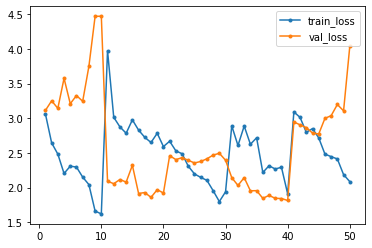

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_17_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_17_10


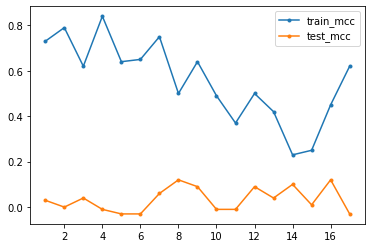

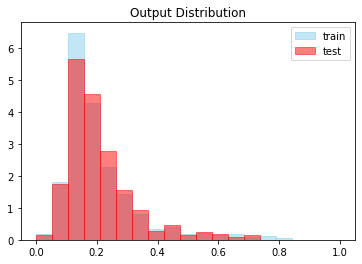




Global Iteration: (0/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 3.5444 - acc: 0.4592 - val_loss: 2.9193 - val_acc: 0.1567
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 3.1738 - acc: 0.3442 - val_loss: 2.8952 - val_acc: 0.4683
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8625 - acc: 0.3692 - val_loss: 2.9301 - val_acc: 0.4300
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6591 - acc: 0.5725 - val_loss: 2.9915 - val_acc: 0.8217
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7701 - acc: 0.6533 - val_loss: 2.8585 - val_acc: 0.5700
Epoch 6/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7177 - acc: 0

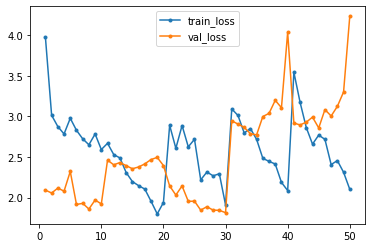

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_18_10


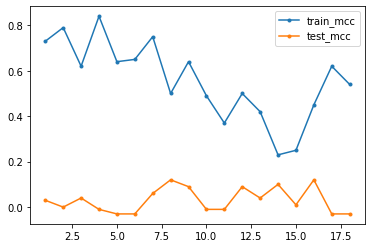

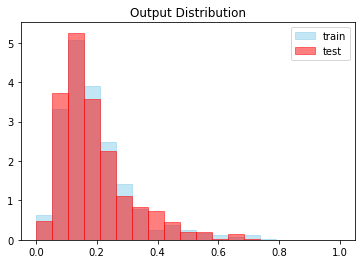




Global Iteration: (0/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8348 - acc: 0.7392 - val_loss: 2.2399 - val_acc: 0.5700
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6649 - acc: 0.6350 - val_loss: 2.2067 - val_acc: 0.7817
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7509 - acc: 0.4667 - val_loss: 2.1413 - val_acc: 0.6483
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3652 - acc: 0.7350 - val_loss: 2.1399 - val_acc: 0.8067
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5480 - acc: 0.6525 - val_loss: 2.1617 - val_acc: 0.9483
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5789 - acc: 0

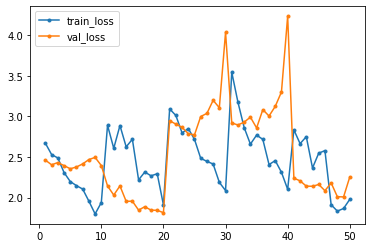

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_19_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_19_10


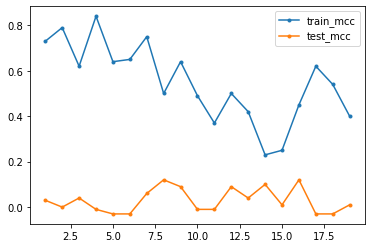

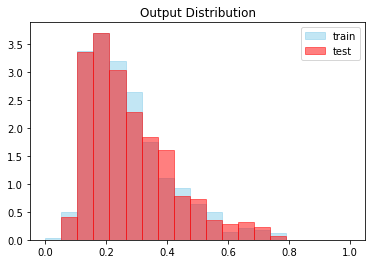




Global Iteration: (0/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.2503 - acc: 0.3900 - val_loss: 2.3460 - val_acc: 0.4650
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8941 - acc: 0.5108 - val_loss: 2.2403 - val_acc: 0.7483
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8288 - acc: 0.4592 - val_loss: 2.3289 - val_acc: 0.4883
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6055 - acc: 0.5742 - val_loss: 2.3469 - val_acc: 0.5983
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5075 - acc: 0.6067 - val_loss: 2.3763 - val_acc: 0.8133
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.3595 - acc: 0

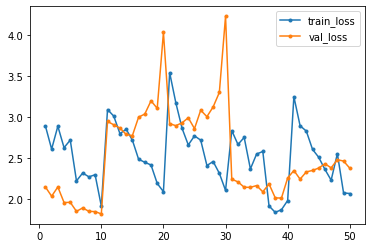

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_20_10


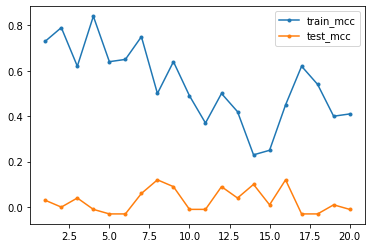

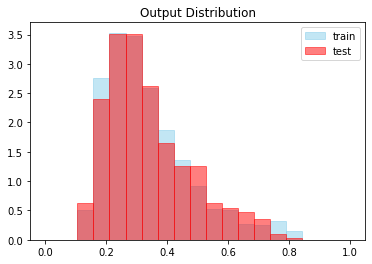




Global Iteration: (0/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.3705 - acc: 0.3100 - val_loss: 2.9503 - val_acc: 0.2900
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9966 - acc: 0.3875 - val_loss: 3.0030 - val_acc: 0.2733
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6899 - acc: 0.3950 - val_loss: 3.1110 - val_acc: 0.7050
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7743 - acc: 0.5175 - val_loss: 3.0214 - val_acc: 0.4867
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6609 - acc: 0.4850 - val_loss: 3.1009 - val_acc: 0.7083
Epoch 6/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6666 - acc: 0

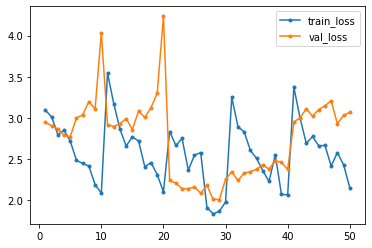

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_21_10


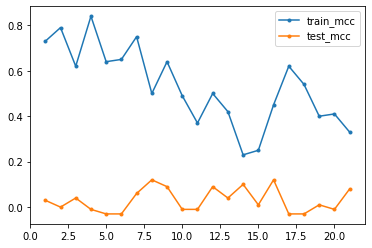

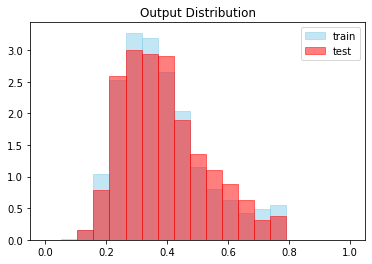




Global Iteration: (0/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 3.1217 - acc: 0.4308 - val_loss: 2.9589 - val_acc: 0.0917
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9771 - acc: 0.2967 - val_loss: 2.7881 - val_acc: 0.5933
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8073 - acc: 0.5958 - val_loss: 2.8990 - val_acc: 0.6883
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7153 - acc: 0.4533 - val_loss: 2.7897 - val_acc: 0.6250
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6033 - acc: 0.5350 - val_loss: 2.7683 - val_acc: 0.5150
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5582 - acc: 0

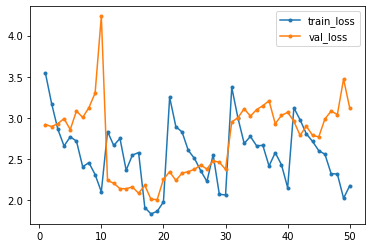

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_22_10


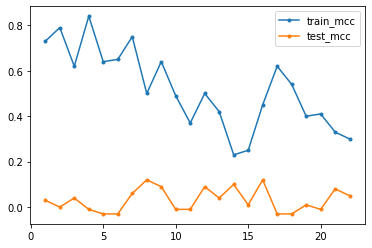

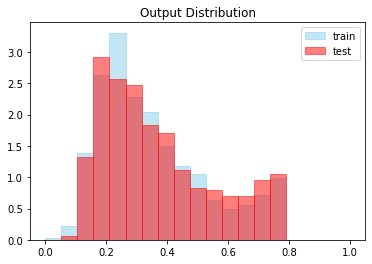




Global Iteration: (0/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 154ms/step - loss: 3.2459 - acc: 0.4325 - val_loss: 3.2991 - val_acc: 0.1984
Epoch 2/10
12/12 [==============================] - 2s 152ms/step - loss: 3.0769 - acc: 0.3767 - val_loss: 3.1170 - val_acc: 0.2101
Epoch 3/10
12/12 [==============================] - 2s 151ms/step - loss: 2.9479 - acc: 0.3592 - val_loss: 3.2110 - val_acc: 0.4786
Epoch 4/10
12/12 [==============================] - 2s 153ms/step - loss: 2.7725 - acc: 0.4042 - val_loss: 3.2203 - val_acc: 0.2763
Epoch 5/10
12/12 [==============================] - 2s 151ms/step - loss: 2.5723 - acc: 0.4908 - val_loss: 3.4909 - val_acc: 0.8444
Epoch 6/10
12/12 [==============================] - 2s 153ms/step - loss: 2.8139 - acc: 0

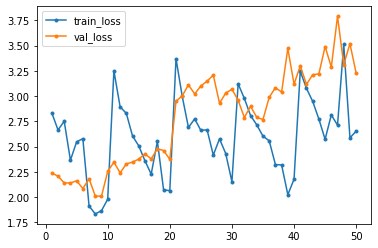

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_23_10


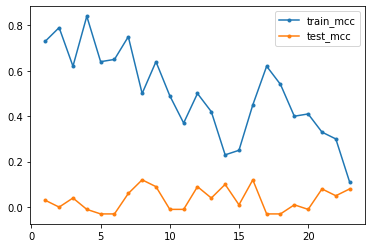

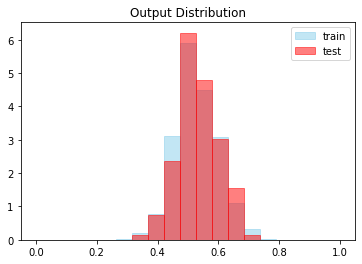




Global Iteration: (0/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6781 - acc: 0.3500 - val_loss: 2.8330 - val_acc: 0.4383
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5973 - acc: 0.4725 - val_loss: 2.8645 - val_acc: 0.7817
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5425 - acc: 0.5817 - val_loss: 2.8210 - val_acc: 0.6017
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6074 - acc: 0.3825 - val_loss: 2.9869 - val_acc: 0.7517
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2260 - acc: 0.6808 - val_loss: 3.2651 - val_acc: 0.9383
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.3142 - acc: 0

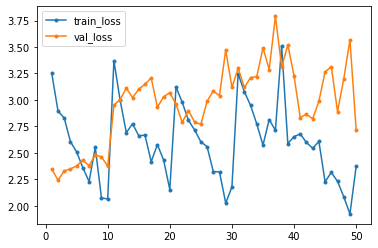

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_24_10


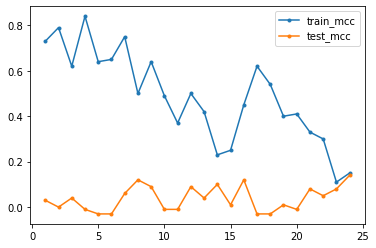

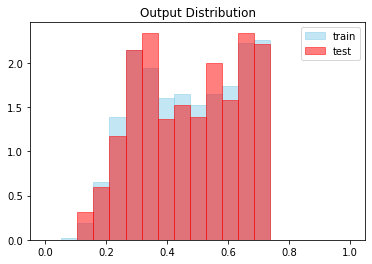




Global Iteration: (0/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.4624 - acc: 0.3383 - val_loss: 2.6207 - val_acc: 0.9350
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.9517 - acc: 0.6808 - val_loss: 2.5737 - val_acc: 0.5867
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3690 - acc: 0.5192 - val_loss: 2.4980 - val_acc: 0.6850
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5095 - acc: 0.6783 - val_loss: 2.5089 - val_acc: 0.7167
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.2880 - acc: 0.5783 - val_loss: 2.4812 - val_acc: 0.7183
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2630 - acc: 0

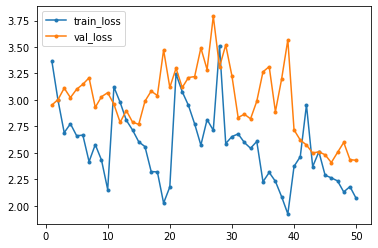

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_25_10


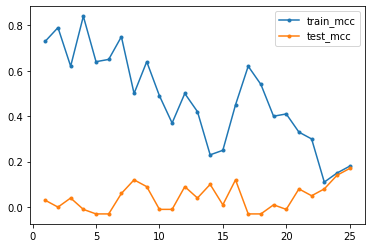

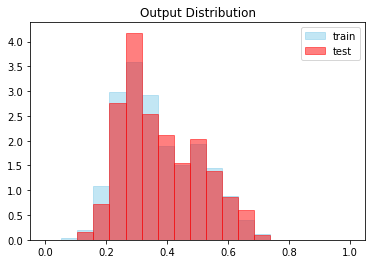




Global Iteration: (0/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8609 - acc: 0.4800 - val_loss: 2.1939 - val_acc: 0.2667
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.9083 - acc: 0.2692 - val_loss: 2.1171 - val_acc: 0.3950
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.9923 - acc: 0.6108 - val_loss: 1.9817 - val_acc: 0.7750
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8558 - acc: 0.3175 - val_loss: 2.1559 - val_acc: 0.2967
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6008 - acc: 0.4617 - val_loss: 1.9835 - val_acc: 0.8067
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7024 - acc: 0

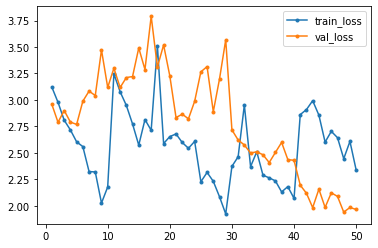

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_26_10


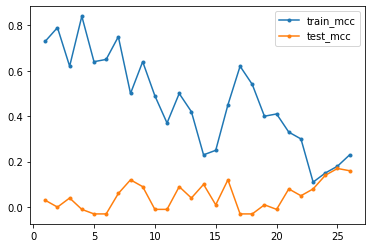

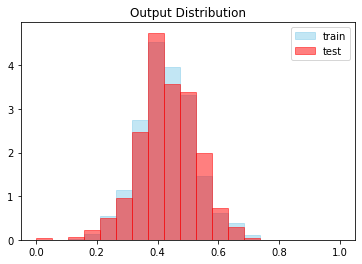




Global Iteration: (0/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.3484 - acc: 0.6225 - val_loss: 2.3998 - val_acc: 0.3067
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1869 - acc: 0.1683 - val_loss: 2.5170 - val_acc: 0.0283
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0828 - acc: 0.1717 - val_loss: 2.4094 - val_acc: 0.1767
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1772 - acc: 0.4083 - val_loss: 2.4653 - val_acc: 0.0883
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 3.1122 - acc: 0.1433 - val_loss: 2.5220 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9399 - acc: 0

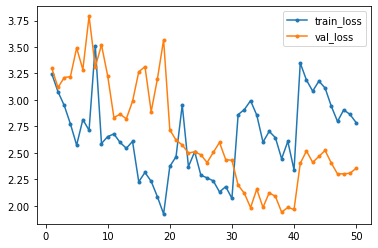

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_27_10


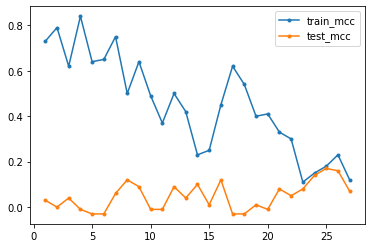

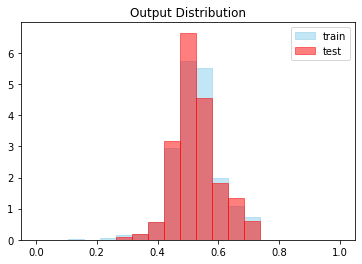




Global Iteration: (0/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 3.0620 - acc: 0.2008 - val_loss: 2.9537 - val_acc: 0.0983
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8929 - acc: 0.4667 - val_loss: 2.9270 - val_acc: 0.6933
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8527 - acc: 0.4350 - val_loss: 2.8087 - val_acc: 0.4933
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7197 - acc: 0.5683 - val_loss: 2.8289 - val_acc: 0.6833
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5721 - acc: 0.5250 - val_loss: 2.8714 - val_acc: 0.5983
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6826 - acc: 0

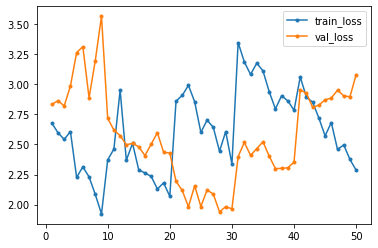

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_28_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_28_10


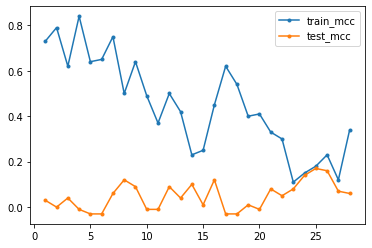

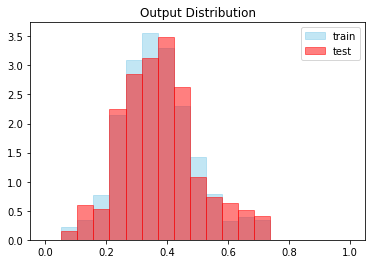




Global Iteration: (0/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0886 - acc: 0.5333 - val_loss: 2.7610 - val_acc: 0.2983
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7627 - acc: 0.3425 - val_loss: 2.7613 - val_acc: 0.6950
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5727 - acc: 0.6808 - val_loss: 2.8680 - val_acc: 0.7900
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6613 - acc: 0.4575 - val_loss: 2.7618 - val_acc: 0.4467
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5511 - acc: 0.6108 - val_loss: 2.9212 - val_acc: 0.8150
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6294 - acc: 0

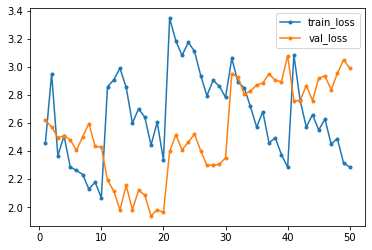

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_29_10


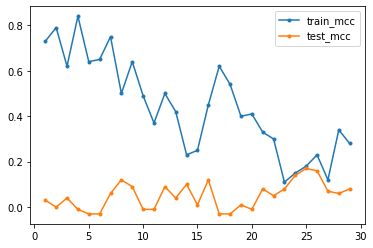

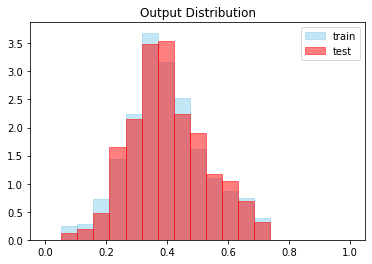




Global Iteration: (0/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6715 - acc: 0.5767 - val_loss: 2.0707 - val_acc: 0.7600
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4561 - acc: 0.6517 - val_loss: 2.2887 - val_acc: 0.6750
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7571 - acc: 0.6542 - val_loss: 2.1687 - val_acc: 0.5433
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6330 - acc: 0.3783 - val_loss: 2.2541 - val_acc: 0.4150
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4178 - acc: 0.5433 - val_loss: 2.0846 - val_acc: 0.9350
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7113 - acc: 0

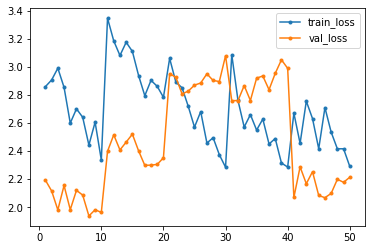

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_30_10


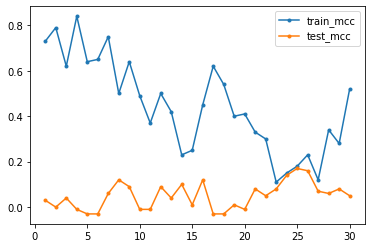

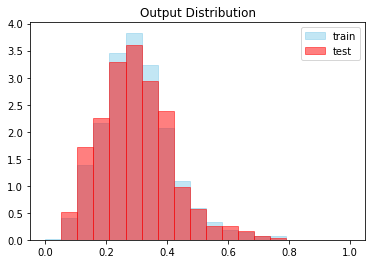




Global Iteration: (0/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9151 - acc: 0.4583 - val_loss: 2.3719 - val_acc: 0.2100
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9512 - acc: 0.3500 - val_loss: 2.1112 - val_acc: 0.5500
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4978 - acc: 0.4983 - val_loss: 1.9751 - val_acc: 0.8400
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8407 - acc: 0.5542 - val_loss: 1.9432 - val_acc: 0.7900
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5999 - acc: 0.7017 - val_loss: 1.9758 - val_acc: 0.7317
Epoch 6/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5004 - acc: 0

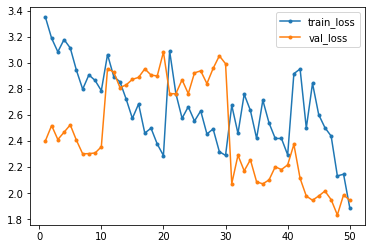

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_31_10


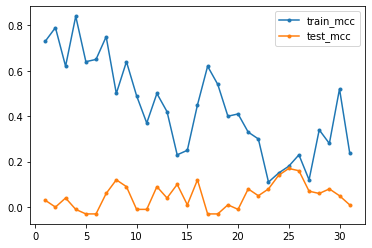

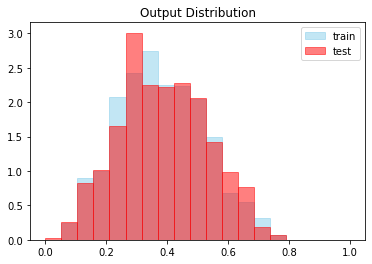




Global Iteration: (0/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7051 - acc: 0.5492 - val_loss: 3.0433 - val_acc: 0.7450
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5406 - acc: 0.7250 - val_loss: 3.0946 - val_acc: 0.7700
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.4396 - acc: 0.7192 - val_loss: 3.1741 - val_acc: 0.8200
Epoch 4/10
12/12 [==============================] - 2s 174ms/step - loss: 2.2846 - acc: 0.6117 - val_loss: 3.0310 - val_acc: 0.6967
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2101 - acc: 0.7050 - val_loss: 3.0752 - val_acc: 0.7617
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4186 - acc: 0

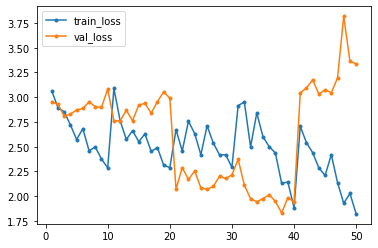

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_32_10


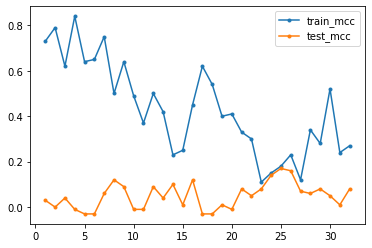

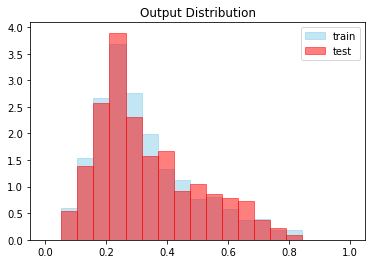




Global Iteration: (0/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 3.6718 - acc: 0.4100 - val_loss: 2.7789 - val_acc: 0.0867
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.3129 - acc: 0.1825 - val_loss: 2.5264 - val_acc: 0.2350
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 3.2801 - acc: 0.2908 - val_loss: 2.5329 - val_acc: 0.1683
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 3.2599 - acc: 0.3633 - val_loss: 2.6163 - val_acc: 0.0883
Epoch 5/10
12/12 [==============================] - 2s 174ms/step - loss: 3.1172 - acc: 0.2208 - val_loss: 2.3964 - val_acc: 0.3100
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.9276 - acc: 0

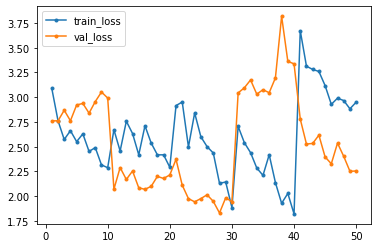

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_33_10


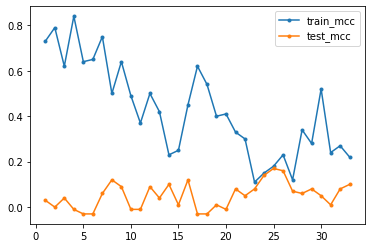

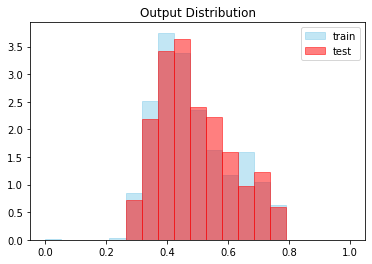




Global Iteration: (0/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.8418 - acc: 0.4783 - val_loss: 2.7929 - val_acc: 0.2033
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8729 - acc: 0.4233 - val_loss: 2.8104 - val_acc: 0.2800
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7053 - acc: 0.4133 - val_loss: 2.8394 - val_acc: 0.0917
Epoch 4/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6998 - acc: 0.3525 - val_loss: 2.8283 - val_acc: 0.5800
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5822 - acc: 0.5742 - val_loss: 2.8202 - val_acc: 0.7433
Epoch 6/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4703 - acc: 0

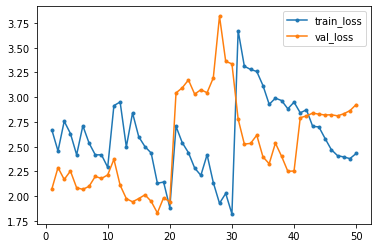

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_34_10


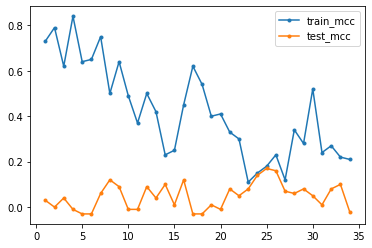

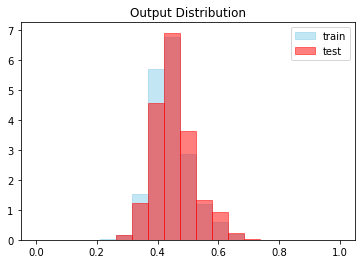




Global Iteration: (0/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7518 - acc: 0.5825 - val_loss: 3.0076 - val_acc: 0.4817
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6738 - acc: 0.4658 - val_loss: 3.0493 - val_acc: 0.6050
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7899 - acc: 0.4775 - val_loss: 3.0122 - val_acc: 0.5100
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6893 - acc: 0.3233 - val_loss: 3.0492 - val_acc: 0.6117
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5881 - acc: 0.6408 - val_loss: 3.0839 - val_acc: 0.7250
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7423 - acc: 0

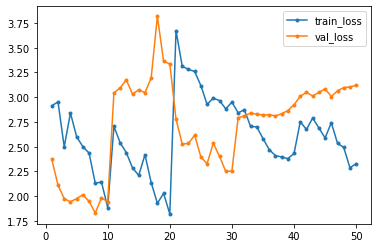

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_35_10


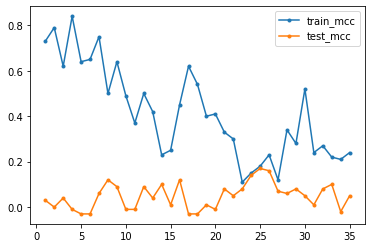

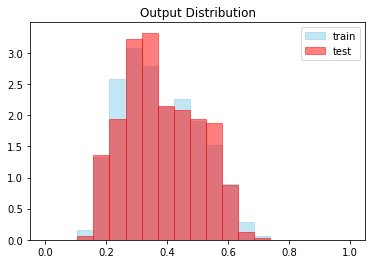




Global Iteration: (0/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 3.1873 - acc: 0.4542 - val_loss: 2.9482 - val_acc: 0.0300
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0072 - acc: 0.1633 - val_loss: 2.9079 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9132 - acc: 0.1975 - val_loss: 2.8843 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6468 - acc: 0.2458 - val_loss: 2.8368 - val_acc: 0.3133
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6991 - acc: 0.4783 - val_loss: 2.8310 - val_acc: 0.5933
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6887 - acc: 0

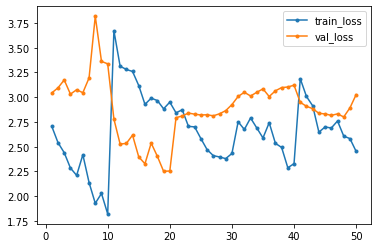

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_36_10


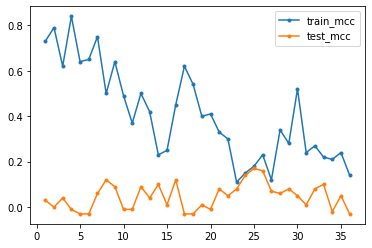

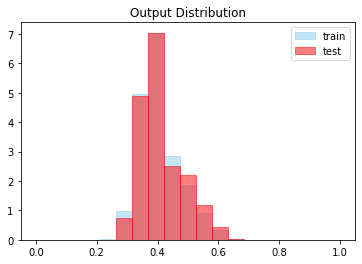




Global Iteration: (0/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.1543 - acc: 0.7700 - val_loss: 1.9930 - val_acc: 0.9333
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5853 - acc: 0.7375 - val_loss: 2.0187 - val_acc: 0.8617
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4186 - acc: 0.5467 - val_loss: 2.1191 - val_acc: 0.7017
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4392 - acc: 0.5850 - val_loss: 2.0505 - val_acc: 0.7400
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4042 - acc: 0.6442 - val_loss: 2.0087 - val_acc: 0.7233
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.3802 - acc: 0

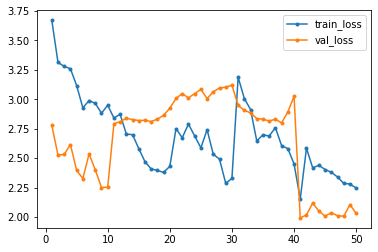

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_37_10


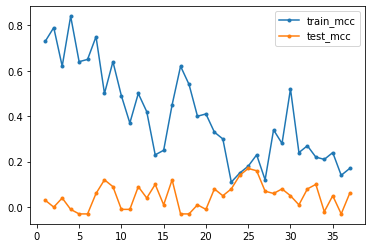

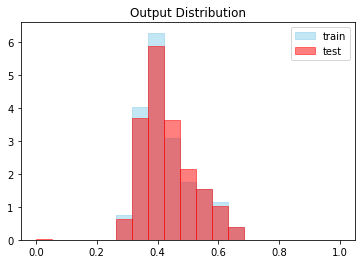




Global Iteration: (0/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5902 - acc: 0.6417 - val_loss: 3.1234 - val_acc: 0.7083
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4683 - acc: 0.6425 - val_loss: 3.2608 - val_acc: 0.8233
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4684 - acc: 0.5967 - val_loss: 3.1759 - val_acc: 0.6817
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.4691 - acc: 0.5108 - val_loss: 3.1687 - val_acc: 0.6767
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.4766 - acc: 0.5883 - val_loss: 3.1669 - val_acc: 0.6083
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.3405 - acc: 0

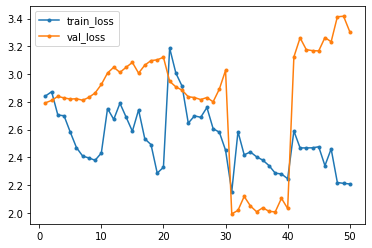

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_38_10


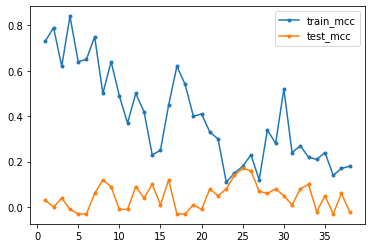

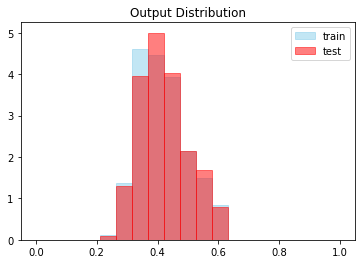




Global Iteration: (0/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Failed:  (39, 'train39.h5')



Global Iteration: (0/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.7914 - acc: 0.4617 - val_loss: 2.8944 - val_acc: 0.2017
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4998 - acc: 0.3808 - val_loss: 2.8723 - val_acc: 0.6833
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4183 - acc: 0.6392 - val_loss: 2.9603 - val_acc: 0.8817
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.3063 - acc: 0.6583 - val_loss: 2.9408 - val_acc: 0.8367
Epoch 5/10
12/12 [==============================] - 2s 176ms/step - loss: 2

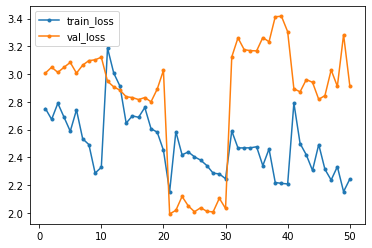

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_40_10


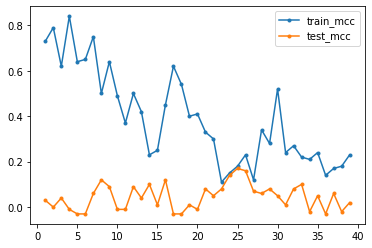

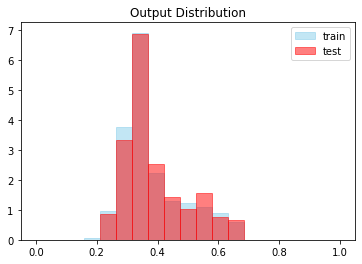




Global Iteration: (0/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8733 - acc: 0.5300 - val_loss: 2.9117 - val_acc: 0.1150
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9124 - acc: 0.3842 - val_loss: 2.8790 - val_acc: 0.6417
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7145 - acc: 0.5967 - val_loss: 2.8995 - val_acc: 0.8000
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7276 - acc: 0.4842 - val_loss: 2.8743 - val_acc: 0.4083
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7191 - acc: 0.5283 - val_loss: 2.9273 - val_acc: 0.8383
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7140 - acc: 0

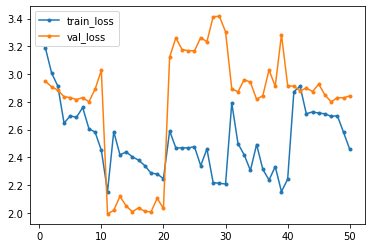

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_41_10


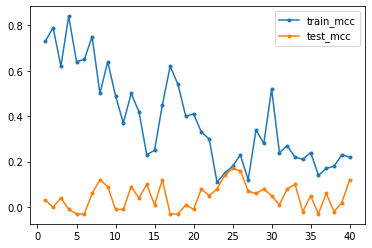

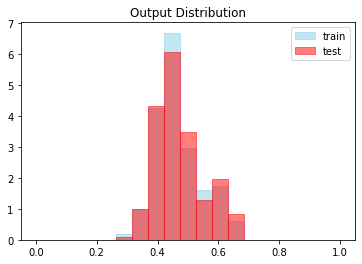




Global Iteration: (0/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4262 - acc: 0.5750 - val_loss: 2.0056 - val_acc: 0.8717
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4905 - acc: 0.5400 - val_loss: 2.1115 - val_acc: 0.6817
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5649 - acc: 0.3850 - val_loss: 2.0600 - val_acc: 0.7900
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6309 - acc: 0.7533 - val_loss: 2.0197 - val_acc: 0.8550
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3367 - acc: 0.6058 - val_loss: 2.0953 - val_acc: 0.7533
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3180 - acc: 0

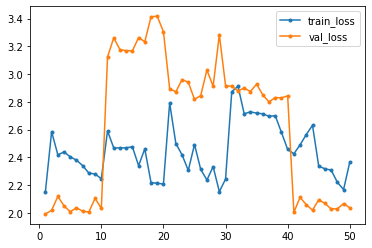

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_42_10


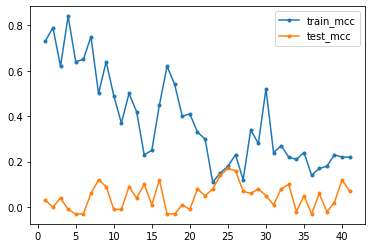

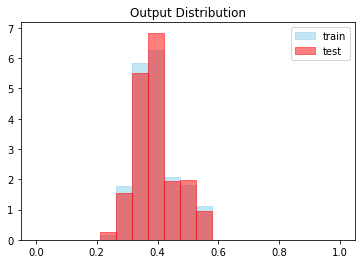




Global Iteration: (0/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 3.1292 - acc: 0.4392 - val_loss: 2.6432 - val_acc: 0.0633
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9798 - acc: 0.1950 - val_loss: 2.6293 - val_acc: 0.0300
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9983 - acc: 0.2500 - val_loss: 2.5828 - val_acc: 0.1433
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8675 - acc: 0.2250 - val_loss: 2.5927 - val_acc: 0.2983
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0399 - acc: 0.3442 - val_loss: 2.6517 - val_acc: 0.0550
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8711 - acc: 0

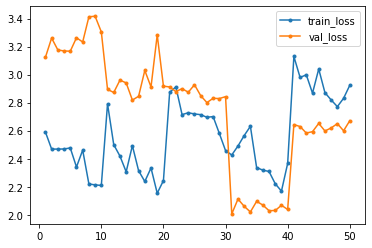

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_43_10


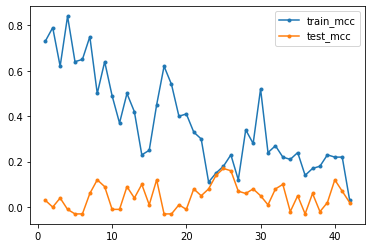

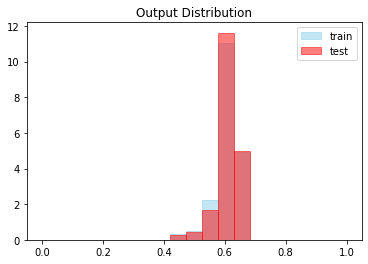




Global Iteration: (0/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6958 - acc: 0.2050 - val_loss: 2.2177 - val_acc: 0.2183
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7168 - acc: 0.3483 - val_loss: 2.1102 - val_acc: 0.5433
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6267 - acc: 0.4842 - val_loss: 2.1728 - val_acc: 0.3117
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6075 - acc: 0.4350 - val_loss: 2.1130 - val_acc: 0.4983
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5784 - acc: 0.5608 - val_loss: 2.0146 - val_acc: 0.7533
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5830 - acc: 0

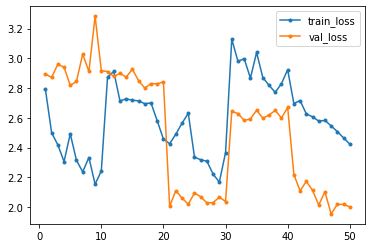

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_44_10


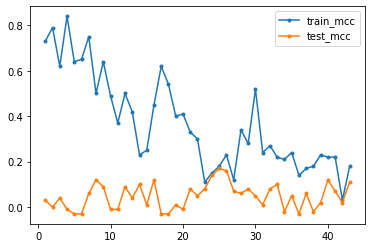

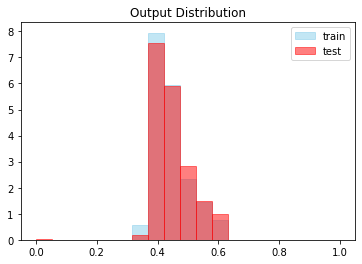




Global Iteration: (0/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7244 - acc: 0.4733 - val_loss: 2.0619 - val_acc: 0.8400
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7500 - acc: 0.4550 - val_loss: 2.1596 - val_acc: 0.5483
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6686 - acc: 0.4942 - val_loss: 2.1136 - val_acc: 0.6917
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6994 - acc: 0.4667 - val_loss: 2.1850 - val_acc: 0.4450
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6128 - acc: 0.4917 - val_loss: 2.1180 - val_acc: 0.6700
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6640 - acc: 0

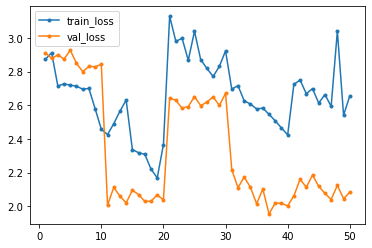

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_45_10


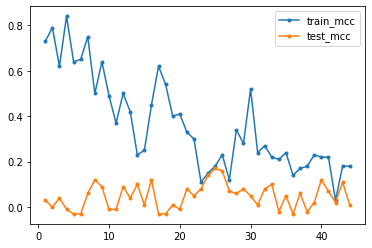

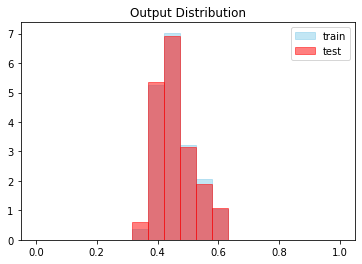




Global Iteration: (0/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.2001 - acc: 0.3550 - val_loss: 3.1016 - val_acc: 0.0283
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0735 - acc: 0.3075 - val_loss: 3.1092 - val_acc: 0.1783
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0290 - acc: 0.3058 - val_loss: 3.1132 - val_acc: 0.0383
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0519 - acc: 0.2633 - val_loss: 3.1189 - val_acc: 0.0900
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1548 - acc: 0.4100 - val_loss: 3.1044 - val_acc: 0.0483
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 3.1347 - acc: 0

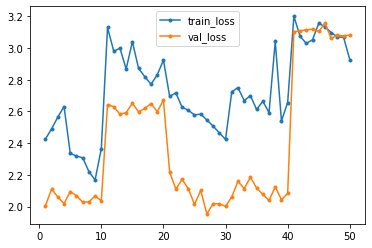

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_46_10


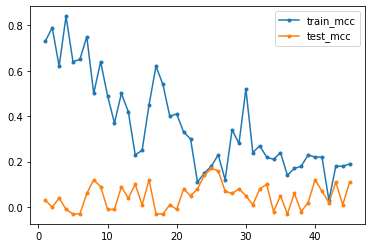

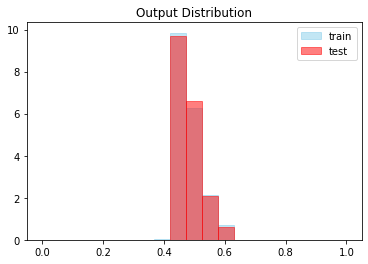




Global Iteration: (0/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.1382 - acc: 0.3925 - val_loss: 2.9741 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9201 - acc: 0.1267 - val_loss: 2.9562 - val_acc: 0.1717
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8771 - acc: 0.5858 - val_loss: 2.9727 - val_acc: 0.8633
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8394 - acc: 0.6017 - val_loss: 2.8950 - val_acc: 0.3783
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0279 - acc: 0.1050 - val_loss: 3.0408 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8837 - acc: 0

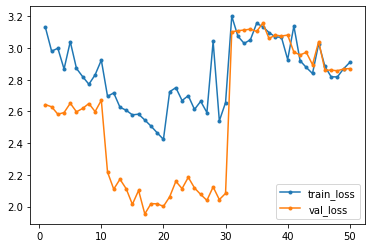

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_47_10


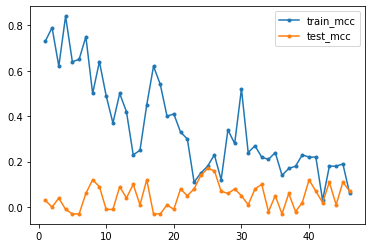

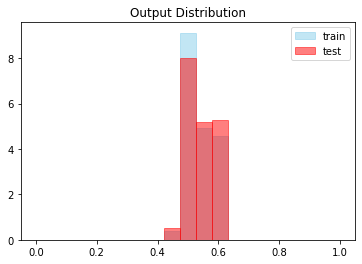




Global Iteration: (0/40) Set Number: (48/64) Epochs: 10  File: train48.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 3.1880 - acc: 0.3000 - val_loss: 2.6234 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2130 - acc: 0.2408 - val_loss: 2.6244 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1260 - acc: 0.1325 - val_loss: 2.6182 - val_acc: 0.0400
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0596 - acc: 0.3050 - val_loss: 2.4882 - val_acc: 0.4283
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 3.1668 - acc: 0.5600 - val_loss: 2.4112 - val_acc: 0.6200
Epoch 6/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0077 - acc: 0

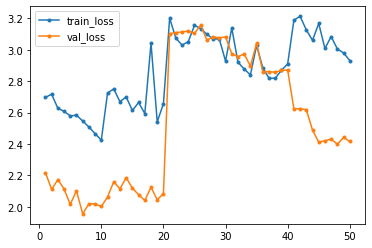

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_48_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_48_10


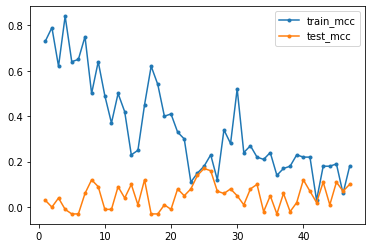

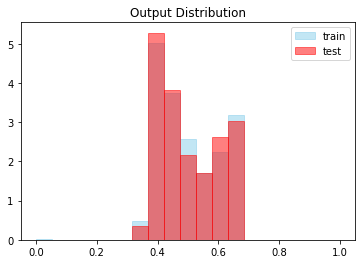




Global Iteration: (0/40) Set Number: (49/64) Epochs: 10  File: train49.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 3.2304 - acc: 0.2200 - val_loss: 2.7407 - val_acc: 0.0683
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2534 - acc: 0.4008 - val_loss: 2.6853 - val_acc: 0.6100
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2059 - acc: 0.2800 - val_loss: 2.7748 - val_acc: 0.3833
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 3.2481 - acc: 0.4308 - val_loss: 2.7958 - val_acc: 0.0567
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1969 - acc: 0.2125 - val_loss: 2.8435 - val_acc: 0.0367
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 3.2807 - acc: 0

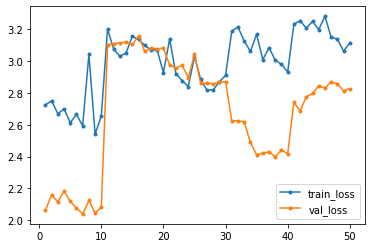

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_49_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_49_10


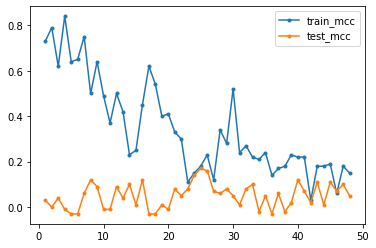

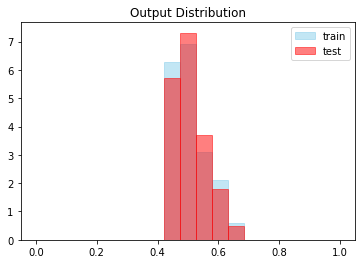




Global Iteration: (0/40) Set Number: (50/64) Epochs: 10  File: train50.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5555 - acc: 0.4975 - val_loss: 2.6127 - val_acc: 0.8133
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4146 - acc: 0.4900 - val_loss: 2.5760 - val_acc: 0.6117
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6100 - acc: 0.4758 - val_loss: 2.5386 - val_acc: 0.7050
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5111 - acc: 0.4675 - val_loss: 2.5435 - val_acc: 0.6800
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5036 - acc: 0.6083 - val_loss: 2.5996 - val_acc: 0.9583
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5820 - acc: 0

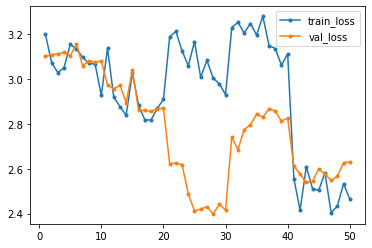

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_50_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_50_10


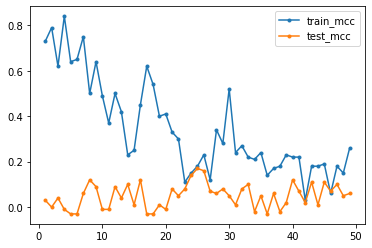

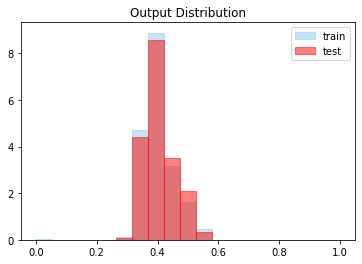




Global Iteration: (0/40) Set Number: (51/64) Epochs: 10  File: train51.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.52 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 154ms/step - loss: 3.2605 - acc: 0.3792 - val_loss: 3.3588 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 147ms/step - loss: 3.1029 - acc: 0.0250 - val_loss: 3.3665 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 149ms/step - loss: 3.0865 - acc: 0.0250 - val_loss: 3.3648 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 146ms/step - loss: 3.0859 - acc: 0.0250 - val_loss: 3.3620 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 149ms/step - loss: 3.0848 - acc: 0.0267 - val_loss: 3.3389 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 152ms/step - loss: 3.0915 - acc: 0

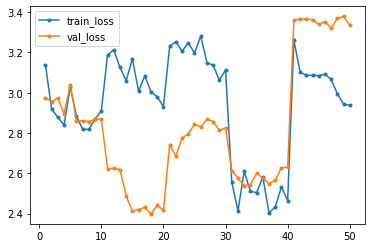

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_51_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_51_10


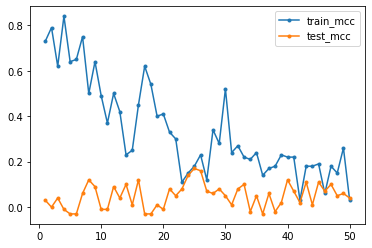

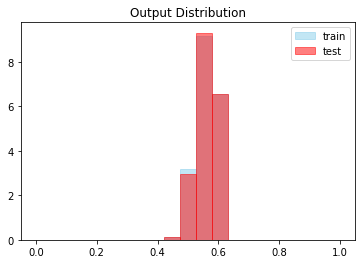




Global Iteration: (0/40) Set Number: (52/64) Epochs: 10  File: train52.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3818 - acc: 0.3417 - val_loss: 2.9955 - val_acc: 0.6983
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2756 - acc: 0.5142 - val_loss: 3.2330 - val_acc: 0.9583
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2686 - acc: 0.6508 - val_loss: 3.1994 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5045 - acc: 0.5425 - val_loss: 3.0356 - val_acc: 0.5917
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.2751 - acc: 0.4508 - val_loss: 3.1429 - val_acc: 0.9117
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.1988 - acc: 0

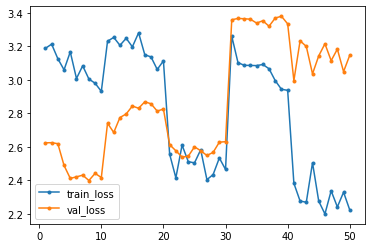

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_52_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_52_10


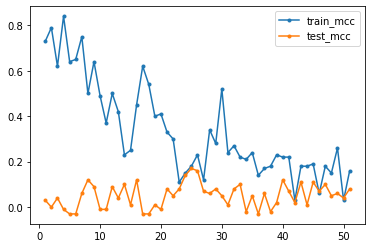

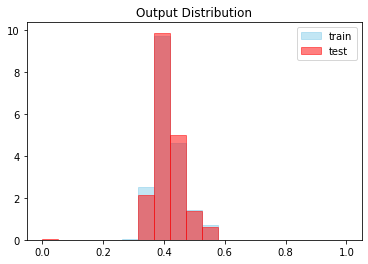




Global Iteration: (0/40) Set Number: (53/64) Epochs: 10  File: train53.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0178 - acc: 0.4775 - val_loss: 3.0227 - val_acc: 0.4600
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8680 - acc: 0.2775 - val_loss: 3.0261 - val_acc: 0.0700
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8854 - acc: 0.3742 - val_loss: 3.0187 - val_acc: 0.5267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8928 - acc: 0.2992 - val_loss: 3.0220 - val_acc: 0.0717
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7587 - acc: 0.3392 - val_loss: 3.0386 - val_acc: 0.7933
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9036 - acc: 0

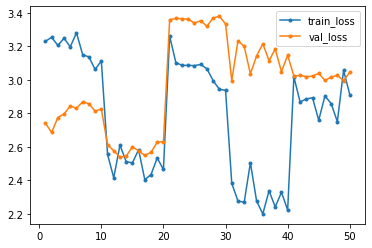

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_53_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_53_10


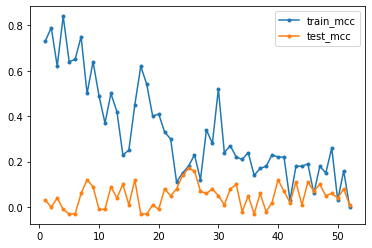

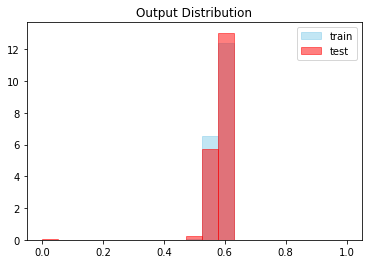




Global Iteration: (0/40) Set Number: (54/64) Epochs: 10  File: train54.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0199 - acc: 0.2083 - val_loss: 2.5168 - val_acc: 0.4467
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0145 - acc: 0.3958 - val_loss: 2.4980 - val_acc: 0.2317
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0293 - acc: 0.3750 - val_loss: 2.5117 - val_acc: 0.1283
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9904 - acc: 0.1917 - val_loss: 2.5770 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9843 - acc: 0.2475 - val_loss: 2.4649 - val_acc: 0.4900
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0148 - acc: 0

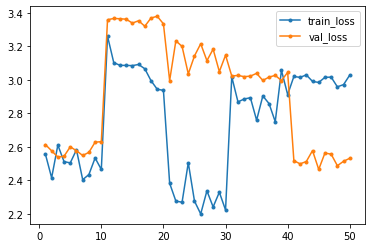

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_54_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_54_10


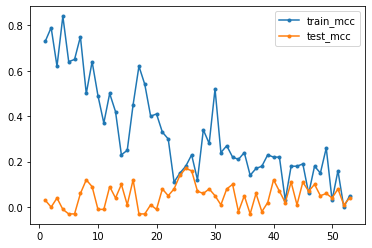

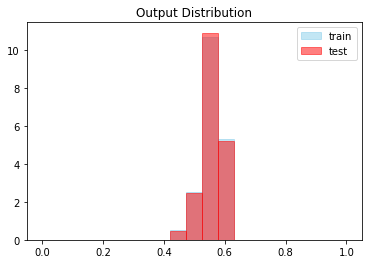




Global Iteration: (0/40) Set Number: (55/64) Epochs: 10  File: train55.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4779 - acc: 0.3700 - val_loss: 3.0100 - val_acc: 0.6450
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7107 - acc: 0.2808 - val_loss: 3.0917 - val_acc: 0.0317
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5437 - acc: 0.1808 - val_loss: 3.0295 - val_acc: 0.2583
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5399 - acc: 0.3825 - val_loss: 3.0447 - val_acc: 0.6833
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8233 - acc: 0.2658 - val_loss: 3.1201 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5946 - acc: 0

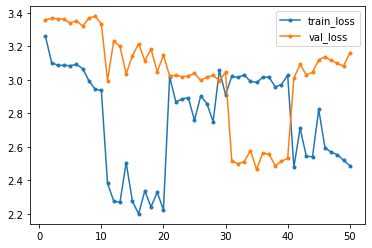

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_55_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_55_10


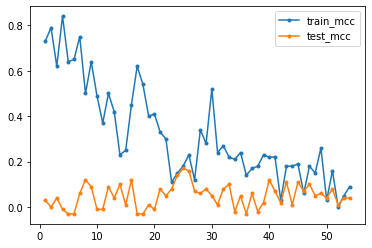

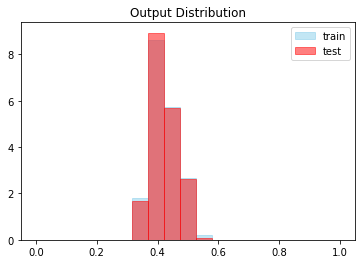




Global Iteration: (0/40) Set Number: (56/64) Epochs: 10  File: train56.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.1704 - acc: 0.4867 - val_loss: 2.2788 - val_acc: 0.8950
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.1343 - acc: 0.5167 - val_loss: 2.2566 - val_acc: 0.9350
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.0387 - acc: 0.5692 - val_loss: 2.2364 - val_acc: 0.9633
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.2092 - acc: 0.7117 - val_loss: 2.2386 - val_acc: 0.8883
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.1982 - acc: 0.6667 - val_loss: 2.2556 - val_acc: 0.8067
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.2158 - acc: 0

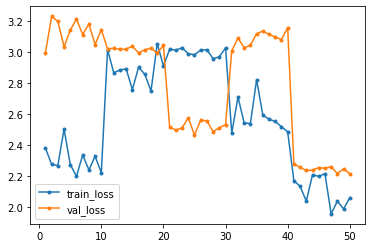

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_56_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_56_10


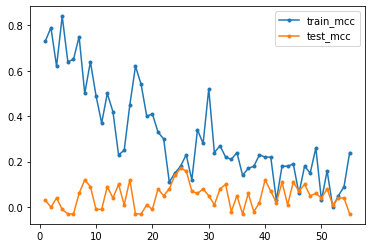

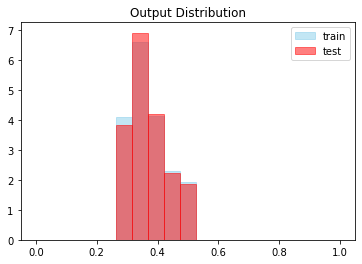




Global Iteration: (0/40) Set Number: (57/64) Epochs: 10  File: train57.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.9227 - acc: 0.5083 - val_loss: 2.6474 - val_acc: 0.4500
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8173 - acc: 0.4208 - val_loss: 2.6773 - val_acc: 0.2967
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7536 - acc: 0.1850 - val_loss: 2.7393 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7398 - acc: 0.0483 - val_loss: 2.7361 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7299 - acc: 0.1800 - val_loss: 2.6915 - val_acc: 0.2317
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6915 - acc: 0

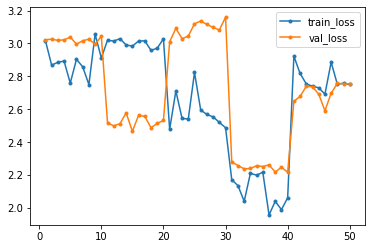

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_57_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_57_10


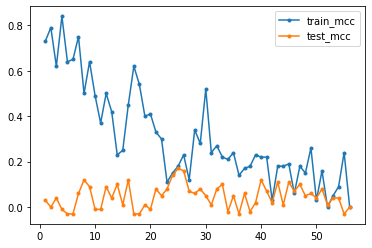

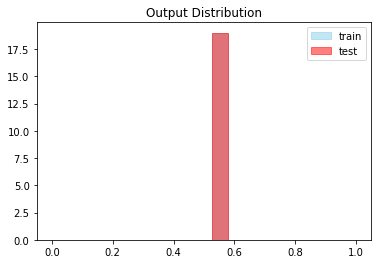




Global Iteration: (0/40) Set Number: (58/64) Epochs: 10  File: train58.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.6011 - acc: 0.0350 - val_loss: 2.8750 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.6387 - acc: 0.0342 - val_loss: 2.8565 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.5928 - acc: 0.0342 - val_loss: 2.8586 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.5627 - acc: 0.0342 - val_loss: 2.8614 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.5854 - acc: 0.0342 - val_loss: 2.8648 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.5461 - acc: 0

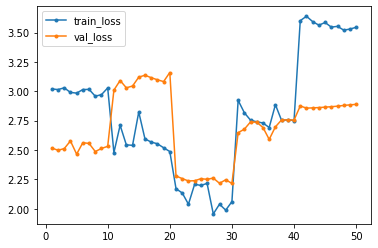

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_58_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_58_10


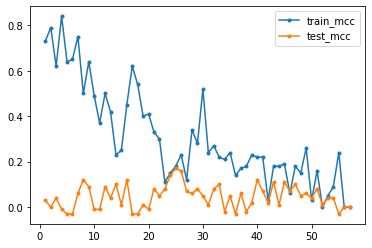

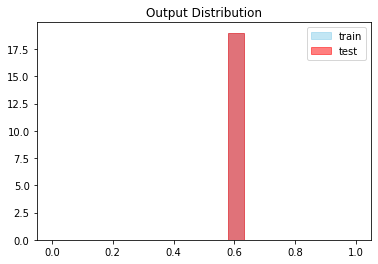




Global Iteration: (0/40) Set Number: (59/64) Epochs: 10  File: train59.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0219 - acc: 0.0242 - val_loss: 2.6369 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0147 - acc: 0.0242 - val_loss: 2.6303 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0101 - acc: 0.0242 - val_loss: 2.6258 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0211 - acc: 0.0242 - val_loss: 2.6199 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0105 - acc: 0.0242 - val_loss: 2.6159 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0294 - acc: 0

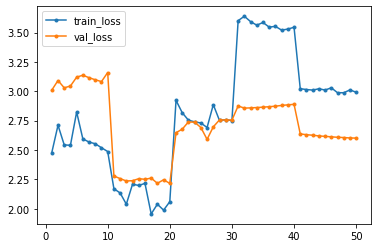

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_59_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_59_10


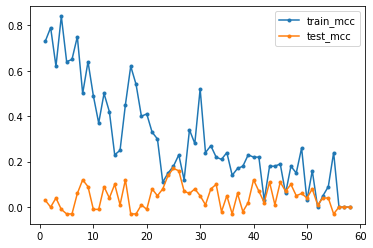

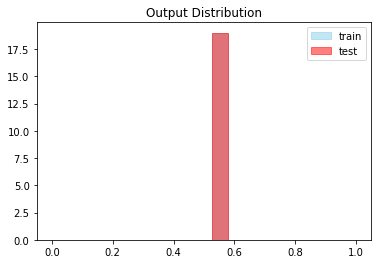




Global Iteration: (0/40) Set Number: (60/64) Epochs: 10  File: train60.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9592 - acc: 0.0233 - val_loss: 3.1405 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9601 - acc: 0.0233 - val_loss: 3.1406 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9842 - acc: 0.0233 - val_loss: 3.1408 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9418 - acc: 0.0233 - val_loss: 3.1410 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9718 - acc: 0.0233 - val_loss: 3.1415 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9512 - acc: 0

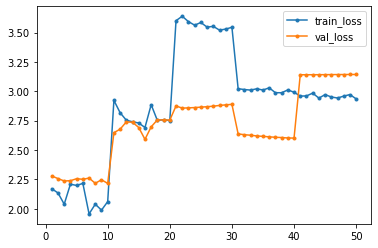

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_60_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_60_10


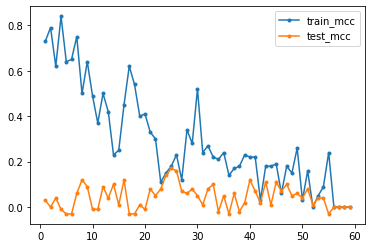

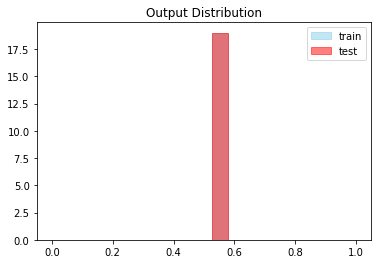




Global Iteration: (0/40) Set Number: (61/64) Epochs: 10  File: train61.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 149ms/step - loss: 2.8498 - acc: 0.0217 - val_loss: 3.3951 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 148ms/step - loss: 2.8703 - acc: 0.0217 - val_loss: 3.3969 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 146ms/step - loss: 2.8541 - acc: 0.0217 - val_loss: 3.3987 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 145ms/step - loss: 2.8474 - acc: 0.0217 - val_loss: 3.4007 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 146ms/step - loss: 2.8898 - acc: 0.0217 - val_loss: 3.4047 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 147ms/step - loss: 2.8747 - acc: 0

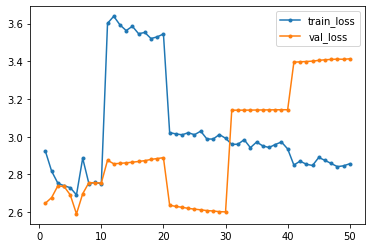

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_61_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_61_10


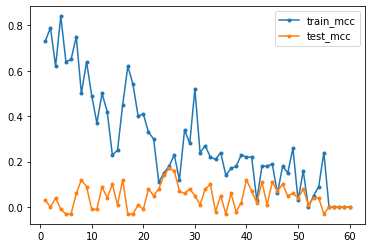

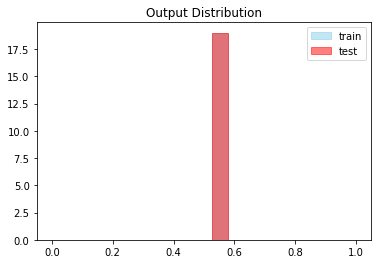




Global Iteration: (0/40) Set Number: (62/64) Epochs: 10  File: train62.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2578 - acc: 0.0133 - val_loss: 2.2527 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2394 - acc: 0.0142 - val_loss: 2.2452 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.2299 - acc: 0.1592 - val_loss: 2.0874 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.2695 - acc: 0.4700 - val_loss: 2.1893 - val_acc: 0.7500
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2199 - acc: 0.2042 - val_loss: 2.2103 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.1947 - acc: 0

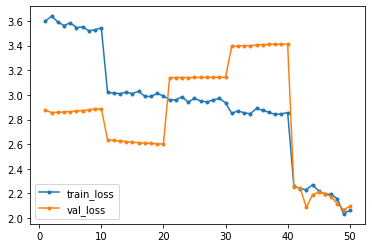

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_62_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_62_10


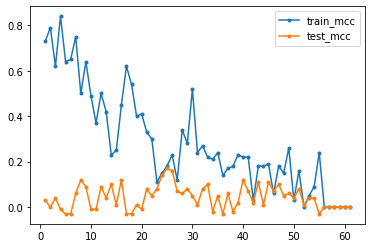

Failed:  (62, 'train62.h5')



Global Iteration: (0/40) Set Number: (63/64) Epochs: 10  File: train63.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
11/11 [==============================] - 2s 170ms/step - loss: 3.0121 - acc: 0.6548 - val_loss: 2.8611 - val_acc: 0.2950
Epoch 2/10
11/11 [==============================] - 2s 162ms/step - loss: 2.8751 - acc: 0.2886 - val_loss: 2.8525 - val_acc: 0.0217
Epoch 3/10
11/11 [==============================] - 2s 161ms/step - loss: 2.8799 - acc: 0.2502 - val_loss: 2.8524 - val_acc: 0.0217
Epoch 4/10
11/11 [==============================] - 2s 163ms/step - loss: 2.8720 - acc: 0.2176 - val_loss: 2.8520 - val_acc: 0.0217
Epoch 5/10
11/11 [==============================] - 2s 165ms/step - loss: 2.8842 - acc: 0.1793 - val_loss: 2.8518 - val_acc: 0.0217
Epoch 6/10
11/11 [==============================] - 2s 164ms/

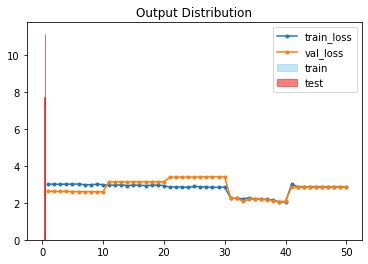

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_63_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_0_63_10


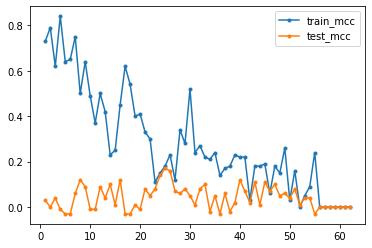

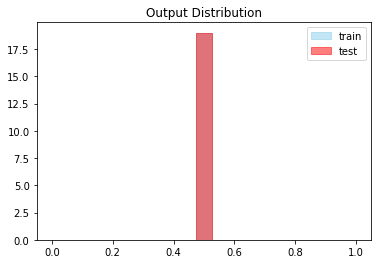




Global Iteration: (1/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9142 - acc: 0.1042 - val_loss: 3.1480 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9612 - acc: 0.2167 - val_loss: 3.1504 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9268 - acc: 0.2083 - val_loss: 3.1523 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9174 - acc: 0.1475 - val_loss: 3.1716 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8442 - acc: 0.4133 - val_loss: 3.2344 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9312 - acc: 0.4

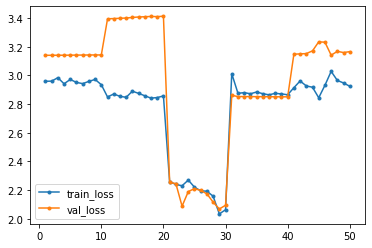

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_0_10


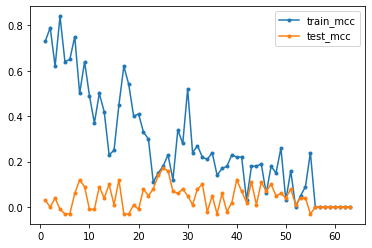

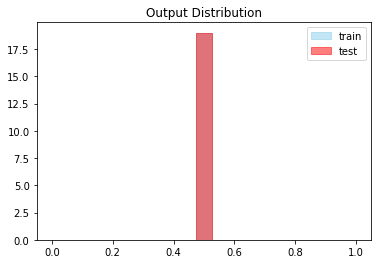




Global Iteration: (1/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5232 - acc: 0.1783 - val_loss: 2.2189 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5432 - acc: 0.1600 - val_loss: 2.2057 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5315 - acc: 0.1183 - val_loss: 2.2172 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4993 - acc: 0.3550 - val_loss: 2.1351 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7409 - acc: 0.5408 - val_loss: 2.1725 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5272 - acc: 0.2

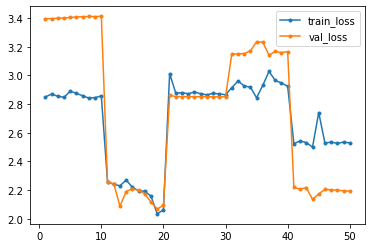

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_1_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_1_10


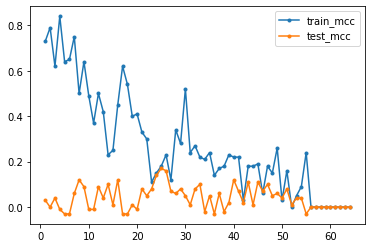

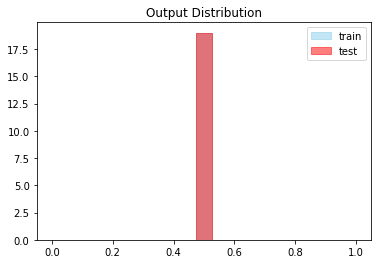




Global Iteration: (1/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Failed:  (2, 'train2.h5')



Global Iteration: (1/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 151ms/step - loss: 2.4135 - acc: 0.4400 - val_loss: 3.4801 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 148ms/step - loss: 2.4083 - acc: 0.5108 - val_loss: 3.4861 - val_acc: 0.9689
Epoch 3/10
12/12 [==============================] - 2s 149ms/step - loss: 2.4110 - acc: 0.6500 - val_loss: 3.4920 - val_acc: 0.9689
Epoch 4/10
12/12 [==============================] - 2s 145ms/step - loss: 2.4097 - acc: 0.7833 - val_loss: 3.4976 - val_acc: 0.9689
Epoch 5/10
12/12 [==============================] - 2s 148ms/step - loss: 2.4001 

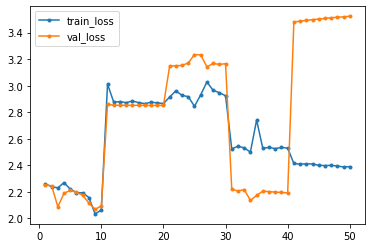

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_3_10


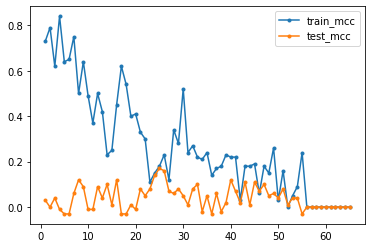

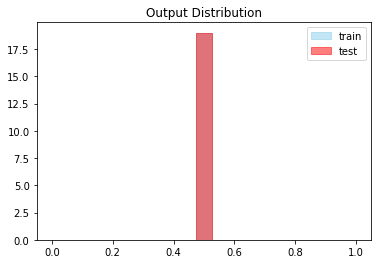




Global Iteration: (1/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2175 - acc: 0.9875 - val_loss: 2.8612 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.1935 - acc: 0.9825 - val_loss: 2.9213 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2193 - acc: 0.9800 - val_loss: 2.9147 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.2142 - acc: 0.9883 - val_loss: 2.8707 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.2226 - acc: 0.9875 - val_loss: 2.9063 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.2063 - acc: 0.9

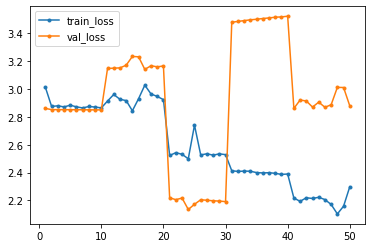

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_4_10


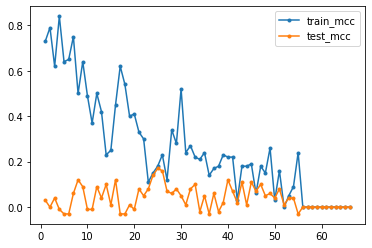

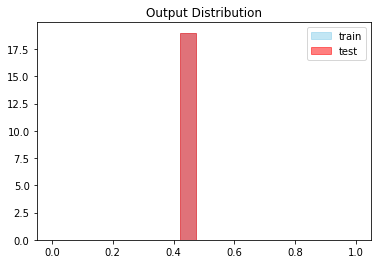




Global Iteration: (1/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9354 - acc: 0.8867 - val_loss: 2.3887 - val_acc: 0.9850
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9275 - acc: 0.9683 - val_loss: 2.3839 - val_acc: 0.9850
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9260 - acc: 0.9775 - val_loss: 2.3854 - val_acc: 0.9850
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9275 - acc: 0.9775 - val_loss: 2.3872 - val_acc: 0.9850
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9297 - acc: 0.9775 - val_loss: 2.3883 - val_acc: 0.9850
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9142 - acc: 0.9

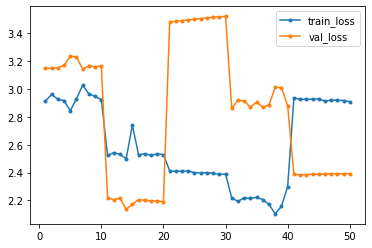

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_5_10


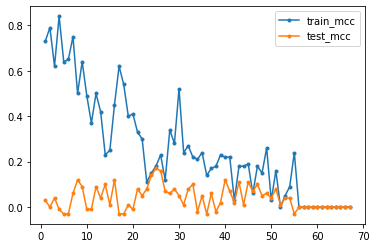

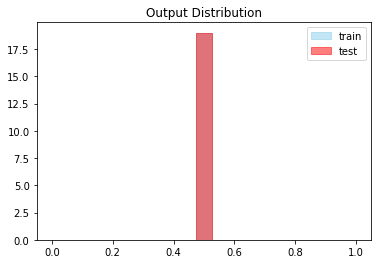




Global Iteration: (1/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1555 - acc: 0.9742 - val_loss: 3.2022 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1418 - acc: 0.9692 - val_loss: 3.1982 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1424 - acc: 0.9108 - val_loss: 3.1952 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1376 - acc: 0.8775 - val_loss: 3.1919 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1288 - acc: 0.7625 - val_loss: 3.1878 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1311 - acc: 0.5

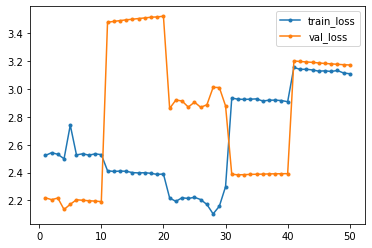

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_6_10


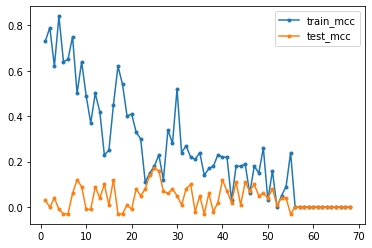

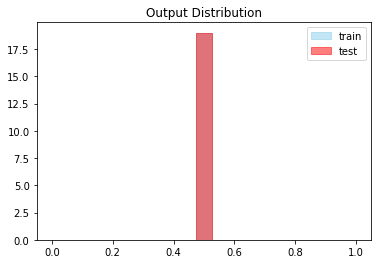




Global Iteration: (1/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8968 - acc: 0.2033 - val_loss: 2.5239 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9096 - acc: 0.1692 - val_loss: 2.5344 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9613 - acc: 0.2092 - val_loss: 2.5245 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9005 - acc: 0.1517 - val_loss: 2.5252 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9094 - acc: 0.1317 - val_loss: 2.5259 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8972 - acc: 0.1

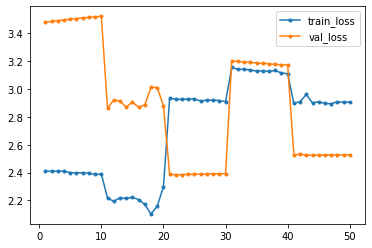

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_7_10


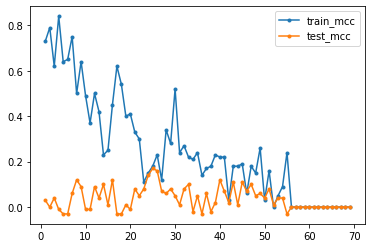

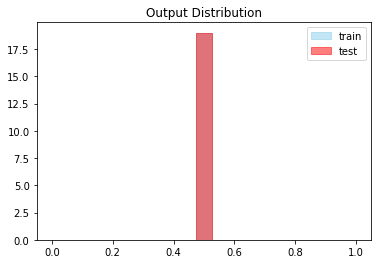




Global Iteration: (1/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5149 - acc: 0.0967 - val_loss: 2.2087 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5188 - acc: 0.1258 - val_loss: 2.2062 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5275 - acc: 0.1317 - val_loss: 2.2027 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5144 - acc: 0.1575 - val_loss: 2.2004 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5129 - acc: 0.1600 - val_loss: 2.1982 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5351 - acc: 0.1

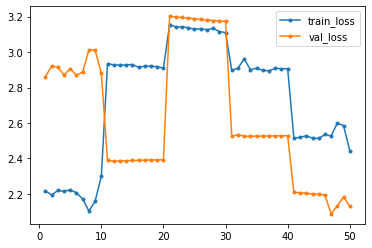

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_8_10


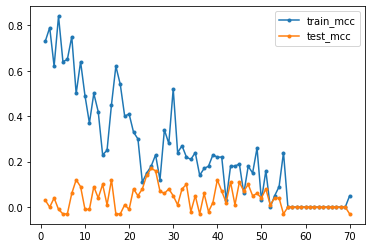

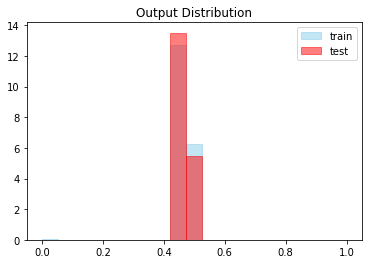




Global Iteration: (1/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5854 - acc: 0.6833 - val_loss: 2.4176 - val_acc: 0.9250
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5346 - acc: 0.6475 - val_loss: 2.4285 - val_acc: 0.9017
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5618 - acc: 0.6692 - val_loss: 2.4121 - val_acc: 0.8767
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4752 - acc: 0.7267 - val_loss: 2.4136 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5712 - acc: 0.6708 - val_loss: 2.4735 - val_acc: 0.7350
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5644 - acc: 0.4

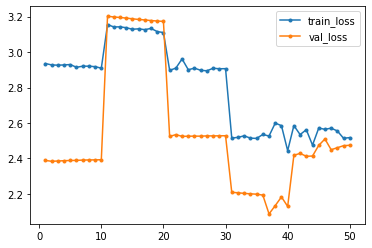

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_9_10


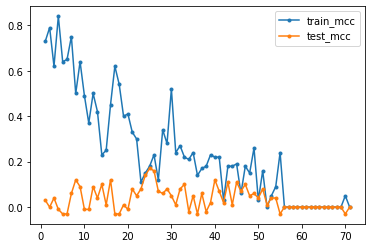

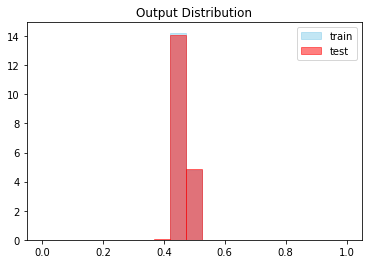




Global Iteration: (1/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.9016 - acc: 0.7558 - val_loss: 2.6968 - val_acc: 0.6300
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0135 - acc: 0.4325 - val_loss: 2.7246 - val_acc: 0.3433
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8902 - acc: 0.4833 - val_loss: 2.7096 - val_acc: 0.7567
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8930 - acc: 0.5775 - val_loss: 2.6829 - val_acc: 0.7200
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8357 - acc: 0.4417 - val_loss: 2.6972 - val_acc: 0.1717
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8557 - acc: 0

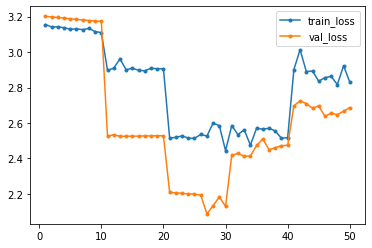

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_10_10


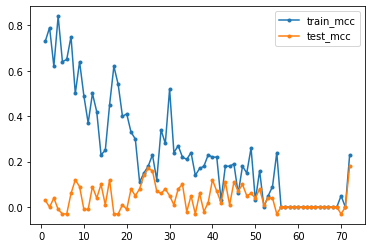

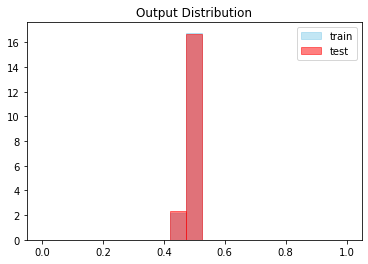




Global Iteration: (1/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Failed:  (11, 'train11.h5')



Global Iteration: (1/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8856 - acc: 0.4558 - val_loss: 2.1740 - val_acc: 0.6583
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8540 - acc: 0.4133 - val_loss: 2.1674 - val_acc: 0.7783
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7814 - acc: 0.4817 - val_loss: 2.1231 - val_acc: 0.9250
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8855 - acc: 0.4425 - val_loss: 2.2192 - val_acc: 0.1017
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8167 - acc: 0.3458 -

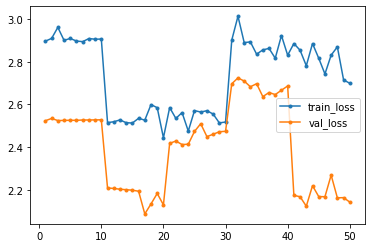

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_12_10


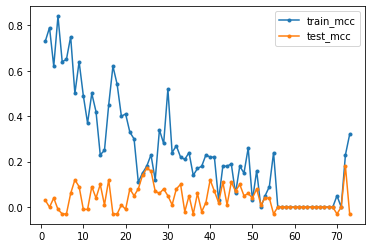

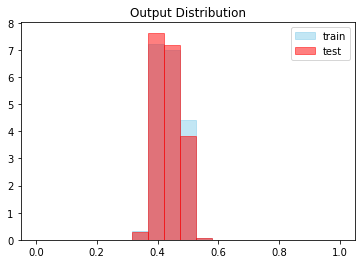




Global Iteration: (1/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8142 - acc: 0.3750 - val_loss: 3.0359 - val_acc: 0.1033
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6758 - acc: 0.3533 - val_loss: 3.0950 - val_acc: 0.7750
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6767 - acc: 0.4958 - val_loss: 3.1461 - val_acc: 0.8950
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7872 - acc: 0.5433 - val_loss: 3.0765 - val_acc: 0.4717
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6118 - acc: 0.4500 - val_loss: 3.1940 - val_acc: 0.8533
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8277 - acc: 0

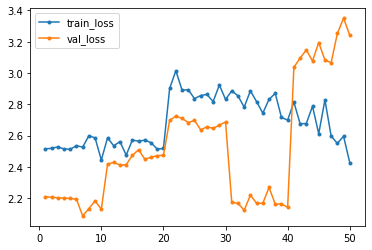

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_13_10


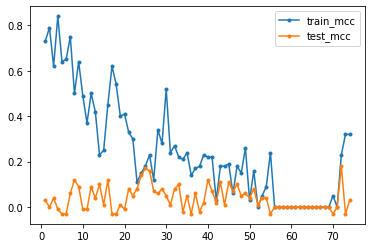

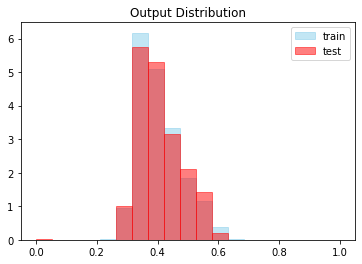




Global Iteration: (1/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8221 - acc: 0.4867 - val_loss: 2.4042 - val_acc: 0.3867
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9438 - acc: 0.1725 - val_loss: 2.4257 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9946 - acc: 0.3108 - val_loss: 2.4117 - val_acc: 0.0283
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9328 - acc: 0.2917 - val_loss: 2.4162 - val_acc: 0.0283
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.9364 - acc: 0.0767 - val_loss: 2.4536 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9123 - acc: 0

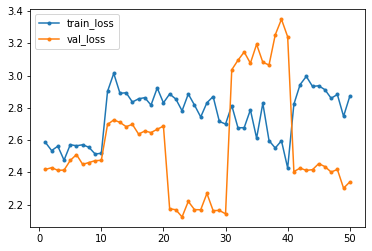

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_14_10


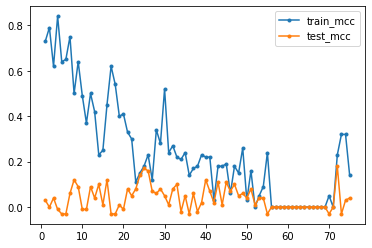

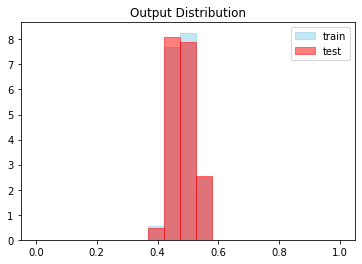




Global Iteration: (1/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5212 - acc: 0.1525 - val_loss: 2.6511 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4923 - acc: 0.0158 - val_loss: 2.6473 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4979 - acc: 0.0158 - val_loss: 2.6446 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4947 - acc: 0.0158 - val_loss: 2.6418 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4855 - acc: 0.0158 - val_loss: 2.6392 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4772 - acc: 0

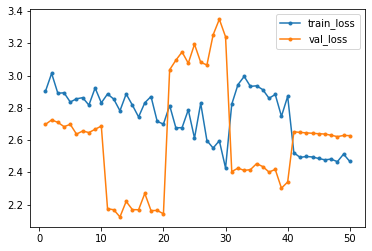

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_15_10


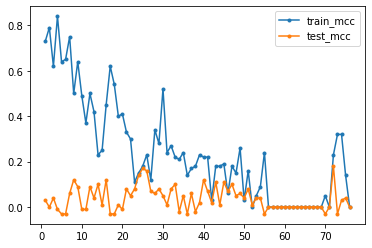

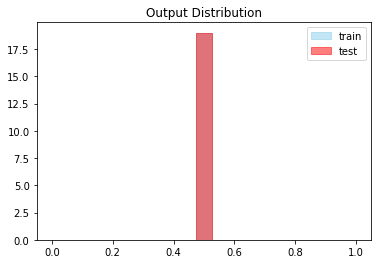




Global Iteration: (1/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Failed:  (16, 'train16.h5')



Global Iteration: (1/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0355 - acc: 0.2833 - val_loss: 2.5371 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0105 - acc: 0.0842 - val_loss: 2.5243 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0046 - acc: 0.0242 - val_loss: 2.5258 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0016 - acc: 0.0242 - val_loss: 2.5265 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3

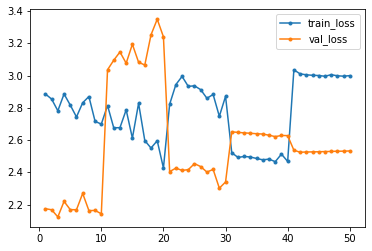

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_17_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_17_10


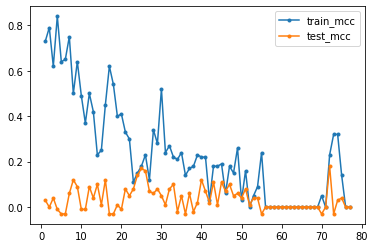

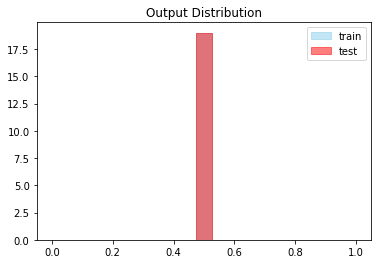




Global Iteration: (1/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0380 - acc: 0.0267 - val_loss: 2.7395 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0584 - acc: 0.2050 - val_loss: 2.7406 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1215 - acc: 0.2067 - val_loss: 2.7268 - val_acc: 0.8767
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0560 - acc: 0.4650 - val_loss: 2.7313 - val_acc: 0.5133
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0736 - acc: 0.1142 - val_loss: 2.7421 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0368 - acc: 0

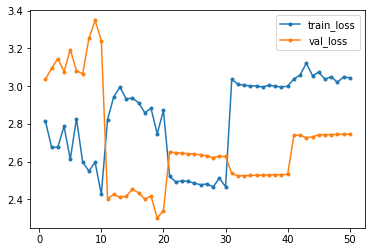

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_18_10


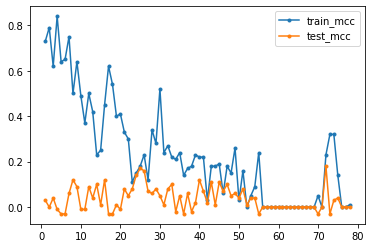

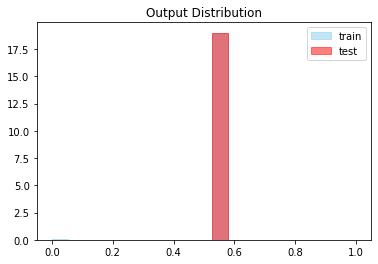




Global Iteration: (1/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6054 - acc: 0.0175 - val_loss: 3.1422 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5947 - acc: 0.0175 - val_loss: 3.1434 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5934 - acc: 0.0175 - val_loss: 3.1454 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5982 - acc: 0.0175 - val_loss: 3.1475 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5915 - acc: 0.0175 - val_loss: 3.1499 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5848 - acc: 0

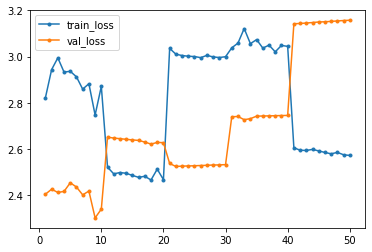

Failed:  (19, 'train19.h5')



Global Iteration: (1/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.9981 - acc: 0.0242 - val_loss: 2.2063 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0051 - acc: 0.0242 - val_loss: 2.2082 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9987 - acc: 0.0242 - val_loss: 2.2096 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0029 - acc: 0.0242 - val_loss: 2.2125 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9928 - acc: 0.0242 - val_loss: 2.2143 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 166ms/

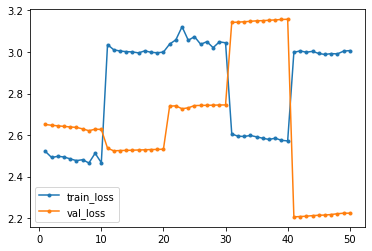

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_20_10


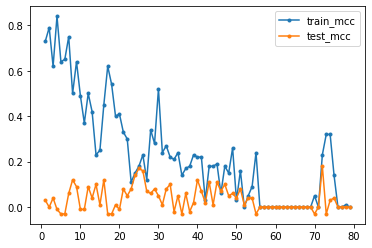

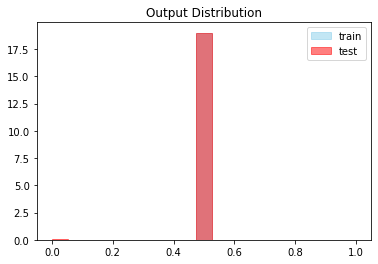




Global Iteration: (1/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9896 - acc: 0.0242 - val_loss: 2.2250 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9933 - acc: 0.0242 - val_loss: 2.2271 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0044 - acc: 0.0242 - val_loss: 2.2278 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9839 - acc: 0.0242 - val_loss: 2.2303 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9938 - acc: 0.0242 - val_loss: 2.2312 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9938 - acc: 0

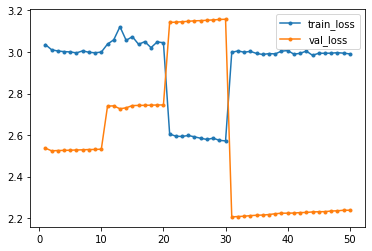

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_21_10


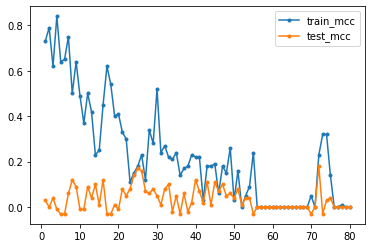

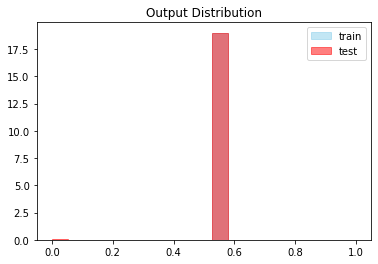




Global Iteration: (1/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0387 - acc: 0.0267 - val_loss: 3.0418 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0445 - acc: 0.0267 - val_loss: 3.0418 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0277 - acc: 0.0267 - val_loss: 3.0392 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0418 - acc: 0.1067 - val_loss: 3.0375 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0456 - acc: 0.1583 - val_loss: 3.0370 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0400 - acc: 0

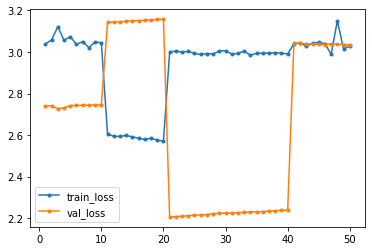

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_22_10


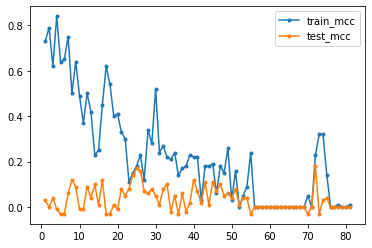

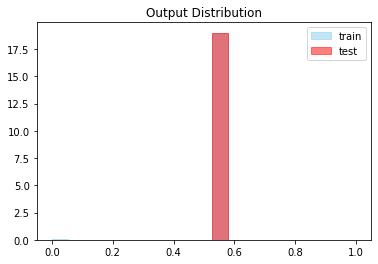




Global Iteration: (1/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8434 - acc: 0.0217 - val_loss: 3.1339 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8555 - acc: 0.0217 - val_loss: 3.1357 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8350 - acc: 0.0217 - val_loss: 3.1381 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8468 - acc: 0.0217 - val_loss: 3.1390 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8277 - acc: 0.0217 - val_loss: 3.1388 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8470 - acc: 0

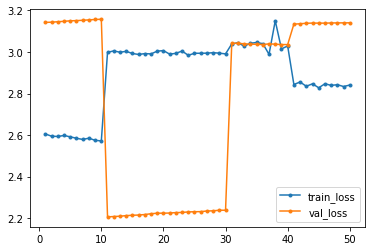

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_23_10


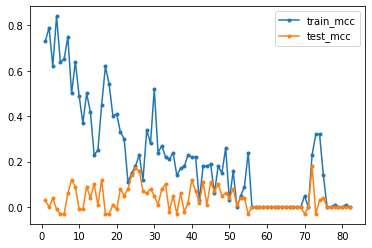

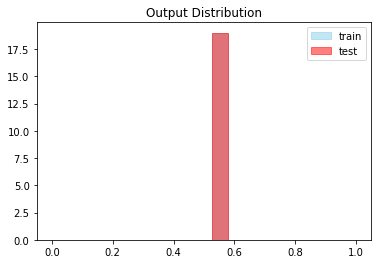




Global Iteration: (1/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5852 - acc: 0.0175 - val_loss: 2.8410 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5869 - acc: 0.0175 - val_loss: 2.8405 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5919 - acc: 0.0175 - val_loss: 2.8401 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5778 - acc: 0.0175 - val_loss: 2.8398 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5843 - acc: 0.0175 - val_loss: 2.8396 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5790 - acc: 0

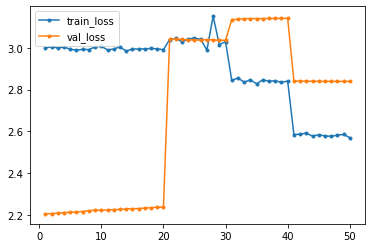

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_24_10


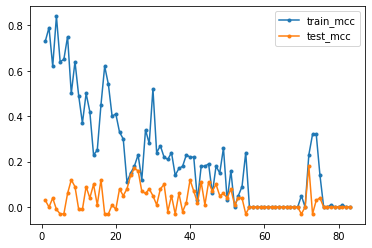

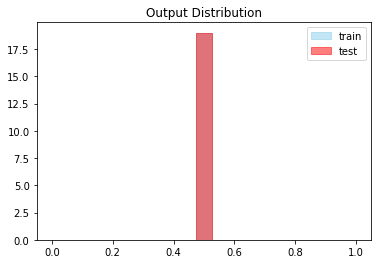




Global Iteration: (1/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4247 - acc: 0.0150 - val_loss: 2.7331 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 2.4149 - acc: 0.0292 - val_loss: 2.7325 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4104 - acc: 0.0517 - val_loss: 2.7321 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.4013 - acc: 0.0742 - val_loss: 2.7318 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4091 - acc: 0.1783 - val_loss: 2.7315 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3954 - acc: 0

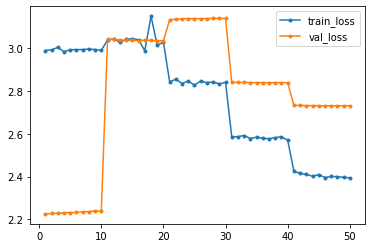

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_25_10


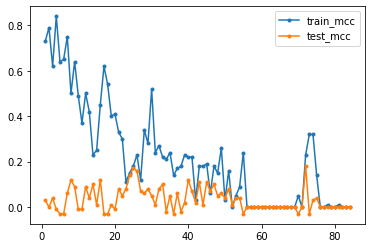

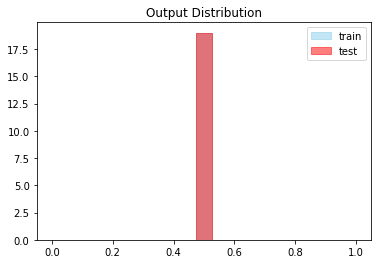




Global Iteration: (1/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7872 - acc: 0.9000 - val_loss: 2.1656 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7850 - acc: 0.8942 - val_loss: 2.1655 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7859 - acc: 0.8633 - val_loss: 2.1662 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7975 - acc: 0.8508 - val_loss: 2.1661 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7862 - acc: 0.8725 - val_loss: 2.1663 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7877 - acc: 0

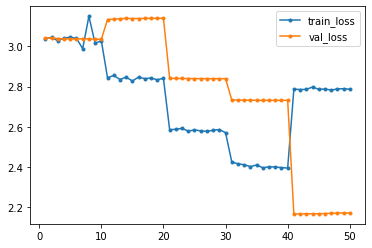

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_26_10


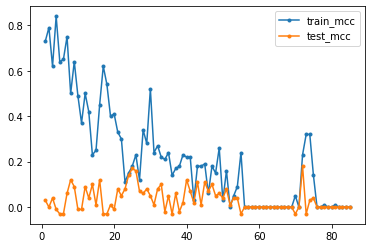

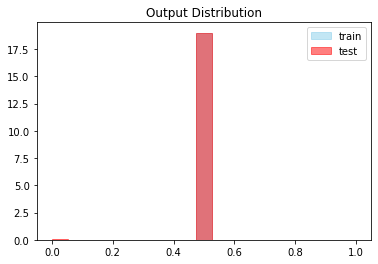




Global Iteration: (1/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 148ms/step - loss: 3.1756 - acc: 0.6958 - val_loss: 3.4740 - val_acc: 0.9689
Epoch 2/10
12/12 [==============================] - 2s 147ms/step - loss: 3.1796 - acc: 0.5083 - val_loss: 3.4690 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 145ms/step - loss: 3.1697 - acc: 0.3550 - val_loss: 3.4639 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 147ms/step - loss: 3.1623 - acc: 0.2200 - val_loss: 3.4576 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 145ms/step - loss: 3.1596 - acc: 0.1133 - val_loss: 3.4518 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 147ms/step - loss: 3.1648 - acc: 0

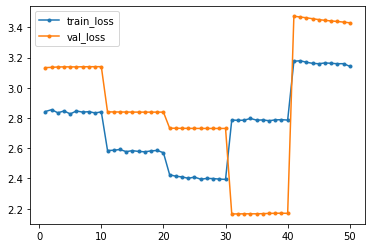

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_27_10


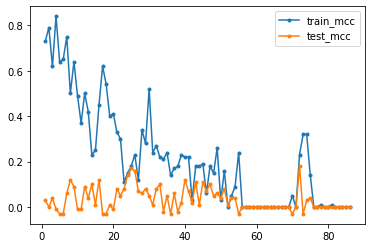

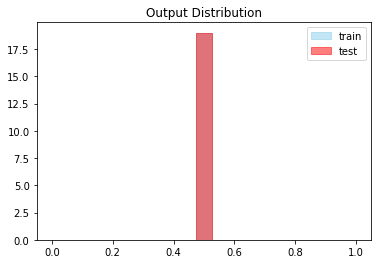




Global Iteration: (1/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0059 - acc: 0.0242 - val_loss: 2.8378 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9849 - acc: 0.0242 - val_loss: 2.8378 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 163ms/step - loss: 3.0005 - acc: 0.0242 - val_loss: 2.8378 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9949 - acc: 0.0242 - val_loss: 2.8378 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9948 - acc: 0.0242 - val_loss: 2.8378 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0002 - acc: 0

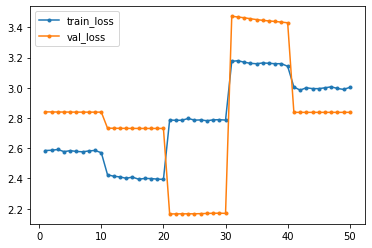

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_28_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_28_10


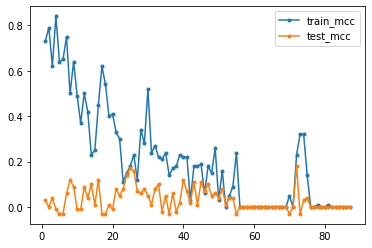

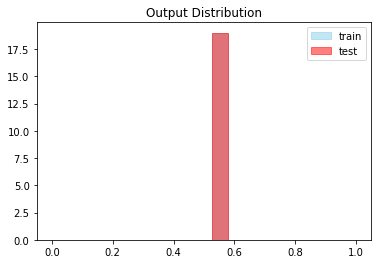




Global Iteration: (1/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9431 - acc: 0.0233 - val_loss: 2.5323 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9504 - acc: 0.0233 - val_loss: 2.5321 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9336 - acc: 0.0233 - val_loss: 2.5332 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9364 - acc: 0.0233 - val_loss: 2.5333 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9532 - acc: 0.0233 - val_loss: 2.5330 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9411 - acc: 0

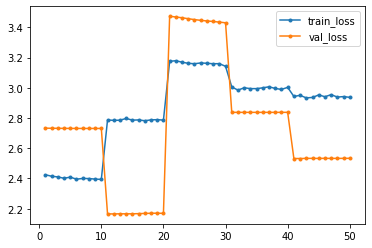

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_29_10


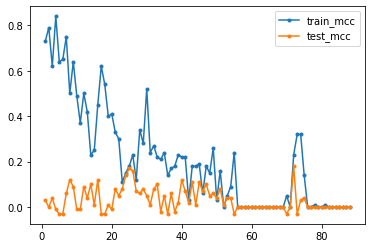

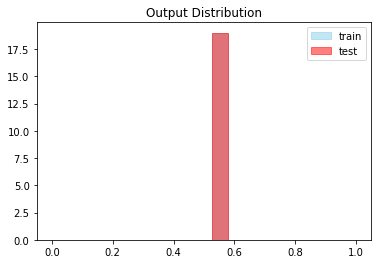




Global Iteration: (1/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8465 - acc: 0.0225 - val_loss: 2.8377 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8462 - acc: 0.0225 - val_loss: 2.8376 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8282 - acc: 0.0225 - val_loss: 2.8375 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8358 - acc: 0.0225 - val_loss: 2.8374 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8287 - acc: 0.0225 - val_loss: 2.8373 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8325 - acc: 0

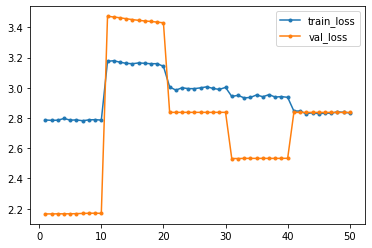

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_30_10


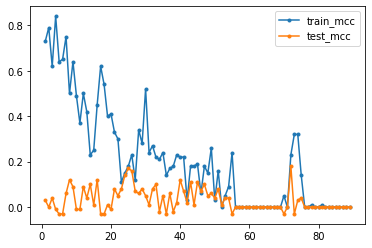

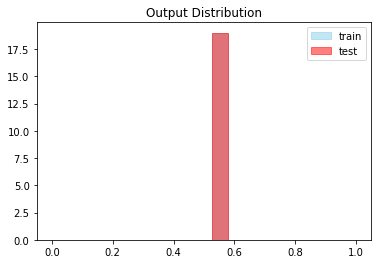




Global Iteration: (1/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7328 - acc: 0.0200 - val_loss: 2.6325 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7380 - acc: 0.0200 - val_loss: 2.6324 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7392 - acc: 0.0200 - val_loss: 2.6317 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7381 - acc: 0.0200 - val_loss: 2.6305 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7304 - acc: 0.0200 - val_loss: 2.6295 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7283 - acc: 0

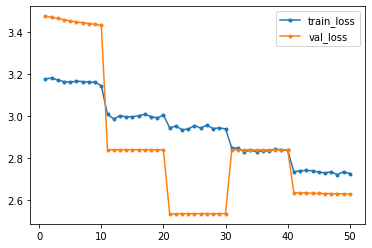

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_31_10


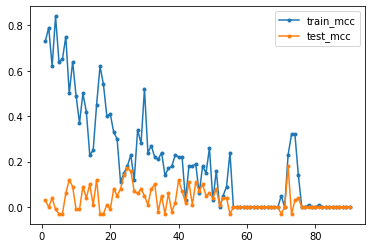

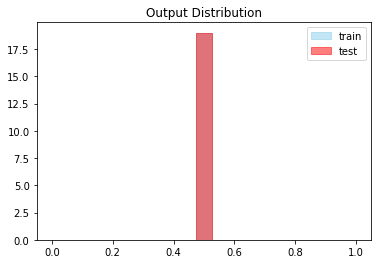




Global Iteration: (1/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6279 - acc: 0.0183 - val_loss: 2.2087 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6213 - acc: 0.0183 - val_loss: 2.2065 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6253 - acc: 0.0183 - val_loss: 2.2052 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6328 - acc: 0.0183 - val_loss: 2.2035 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6277 - acc: 0.0183 - val_loss: 2.2004 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6237 - acc: 0

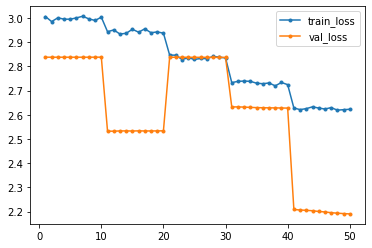

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_32_10


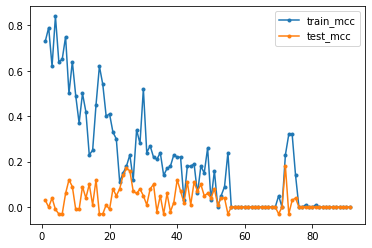

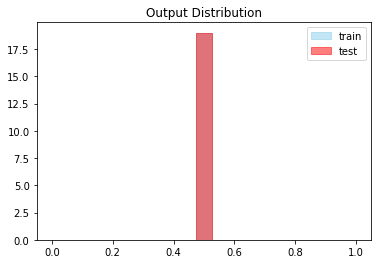




Global Iteration: (1/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3130 - acc: 0.0300 - val_loss: 2.1929 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3207 - acc: 0.0300 - val_loss: 2.1966 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3052 - acc: 0.0300 - val_loss: 2.2012 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3127 - acc: 0.0300 - val_loss: 2.2081 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3048 - acc: 0.0300 - val_loss: 2.2137 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3080 - acc: 0

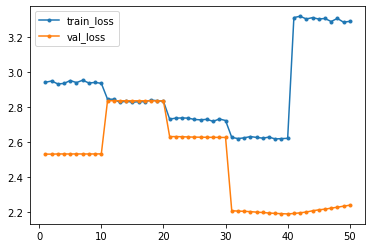

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_33_10


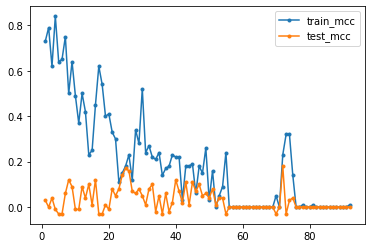

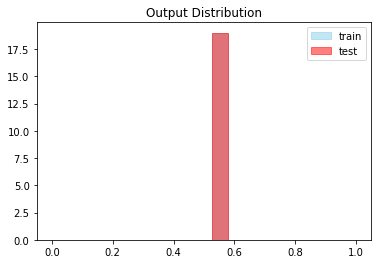




Global Iteration: (1/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5807 - acc: 0.0175 - val_loss: 2.8375 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5953 - acc: 0.0175 - val_loss: 2.8370 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6004 - acc: 0.0583 - val_loss: 2.8358 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5731 - acc: 0.0175 - val_loss: 2.8354 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5831 - acc: 0.0200 - val_loss: 2.8357 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5102 - acc: 0

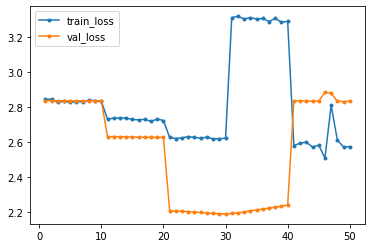

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_34_10


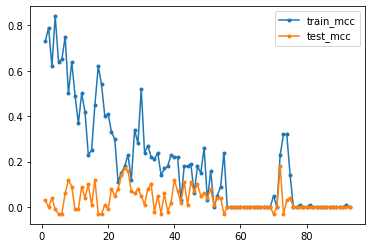

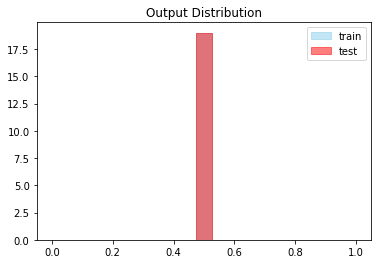




Global Iteration: (1/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7884 - acc: 0.0208 - val_loss: 2.8353 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7866 - acc: 0.0208 - val_loss: 2.8353 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7772 - acc: 0.0208 - val_loss: 2.8352 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7813 - acc: 0.0208 - val_loss: 2.8352 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7835 - acc: 0.0208 - val_loss: 2.8351 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7842 - acc: 0

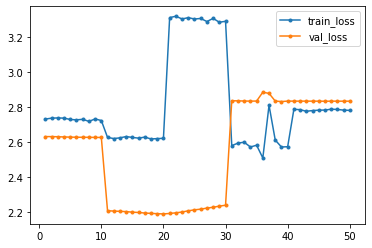

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_35_10


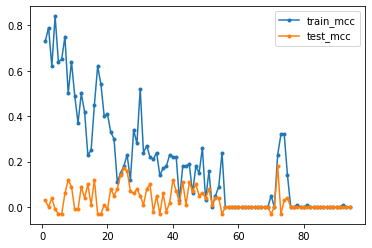

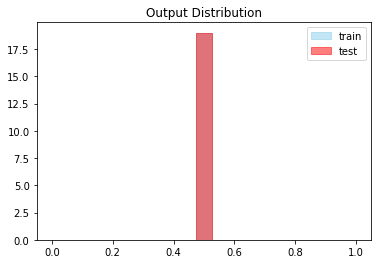




Global Iteration: (1/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6196 - acc: 0.0183 - val_loss: 2.4161 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6319 - acc: 0.0183 - val_loss: 2.4141 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6310 - acc: 0.0183 - val_loss: 2.4116 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6235 - acc: 0.0183 - val_loss: 2.4102 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6289 - acc: 0.0183 - val_loss: 2.4085 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6259 - acc: 0

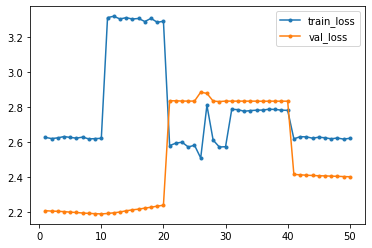

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_36_10


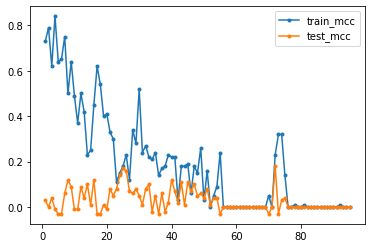

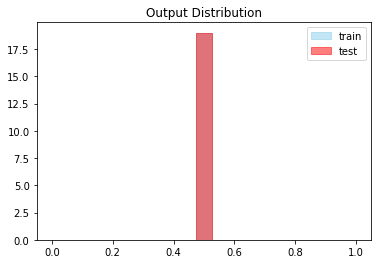




Global Iteration: (1/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5634 - acc: 0.0175 - val_loss: 3.1617 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5597 - acc: 0.0558 - val_loss: 3.1622 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5632 - acc: 0.1133 - val_loss: 3.1638 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5650 - acc: 0.1450 - val_loss: 3.1651 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5552 - acc: 0.1425 - val_loss: 3.1661 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5619 - acc: 0

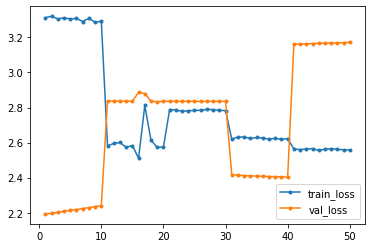

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_37_10


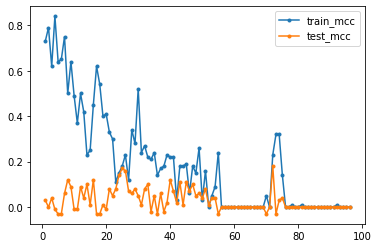

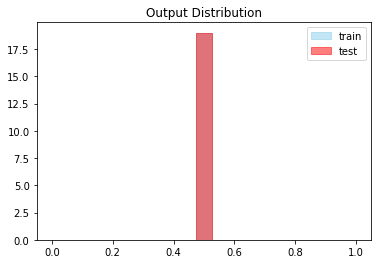




Global Iteration: (1/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4483 - acc: 0.5950 - val_loss: 2.1693 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4482 - acc: 0.7858 - val_loss: 2.1683 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4480 - acc: 0.8433 - val_loss: 2.1662 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4427 - acc: 0.9008 - val_loss: 2.1644 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4451 - acc: 0.9375 - val_loss: 2.1627 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4457 - acc: 0

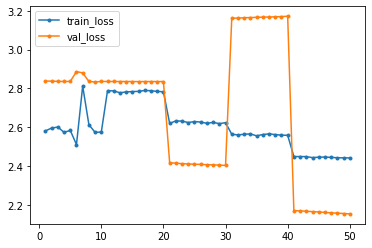

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_38_10


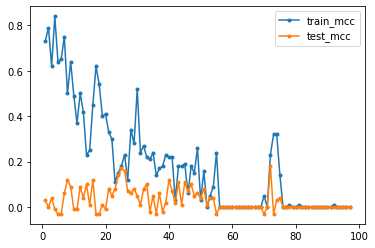

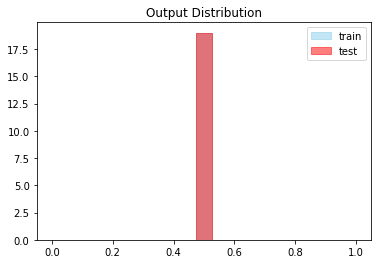




Global Iteration: (1/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0176 - acc: 0.9758 - val_loss: 2.8425 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0152 - acc: 0.9758 - val_loss: 2.8419 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0158 - acc: 0.9758 - val_loss: 2.8411 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0128 - acc: 0.9758 - val_loss: 2.8405 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0101 - acc: 0.9758 - val_loss: 2.8399 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0066 - acc: 0

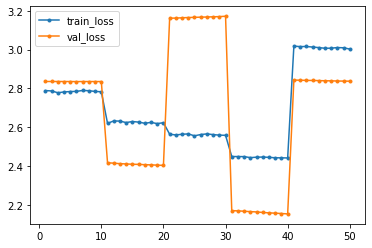

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_39_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_39_10


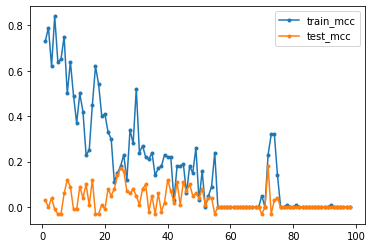

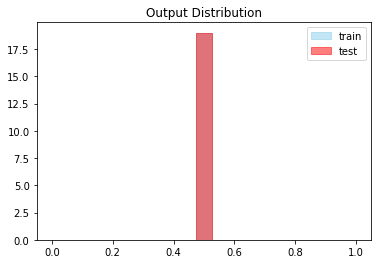




Global Iteration: (1/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5051 - acc: 0.4383 - val_loss: 3.1688 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5026 - acc: 0.4175 - val_loss: 3.1688 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5060 - acc: 0.4600 - val_loss: 3.1696 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5046 - acc: 0.5683 - val_loss: 3.1715 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5020 - acc: 0.7408 - val_loss: 3.1729 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5038 - acc: 0

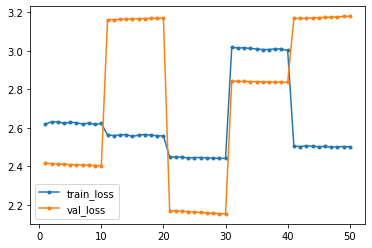

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_40_10


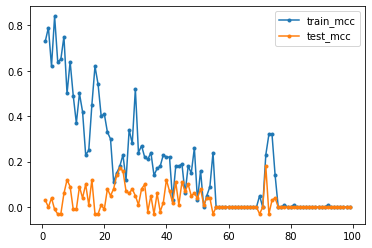

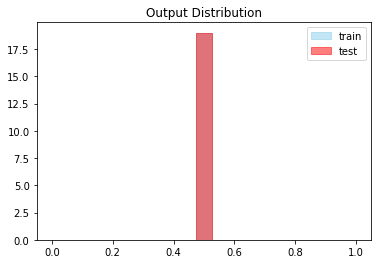




Global Iteration: (1/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8957 - acc: 0.9775 - val_loss: 3.0662 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8941 - acc: 0.9775 - val_loss: 3.0652 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8931 - acc: 0.9775 - val_loss: 3.0640 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8933 - acc: 0.9483 - val_loss: 3.0627 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8916 - acc: 0.8683 - val_loss: 3.0617 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8955 - acc: 0

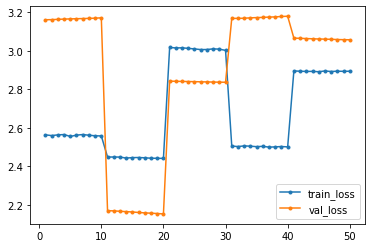

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_41_10


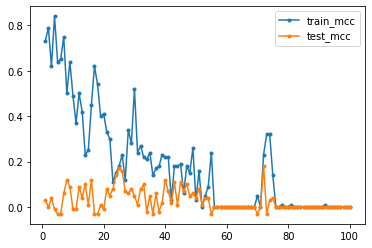

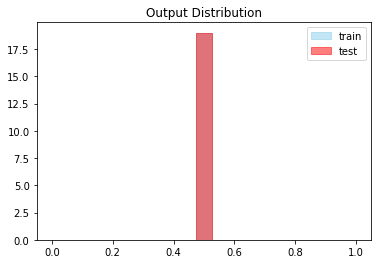




Global Iteration: (1/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5050 - acc: 0.4717 - val_loss: 2.7255 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5082 - acc: 0.4983 - val_loss: 2.7255 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5027 - acc: 0.6117 - val_loss: 2.7255 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5007 - acc: 0.7808 - val_loss: 2.7255 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5083 - acc: 0.8650 - val_loss: 2.7255 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5006 - acc: 0

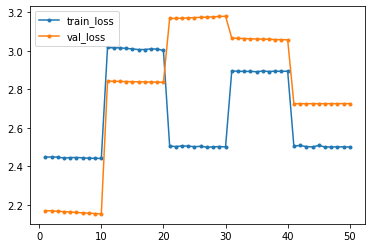

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_42_10


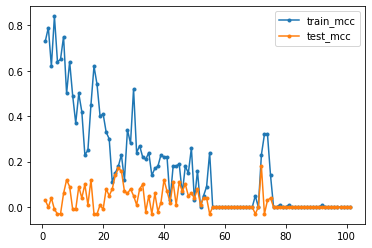

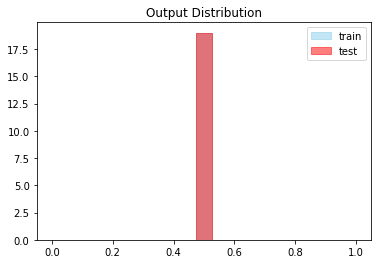




Global Iteration: (1/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9533 - acc: 0.9767 - val_loss: 2.1561 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9559 - acc: 0.9767 - val_loss: 2.1566 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9549 - acc: 0.9767 - val_loss: 2.1586 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9489 - acc: 0.9767 - val_loss: 2.1608 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9506 - acc: 0.9700 - val_loss: 2.1624 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9505 - acc: 0

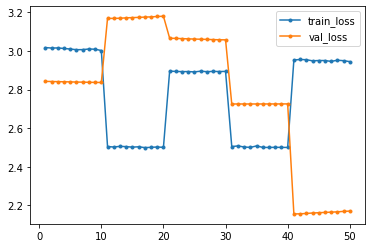

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_43_10


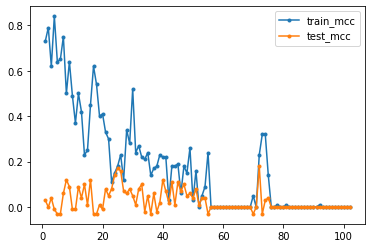

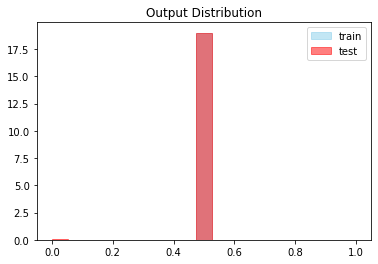




Global Iteration: (1/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6149 - acc: 0.3042 - val_loss: 2.5044 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6163 - acc: 0.3208 - val_loss: 2.5040 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6165 - acc: 0.3550 - val_loss: 2.5037 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6129 - acc: 0.4058 - val_loss: 2.5033 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6134 - acc: 0.5100 - val_loss: 2.5028 - val_acc: 0.9833
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6147 - acc: 0

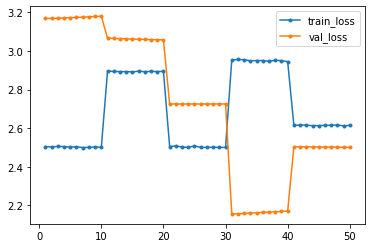

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_44_10


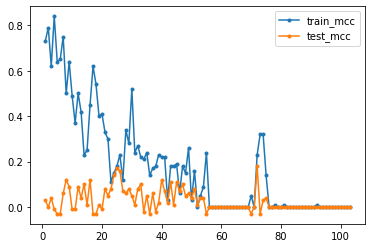

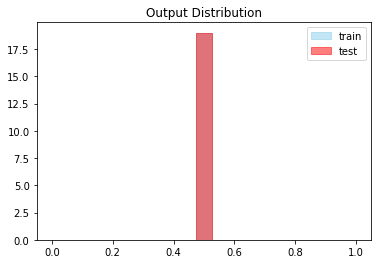




Global Iteration: (1/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7272 - acc: 0.9325 - val_loss: 2.7248 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7250 - acc: 0.9367 - val_loss: 2.7248 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7232 - acc: 0.9542 - val_loss: 2.7247 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7252 - acc: 0.9417 - val_loss: 2.7247 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7250 - acc: 0.9400 - val_loss: 2.7247 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7243 - acc: 0

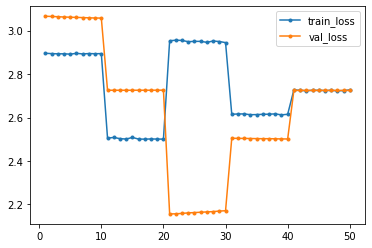

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_45_10


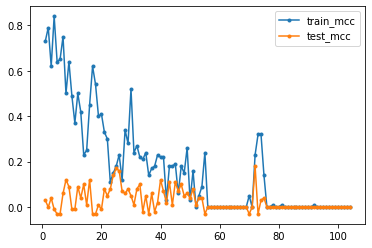

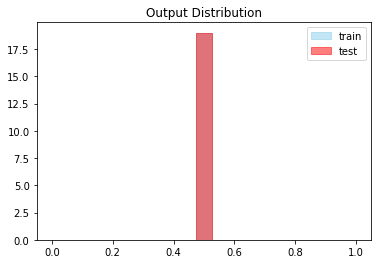




Global Iteration: (1/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 3.1681 - acc: 0.8350 - val_loss: 2.1673 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1696 - acc: 0.6217 - val_loss: 2.1704 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1642 - acc: 0.3408 - val_loss: 2.1742 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1643 - acc: 0.1408 - val_loss: 2.1773 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1641 - acc: 0.0525 - val_loss: 2.1804 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1594 - acc: 0

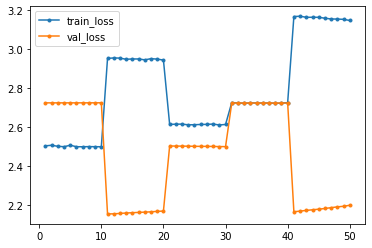

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_46_10


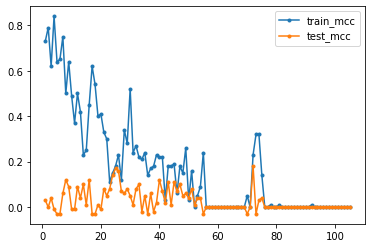

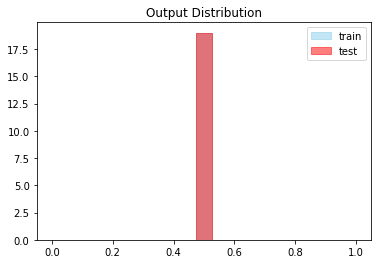




Global Iteration: (1/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9365 - acc: 0.0233 - val_loss: 3.0389 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9372 - acc: 0.0233 - val_loss: 3.0385 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9423 - acc: 0.0233 - val_loss: 3.0380 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9407 - acc: 0.0233 - val_loss: 3.0375 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9351 - acc: 0.0233 - val_loss: 3.0377 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9313 - acc: 0

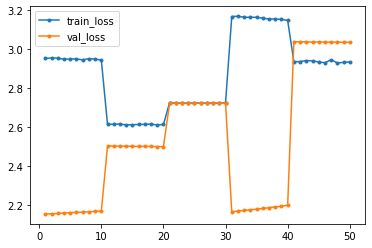

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_47_10


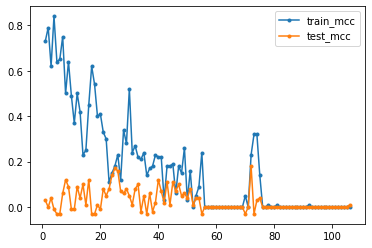

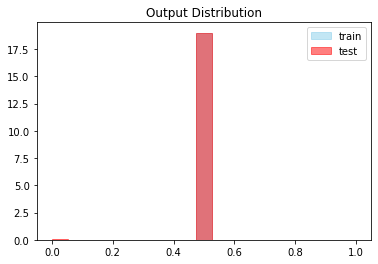




Global Iteration: (1/40) Set Number: (48/64) Epochs: 10  File: train48.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 3.2433 - acc: 0.0292 - val_loss: 2.8317 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.2439 - acc: 0.0292 - val_loss: 2.8319 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2422 - acc: 0.0292 - val_loss: 2.8323 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2474 - acc: 0.0517 - val_loss: 2.8323 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2287 - acc: 0.0292 - val_loss: 2.8344 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2599 - acc: 0

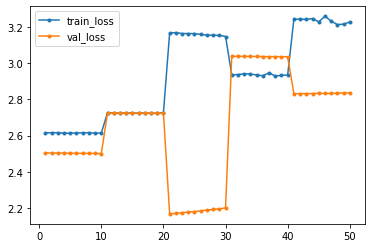

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_48_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_48_10


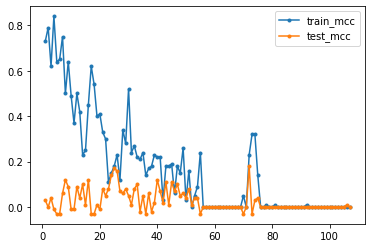

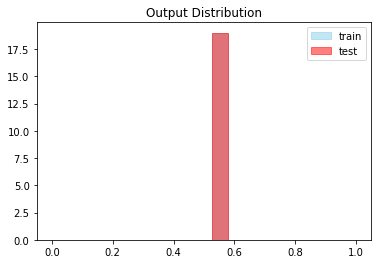




Global Iteration: (1/40) Set Number: (49/64) Epochs: 10  File: train49.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 3.2673 - acc: 0.0292 - val_loss: 3.0264 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2610 - acc: 0.0292 - val_loss: 3.0260 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2630 - acc: 0.0292 - val_loss: 3.0258 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 3.2788 - acc: 0.0292 - val_loss: 3.0256 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2811 - acc: 0.0292 - val_loss: 3.0255 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2578 - acc: 0

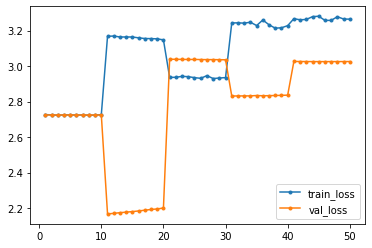

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_49_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_49_10


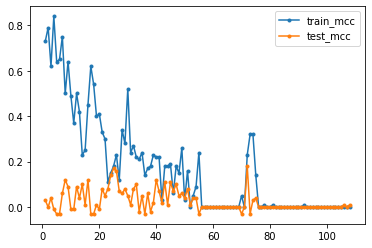

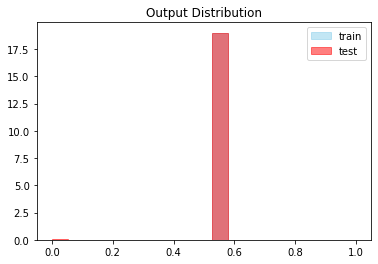




Global Iteration: (1/40) Set Number: (50/64) Epochs: 10  File: train50.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6220 - acc: 0.0183 - val_loss: 2.2973 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6203 - acc: 0.0183 - val_loss: 2.2874 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6067 - acc: 0.0183 - val_loss: 2.2776 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5976 - acc: 0.0183 - val_loss: 2.2684 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6159 - acc: 0.0183 - val_loss: 2.2608 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5829 - acc: 0

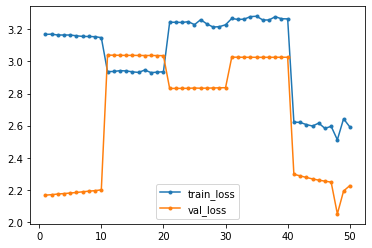

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_50_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_50_10


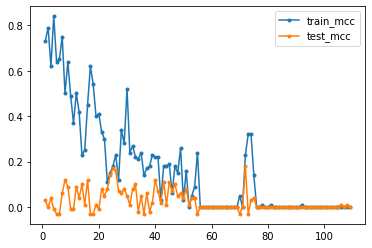

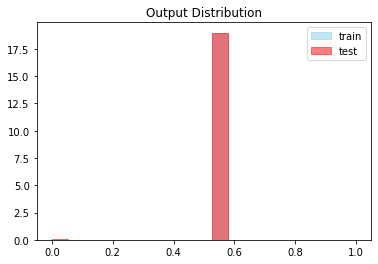




Global Iteration: (1/40) Set Number: (51/64) Epochs: 10  File: train51.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.52 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 3.0257 - acc: 0.0333 - val_loss: 3.0279 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0374 - acc: 0.0250 - val_loss: 3.0277 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0280 - acc: 0.0250 - val_loss: 3.0269 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0232 - acc: 0.0250 - val_loss: 3.0267 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0261 - acc: 0.0333 - val_loss: 3.0230 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0313 - acc: 0

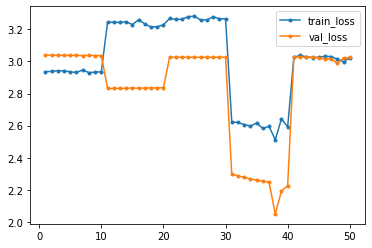

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_51_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_51_10


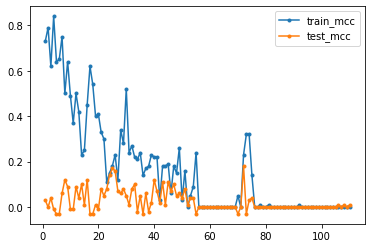

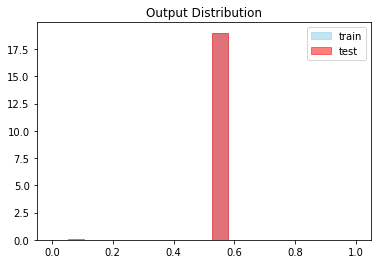




Global Iteration: (1/40) Set Number: (52/64) Epochs: 10  File: train52.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3714 - acc: 0.0467 - val_loss: 3.0282 - val_acc: 0.0850
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2965 - acc: 0.4225 - val_loss: 3.1241 - val_acc: 0.9483
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3169 - acc: 0.4400 - val_loss: 3.0467 - val_acc: 0.5117
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3321 - acc: 0.4433 - val_loss: 3.1096 - val_acc: 0.9417
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2757 - acc: 0.4417 - val_loss: 3.0306 - val_acc: 0.5317
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.2602 - acc: 0

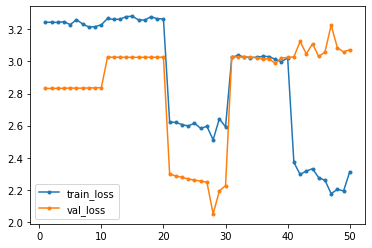

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_52_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_52_10


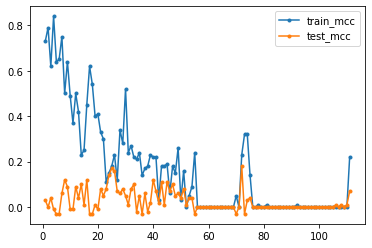

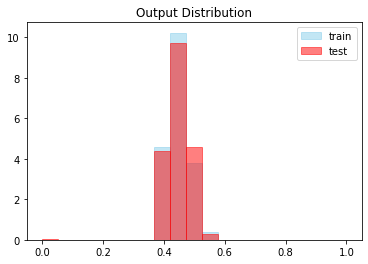




Global Iteration: (1/40) Set Number: (53/64) Epochs: 10  File: train53.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9543 - acc: 0.4233 - val_loss: 3.0284 - val_acc: 0.2117
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8571 - acc: 0.3408 - val_loss: 3.0290 - val_acc: 0.4767
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8065 - acc: 0.4317 - val_loss: 3.0351 - val_acc: 0.7983
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9956 - acc: 0.3592 - val_loss: 3.0302 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9293 - acc: 0.0233 - val_loss: 3.0302 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9318 - acc: 0

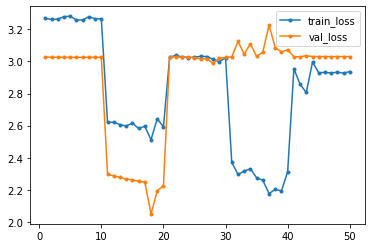

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_53_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_53_10


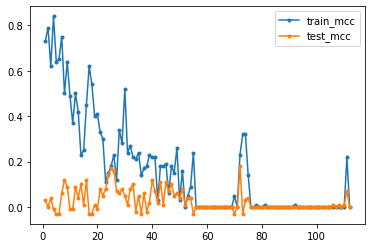

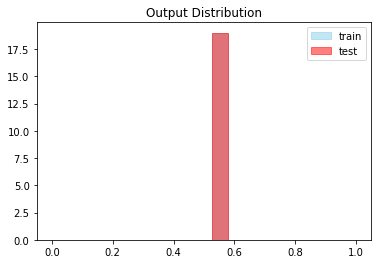




Global Iteration: (1/40) Set Number: (54/64) Epochs: 10  File: train54.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0276 - acc: 0.0250 - val_loss: 3.0301 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0292 - acc: 0.0250 - val_loss: 3.0296 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0363 - acc: 0.0250 - val_loss: 3.0295 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0410 - acc: 0.0250 - val_loss: 3.0298 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0374 - acc: 0.0250 - val_loss: 3.0295 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0322 - acc: 0

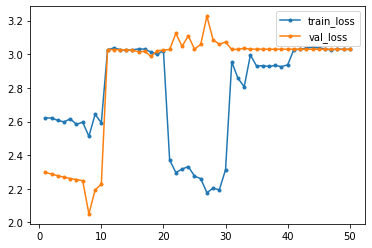

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_54_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_54_10


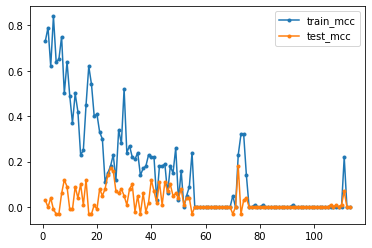

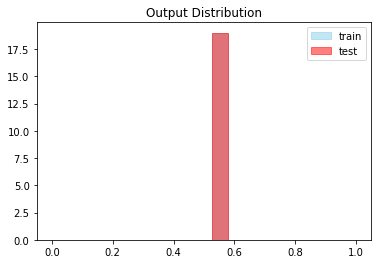




Global Iteration: (1/40) Set Number: (55/64) Epochs: 10  File: train55.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5371 - acc: 0.0167 - val_loss: 3.1267 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5414 - acc: 0.0167 - val_loss: 3.1281 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5420 - acc: 0.0167 - val_loss: 3.1298 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5239 - acc: 0.0167 - val_loss: 3.1315 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5237 - acc: 0.0167 - val_loss: 3.1332 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5293 - acc: 0

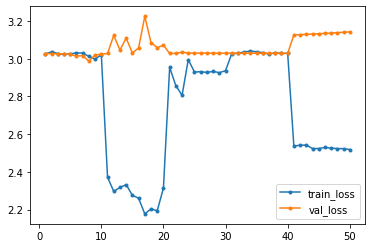

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_55_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_55_10


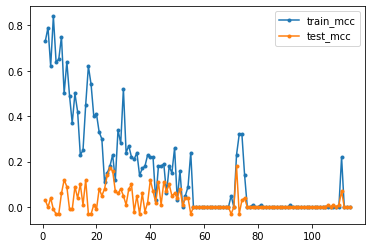

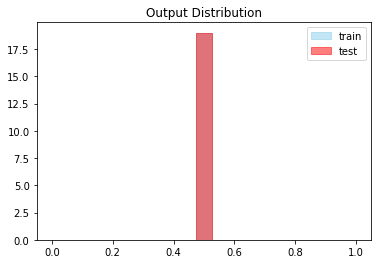




Global Iteration: (1/40) Set Number: (56/64) Epochs: 10  File: train56.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3113 - acc: 0.0133 - val_loss: 2.7249 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3066 - acc: 0.0133 - val_loss: 2.7242 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2955 - acc: 0.0133 - val_loss: 2.7237 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2949 - acc: 0.0133 - val_loss: 2.7232 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2942 - acc: 0.0133 - val_loss: 2.7229 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2915 - acc: 0

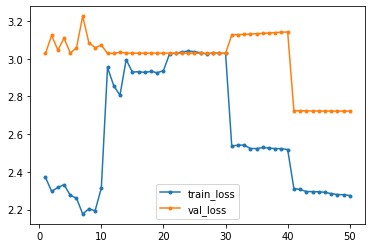

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_56_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_56_10


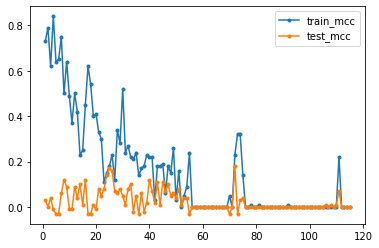

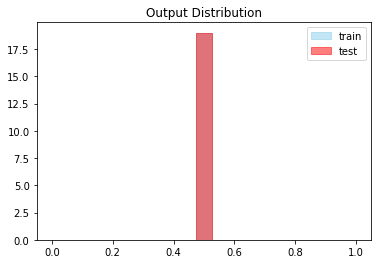




Global Iteration: (1/40) Set Number: (57/64) Epochs: 10  File: train57.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7203 - acc: 0.8950 - val_loss: 2.1610 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7247 - acc: 0.9525 - val_loss: 2.1601 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7248 - acc: 0.9800 - val_loss: 2.1596 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7229 - acc: 0.9800 - val_loss: 2.1598 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7191 - acc: 0.9800 - val_loss: 2.1599 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7220 - acc: 0

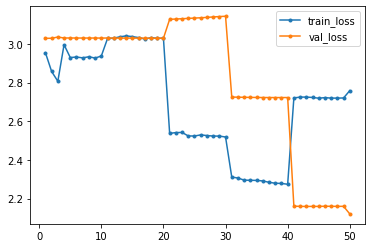

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_57_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_57_10


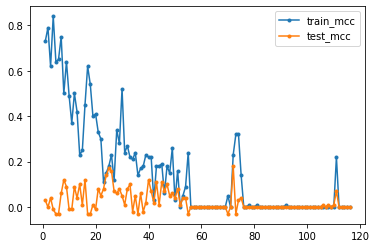

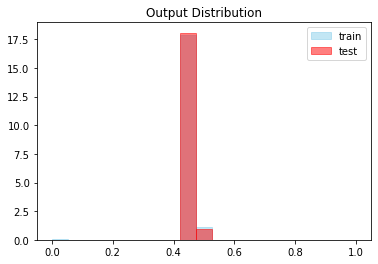




Global Iteration: (1/40) Set Number: (58/64) Epochs: 10  File: train58.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.6934 - acc: 0.8567 - val_loss: 3.1669 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6584 - acc: 0.3467 - val_loss: 3.1609 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.6503 - acc: 0.0475 - val_loss: 3.1547 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6311 - acc: 0.0342 - val_loss: 3.1480 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 163ms/step - loss: 3.6190 - acc: 0.0342 - val_loss: 3.1414 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 3.5967 - acc: 0

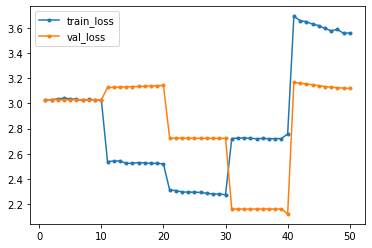

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_58_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_58_10


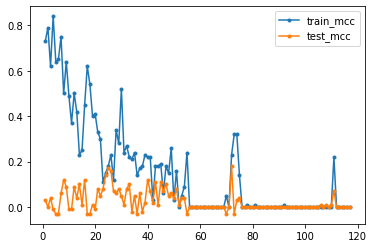

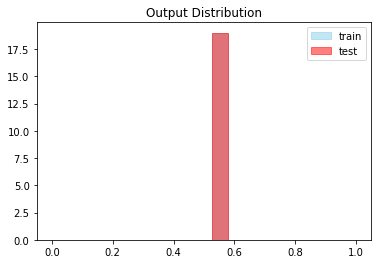




Global Iteration: (1/40) Set Number: (59/64) Epochs: 10  File: train59.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9959 - acc: 0.0242 - val_loss: 2.8409 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9736 - acc: 0.0242 - val_loss: 2.8418 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9750 - acc: 0.0242 - val_loss: 2.8410 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9736 - acc: 0.0242 - val_loss: 2.8406 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9616 - acc: 0.0242 - val_loss: 2.8410 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9793 - acc: 0

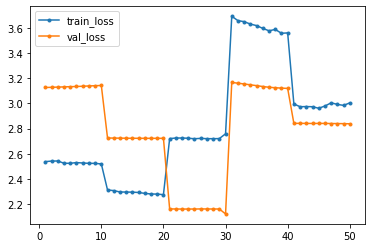

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_59_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_59_10


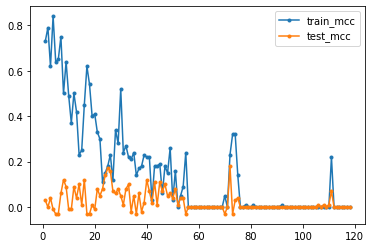

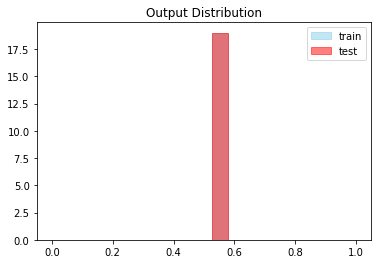




Global Iteration: (1/40) Set Number: (60/64) Epochs: 10  File: train60.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9586 - acc: 0.0233 - val_loss: 2.6475 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9495 - acc: 0.0233 - val_loss: 2.6448 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9417 - acc: 0.0233 - val_loss: 2.6435 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9223 - acc: 0.0233 - val_loss: 2.6425 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9230 - acc: 0.0233 - val_loss: 2.6419 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9189 - acc: 0

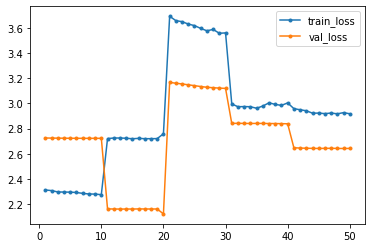

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_60_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_60_10


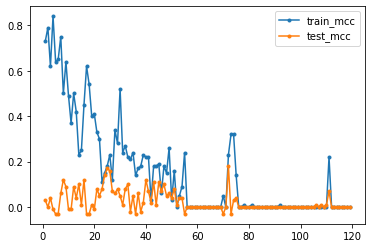

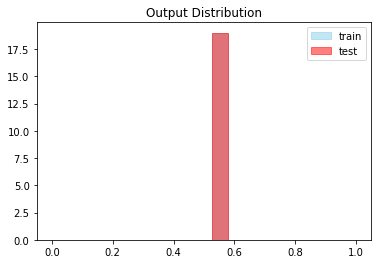




Global Iteration: (1/40) Set Number: (61/64) Epochs: 10  File: train61.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8302 - acc: 0.0217 - val_loss: 2.2576 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8314 - acc: 0.0217 - val_loss: 2.2552 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 163ms/step - loss: 2.8408 - acc: 0.0217 - val_loss: 2.2517 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8408 - acc: 0.0217 - val_loss: 2.2498 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8436 - acc: 0.0217 - val_loss: 2.2476 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8311 - acc: 0

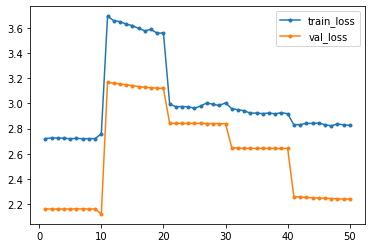

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_61_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_61_10


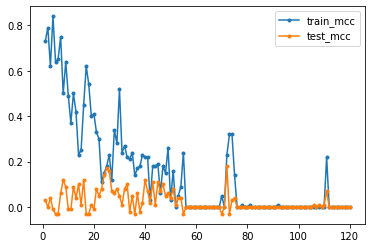

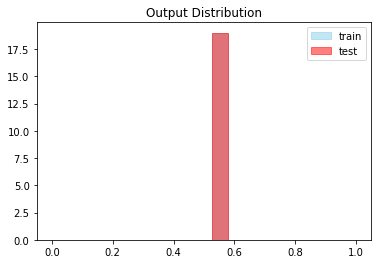




Global Iteration: (1/40) Set Number: (62/64) Epochs: 10  File: train62.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.2441 - acc: 0.0133 - val_loss: 2.7309 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2389 - acc: 0.0133 - val_loss: 2.7286 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2222 - acc: 0.0125 - val_loss: 2.7266 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2080 - acc: 0.0133 - val_loss: 2.7250 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1989 - acc: 0.0133 - val_loss: 2.7239 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.1983 - acc: 0

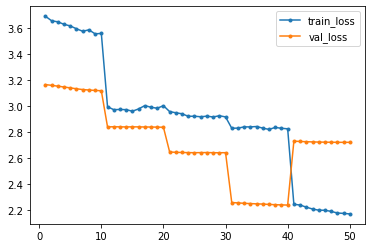

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_62_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_62_10


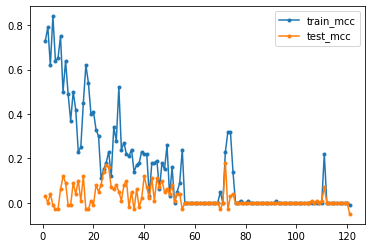

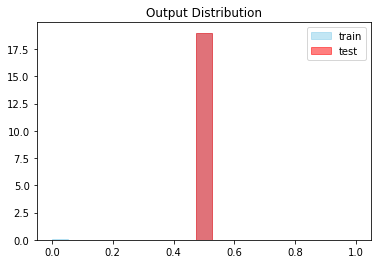




Global Iteration: (1/40) Set Number: (63/64) Epochs: 10  File: train63.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
11/11 [==============================] - 2s 168ms/step - loss: 2.8599 - acc: 0.5954 - val_loss: 3.1666 - val_acc: 0.9733
Epoch 2/10
11/11 [==============================] - 2s 165ms/step - loss: 2.8601 - acc: 0.5360 - val_loss: 3.1658 - val_acc: 0.9733
Epoch 3/10
11/11 [==============================] - 2s 164ms/step - loss: 2.8596 - acc: 0.5360 - val_loss: 3.1653 - val_acc: 0.9733
Epoch 4/10
11/11 [==============================] - 2s 162ms/step - loss: 2.8555 - acc: 0.5005 - val_loss: 3.1647 - val_acc: 0.0267
Epoch 5/10
11/11 [==============================] - 2s 164ms/step - loss: 2.8530 - acc: 0.4410 - val_loss: 3.1631 - val_acc: 0.0267
Epoch 6/10
11/11 [==============================] - 2s 162ms/step - loss: 2.8532 - acc: 0

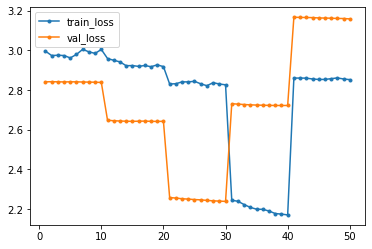

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_63_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_1_63_10


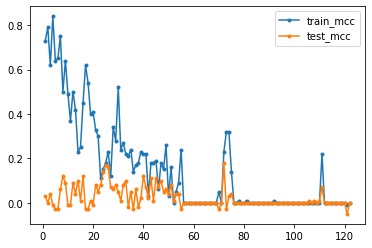

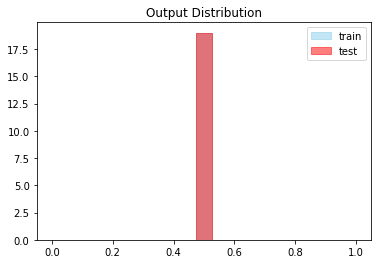




Global Iteration: (2/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8823 - acc: 0.1450 - val_loss: 3.1576 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8791 - acc: 0.1208 - val_loss: 3.1572 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8839 - acc: 0.1467 - val_loss: 3.1560 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8828 - acc: 0.1567 - val_loss: 3.1548 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8886 - acc: 0.1100 - val_loss: 3.1536 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8925 - acc: 0.1

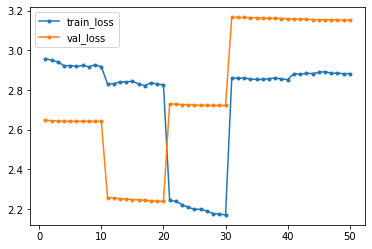

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_0_10


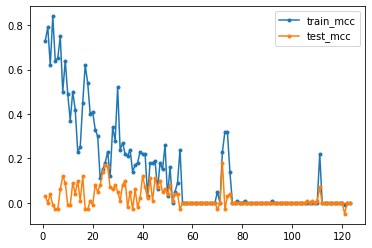

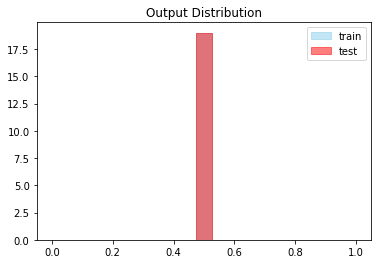




Global Iteration: (2/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5151 - acc: 0.0167 - val_loss: 2.8295 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5066 - acc: 0.0408 - val_loss: 2.8298 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5019 - acc: 0.1033 - val_loss: 2.8300 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5103 - acc: 0.1392 - val_loss: 2.8302 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4959 - acc: 0.1417 - val_loss: 2.8305 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5150 - acc: 0.1

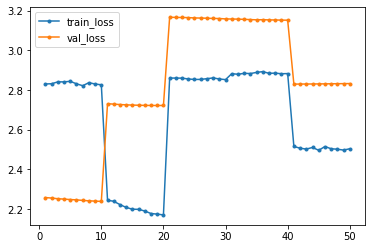

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_1_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_1_10


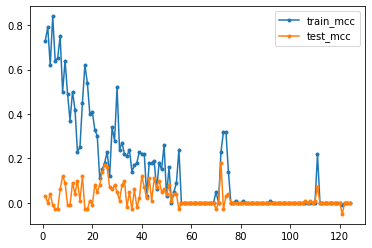

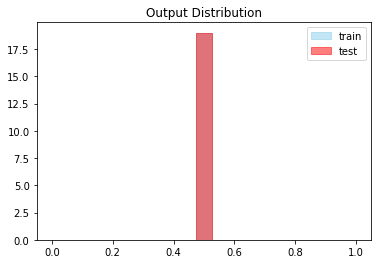




Global Iteration: (2/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4965 - acc: 0.6400 - val_loss: 2.8326 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4971 - acc: 0.7875 - val_loss: 2.8332 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4958 - acc: 0.8258 - val_loss: 2.8337 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4943 - acc: 0.9425 - val_loss: 2.8342 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4936 - acc: 0.9583 - val_loss: 2.8345 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4925 - acc: 0.9

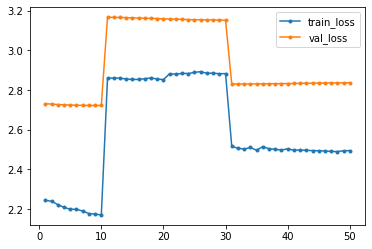

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_2_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_2_10


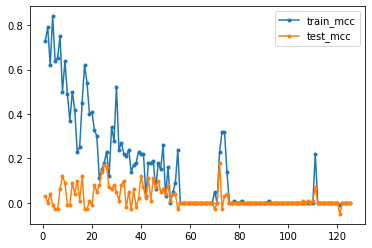

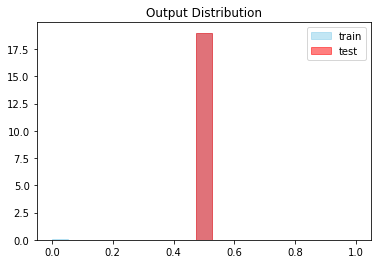




Global Iteration: (2/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3779 - acc: 0.9850 - val_loss: 2.6073 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3759 - acc: 0.9850 - val_loss: 2.6070 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3767 - acc: 0.9850 - val_loss: 2.6069 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3740 - acc: 0.9850 - val_loss: 2.6067 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.3710 - acc: 0.9850 - val_loss: 2.6065 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.3677 - acc: 0.9

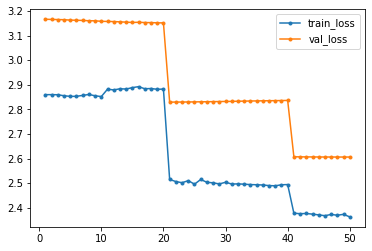

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_3_10


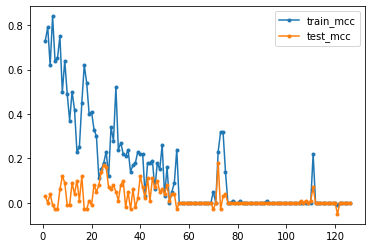

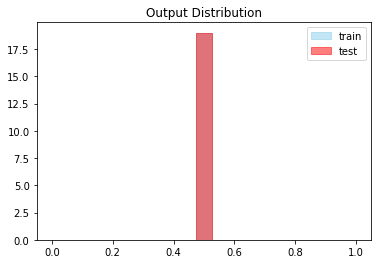




Global Iteration: (2/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.1864 - acc: 0.9875 - val_loss: 3.0831 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1906 - acc: 0.9875 - val_loss: 3.0856 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.1820 - acc: 0.9875 - val_loss: 3.0890 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1859 - acc: 0.9875 - val_loss: 3.0916 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1783 - acc: 0.9875 - val_loss: 3.0940 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1788 - acc: 0.9

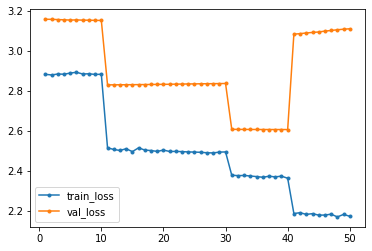

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_4_10


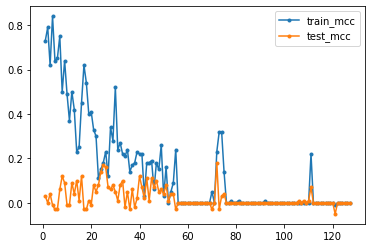

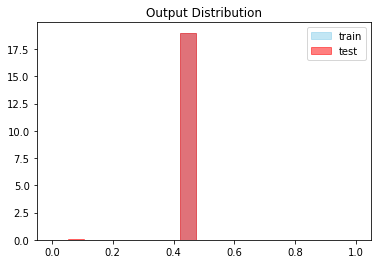




Global Iteration: (2/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9125 - acc: 0.9775 - val_loss: 2.6090 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9266 - acc: 0.9775 - val_loss: 2.6088 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9179 - acc: 0.9775 - val_loss: 2.6081 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9194 - acc: 0.9775 - val_loss: 2.6075 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9067 - acc: 0.9775 - val_loss: 2.6072 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9121 - acc: 0.9

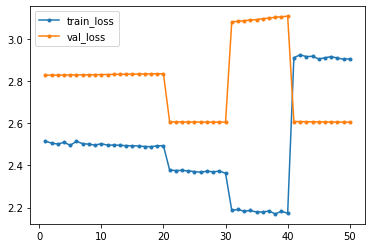

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_5_10


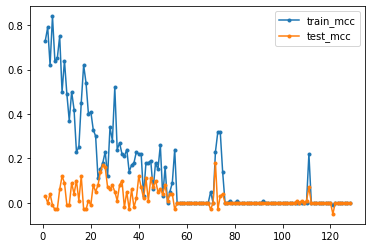

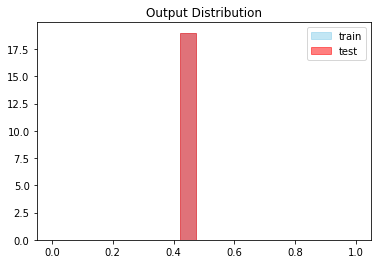




Global Iteration: (2/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1446 - acc: 0.9742 - val_loss: 2.8446 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1419 - acc: 0.9742 - val_loss: 2.8426 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1380 - acc: 0.9742 - val_loss: 2.8409 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1348 - acc: 0.9742 - val_loss: 2.8393 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1282 - acc: 0.9742 - val_loss: 2.8378 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1271 - acc: 0.9

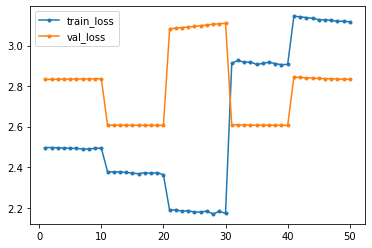

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_6_10


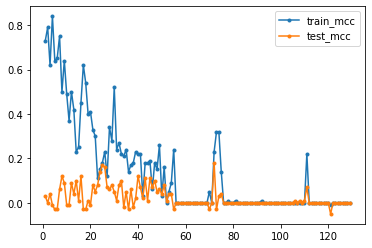

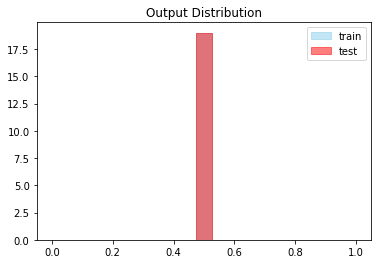




Global Iteration: (2/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8898 - acc: 0.8742 - val_loss: 2.5043 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9194 - acc: 0.4858 - val_loss: 2.5003 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8935 - acc: 0.7017 - val_loss: 2.4975 - val_acc: 0.9833
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8844 - acc: 0.6642 - val_loss: 2.4982 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8801 - acc: 0.3758 - val_loss: 2.5127 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8968 - acc: 0.3

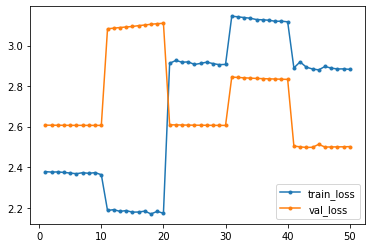

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_7_10


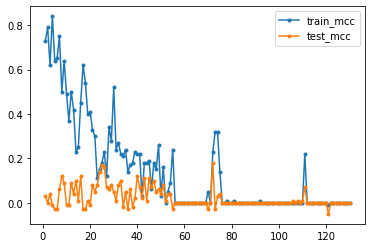

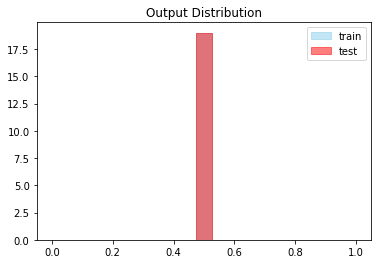




Global Iteration: (2/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5026 - acc: 0.1275 - val_loss: 2.6110 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5023 - acc: 0.1658 - val_loss: 2.6107 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5009 - acc: 0.2708 - val_loss: 2.6103 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5050 - acc: 0.3025 - val_loss: 2.6100 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4980 - acc: 0.4567 - val_loss: 2.6095 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4946 - acc: 0.6

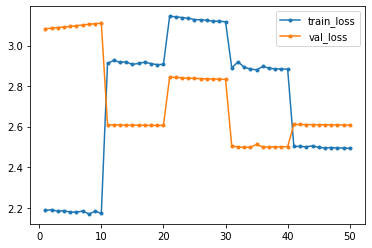

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_8_10


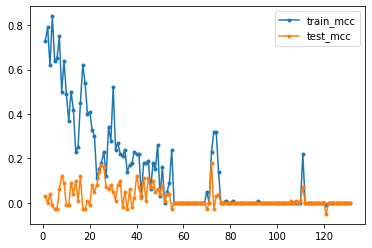

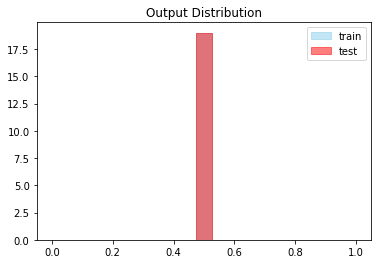




Global Iteration: (2/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5552 - acc: 0.9825 - val_loss: 3.0600 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5479 - acc: 0.9825 - val_loss: 3.0608 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5530 - acc: 0.9825 - val_loss: 3.0614 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5513 - acc: 0.9825 - val_loss: 3.0617 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5507 - acc: 0.9825 - val_loss: 3.0625 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5531 - acc: 0.9

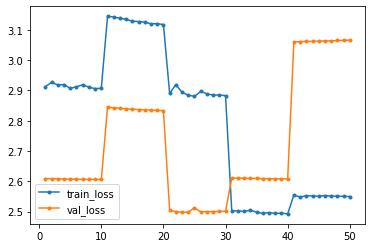

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_9_10


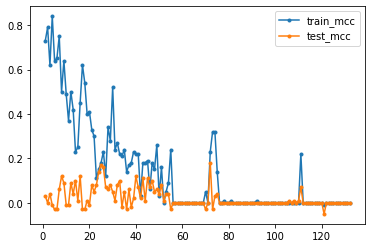

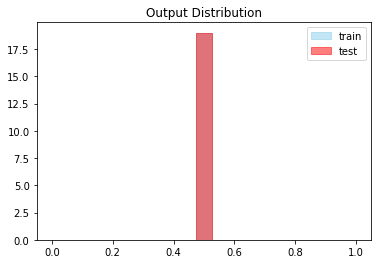




Global Iteration: (2/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8929 - acc: 0.9775 - val_loss: 2.8361 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8936 - acc: 0.9775 - val_loss: 2.8357 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8927 - acc: 0.9775 - val_loss: 2.8353 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8948 - acc: 0.9775 - val_loss: 2.8347 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8916 - acc: 0.9775 - val_loss: 2.8342 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8891 - acc: 0

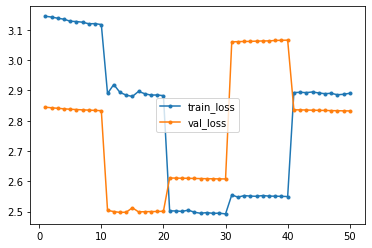

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_10_10


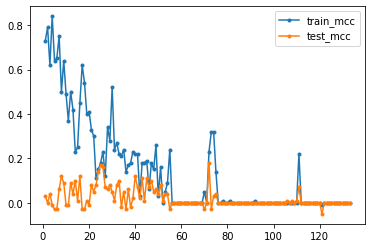

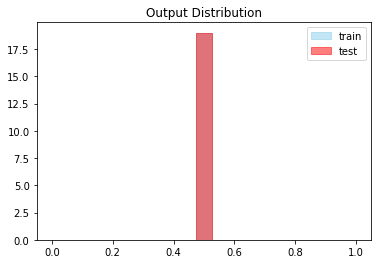




Global Iteration: (2/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6644 - acc: 0.8725 - val_loss: 2.3848 - val_acc: 0.9850
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6677 - acc: 0.8350 - val_loss: 2.3846 - val_acc: 0.9850
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6655 - acc: 0.8475 - val_loss: 2.3847 - val_acc: 0.9850
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6649 - acc: 0.9008 - val_loss: 2.3842 - val_acc: 0.9850
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6667 - acc: 0.9342 - val_loss: 2.3841 - val_acc: 0.9850
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6520 - acc: 0

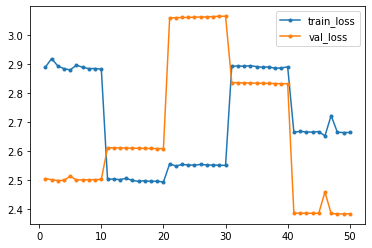

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_11_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_11_10


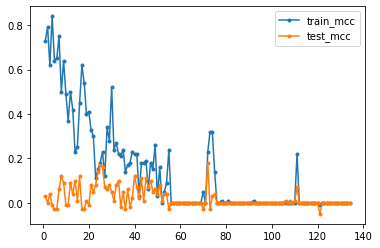

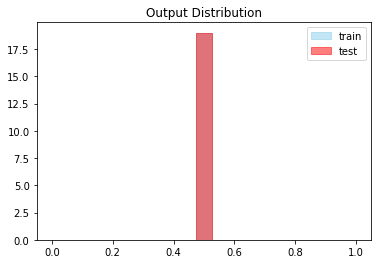




Global Iteration: (2/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8897 - acc: 0.9775 - val_loss: 2.8331 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8910 - acc: 0.9775 - val_loss: 2.8327 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8860 - acc: 0.9542 - val_loss: 2.8324 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8855 - acc: 0.8875 - val_loss: 2.8292 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8646 - acc: 0.5475 - val_loss: 2.8293 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9808 - acc: 0

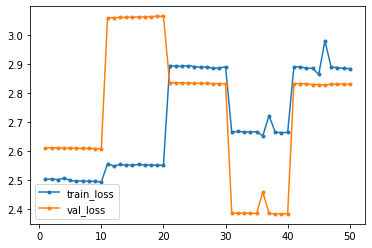

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_12_10


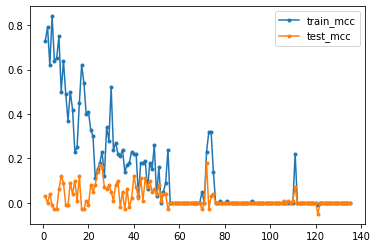

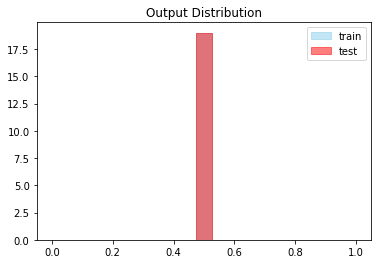




Global Iteration: (2/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8290 - acc: 0.3325 - val_loss: 2.8302 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8318 - acc: 0.2592 - val_loss: 2.8301 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8311 - acc: 0.2133 - val_loss: 2.8299 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8326 - acc: 0.1867 - val_loss: 2.8299 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8314 - acc: 0.1617 - val_loss: 2.8299 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8318 - acc: 0

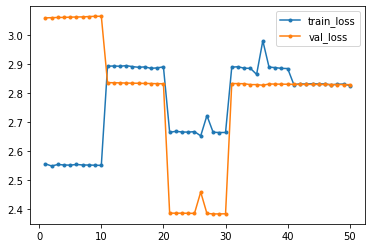

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_13_10


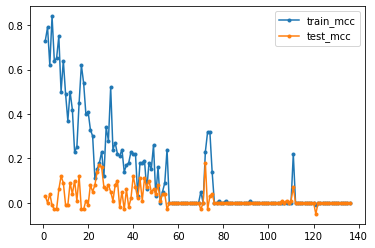

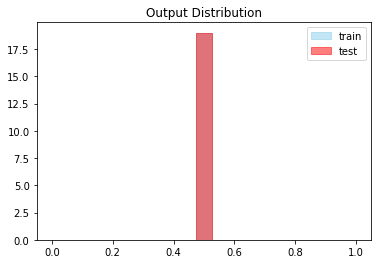




Global Iteration: (2/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8840 - acc: 0.0225 - val_loss: 2.8291 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8839 - acc: 0.0225 - val_loss: 2.8290 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8840 - acc: 0.0225 - val_loss: 2.8289 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8812 - acc: 0.0225 - val_loss: 2.8287 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8792 - acc: 0.0225 - val_loss: 2.8285 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8850 - acc: 0

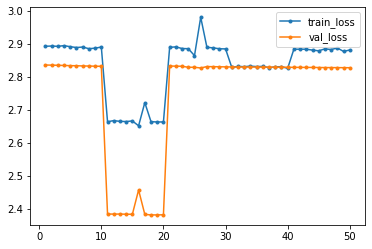

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_14_10


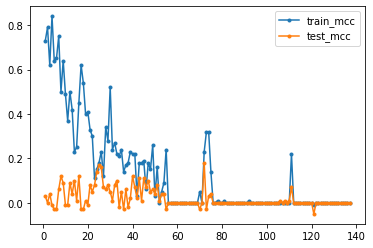

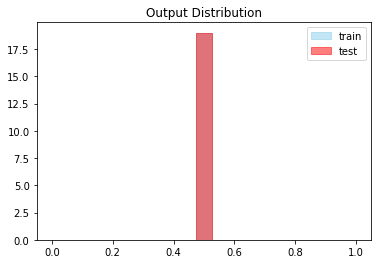




Global Iteration: (2/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4540 - acc: 0.0158 - val_loss: 3.1490 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4517 - acc: 0.0158 - val_loss: 3.1510 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4554 - acc: 0.0158 - val_loss: 3.1534 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4475 - acc: 0.0158 - val_loss: 3.1552 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4495 - acc: 0.0158 - val_loss: 3.1566 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4470 - acc: 0

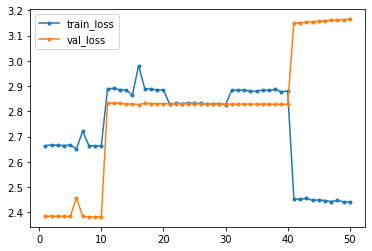

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_15_10


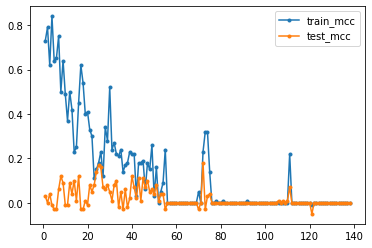

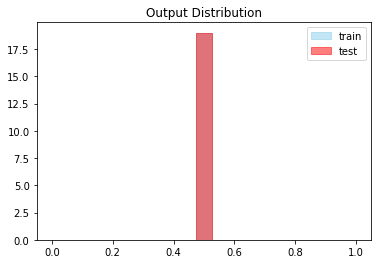




Global Iteration: (2/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7739 - acc: 0.7500 - val_loss: 2.6083 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7805 - acc: 0.7150 - val_loss: 2.6083 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7753 - acc: 0.7242 - val_loss: 2.6084 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7749 - acc: 0.7275 - val_loss: 2.6084 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7747 - acc: 0.7467 - val_loss: 2.6084 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.7777 - acc: 0

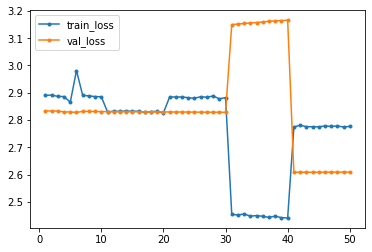

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_16_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_16_10


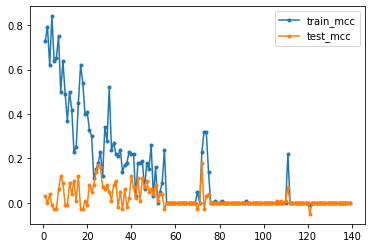

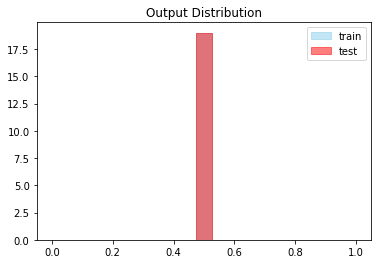




Global Iteration: (2/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Failed:  (17, 'train17.h5')



Global Iteration: (2/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0513 - acc: 0.4392 - val_loss: 3.1626 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0487 - acc: 0.2917 - val_loss: 3.1604 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0496 - acc: 0.1217 - val_loss: 3.1581 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0464 - acc: 0.0542 - val_loss: 3.1566 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3

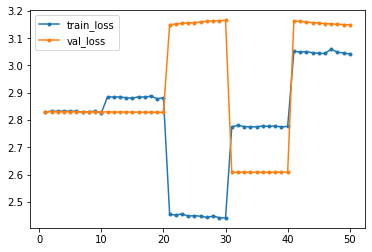

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_18_10


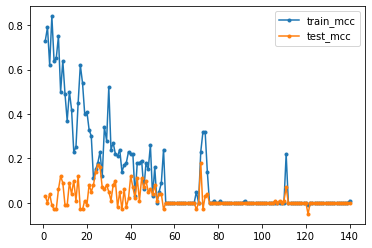

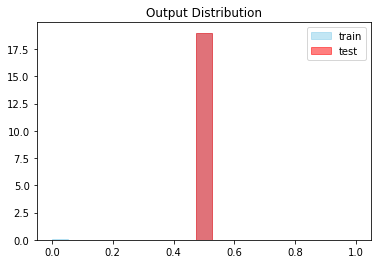




Global Iteration: (2/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5648 - acc: 0.0175 - val_loss: 2.1885 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5623 - acc: 0.0175 - val_loss: 2.1871 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5630 - acc: 0.0175 - val_loss: 2.1853 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5629 - acc: 0.0175 - val_loss: 2.1826 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5585 - acc: 0.0175 - val_loss: 2.1811 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5564 - acc: 0

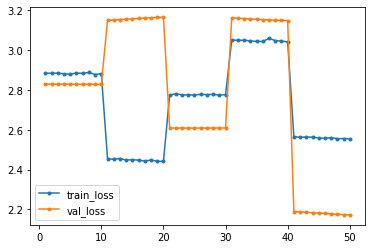

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_19_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_19_10


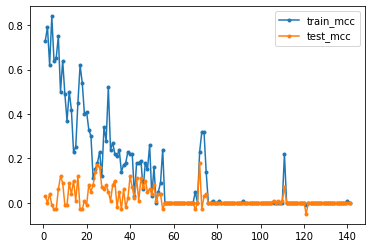

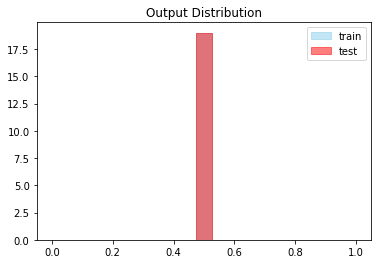




Global Iteration: (2/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9918 - acc: 0.0242 - val_loss: 2.3916 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9964 - acc: 0.0242 - val_loss: 2.3925 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9926 - acc: 0.0242 - val_loss: 2.3933 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9887 - acc: 0.0242 - val_loss: 2.3947 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9910 - acc: 0.0242 - val_loss: 2.3961 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9952 - acc: 0

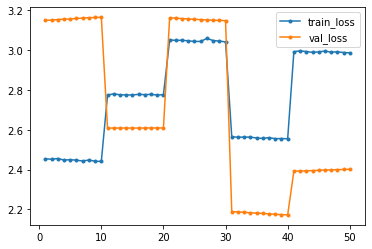

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_20_10


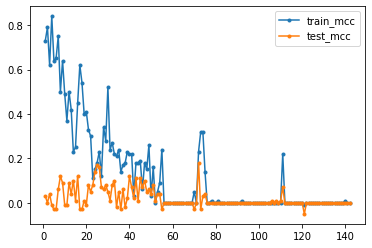

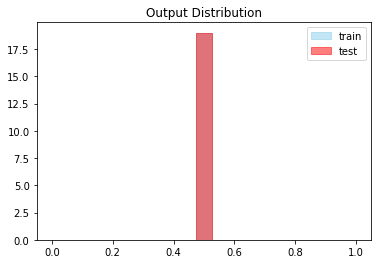




Global Iteration: (2/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9894 - acc: 0.0242 - val_loss: 2.8274 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9888 - acc: 0.0242 - val_loss: 2.8273 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9919 - acc: 0.0242 - val_loss: 2.8272 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9853 - acc: 0.0242 - val_loss: 2.8272 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9848 - acc: 0.0242 - val_loss: 2.8271 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9798 - acc: 0

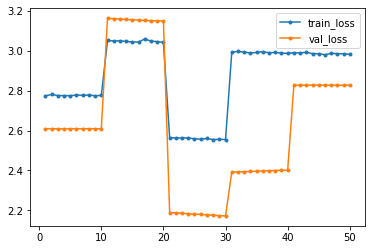

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_21_10


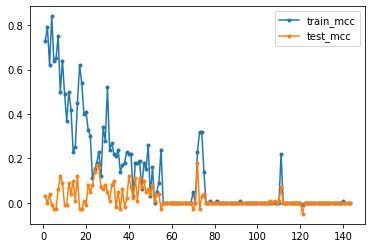

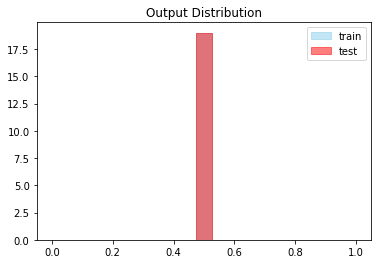




Global Iteration: (2/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0308 - acc: 0.0267 - val_loss: 3.1368 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0242 - acc: 0.0267 - val_loss: 3.1361 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0292 - acc: 0.0267 - val_loss: 3.1349 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0322 - acc: 0.0267 - val_loss: 3.1338 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0290 - acc: 0.0267 - val_loss: 3.1331 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0352 - acc: 0

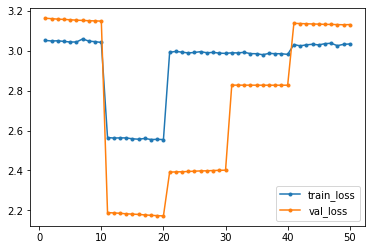

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_22_10


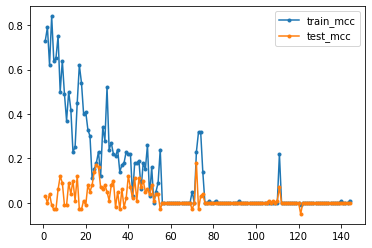

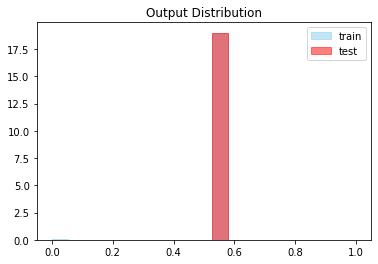




Global Iteration: (2/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8600 - acc: 0.4308 - val_loss: 3.1427 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8309 - acc: 0.0817 - val_loss: 3.1276 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8320 - acc: 0.0217 - val_loss: 3.1277 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8281 - acc: 0.0217 - val_loss: 3.1282 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8303 - acc: 0.0217 - val_loss: 3.1283 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8182 - acc: 0

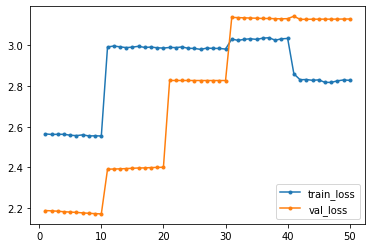

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_23_10


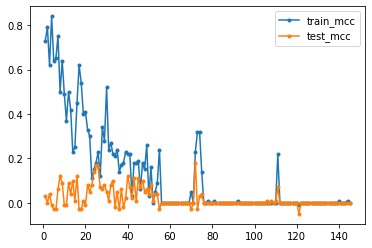

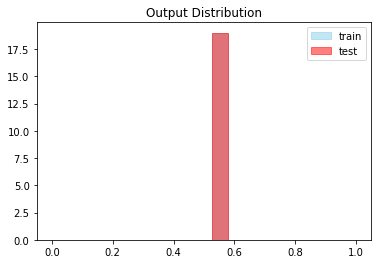




Global Iteration: (2/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5788 - acc: 0.0175 - val_loss: 2.6266 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5710 - acc: 0.0175 - val_loss: 2.6253 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5718 - acc: 0.0175 - val_loss: 2.6241 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5641 - acc: 0.0175 - val_loss: 2.6227 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5693 - acc: 0.0175 - val_loss: 2.6219 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5712 - acc: 0

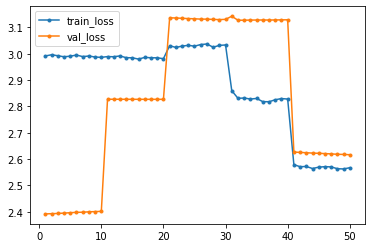

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_24_10


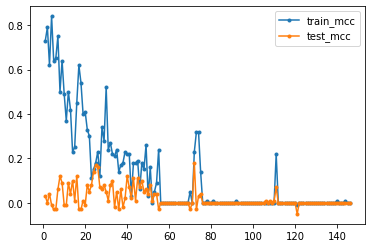

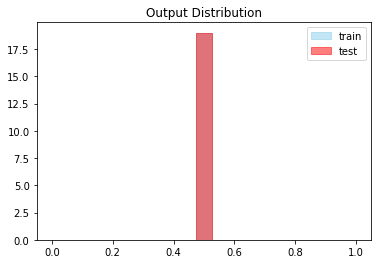




Global Iteration: (2/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4031 - acc: 0.0150 - val_loss: 2.1923 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4052 - acc: 0.0150 - val_loss: 2.1887 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3988 - acc: 0.0150 - val_loss: 2.1847 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.3983 - acc: 0.0150 - val_loss: 2.1825 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.3989 - acc: 0.0150 - val_loss: 2.1781 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3913 - acc: 0

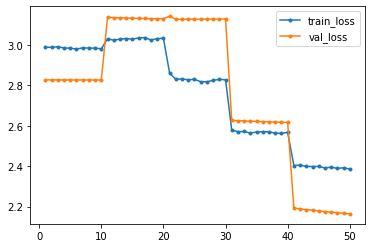

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_25_10


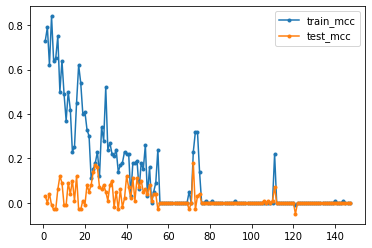

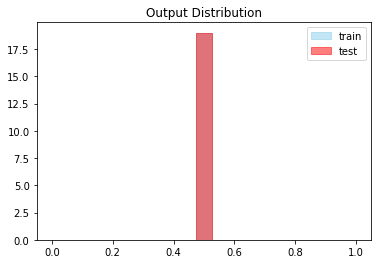




Global Iteration: (2/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7767 - acc: 0.6867 - val_loss: 2.8308 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 2.7736 - acc: 0.6508 - val_loss: 2.8305 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7754 - acc: 0.5675 - val_loss: 2.8305 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7730 - acc: 0.5217 - val_loss: 2.8304 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7744 - acc: 0.5100 - val_loss: 2.8302 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7758 - acc: 0

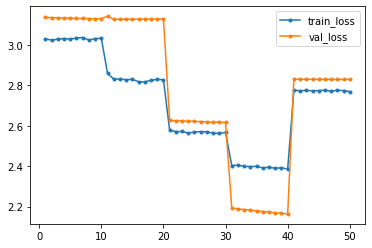

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_26_10


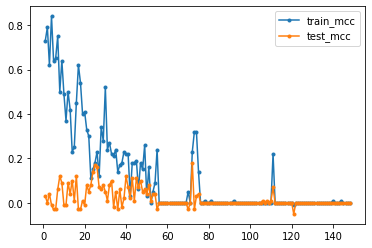

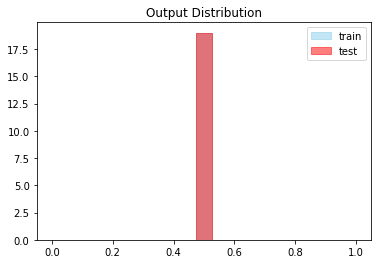




Global Iteration: (2/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1602 - acc: 0.2342 - val_loss: 2.6094 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1595 - acc: 0.1508 - val_loss: 2.6101 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1565 - acc: 0.1200 - val_loss: 2.6107 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1530 - acc: 0.0308 - val_loss: 2.6119 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1561 - acc: 0.0267 - val_loss: 2.6126 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1491 - acc: 0

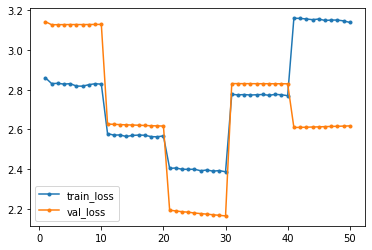

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_27_10


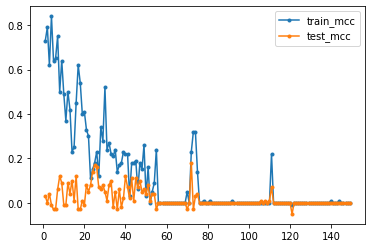

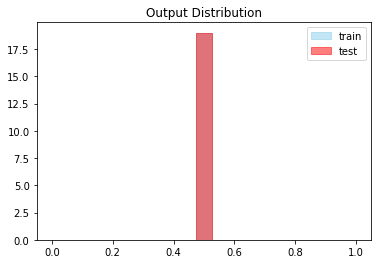




Global Iteration: (2/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9834 - acc: 0.0242 - val_loss: 3.0343 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9845 - acc: 0.0242 - val_loss: 3.0335 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9795 - acc: 0.0242 - val_loss: 3.0330 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9792 - acc: 0.0242 - val_loss: 3.0325 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9837 - acc: 0.0242 - val_loss: 3.0316 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9848 - acc: 0

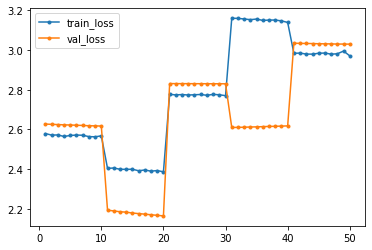

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_28_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_28_10


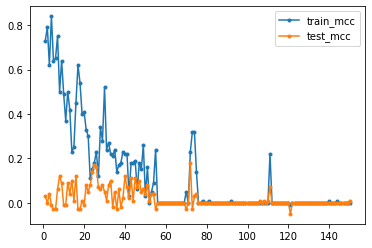

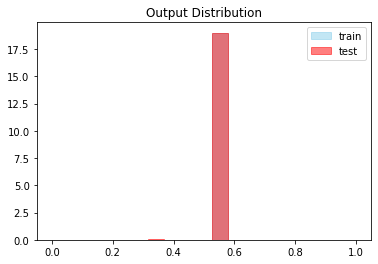




Global Iteration: (2/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9356 - acc: 0.0233 - val_loss: 2.4198 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9333 - acc: 0.0233 - val_loss: 2.4202 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9213 - acc: 0.0233 - val_loss: 2.4218 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9376 - acc: 0.0233 - val_loss: 2.4219 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9323 - acc: 0.0233 - val_loss: 2.4210 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9235 - acc: 0

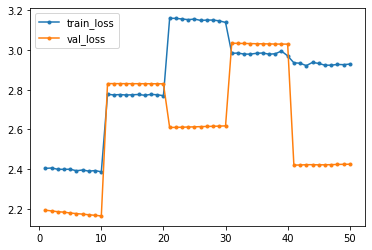

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_29_10


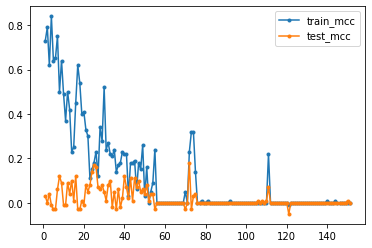

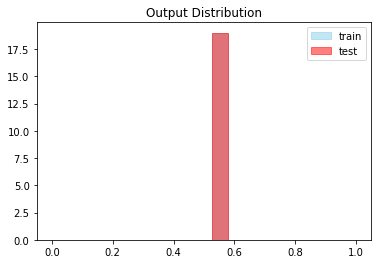




Global Iteration: (2/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8256 - acc: 0.0225 - val_loss: 2.2222 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8286 - acc: 0.0217 - val_loss: 2.2211 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8242 - acc: 0.0225 - val_loss: 2.2207 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8369 - acc: 0.0225 - val_loss: 2.2192 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8415 - acc: 0.0225 - val_loss: 2.2164 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8290 - acc: 0

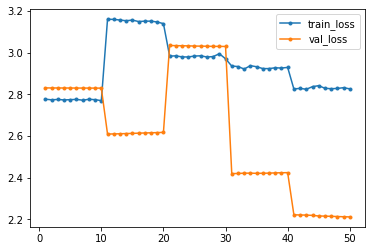

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_30_10


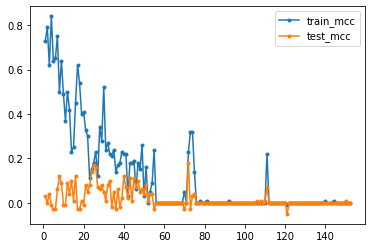

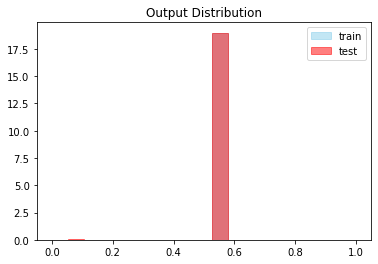




Global Iteration: (2/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7262 - acc: 0.0200 - val_loss: 2.2120 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7257 - acc: 0.0200 - val_loss: 2.2096 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7220 - acc: 0.0200 - val_loss: 2.2079 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7305 - acc: 0.0200 - val_loss: 2.2055 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7242 - acc: 0.0200 - val_loss: 2.2041 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7209 - acc: 0

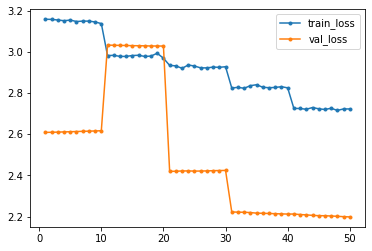

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_31_10


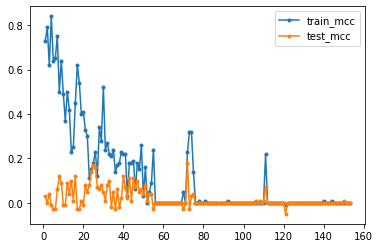

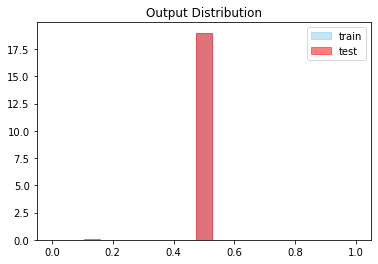




Global Iteration: (2/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6169 - acc: 0.0183 - val_loss: 2.4079 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6193 - acc: 0.0183 - val_loss: 2.4068 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6128 - acc: 0.0183 - val_loss: 2.4055 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6118 - acc: 0.0183 - val_loss: 2.4044 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6161 - acc: 0.0183 - val_loss: 2.4034 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6143 - acc: 0

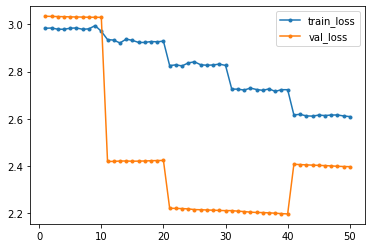

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_32_10


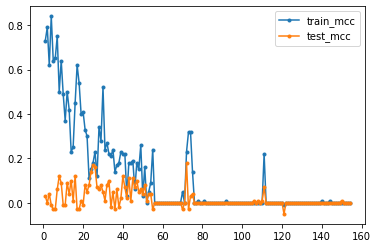

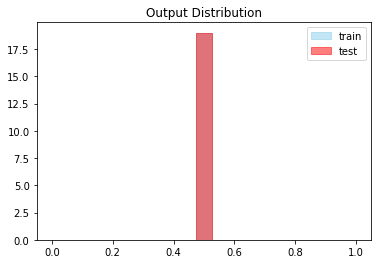




Global Iteration: (2/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3131 - acc: 0.0300 - val_loss: 2.8270 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.3135 - acc: 0.0300 - val_loss: 2.8268 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3046 - acc: 0.0300 - val_loss: 2.8267 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2954 - acc: 0.0317 - val_loss: 2.8266 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3031 - acc: 0.0292 - val_loss: 2.8266 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.2830 - acc: 0

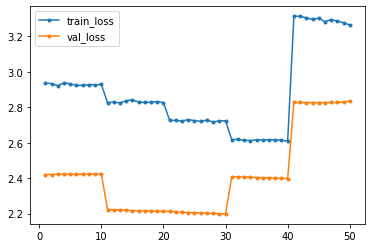

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_33_10


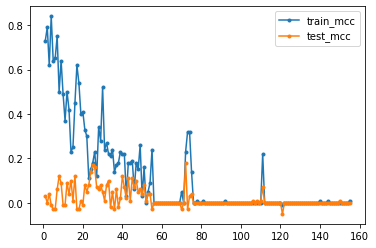

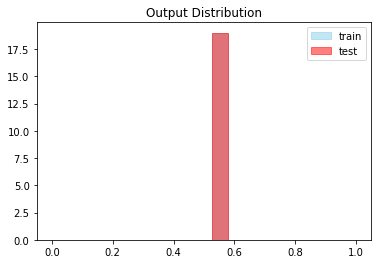




Global Iteration: (2/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6132 - acc: 0.0175 - val_loss: 3.0280 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5744 - acc: 0.0175 - val_loss: 3.0286 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5721 - acc: 0.0175 - val_loss: 3.0292 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5809 - acc: 0.0175 - val_loss: 3.0302 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5797 - acc: 0.0175 - val_loss: 3.0317 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5690 - acc: 0

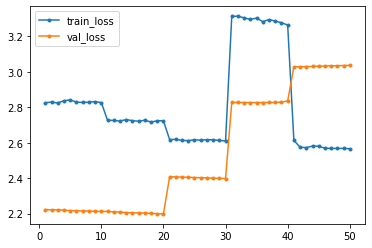

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_34_10


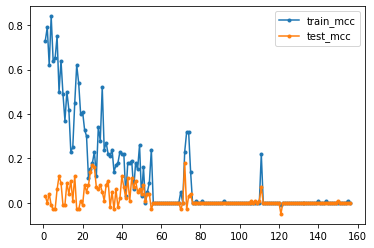

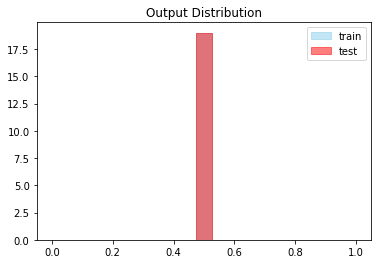




Global Iteration: (2/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7721 - acc: 0.0208 - val_loss: 3.0355 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7736 - acc: 0.0208 - val_loss: 3.0355 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.7752 - acc: 0.0208 - val_loss: 3.0357 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7764 - acc: 0.0208 - val_loss: 3.0362 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7719 - acc: 0.0208 - val_loss: 3.0363 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7803 - acc: 0

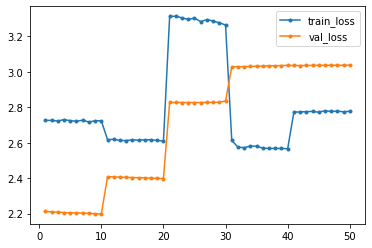

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_35_10


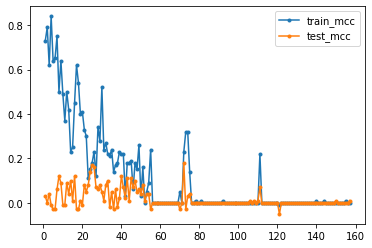

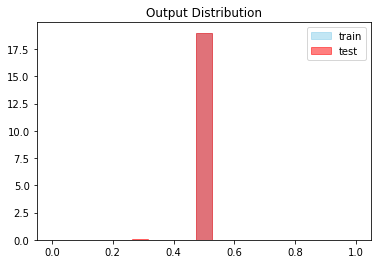




Global Iteration: (2/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6157 - acc: 0.0183 - val_loss: 3.1456 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6116 - acc: 0.0183 - val_loss: 3.1463 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6151 - acc: 0.0183 - val_loss: 3.1471 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6133 - acc: 0.0183 - val_loss: 3.1478 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6107 - acc: 0.0183 - val_loss: 3.1485 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6160 - acc: 0

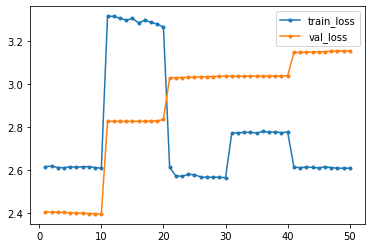

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_36_10


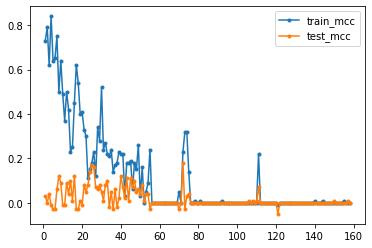

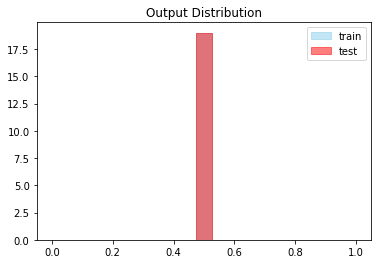




Global Iteration: (2/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5571 - acc: 0.0175 - val_loss: 2.5014 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5567 - acc: 0.0175 - val_loss: 2.5008 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5536 - acc: 0.0175 - val_loss: 2.5003 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5534 - acc: 0.0175 - val_loss: 2.4998 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5550 - acc: 0.0175 - val_loss: 2.4991 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5546 - acc: 0

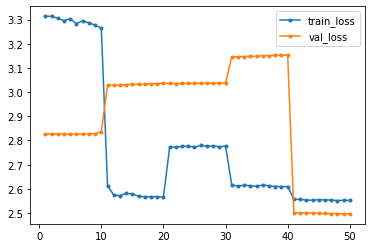

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_37_10


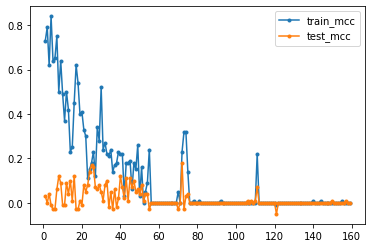

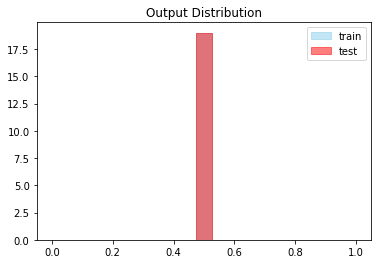




Global Iteration: (2/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4407 - acc: 0.6475 - val_loss: 2.8302 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4397 - acc: 0.9333 - val_loss: 2.8307 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4380 - acc: 0.9842 - val_loss: 2.8313 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4384 - acc: 0.9842 - val_loss: 2.8317 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4383 - acc: 0.9842 - val_loss: 2.8321 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4367 - acc: 0

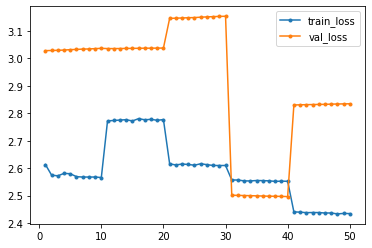

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_38_10


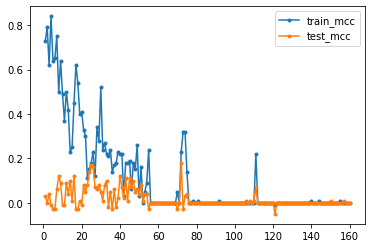

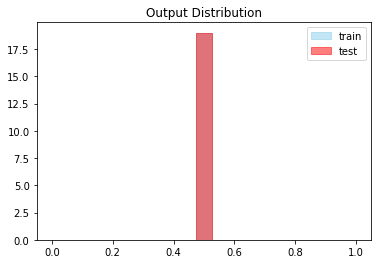




Global Iteration: (2/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0080 - acc: 0.9758 - val_loss: 3.1789 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0045 - acc: 0.9758 - val_loss: 3.1775 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0069 - acc: 0.9758 - val_loss: 3.1757 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0024 - acc: 0.9758 - val_loss: 3.1732 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0049 - acc: 0.9758 - val_loss: 3.1701 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0011 - acc: 0

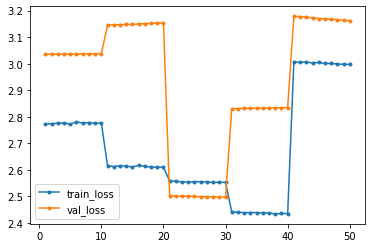

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_39_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_39_10


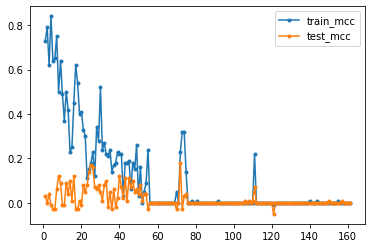

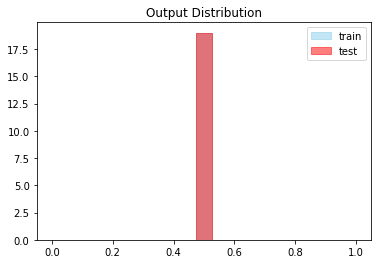




Global Iteration: (2/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4980 - acc: 0.4533 - val_loss: 2.1645 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4953 - acc: 0.5350 - val_loss: 2.1636 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4964 - acc: 0.7150 - val_loss: 2.1617 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4952 - acc: 0.9358 - val_loss: 2.1604 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4949 - acc: 0.9833 - val_loss: 2.1596 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4944 - acc: 0

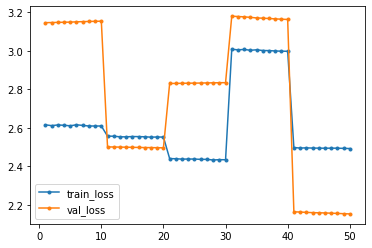

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_40_10


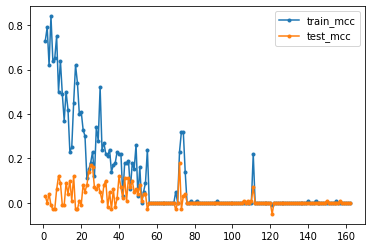

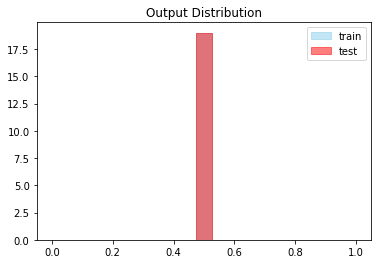




Global Iteration: (2/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.8883 - acc: 0.9775 - val_loss: 2.4928 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8874 - acc: 0.9775 - val_loss: 2.4932 - val_acc: 0.9833
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8880 - acc: 0.9775 - val_loss: 2.4935 - val_acc: 0.9833
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8876 - acc: 0.9775 - val_loss: 2.4941 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8862 - acc: 0.9775 - val_loss: 2.4946 - val_acc: 0.9833
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8855 - acc: 0

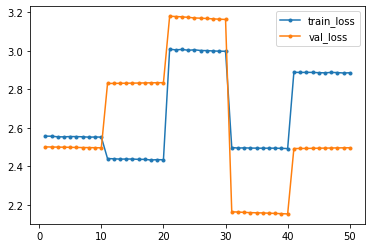

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_41_10


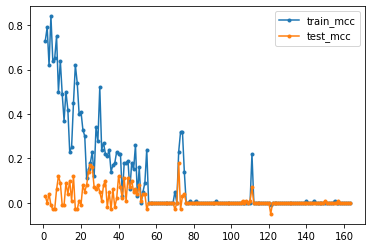

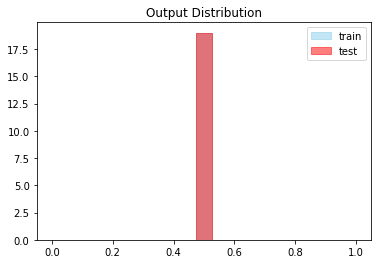




Global Iteration: (2/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.4946 - acc: 0.5217 - val_loss: 3.0514 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4952 - acc: 0.5042 - val_loss: 3.0514 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4980 - acc: 0.5158 - val_loss: 3.0527 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4952 - acc: 0.8392 - val_loss: 3.0538 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4932 - acc: 0.9833 - val_loss: 3.0544 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4955 - acc: 0

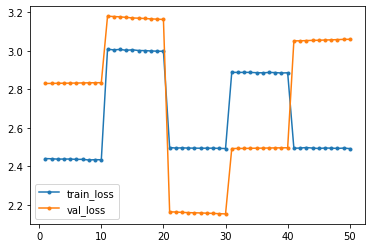

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_42_10


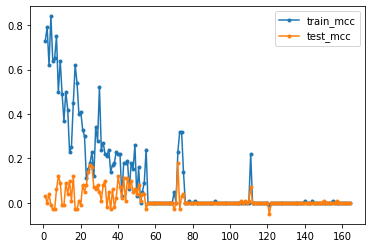

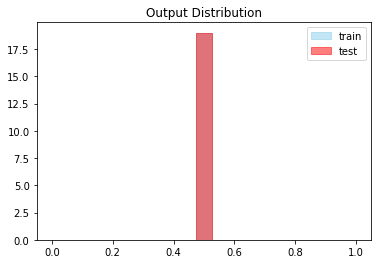




Global Iteration: (2/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9454 - acc: 0.9767 - val_loss: 2.8325 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9460 - acc: 0.9767 - val_loss: 2.8320 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9446 - acc: 0.9767 - val_loss: 2.8315 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9437 - acc: 0.9767 - val_loss: 2.8310 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9427 - acc: 0.9767 - val_loss: 2.8305 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9408 - acc: 0

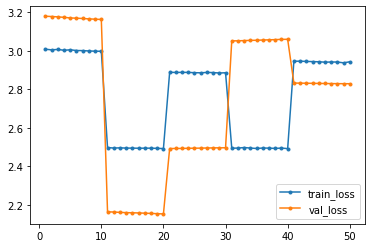

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_43_10


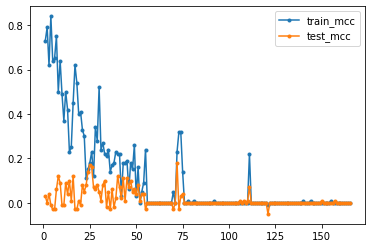

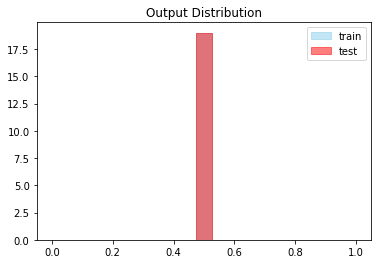




Global Iteration: (2/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6073 - acc: 0.3967 - val_loss: 2.8288 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6043 - acc: 0.3925 - val_loss: 2.8288 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6127 - acc: 0.3917 - val_loss: 2.8289 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6072 - acc: 0.5133 - val_loss: 2.8292 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6070 - acc: 0.5050 - val_loss: 2.8292 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6061 - acc: 0

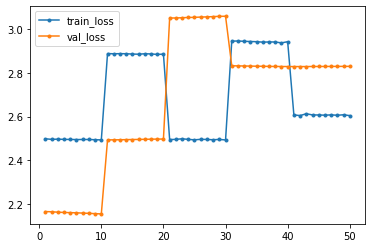

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_44_10


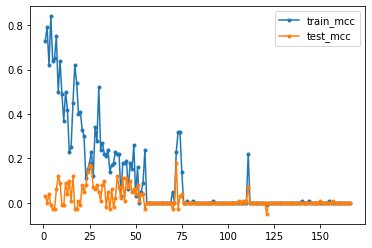

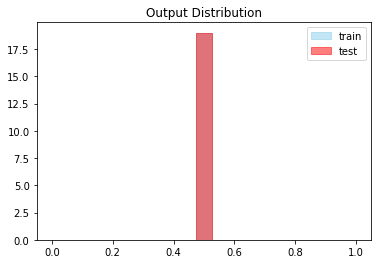




Global Iteration: (2/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.7183 - acc: 0.5158 - val_loss: 3.0525 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7171 - acc: 0.5233 - val_loss: 3.0530 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7183 - acc: 0.6908 - val_loss: 3.0534 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7206 - acc: 0.6800 - val_loss: 3.0530 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7199 - acc: 0.6125 - val_loss: 3.0529 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7176 - acc: 0

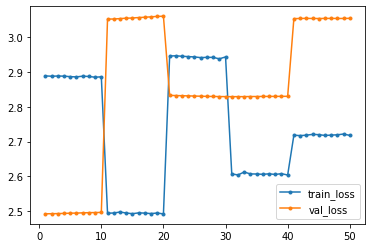

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_45_10


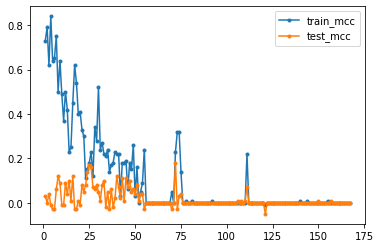

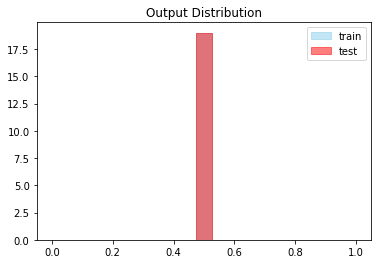




Global Iteration: (2/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1630 - acc: 0.6808 - val_loss: 3.1632 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 3.1628 - acc: 0.5192 - val_loss: 3.1611 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1613 - acc: 0.4575 - val_loss: 3.1591 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1550 - acc: 0.1508 - val_loss: 3.1568 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1584 - acc: 0.0267 - val_loss: 3.1541 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1524 - acc: 0

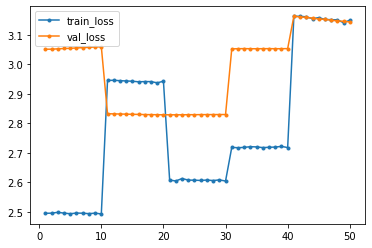

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_46_10


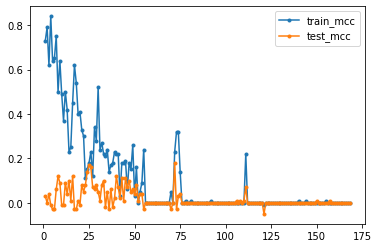

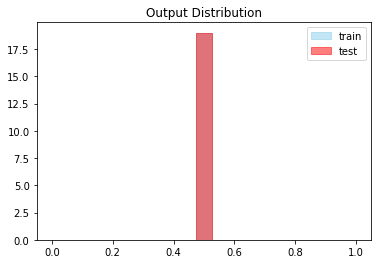




Global Iteration: (2/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 150ms/step - loss: 2.9306 - acc: 0.0233 - val_loss: 3.4256 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 145ms/step - loss: 2.9277 - acc: 0.0233 - val_loss: 3.4234 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 146ms/step - loss: 2.9325 - acc: 0.0233 - val_loss: 3.4219 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 149ms/step - loss: 2.9380 - acc: 0.0233 - val_loss: 3.4217 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 147ms/step - loss: 2.9356 - acc: 0.0233 - val_loss: 3.4209 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 148ms/step - loss: 2.9372 - acc: 0

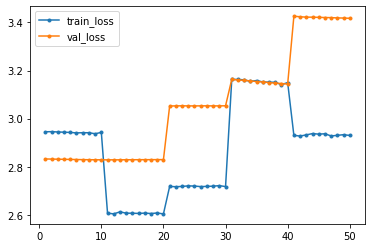

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_47_10


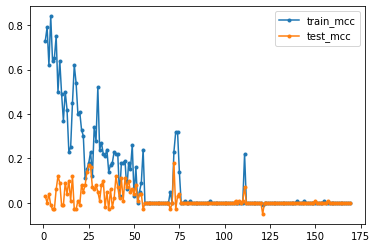

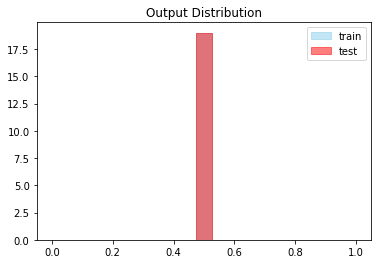




Global Iteration: (2/40) Set Number: (48/64) Epochs: 10  File: train48.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.2331 - acc: 0.0292 - val_loss: 3.0329 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2337 - acc: 0.0292 - val_loss: 3.0314 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2397 - acc: 0.0283 - val_loss: 3.0304 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 174ms/step - loss: 3.2316 - acc: 0.0292 - val_loss: 3.0294 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.2246 - acc: 0.0292 - val_loss: 3.0279 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2272 - acc: 0

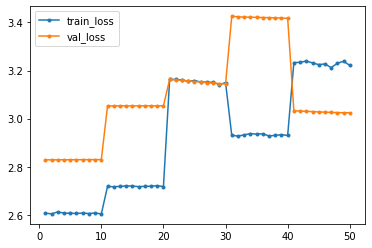

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_48_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_48_10


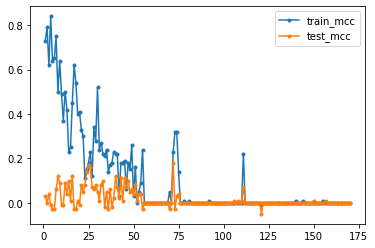

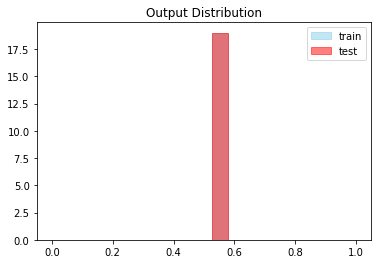




Global Iteration: (2/40) Set Number: (49/64) Epochs: 10  File: train49.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2640 - acc: 0.0292 - val_loss: 2.5414 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2745 - acc: 0.0292 - val_loss: 2.5443 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 180ms/step - loss: 3.2652 - acc: 0.0292 - val_loss: 2.5464 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2494 - acc: 0.0292 - val_loss: 2.5497 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2500 - acc: 0.0292 - val_loss: 2.5553 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2694 - acc: 0

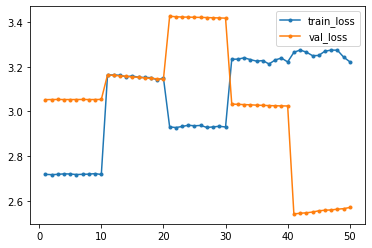

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_49_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_49_10


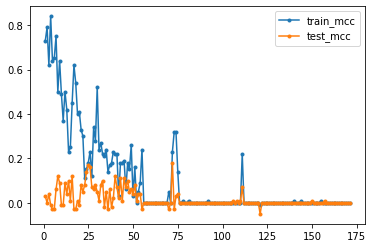

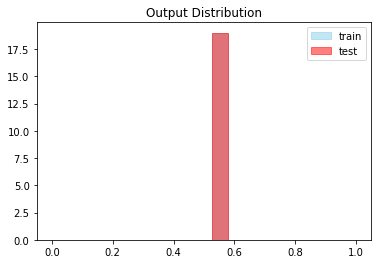




Global Iteration: (2/40) Set Number: (50/64) Epochs: 10  File: train50.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6089 - acc: 0.0175 - val_loss: 2.5690 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6112 - acc: 0.0175 - val_loss: 2.5621 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6192 - acc: 0.0183 - val_loss: 2.5565 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5892 - acc: 0.0183 - val_loss: 2.5520 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5768 - acc: 0.0467 - val_loss: 2.5072 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6873 - acc: 0

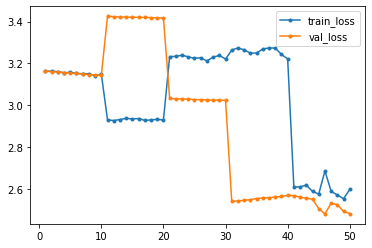

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_50_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_50_10


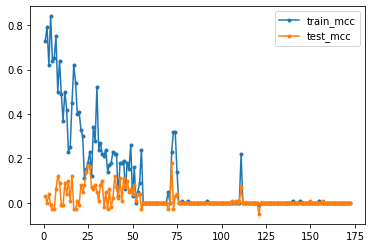

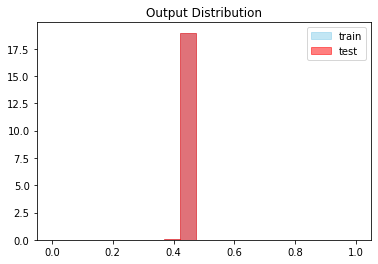




Global Iteration: (2/40) Set Number: (51/64) Epochs: 10  File: train51.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.52 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 3.0793 - acc: 0.3525 - val_loss: 3.0322 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0491 - acc: 0.0692 - val_loss: 3.0320 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0240 - acc: 0.0333 - val_loss: 3.0295 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0189 - acc: 0.0250 - val_loss: 3.0299 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0161 - acc: 0.0425 - val_loss: 3.0325 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0639 - acc: 0

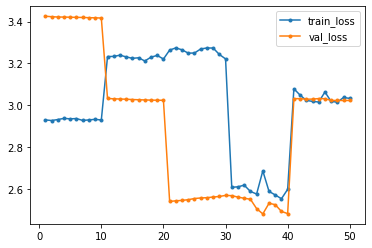

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_51_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_51_10


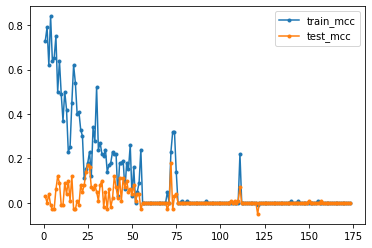

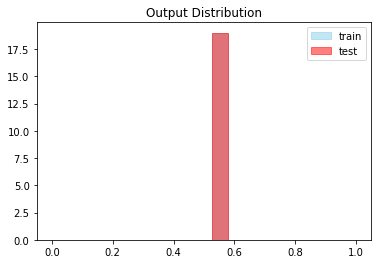




Global Iteration: (2/40) Set Number: (52/64) Epochs: 10  File: train52.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4014 - acc: 0.0142 - val_loss: 2.4458 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3957 - acc: 0.0142 - val_loss: 2.4408 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 177ms/step - loss: 2.3944 - acc: 0.0142 - val_loss: 2.4351 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3900 - acc: 0.0142 - val_loss: 2.4293 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3852 - acc: 0.0142 - val_loss: 2.4247 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3782 - acc: 0

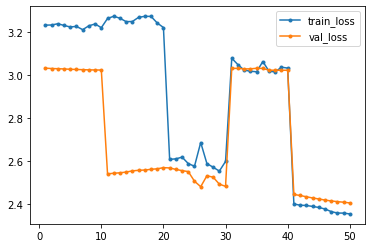

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_52_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_52_10


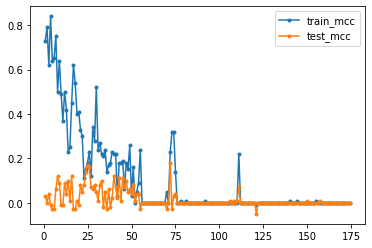

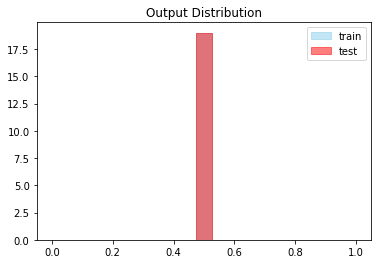




Global Iteration: (2/40) Set Number: (53/64) Epochs: 10  File: train53.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9255 - acc: 0.0233 - val_loss: 2.1946 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9241 - acc: 0.0233 - val_loss: 2.1958 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 178ms/step - loss: 2.9247 - acc: 0.0233 - val_loss: 2.1970 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9277 - acc: 0.0233 - val_loss: 2.1977 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9308 - acc: 0.0233 - val_loss: 2.1989 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9290 - acc: 0

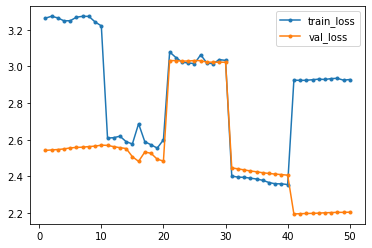

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_53_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_53_10


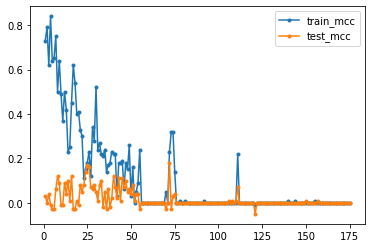

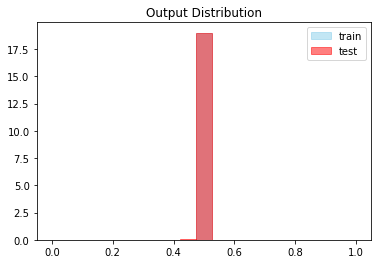




Global Iteration: (2/40) Set Number: (54/64) Epochs: 10  File: train54.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 3.0250 - acc: 0.0250 - val_loss: 3.1355 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 185ms/step - loss: 3.0291 - acc: 0.0250 - val_loss: 3.1345 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0388 - acc: 0.0250 - val_loss: 3.1335 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0326 - acc: 0.0250 - val_loss: 3.1329 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0297 - acc: 0.0250 - val_loss: 3.1325 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0288 - acc: 0

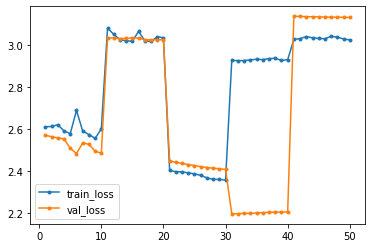

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_54_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_54_10


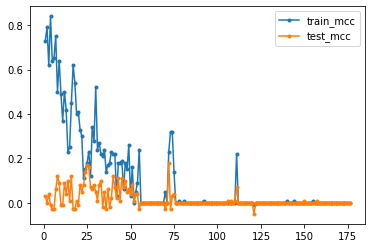

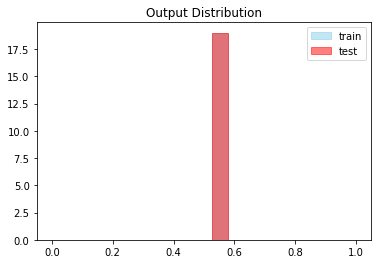




Global Iteration: (2/40) Set Number: (55/64) Epochs: 10  File: train55.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5173 - acc: 0.0167 - val_loss: 2.6247 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5168 - acc: 0.0167 - val_loss: 2.6235 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5249 - acc: 0.0167 - val_loss: 2.6223 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.5243 - acc: 0.0167 - val_loss: 2.6207 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5190 - acc: 0.0167 - val_loss: 2.6192 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5157 - acc: 0

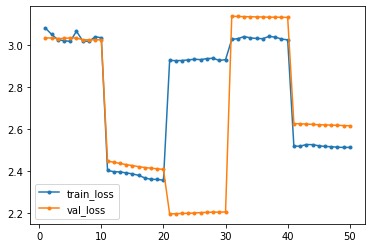

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_55_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_55_10


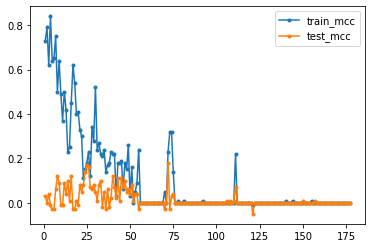

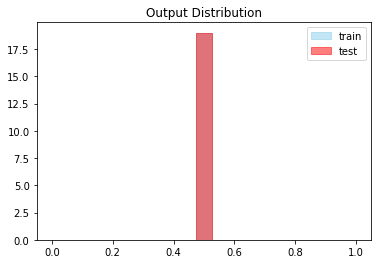




Global Iteration: (2/40) Set Number: (56/64) Epochs: 10  File: train56.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 164ms/step - loss: 2.2955 - acc: 0.0133 - val_loss: 2.1866 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2930 - acc: 0.0133 - val_loss: 2.1825 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2905 - acc: 0.0133 - val_loss: 2.1780 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.2843 - acc: 0.0175 - val_loss: 2.1734 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2777 - acc: 0.1283 - val_loss: 2.1700 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2782 - acc: 0

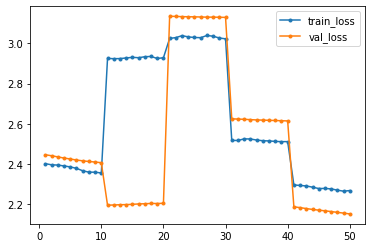

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_56_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_56_10


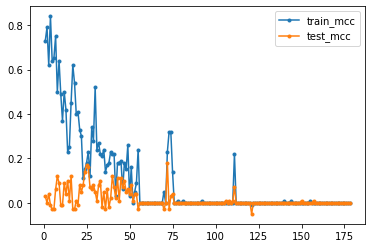

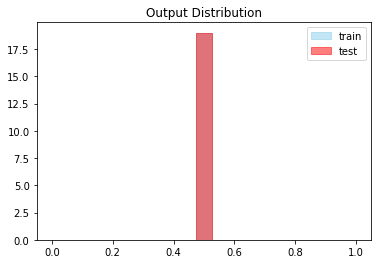




Global Iteration: (2/40) Set Number: (57/64) Epochs: 10  File: train57.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 181ms/step - loss: 2.7157 - acc: 0.9550 - val_loss: 2.8327 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 2.7228 - acc: 0.9800 - val_loss: 2.8328 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7237 - acc: 0.9800 - val_loss: 2.8328 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7182 - acc: 0.9642 - val_loss: 2.8323 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7217 - acc: 0.9208 - val_loss: 2.8322 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7197 - acc: 0

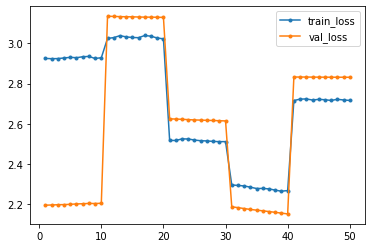

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_57_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_57_10


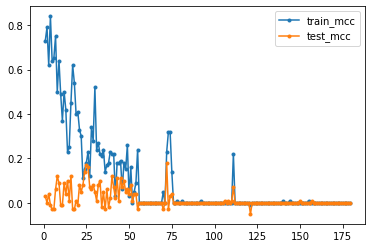

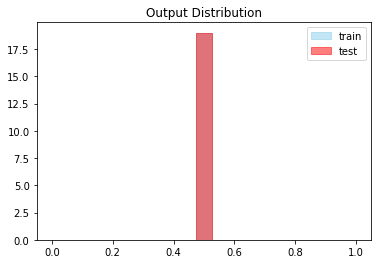




Global Iteration: (2/40) Set Number: (58/64) Epochs: 10  File: train58.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6694 - acc: 0.8825 - val_loss: 2.4935 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6683 - acc: 0.6625 - val_loss: 2.4958 - val_acc: 0.9833
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6581 - acc: 0.4958 - val_loss: 2.4981 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 3.6469 - acc: 0.2217 - val_loss: 2.5014 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 3.6336 - acc: 0.0400 - val_loss: 2.5046 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.6308 - acc: 0

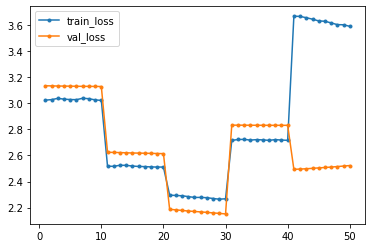

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_58_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_58_10


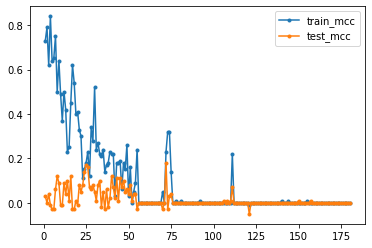

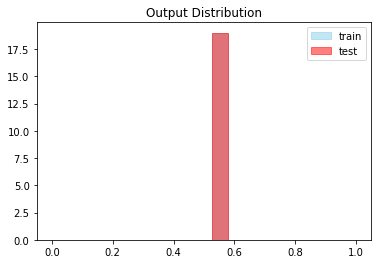




Global Iteration: (2/40) Set Number: (59/64) Epochs: 10  File: train59.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9773 - acc: 0.0242 - val_loss: 3.0275 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9806 - acc: 0.0242 - val_loss: 3.0270 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9794 - acc: 0.0242 - val_loss: 3.0270 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9702 - acc: 0.0242 - val_loss: 3.0267 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9857 - acc: 0.0242 - val_loss: 3.0268 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9841 - acc: 0

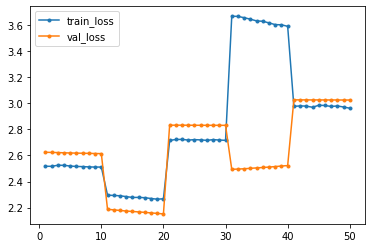

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_59_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_59_10


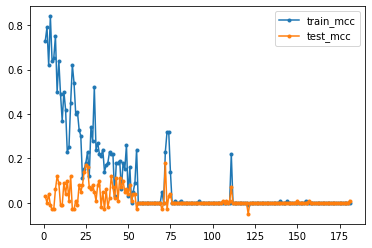

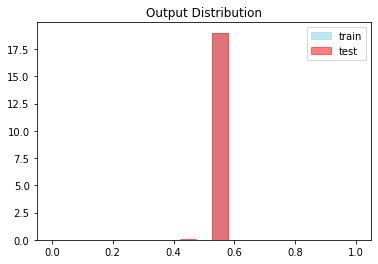




Global Iteration: (2/40) Set Number: (60/64) Epochs: 10  File: train60.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9207 - acc: 0.0233 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9284 - acc: 0.0233 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9223 - acc: 0.0233 - val_loss: 2.8280 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9248 - acc: 0.0233 - val_loss: 2.8280 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9298 - acc: 0.0233 - val_loss: 2.8278 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9308 - acc: 0

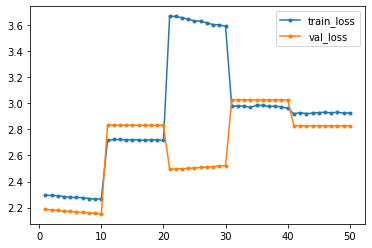

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_60_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_60_10


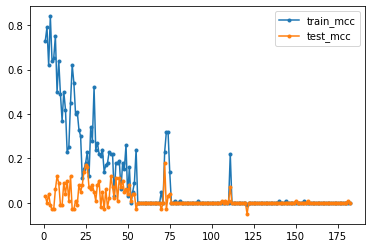

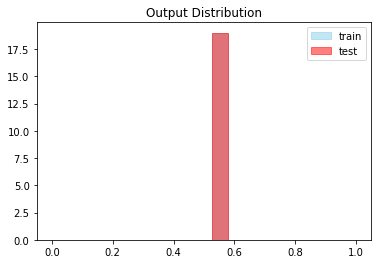




Global Iteration: (2/40) Set Number: (61/64) Epochs: 10  File: train61.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8241 - acc: 0.0217 - val_loss: 3.1253 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 178ms/step - loss: 2.8379 - acc: 0.0217 - val_loss: 3.1254 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8273 - acc: 0.0217 - val_loss: 3.1258 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8155 - acc: 0.0217 - val_loss: 3.1260 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.8346 - acc: 0.0217 - val_loss: 3.1263 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8303 - acc: 0

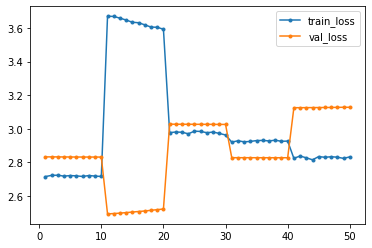

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_61_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_61_10


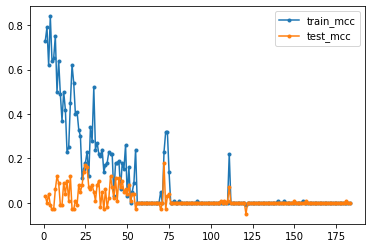

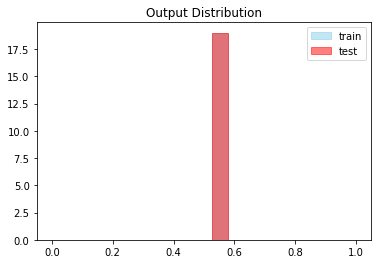




Global Iteration: (2/40) Set Number: (62/64) Epochs: 10  File: train62.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2257 - acc: 0.0125 - val_loss: 2.7256 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2235 - acc: 0.0125 - val_loss: 2.7241 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2111 - acc: 0.0125 - val_loss: 2.7228 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.2082 - acc: 0.0117 - val_loss: 2.7217 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.1978 - acc: 0.0125 - val_loss: 2.7208 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1944 - acc: 0

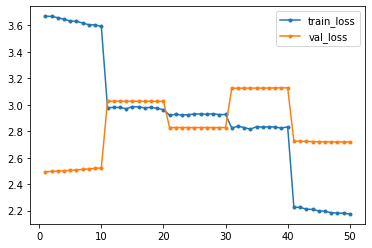

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_62_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_62_10


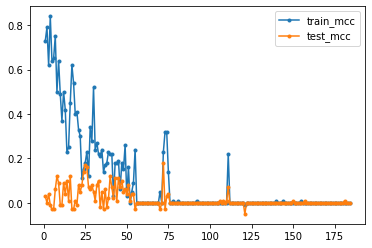

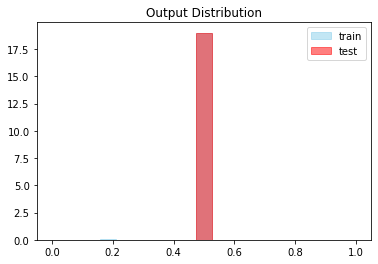




Global Iteration: (2/40) Set Number: (63/64) Epochs: 10  File: train63.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
11/11 [==============================] - 2s 160ms/step - loss: 2.8548 - acc: 0.3164 - val_loss: 3.4524 - val_acc: 0.0311
Epoch 2/10
11/11 [==============================] - 2s 145ms/step - loss: 2.8545 - acc: 0.3797 - val_loss: 3.4531 - val_acc: 0.0311
Epoch 3/10
11/11 [==============================] - 2s 142ms/step - loss: 2.8461 - acc: 0.3826 - val_loss: 3.4523 - val_acc: 0.0311
Epoch 4/10
11/11 [==============================] - 2s 142ms/step - loss: 2.8582 - acc: 0.3960 - val_loss: 3.4525 - val_acc: 0.0311
Epoch 5/10
11/11 [==============================] - 2s 142ms/step - loss: 2.8495 - acc: 0.4008 - val_loss: 3.4512 - val_acc: 0.0311
Epoch 6/10
11/11 [==============================] - 2s 143ms/step - loss: 2.8519 - acc: 0

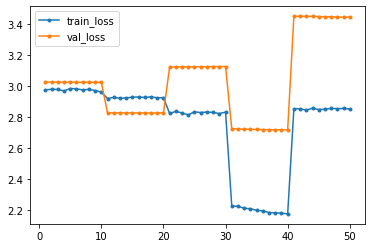

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_63_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_2_63_10


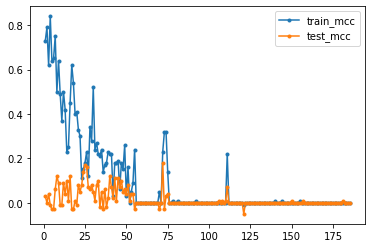

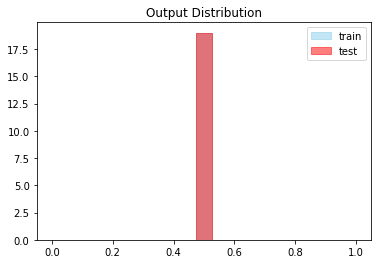




Global Iteration: (3/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8858 - acc: 0.1142 - val_loss: 2.7184 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8846 - acc: 0.0358 - val_loss: 2.7185 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.8788 - acc: 0.0225 - val_loss: 2.7186 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8787 - acc: 0.0225 - val_loss: 2.7186 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8774 - acc: 0.0225 - val_loss: 2.7186 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8793 - acc: 0.0

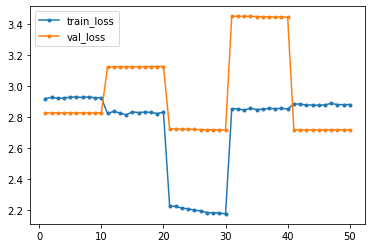

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_0_10


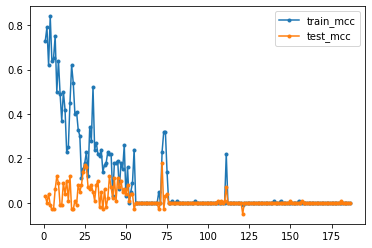

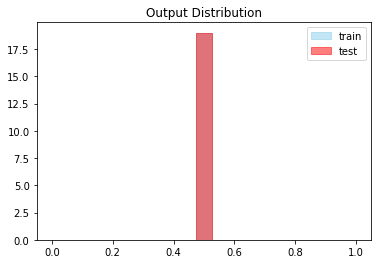




Global Iteration: (3/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5047 - acc: 0.0167 - val_loss: 2.1815 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5127 - acc: 0.0167 - val_loss: 2.2045 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.5167 - acc: 0.0167 - val_loss: 2.1780 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5001 - acc: 0.0167 - val_loss: 2.1763 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 163ms/step - loss: 2.5018 - acc: 0.0167 - val_loss: 2.1740 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4971 - acc: 0.0

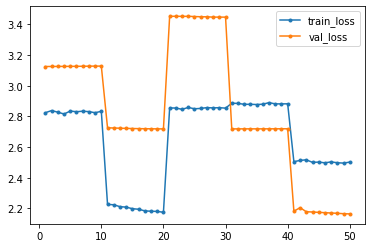

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_1_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_1_10


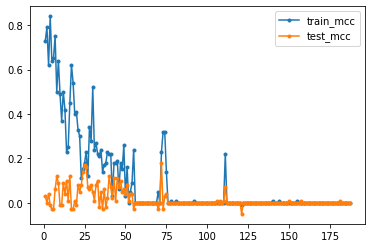

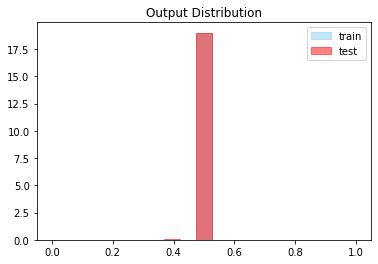




Global Iteration: (3/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.4966 - acc: 0.4692 - val_loss: 3.0504 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4935 - acc: 0.5117 - val_loss: 3.0512 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4944 - acc: 0.6117 - val_loss: 3.0522 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5016 - acc: 0.6850 - val_loss: 3.0548 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5160 - acc: 0.7508 - val_loss: 3.0542 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.4967 - acc: 0.7

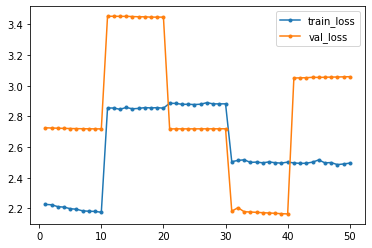

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_2_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_2_10


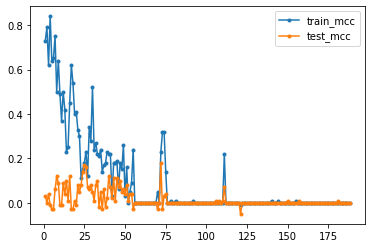

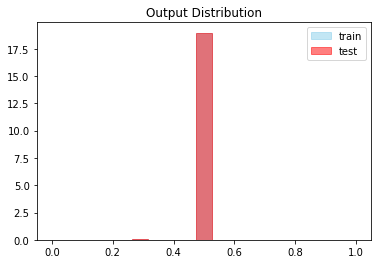




Global Iteration: (3/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.3728 - acc: 0.9850 - val_loss: 3.1872 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.3609 - acc: 0.9850 - val_loss: 3.2227 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4143 - acc: 0.9850 - val_loss: 3.1928 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3579 - acc: 0.9850 - val_loss: 3.2012 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3982 - acc: 0.9850 - val_loss: 3.1973 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3690 - acc: 0.9

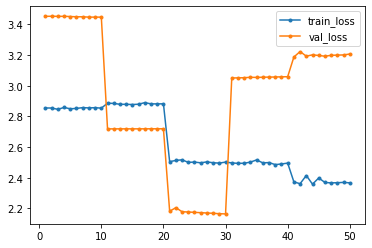

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_3_10


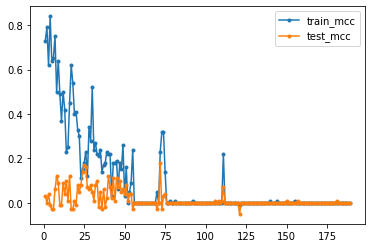

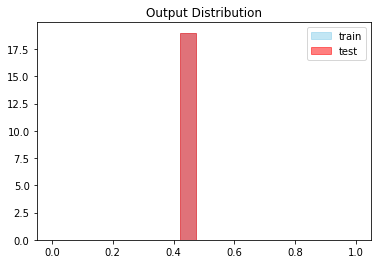




Global Iteration: (3/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.1907 - acc: 0.9875 - val_loss: 3.0996 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1754 - acc: 0.9875 - val_loss: 3.1226 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 177ms/step - loss: 2.1887 - acc: 0.9875 - val_loss: 3.1173 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1298 - acc: 0.9875 - val_loss: 3.1313 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1525 - acc: 0.9875 - val_loss: 3.1712 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.1554 - acc: 0.9

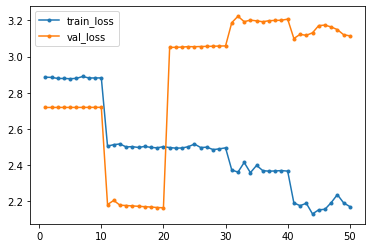

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_4_10


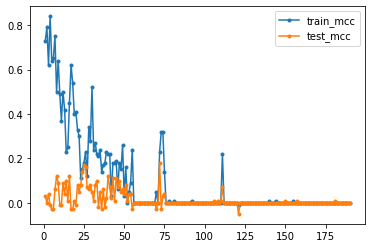

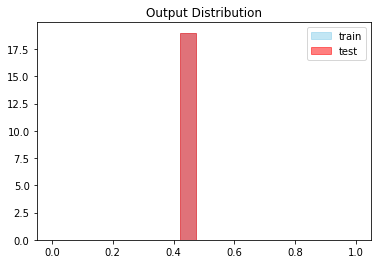




Global Iteration: (3/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9440 - acc: 0.9775 - val_loss: 2.6055 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9377 - acc: 0.9775 - val_loss: 2.6046 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.9019 - acc: 0.9775 - val_loss: 2.6039 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9171 - acc: 0.9775 - val_loss: 2.6037 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9064 - acc: 0.9775 - val_loss: 2.6035 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8997 - acc: 0.9

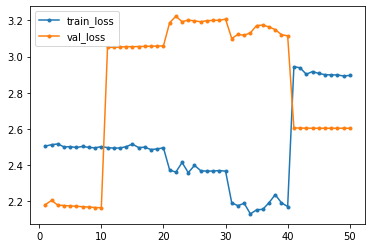

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_5_10


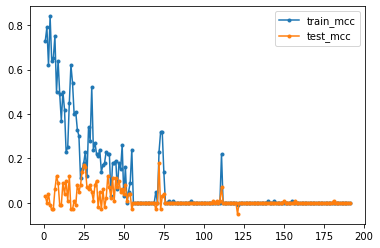

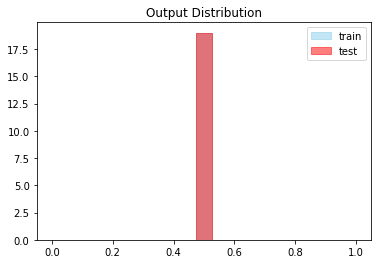




Global Iteration: (3/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 3.1245 - acc: 0.9283 - val_loss: 3.0579 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 3.1080 - acc: 0.6525 - val_loss: 3.0388 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 3.1206 - acc: 0.6192 - val_loss: 3.0392 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1205 - acc: 0.6075 - val_loss: 3.0395 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1003 - acc: 0.6408 - val_loss: 3.0388 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1265 - acc: 0.6

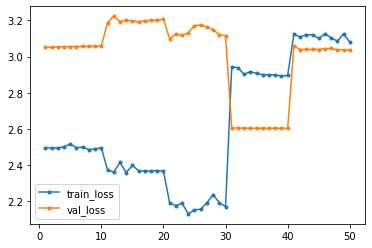

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_6_10


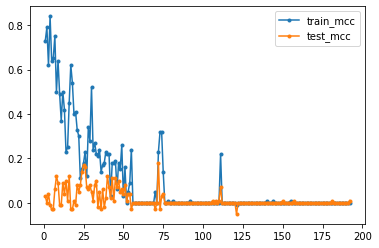

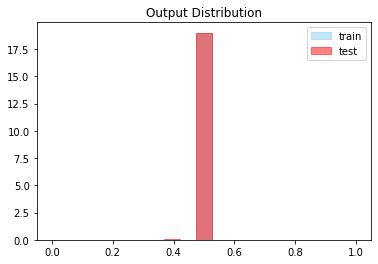




Global Iteration: (3/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.8990 - acc: 0.3050 - val_loss: 2.2021 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8945 - acc: 0.3158 - val_loss: 2.1855 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 177ms/step - loss: 2.8573 - acc: 0.2542 - val_loss: 2.1895 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8906 - acc: 0.2317 - val_loss: 2.1958 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8915 - acc: 0.2033 - val_loss: 2.1911 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8799 - acc: 0.2

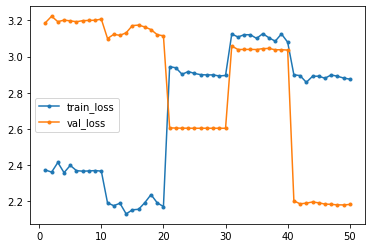

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_7_10


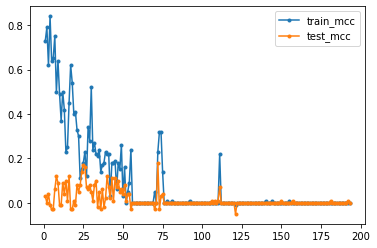

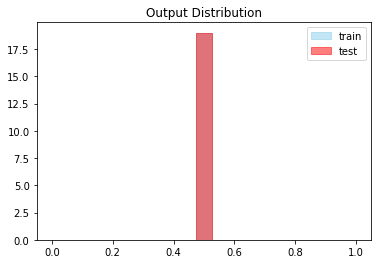




Global Iteration: (3/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5069 - acc: 0.0783 - val_loss: 2.8272 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5079 - acc: 0.1433 - val_loss: 2.8282 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 2.5003 - acc: 0.2358 - val_loss: 2.8292 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4952 - acc: 0.4425 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4943 - acc: 0.5650 - val_loss: 2.8295 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4953 - acc: 0.6

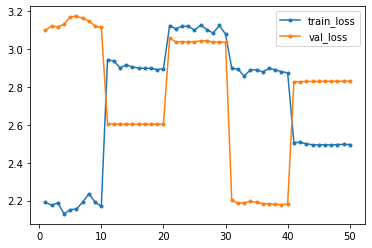

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_8_10


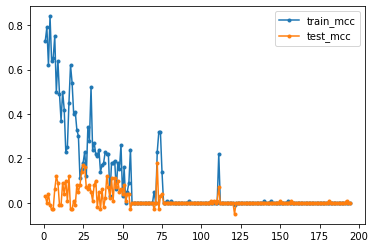

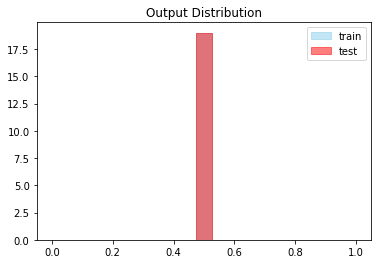




Global Iteration: (3/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5509 - acc: 0.9758 - val_loss: 2.4930 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5505 - acc: 0.9825 - val_loss: 2.4928 - val_acc: 0.9833
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5462 - acc: 0.9825 - val_loss: 2.4925 - val_acc: 0.9833
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5460 - acc: 0.9825 - val_loss: 2.4918 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5482 - acc: 0.9825 - val_loss: 2.4915 - val_acc: 0.9833
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5492 - acc: 0.9

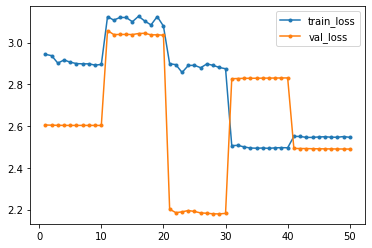

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_9_10


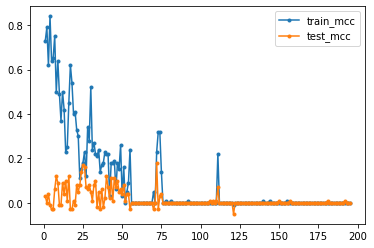

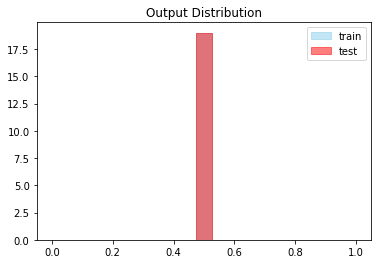




Global Iteration: (3/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.8925 - acc: 0.9775 - val_loss: 3.0616 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8875 - acc: 0.9775 - val_loss: 3.0604 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8898 - acc: 0.9775 - val_loss: 3.0597 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8873 - acc: 0.9775 - val_loss: 3.0591 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8921 - acc: 0.9775 - val_loss: 3.0583 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8877 - acc: 0

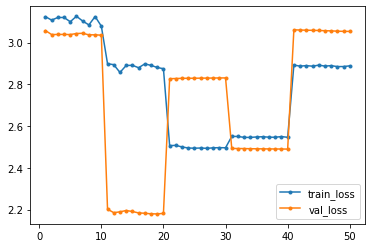

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_10_10


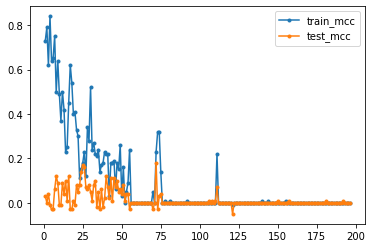

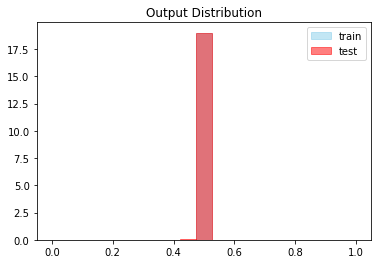




Global Iteration: (3/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6601 - acc: 0.7850 - val_loss: 2.1591 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6611 - acc: 0.7508 - val_loss: 2.1593 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6591 - acc: 0.7717 - val_loss: 2.1593 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6643 - acc: 0.7733 - val_loss: 2.1585 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6580 - acc: 0.8017 - val_loss: 2.1581 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6605 - acc: 0

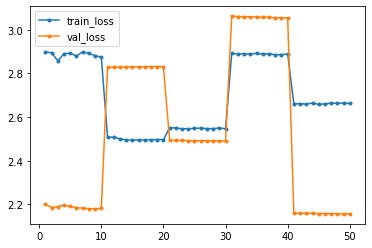

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_11_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_11_10


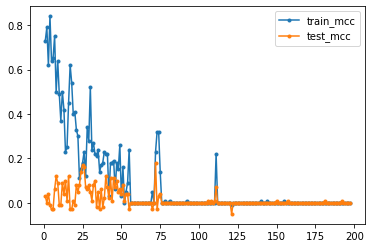

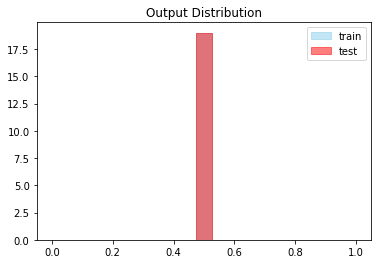




Global Iteration: (3/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8852 - acc: 0.8617 - val_loss: 2.8303 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8830 - acc: 0.8017 - val_loss: 2.8302 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8849 - acc: 0.7500 - val_loss: 2.8300 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8906 - acc: 0.6942 - val_loss: 2.8295 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8845 - acc: 0.6117 - val_loss: 2.8292 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8817 - acc: 0

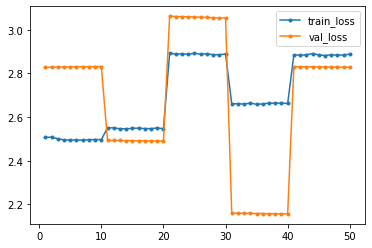

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_12_10


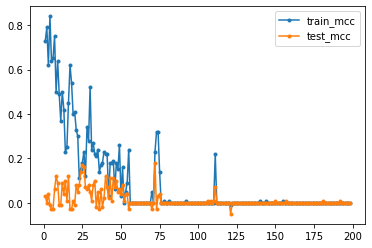

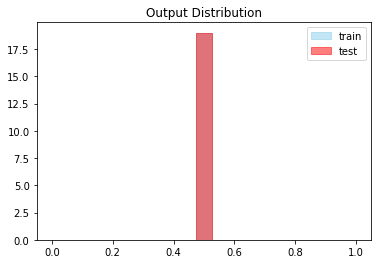




Global Iteration: (3/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 186ms/step - loss: 2.8252 - acc: 0.1892 - val_loss: 2.8281 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8326 - acc: 0.1358 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8270 - acc: 0.1350 - val_loss: 2.8278 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8243 - acc: 0.0683 - val_loss: 2.8277 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8273 - acc: 0.0567 - val_loss: 2.8276 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8266 - acc: 0

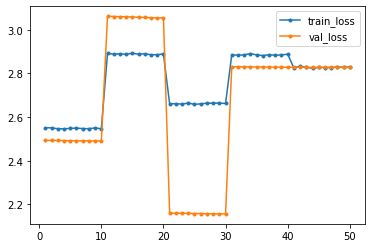

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_13_10


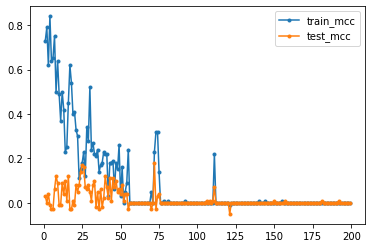

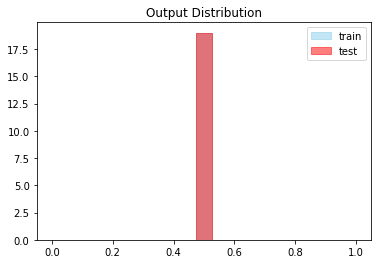




Global Iteration: (3/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.8848 - acc: 0.0225 - val_loss: 3.1525 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8808 - acc: 0.0225 - val_loss: 3.1519 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8790 - acc: 0.0225 - val_loss: 3.1514 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 180ms/step - loss: 2.8823 - acc: 0.0225 - val_loss: 3.1505 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8813 - acc: 0.0225 - val_loss: 3.1502 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8838 - acc: 0

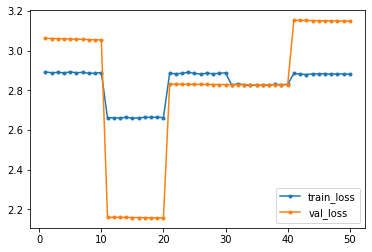

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_14_10


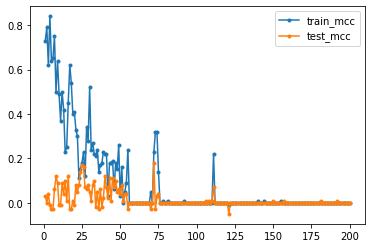

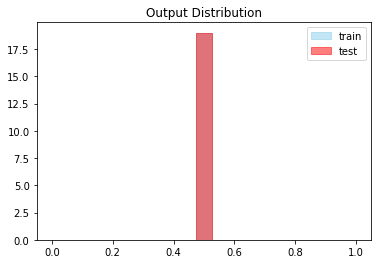




Global Iteration: (3/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 149ms/step - loss: 2.4492 - acc: 0.0158 - val_loss: 3.4355 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 146ms/step - loss: 2.4511 - acc: 0.0158 - val_loss: 3.4383 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 147ms/step - loss: 2.4470 - acc: 0.0158 - val_loss: 3.4413 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 147ms/step - loss: 2.4495 - acc: 0.0158 - val_loss: 3.4439 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 145ms/step - loss: 2.4484 - acc: 0.0158 - val_loss: 3.4468 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 147ms/step - loss: 2.4450 - acc: 0

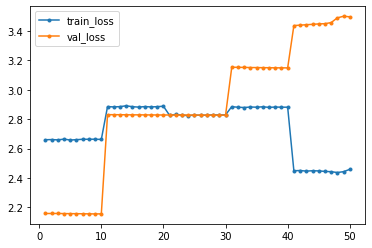

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_15_10


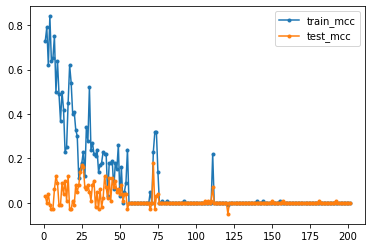

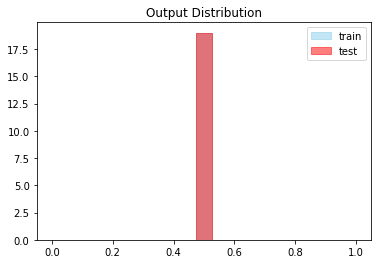




Global Iteration: (3/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7716 - acc: 0.6792 - val_loss: 2.7192 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7772 - acc: 0.6167 - val_loss: 2.7185 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7669 - acc: 0.6067 - val_loss: 2.7184 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7788 - acc: 0.6200 - val_loss: 2.7182 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7788 - acc: 0.5858 - val_loss: 2.7179 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7792 - acc: 0

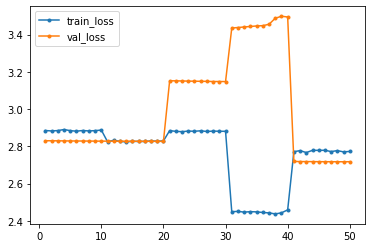

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_16_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_16_10


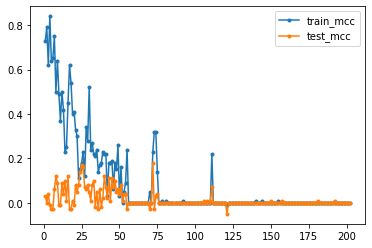

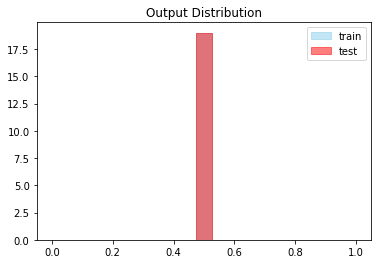




Global Iteration: (3/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.9903 - acc: 0.1583 - val_loss: 3.1571 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9916 - acc: 0.1183 - val_loss: 3.1581 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9947 - acc: 0.2708 - val_loss: 3.1601 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9998 - acc: 0.2092 - val_loss: 3.1533 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9897 - acc: 0.0242 - val_loss: 3.1522 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9912 - acc: 0

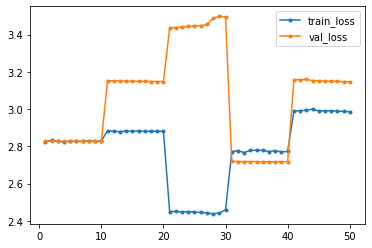

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_17_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_17_10


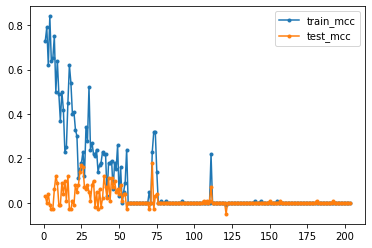

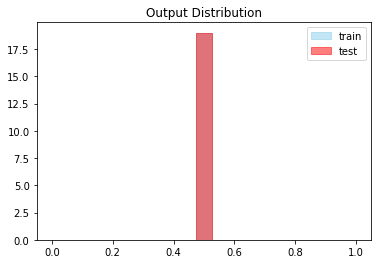




Global Iteration: (3/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 150ms/step - loss: 3.0365 - acc: 0.0250 - val_loss: 3.4311 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 148ms/step - loss: 3.0399 - acc: 0.0250 - val_loss: 3.4290 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 146ms/step - loss: 3.0356 - acc: 0.0258 - val_loss: 3.4260 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 148ms/step - loss: 3.0344 - acc: 0.0267 - val_loss: 3.4229 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 151ms/step - loss: 3.0357 - acc: 0.0258 - val_loss: 3.4221 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 147ms/step - loss: 3.0341 - acc: 0

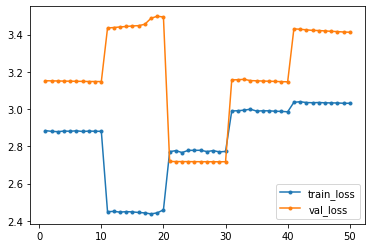

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_18_10


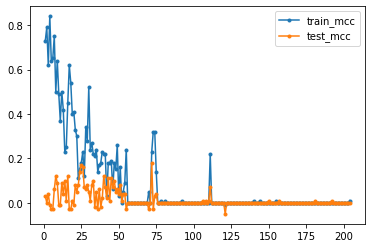

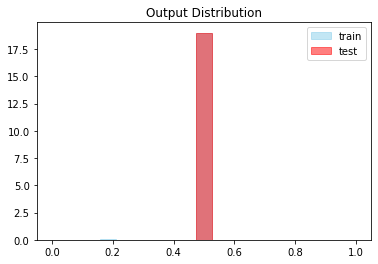




Global Iteration: (3/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5685 - acc: 0.0175 - val_loss: 2.2036 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5661 - acc: 0.0175 - val_loss: 2.2011 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5651 - acc: 0.0175 - val_loss: 2.1989 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 177ms/step - loss: 2.5665 - acc: 0.0175 - val_loss: 2.1968 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5645 - acc: 0.0175 - val_loss: 2.1949 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5627 - acc: 0

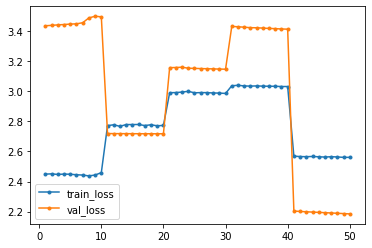

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_19_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_19_10


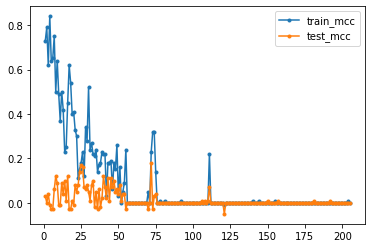

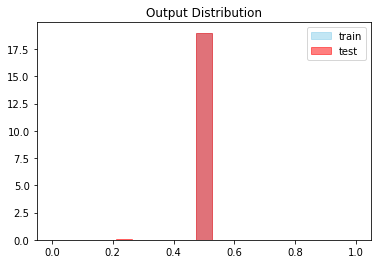




Global Iteration: (3/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.9851 - acc: 0.0242 - val_loss: 2.6125 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9842 - acc: 0.0242 - val_loss: 2.6128 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9847 - acc: 0.0242 - val_loss: 2.6131 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9832 - acc: 0.0242 - val_loss: 2.6135 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9845 - acc: 0.0242 - val_loss: 2.6139 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9862 - acc: 0

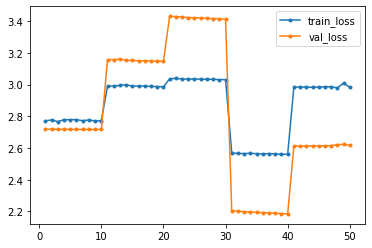

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_20_10


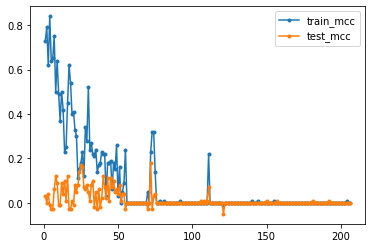

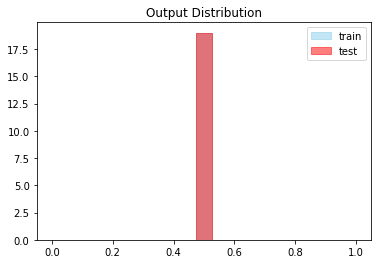




Global Iteration: (3/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9837 - acc: 0.0242 - val_loss: 3.1370 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9772 - acc: 0.0242 - val_loss: 3.1350 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.9718 - acc: 0.0242 - val_loss: 3.1320 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9696 - acc: 0.0242 - val_loss: 3.1286 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0024 - acc: 0.0242 - val_loss: 3.1285 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9769 - acc: 0

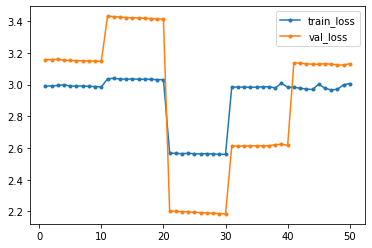

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_21_10


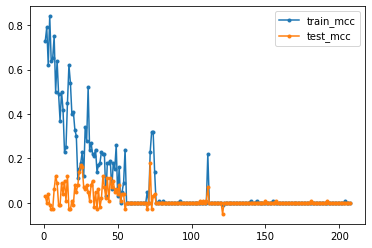

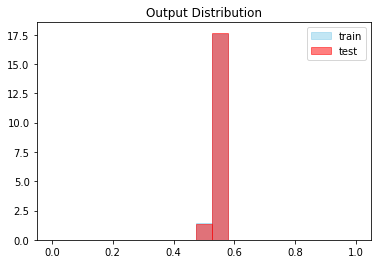




Global Iteration: (3/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0300 - acc: 0.0267 - val_loss: 2.8247 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 178ms/step - loss: 3.0360 - acc: 0.0267 - val_loss: 2.8243 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0222 - acc: 0.0258 - val_loss: 2.8242 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0342 - acc: 0.0267 - val_loss: 2.8239 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0313 - acc: 0.0267 - val_loss: 2.8246 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0269 - acc: 0

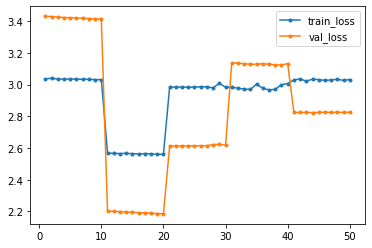

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_22_10


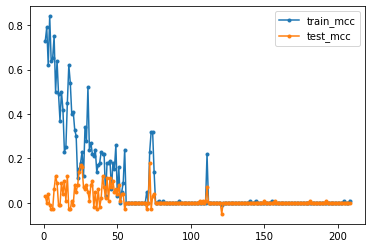

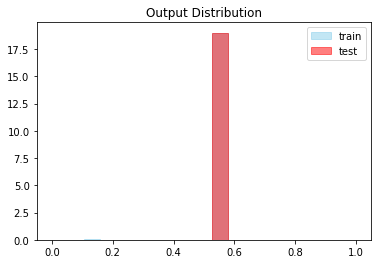




Global Iteration: (3/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.8228 - acc: 0.0292 - val_loss: 3.0283 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8297 - acc: 0.2550 - val_loss: 3.0440 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 179ms/step - loss: 2.7953 - acc: 0.3908 - val_loss: 3.0482 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8379 - acc: 0.4350 - val_loss: 3.0712 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8169 - acc: 0.4158 - val_loss: 3.0454 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7892 - acc: 0

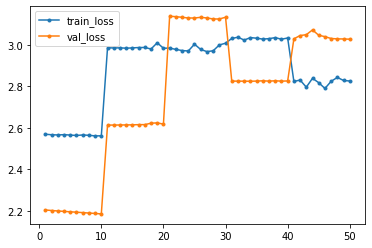

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_23_10


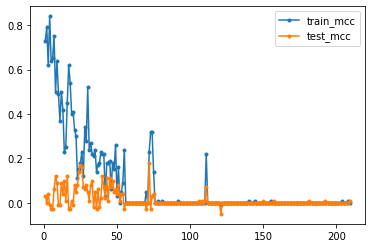

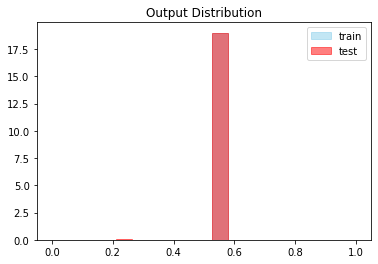




Global Iteration: (3/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.5747 - acc: 0.0175 - val_loss: 2.8254 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 2.5686 - acc: 0.0175 - val_loss: 2.8265 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5598 - acc: 0.0458 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5705 - acc: 0.2667 - val_loss: 2.8246 - val_acc: 0.1300
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5637 - acc: 0.3367 - val_loss: 2.8246 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5973 - acc: 0

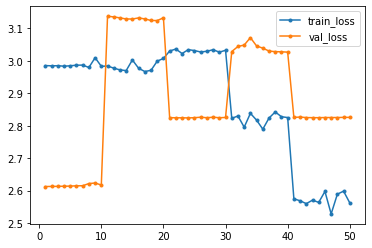

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_24_10


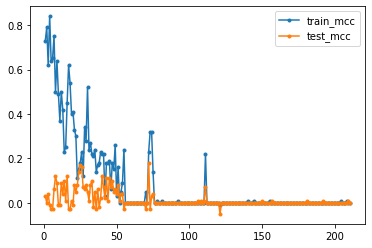

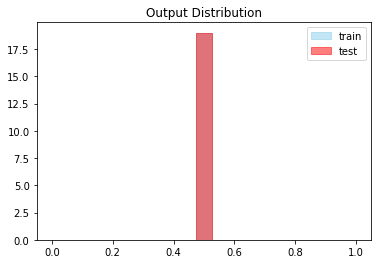




Global Iteration: (3/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.4047 - acc: 0.1150 - val_loss: 3.0369 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.4066 - acc: 0.2358 - val_loss: 3.0389 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4078 - acc: 0.2692 - val_loss: 3.0395 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4256 - acc: 0.2025 - val_loss: 3.0388 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.3915 - acc: 0.0892 - val_loss: 3.0406 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 171ms/step - loss: 2.4019 - acc: 0

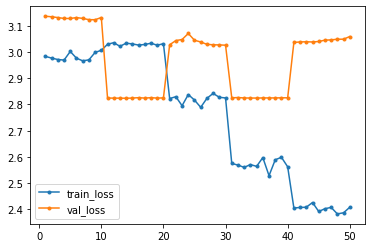

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_25_10


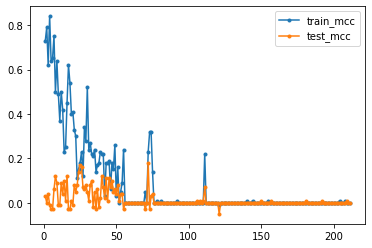

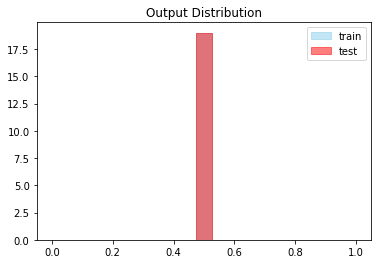




Global Iteration: (3/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7878 - acc: 0.3417 - val_loss: 3.0468 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7660 - acc: 0.2717 - val_loss: 3.0452 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7743 - acc: 0.3167 - val_loss: 3.0467 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 176ms/step - loss: 2.7649 - acc: 0.3100 - val_loss: 3.0482 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8029 - acc: 0.3108 - val_loss: 3.0471 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7731 - acc: 0

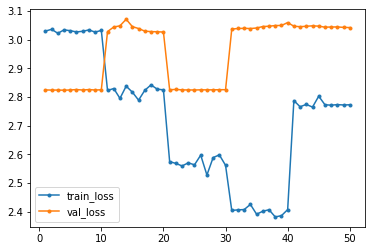

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_26_10


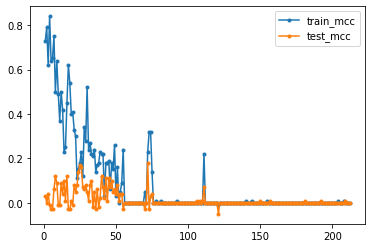

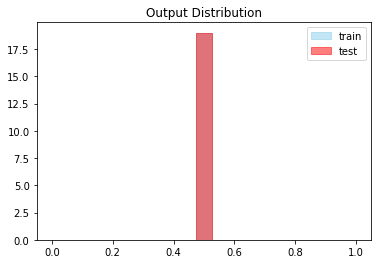




Global Iteration: (3/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 3.1503 - acc: 0.0267 - val_loss: 2.1805 - val_acc: 0.0133
Epoch 2/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1499 - acc: 0.0267 - val_loss: 2.1830 - val_acc: 0.0133
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1461 - acc: 0.0267 - val_loss: 2.1861 - val_acc: 0.0133
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1438 - acc: 0.0267 - val_loss: 2.1887 - val_acc: 0.0133
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1447 - acc: 0.0267 - val_loss: 2.1919 - val_acc: 0.0133
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1447 - acc: 0

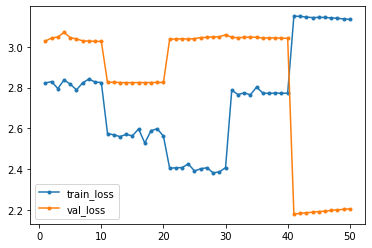

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_27_10


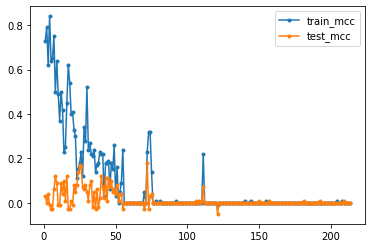

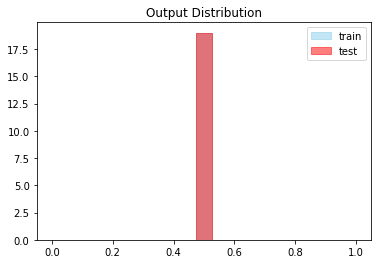




Global Iteration: (3/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9835 - acc: 0.0242 - val_loss: 2.5175 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9782 - acc: 0.0242 - val_loss: 2.5184 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9811 - acc: 0.0242 - val_loss: 2.5192 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9802 - acc: 0.0242 - val_loss: 2.5200 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9724 - acc: 0.0242 - val_loss: 2.5211 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9791 - acc: 0

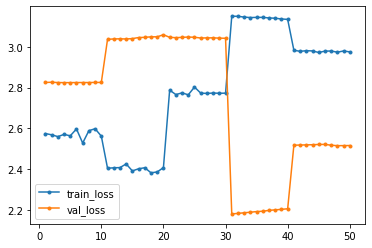

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_28_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_28_10


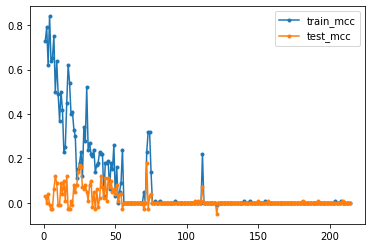

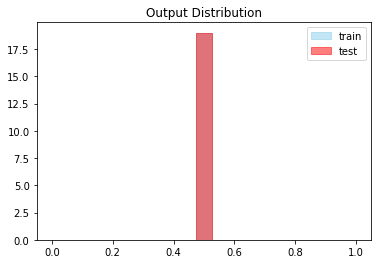




Global Iteration: (3/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9340 - acc: 0.0233 - val_loss: 3.0318 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9296 - acc: 0.0233 - val_loss: 3.0311 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9301 - acc: 0.0233 - val_loss: 3.0300 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9272 - acc: 0.0233 - val_loss: 3.0266 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9335 - acc: 0.0233 - val_loss: 3.0271 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9380 - acc: 0

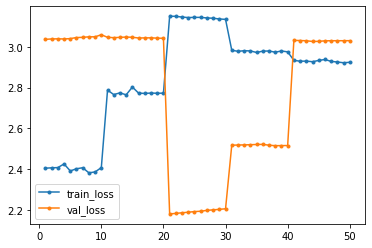

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_29_10


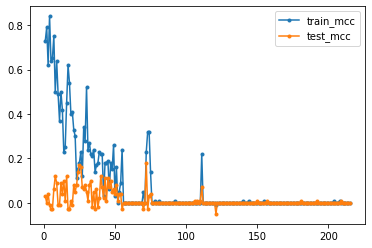

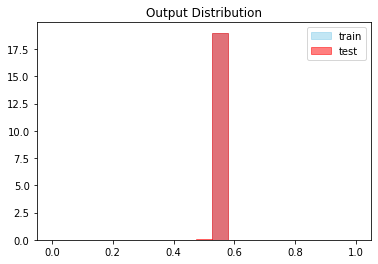




Global Iteration: (3/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.8233 - acc: 0.0217 - val_loss: 2.4169 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8205 - acc: 0.0217 - val_loss: 2.4160 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8210 - acc: 0.0217 - val_loss: 2.4154 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8244 - acc: 0.0217 - val_loss: 2.4139 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8265 - acc: 0.0217 - val_loss: 2.4137 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8304 - acc: 0

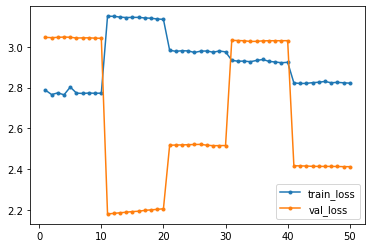

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_30_10


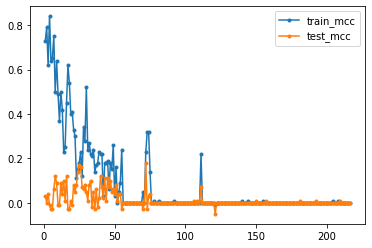

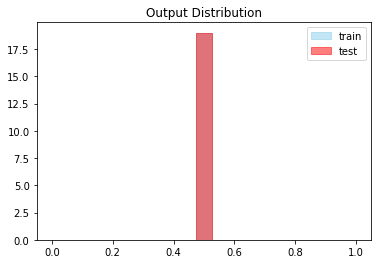




Global Iteration: (3/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.7297 - acc: 0.0200 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 178ms/step - loss: 2.7218 - acc: 0.0200 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7336 - acc: 0.0200 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7287 - acc: 0.0200 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7284 - acc: 0.0200 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7198 - acc: 0

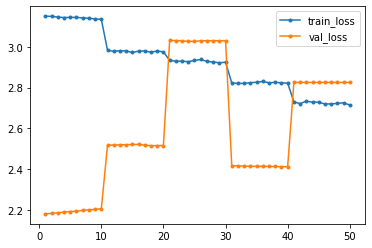

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_31_10


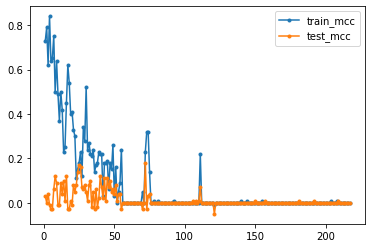

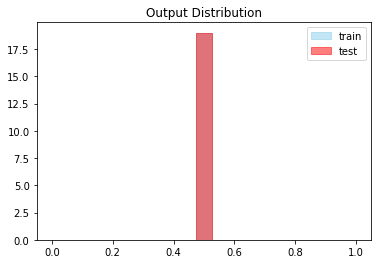




Global Iteration: (3/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6131 - acc: 0.0183 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6111 - acc: 0.0183 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.6207 - acc: 0.0183 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6084 - acc: 0.0183 - val_loss: 2.8257 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6246 - acc: 0.0183 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6088 - acc: 0

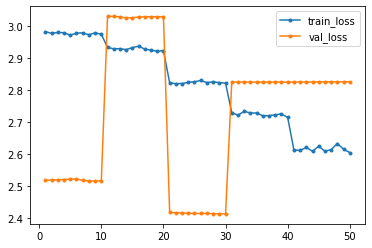

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_32_10


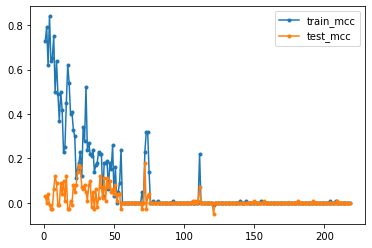

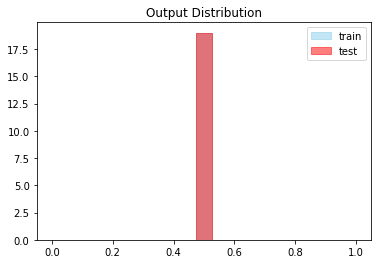




Global Iteration: (3/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2994 - acc: 0.2600 - val_loss: 2.5029 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.3055 - acc: 0.2600 - val_loss: 2.5040 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2982 - acc: 0.0575 - val_loss: 2.5068 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.3069 - acc: 0.0300 - val_loss: 2.5096 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2974 - acc: 0.0292 - val_loss: 2.5123 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2877 - acc: 0

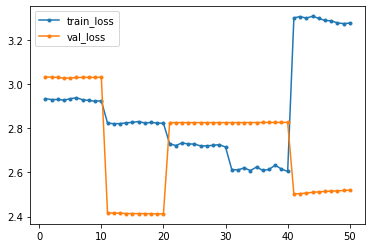

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_33_10


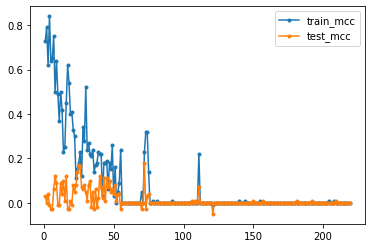

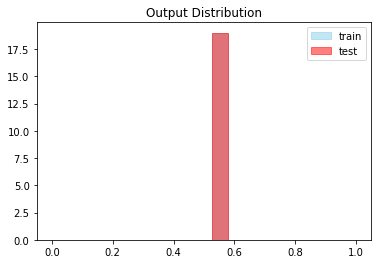




Global Iteration: (3/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 160ms/step - loss: 2.5780 - acc: 0.0175 - val_loss: 3.4039 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 148ms/step - loss: 2.5845 - acc: 0.0175 - val_loss: 3.4054 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 149ms/step - loss: 2.5771 - acc: 0.0175 - val_loss: 3.4075 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 153ms/step - loss: 2.5801 - acc: 0.0175 - val_loss: 3.4092 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 150ms/step - loss: 2.5693 - acc: 0.0175 - val_loss: 3.4117 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 148ms/step - loss: 2.5726 - acc: 0

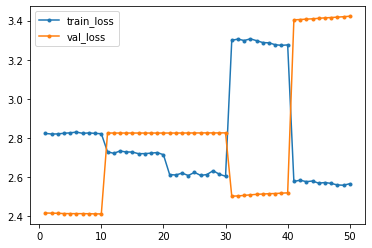

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_34_10


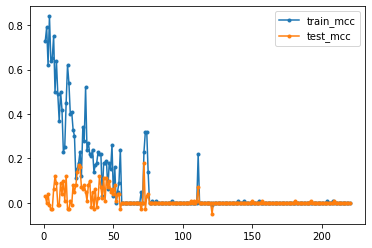

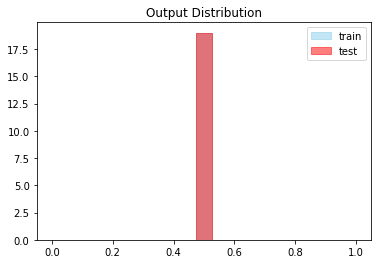




Global Iteration: (3/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7813 - acc: 0.0208 - val_loss: 2.7202 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7734 - acc: 0.0208 - val_loss: 2.7203 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 2.7721 - acc: 0.0208 - val_loss: 2.7202 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7731 - acc: 0.0208 - val_loss: 2.7201 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7703 - acc: 0.0208 - val_loss: 2.7199 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7682 - acc: 0

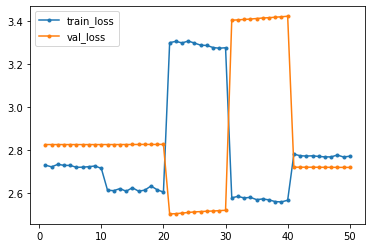

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_35_10


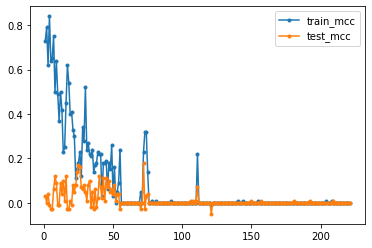

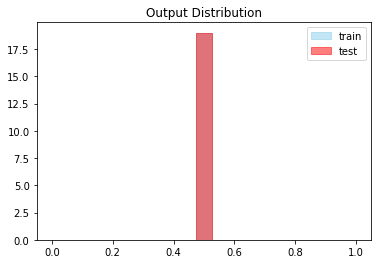




Global Iteration: (3/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6192 - acc: 0.0183 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6154 - acc: 0.0183 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.6173 - acc: 0.0183 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6217 - acc: 0.0183 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6064 - acc: 0.0183 - val_loss: 2.8260 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6125 - acc: 0

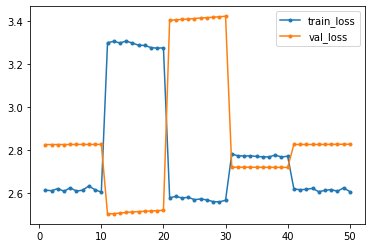

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_36_10


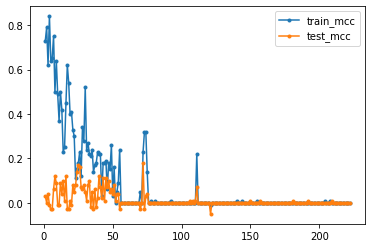

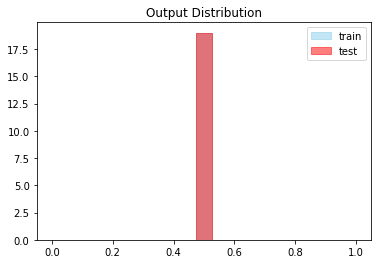




Global Iteration: (3/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 181ms/step - loss: 2.5644 - acc: 0.3017 - val_loss: 2.7180 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5531 - acc: 0.2950 - val_loss: 2.7179 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5642 - acc: 0.3133 - val_loss: 2.7179 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5562 - acc: 0.3217 - val_loss: 2.7179 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5549 - acc: 0.3292 - val_loss: 2.7179 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5585 - acc: 0

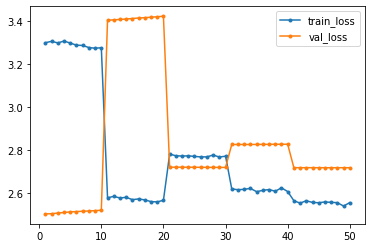

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_37_10


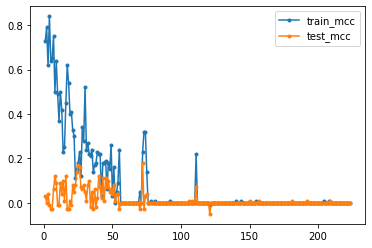

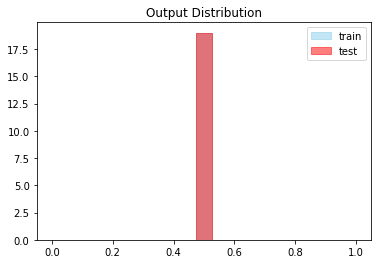




Global Iteration: (3/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4433 - acc: 0.3917 - val_loss: 3.1683 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.4488 - acc: 0.3700 - val_loss: 3.1729 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.4558 - acc: 0.3742 - val_loss: 3.1672 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4481 - acc: 0.3892 - val_loss: 3.1668 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4420 - acc: 0.3517 - val_loss: 3.1671 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4359 - acc: 0

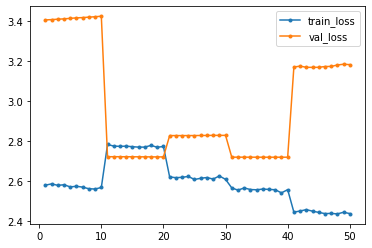

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_38_10


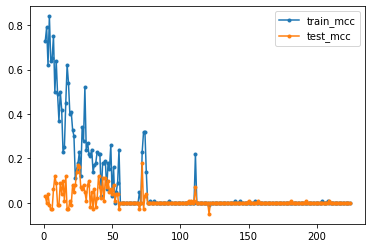

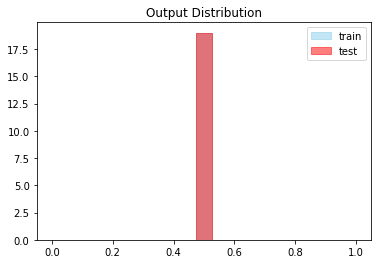




Global Iteration: (3/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9901 - acc: 0.8758 - val_loss: 2.8354 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 177ms/step - loss: 3.0183 - acc: 0.8550 - val_loss: 2.8331 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9899 - acc: 0.8100 - val_loss: 2.8320 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0128 - acc: 0.5650 - val_loss: 2.8303 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9995 - acc: 0.3942 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9975 - acc: 0

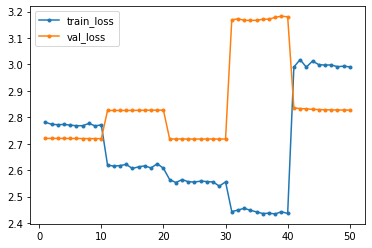

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_39_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_39_10


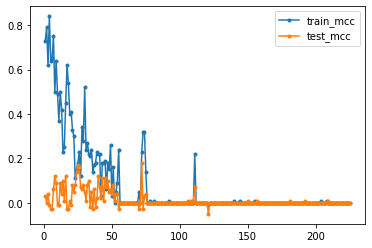

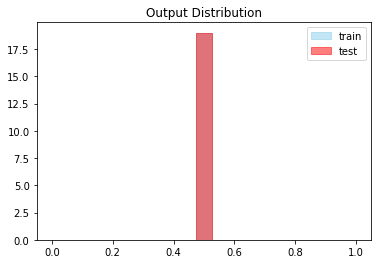




Global Iteration: (3/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.4975 - acc: 0.0167 - val_loss: 2.3900 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4991 - acc: 0.0167 - val_loss: 2.3892 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5006 - acc: 0.0350 - val_loss: 2.3884 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4983 - acc: 0.1633 - val_loss: 2.3875 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5007 - acc: 0.2392 - val_loss: 2.3861 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4934 - acc: 0

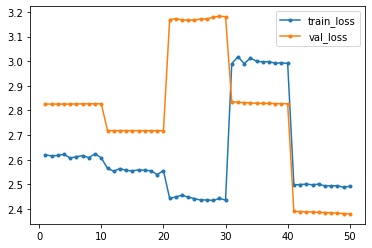

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_40_10


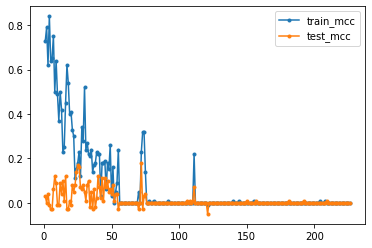

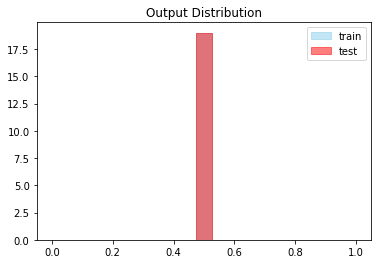




Global Iteration: (3/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.8918 - acc: 0.7692 - val_loss: 2.8308 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8865 - acc: 0.6233 - val_loss: 2.8300 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8868 - acc: 0.4708 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8814 - acc: 0.4783 - val_loss: 2.8291 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8831 - acc: 0.4533 - val_loss: 2.8290 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8841 - acc: 0

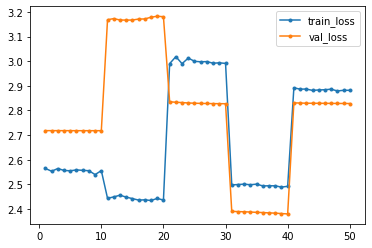

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_41_10


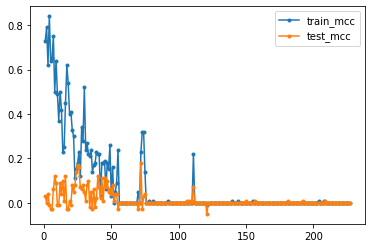

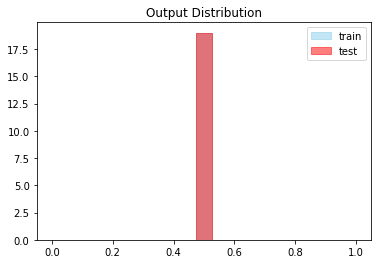




Global Iteration: (3/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5007 - acc: 0.3183 - val_loss: 3.0486 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4973 - acc: 0.3667 - val_loss: 3.0497 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4969 - acc: 0.3967 - val_loss: 3.0504 - val_acc: 0.6267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4976 - acc: 0.4200 - val_loss: 3.0511 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4998 - acc: 0.4767 - val_loss: 3.0520 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4910 - acc: 0

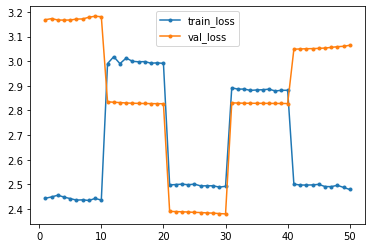

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_42_10


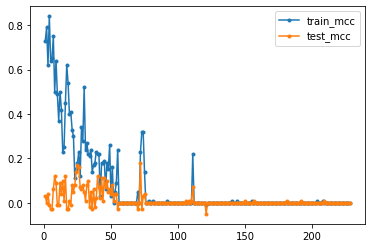

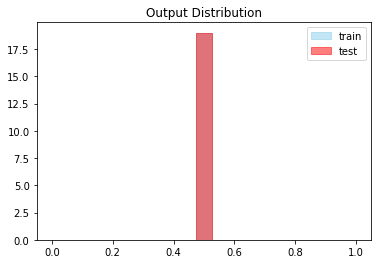




Global Iteration: (3/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9557 - acc: 0.9250 - val_loss: 2.4885 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9528 - acc: 0.9208 - val_loss: 2.4907 - val_acc: 0.9833
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.9332 - acc: 0.8892 - val_loss: 2.4915 - val_acc: 0.9833
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9401 - acc: 0.5833 - val_loss: 2.4919 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9518 - acc: 0.4842 - val_loss: 2.4938 - val_acc: 0.9833
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9402 - acc: 0

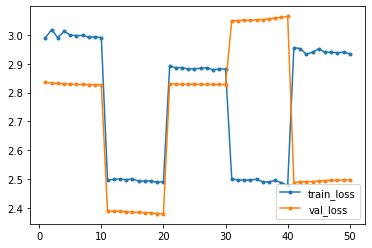

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_43_10


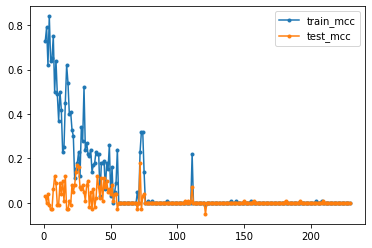

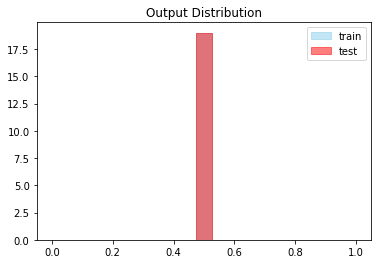




Global Iteration: (3/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.6128 - acc: 0.2400 - val_loss: 2.6080 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6081 - acc: 0.1750 - val_loss: 2.6079 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 177ms/step - loss: 2.6116 - acc: 0.2250 - val_loss: 2.6079 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6097 - acc: 0.1875 - val_loss: 2.6078 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6043 - acc: 0.2867 - val_loss: 2.6075 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6046 - acc: 0

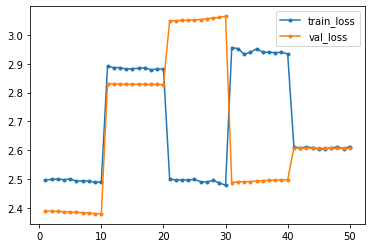

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_44_10


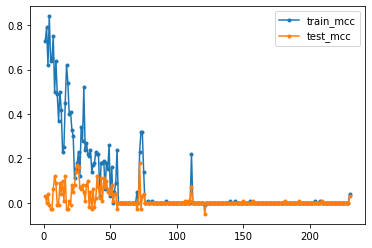

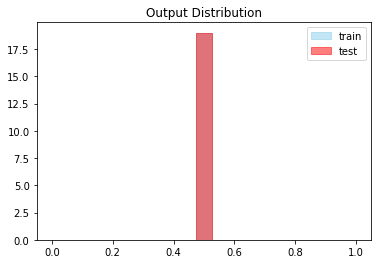




Global Iteration: (3/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7177 - acc: 0.4667 - val_loss: 2.4957 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7208 - acc: 0.4600 - val_loss: 2.4961 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.7164 - acc: 0.4558 - val_loss: 2.4959 - val_acc: 0.9833
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7145 - acc: 0.5067 - val_loss: 2.4956 - val_acc: 0.9833
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7225 - acc: 0.4667 - val_loss: 2.4958 - val_acc: 0.9833
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7167 - acc: 0

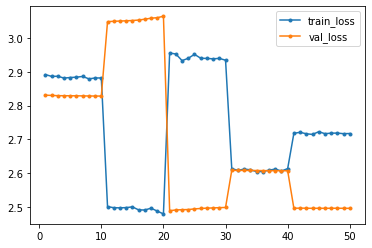

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_45_10


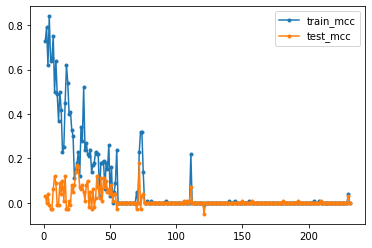

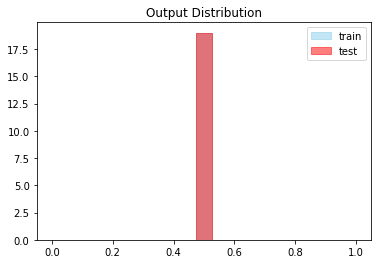




Global Iteration: (3/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1640 - acc: 0.4750 - val_loss: 3.0499 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1571 - acc: 0.3867 - val_loss: 3.0483 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1576 - acc: 0.1733 - val_loss: 3.0467 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1577 - acc: 0.0267 - val_loss: 3.0453 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 172ms/step - loss: 3.1528 - acc: 0.0267 - val_loss: 3.0441 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1505 - acc: 0

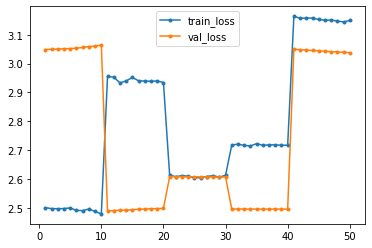

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_46_10


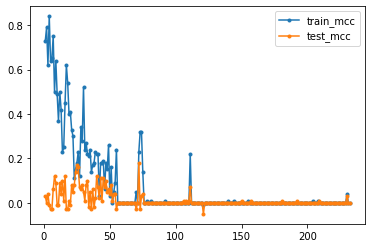

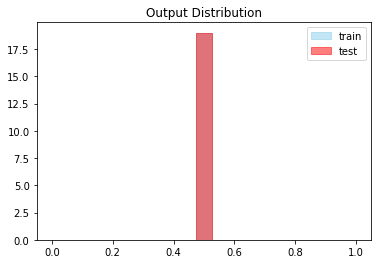




Global Iteration: (3/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.9308 - acc: 0.0233 - val_loss: 2.6132 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9310 - acc: 0.0233 - val_loss: 2.6135 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9285 - acc: 0.0233 - val_loss: 2.6137 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9309 - acc: 0.0233 - val_loss: 2.6138 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9310 - acc: 0.0233 - val_loss: 2.6141 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9323 - acc: 0

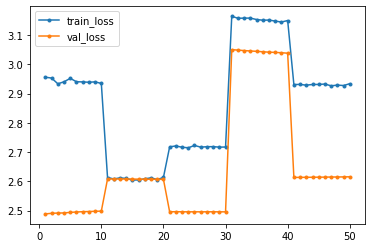

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_47_10


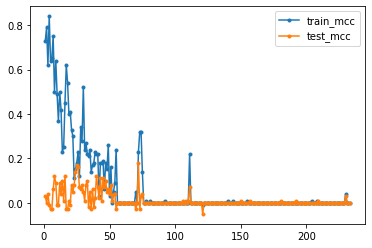

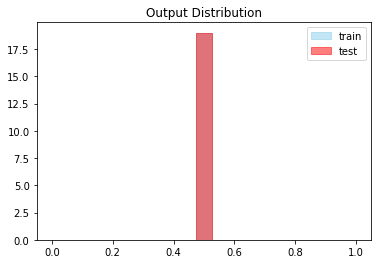




Global Iteration: (3/40) Set Number: (48/64) Epochs: 10  File: train48.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 3.2377 - acc: 0.0283 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2321 - acc: 0.0283 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2382 - acc: 0.0283 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2348 - acc: 0.0283 - val_loss: 2.8235 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.2329 - acc: 0.0283 - val_loss: 2.8252 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2324 - acc: 0

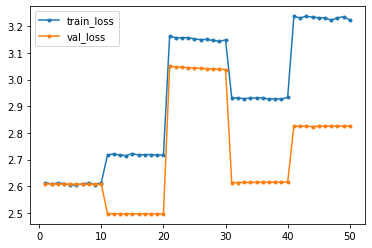

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_48_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_48_10


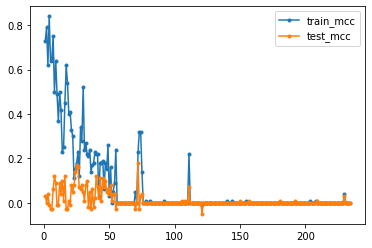

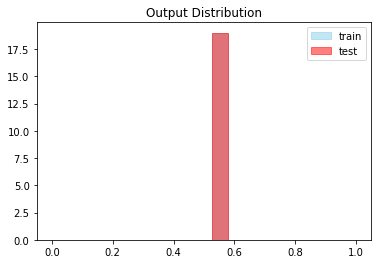




Global Iteration: (3/40) Set Number: (49/64) Epochs: 10  File: train49.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2814 - acc: 0.0292 - val_loss: 2.8261 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2724 - acc: 0.0292 - val_loss: 2.8262 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 181ms/step - loss: 3.2737 - acc: 0.0292 - val_loss: 2.8263 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2660 - acc: 0.0292 - val_loss: 2.8266 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.2704 - acc: 0.0292 - val_loss: 2.8266 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2647 - acc: 0

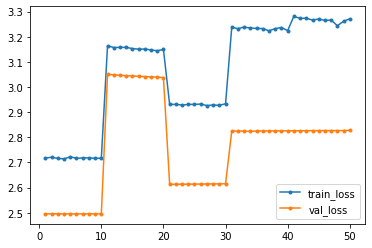

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_49_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_49_10


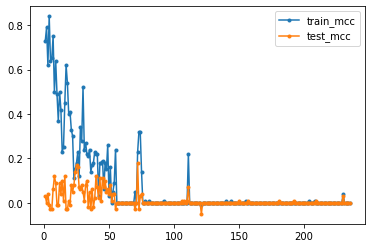

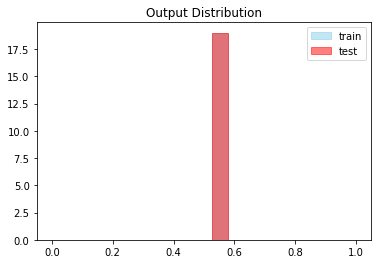




Global Iteration: (3/40) Set Number: (50/64) Epochs: 10  File: train50.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6044 - acc: 0.0175 - val_loss: 2.6332 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5931 - acc: 0.0175 - val_loss: 2.6322 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5920 - acc: 0.0175 - val_loss: 2.6308 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5844 - acc: 0.0175 - val_loss: 2.6296 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5916 - acc: 0.0175 - val_loss: 2.6283 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5879 - acc: 0

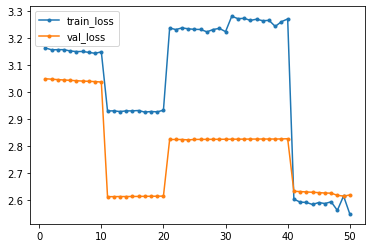

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_50_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_50_10


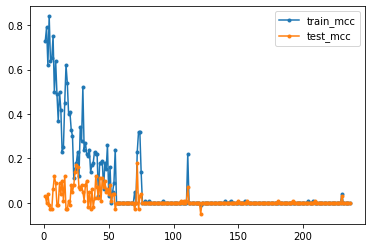

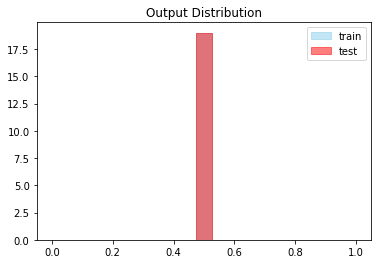




Global Iteration: (3/40) Set Number: (51/64) Epochs: 10  File: train51.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.52 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 182ms/step - loss: 2.9998 - acc: 0.2725 - val_loss: 2.6155 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0073 - acc: 0.3325 - val_loss: 2.6072 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1251 - acc: 0.2350 - val_loss: 2.6239 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0382 - acc: 0.0250 - val_loss: 2.6498 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0531 - acc: 0.0250 - val_loss: 2.6343 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0263 - acc: 0

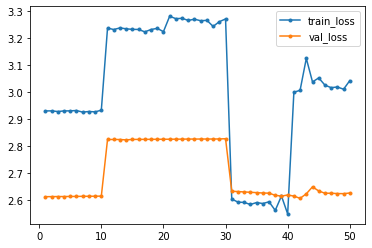

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_51_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_51_10


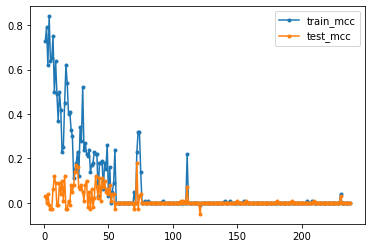

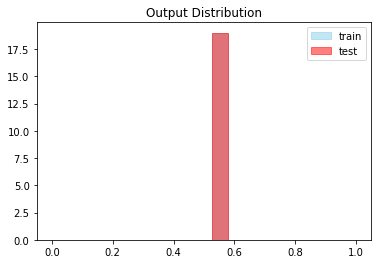




Global Iteration: (3/40) Set Number: (52/64) Epochs: 10  File: train52.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.3801 - acc: 0.0192 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3754 - acc: 0.0700 - val_loss: 2.8247 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3568 - acc: 0.1992 - val_loss: 2.8244 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 176ms/step - loss: 2.3387 - acc: 0.3583 - val_loss: 2.8287 - val_acc: 0.9567
Epoch 5/10
12/12 [==============================] - 2s 173ms/step - loss: 2.2564 - acc: 0.5142 - val_loss: 2.8665 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3680 - acc: 0

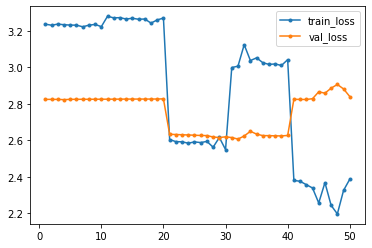

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_52_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_52_10


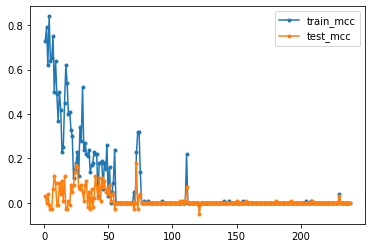

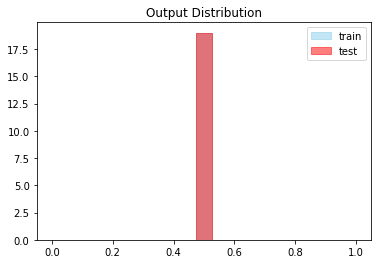




Global Iteration: (3/40) Set Number: (53/64) Epochs: 10  File: train53.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8722 - acc: 0.3600 - val_loss: 2.7207 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9671 - acc: 0.2800 - val_loss: 2.7184 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9498 - acc: 0.2550 - val_loss: 2.7202 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9506 - acc: 0.2608 - val_loss: 2.7208 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9262 - acc: 0.2458 - val_loss: 2.7225 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9195 - acc: 0

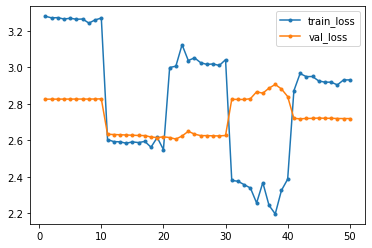

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_53_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_53_10


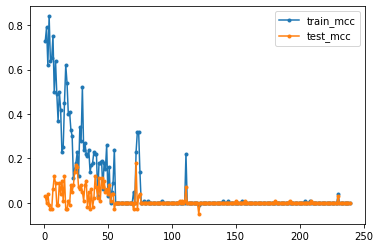

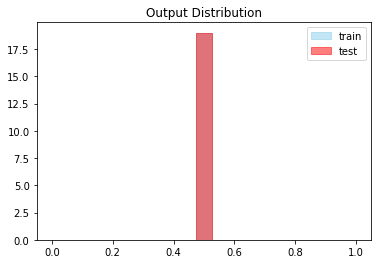




Global Iteration: (3/40) Set Number: (54/64) Epochs: 10  File: train54.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 192ms/step - loss: 3.0100 - acc: 0.2525 - val_loss: 2.5078 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0428 - acc: 0.2592 - val_loss: 2.5111 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0039 - acc: 0.2800 - val_loss: 2.5121 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0715 - acc: 0.2650 - val_loss: 2.5177 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0382 - acc: 0.0675 - val_loss: 2.5241 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0365 - acc: 0

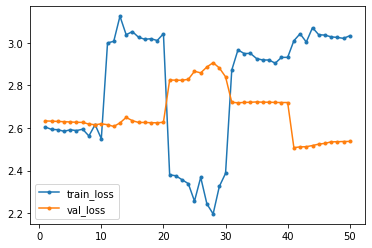

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_54_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_54_10


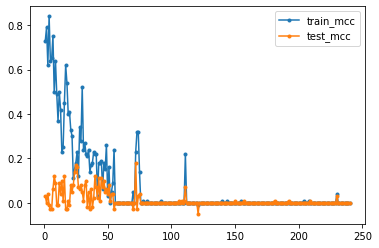

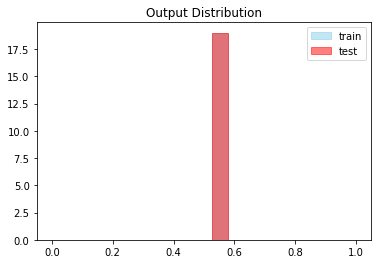




Global Iteration: (3/40) Set Number: (55/64) Epochs: 10  File: train55.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5385 - acc: 0.0167 - val_loss: 2.8286 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5311 - acc: 0.0167 - val_loss: 2.8280 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5317 - acc: 0.0167 - val_loss: 2.8275 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5305 - acc: 0.0167 - val_loss: 2.8269 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5259 - acc: 0.0167 - val_loss: 2.8265 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5276 - acc: 0

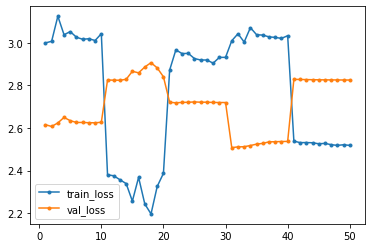

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_55_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_55_10


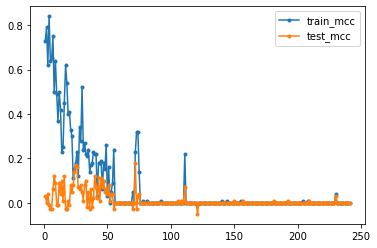

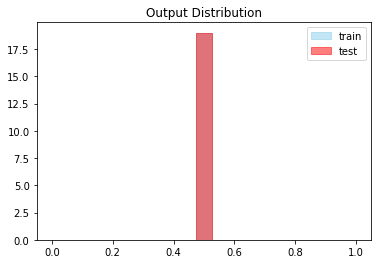




Global Iteration: (3/40) Set Number: (56/64) Epochs: 10  File: train56.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.3107 - acc: 0.0133 - val_loss: 3.0322 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 176ms/step - loss: 2.3077 - acc: 0.0133 - val_loss: 3.0336 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3028 - acc: 0.0133 - val_loss: 3.0352 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2977 - acc: 0.0133 - val_loss: 3.0366 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2957 - acc: 0.0133 - val_loss: 3.0384 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2937 - acc: 0

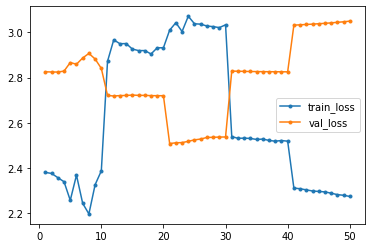

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_56_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_56_10


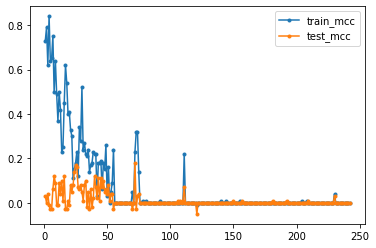

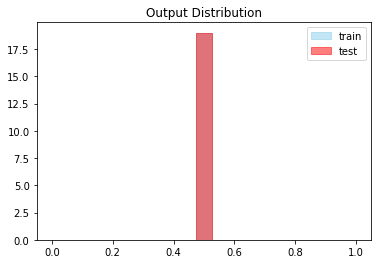




Global Iteration: (3/40) Set Number: (57/64) Epochs: 10  File: train57.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.7196 - acc: 0.4850 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7066 - acc: 0.4917 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7142 - acc: 0.5017 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7250 - acc: 0.5008 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.7233 - acc: 0.4883 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7143 - acc: 0

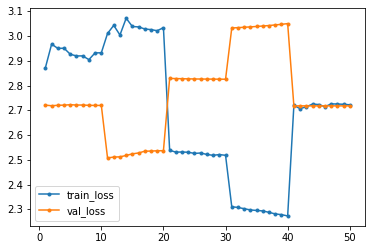

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_57_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_57_10


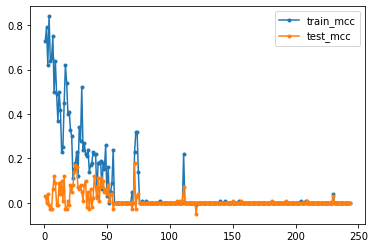

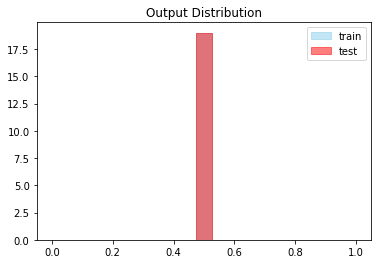




Global Iteration: (3/40) Set Number: (58/64) Epochs: 10  File: train58.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6588 - acc: 0.5033 - val_loss: 3.1575 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.6522 - acc: 0.1292 - val_loss: 3.1524 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6341 - acc: 0.0342 - val_loss: 3.1478 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.6268 - acc: 0.0342 - val_loss: 3.1440 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6212 - acc: 0.0342 - val_loss: 3.1395 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6070 - acc: 0

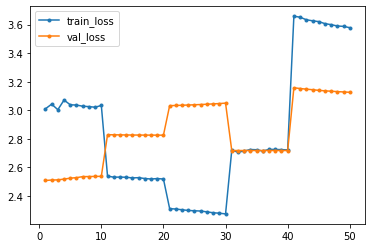

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_58_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_58_10


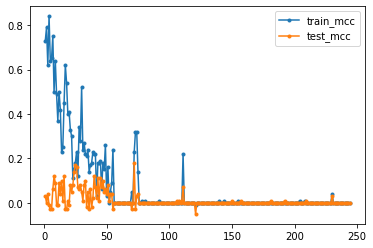

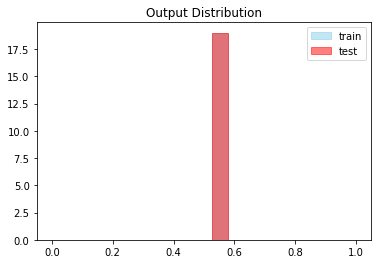




Global Iteration: (3/40) Set Number: (59/64) Epochs: 10  File: train59.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9785 - acc: 0.0242 - val_loss: 2.7282 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9752 - acc: 0.0242 - val_loss: 2.7288 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9780 - acc: 0.0242 - val_loss: 2.7288 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9775 - acc: 0.0242 - val_loss: 2.7288 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9805 - acc: 0.0242 - val_loss: 2.7288 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9736 - acc: 0

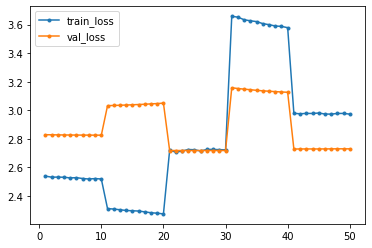

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_59_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_59_10


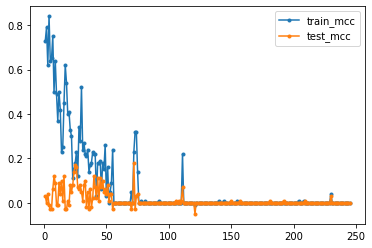

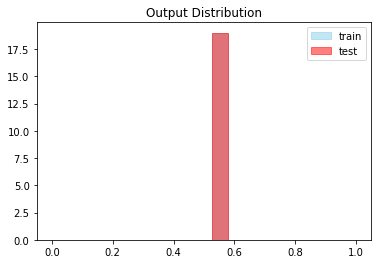




Global Iteration: (3/40) Set Number: (60/64) Epochs: 10  File: train60.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.9286 - acc: 0.0233 - val_loss: 2.6315 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9304 - acc: 0.0233 - val_loss: 2.6322 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9252 - acc: 0.0233 - val_loss: 2.6318 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9275 - acc: 0.0233 - val_loss: 2.6314 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9258 - acc: 0.0233 - val_loss: 2.6316 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9260 - acc: 0

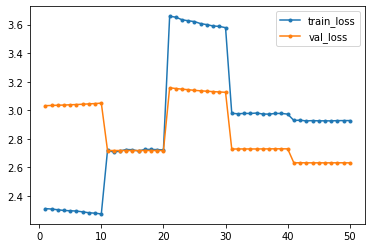

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_60_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_60_10


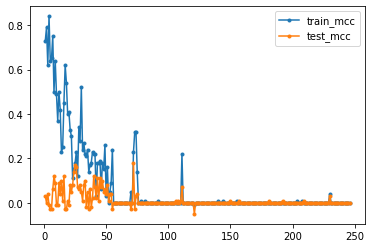

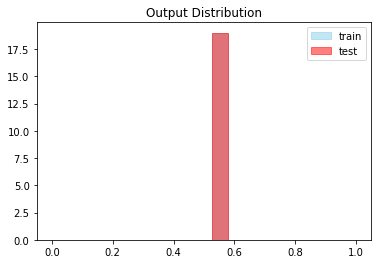




Global Iteration: (3/40) Set Number: (61/64) Epochs: 10  File: train61.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8305 - acc: 0.0217 - val_loss: 3.0248 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8273 - acc: 0.0217 - val_loss: 3.0250 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.8268 - acc: 0.0217 - val_loss: 3.0251 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8280 - acc: 0.0217 - val_loss: 3.0252 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8303 - acc: 0.0217 - val_loss: 3.0253 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8263 - acc: 0

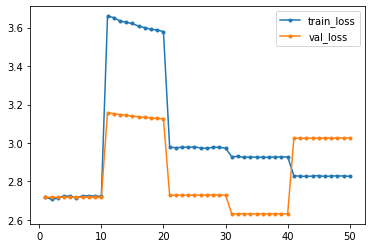

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_61_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_61_10


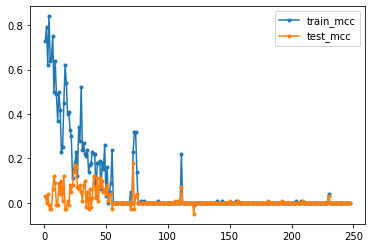

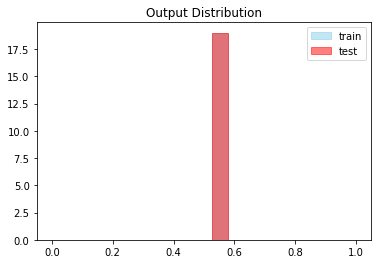




Global Iteration: (3/40) Set Number: (62/64) Epochs: 10  File: train62.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2284 - acc: 0.0117 - val_loss: 2.8264 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2242 - acc: 0.0117 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 178ms/step - loss: 2.2165 - acc: 0.0117 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2097 - acc: 0.0117 - val_loss: 2.8252 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2056 - acc: 0.0117 - val_loss: 2.8252 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1997 - acc: 0

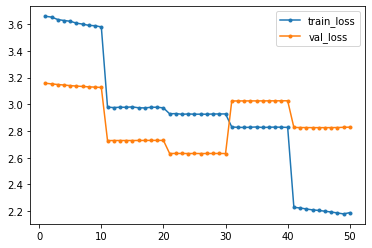

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_62_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_62_10


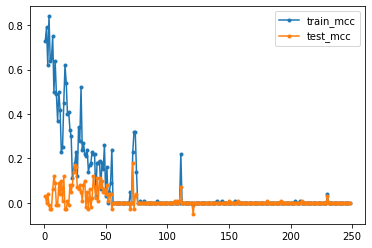

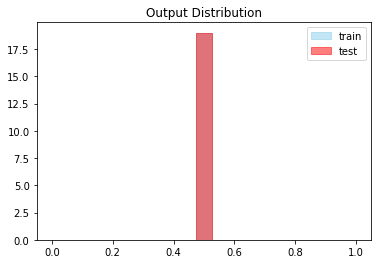




Global Iteration: (3/40) Set Number: (63/64) Epochs: 10  File: train63.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
11/11 [==============================] - 2s 156ms/step - loss: 2.8567 - acc: 0.2819 - val_loss: 3.4511 - val_acc: 0.0311
Epoch 2/10
11/11 [==============================] - 2s 144ms/step - loss: 2.8385 - acc: 0.2541 - val_loss: 3.4607 - val_acc: 0.9689
Epoch 3/10
11/11 [==============================] - 2s 144ms/step - loss: 2.8454 - acc: 0.2608 - val_loss: 3.4667 - val_acc: 0.9689
Epoch 4/10
11/11 [==============================] - 2s 143ms/step - loss: 2.8634 - acc: 0.3663 - val_loss: 3.4662 - val_acc: 0.9689
Epoch 5/10
11/11 [==============================] - 2s 151ms/step - loss: 2.8570 - acc: 0.2733 - val_loss: 3.4464 - val_acc: 0.0311
Epoch 6/10
11/11 [==============================] - 2s 146ms/step - loss: 2.8552 - acc: 0

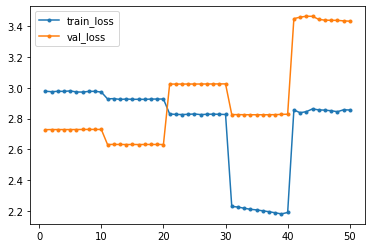

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_63_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_3_63_10


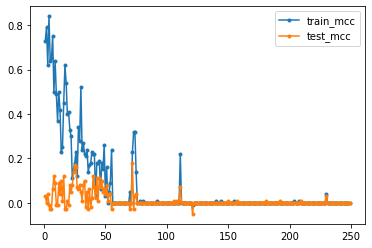

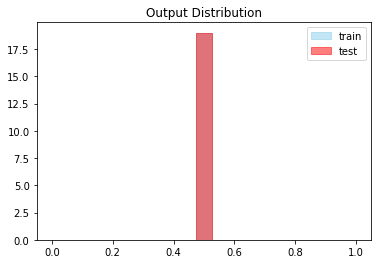




Global Iteration: (4/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8825 - acc: 0.0225 - val_loss: 2.7187 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8804 - acc: 0.0225 - val_loss: 2.7188 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8772 - acc: 0.0225 - val_loss: 2.7189 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8782 - acc: 0.0225 - val_loss: 2.7190 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8786 - acc: 0.0225 - val_loss: 2.7191 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8779 - acc: 0.0

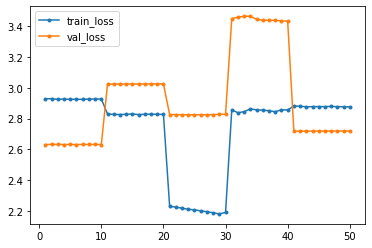

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_0_10


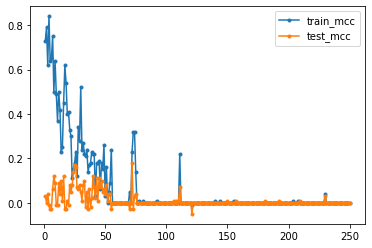

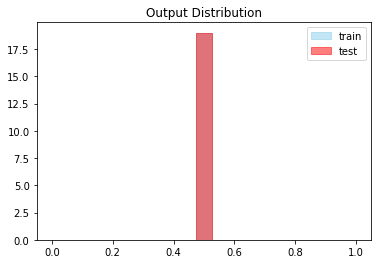




Global Iteration: (4/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5069 - acc: 0.0167 - val_loss: 2.1884 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5061 - acc: 0.0167 - val_loss: 2.1847 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5076 - acc: 0.0167 - val_loss: 2.1820 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.5102 - acc: 0.0767 - val_loss: 2.1797 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5084 - acc: 0.0650 - val_loss: 2.1786 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5087 - acc: 0.0

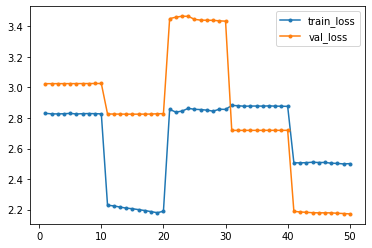

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_1_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_1_10


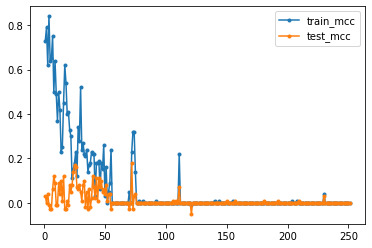

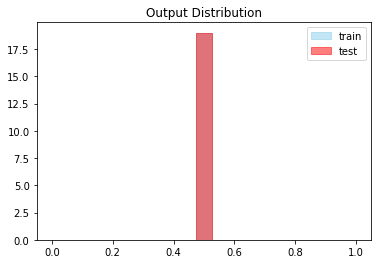




Global Iteration: (4/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.4932 - acc: 0.1825 - val_loss: 2.1690 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5064 - acc: 0.2383 - val_loss: 2.1660 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5039 - acc: 0.2450 - val_loss: 2.1660 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4954 - acc: 0.2567 - val_loss: 2.1656 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4929 - acc: 0.3550 - val_loss: 2.1617 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4912 - acc: 0.5

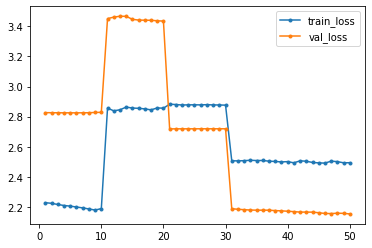

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_2_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_2_10


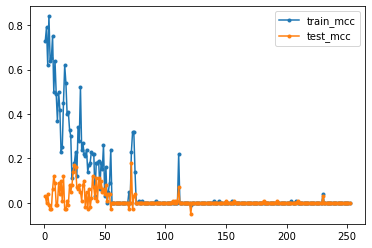

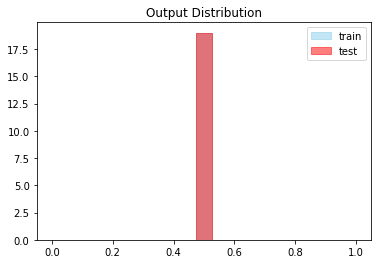




Global Iteration: (4/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.3660 - acc: 0.7267 - val_loss: 2.8323 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.3785 - acc: 0.7275 - val_loss: 2.8379 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.3611 - acc: 0.8592 - val_loss: 2.8393 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3635 - acc: 0.9850 - val_loss: 2.8456 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3965 - acc: 0.9850 - val_loss: 2.8467 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4036 - acc: 0.9

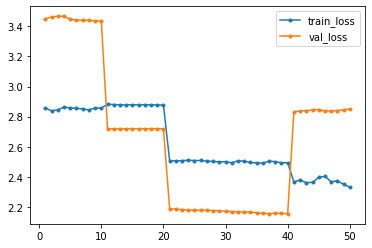

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_3_10


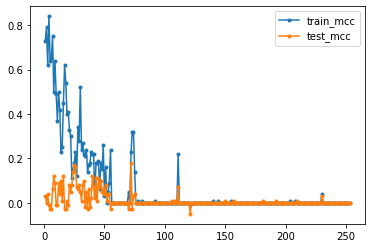

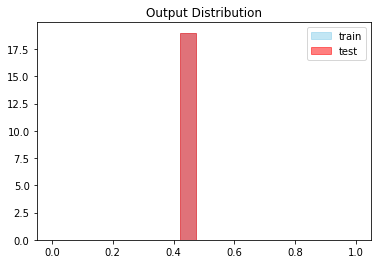




Global Iteration: (4/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2024 - acc: 0.9875 - val_loss: 2.7306 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1837 - acc: 0.9875 - val_loss: 2.7299 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.1740 - acc: 0.9875 - val_loss: 2.7297 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1993 - acc: 0.9875 - val_loss: 2.7305 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1346 - acc: 0.9875 - val_loss: 2.7348 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.2410 - acc: 0.9

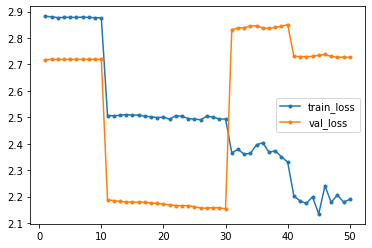

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_4_10


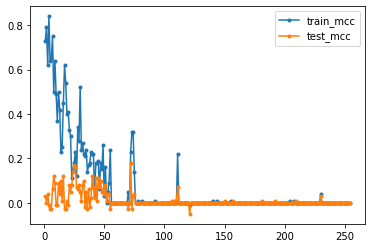

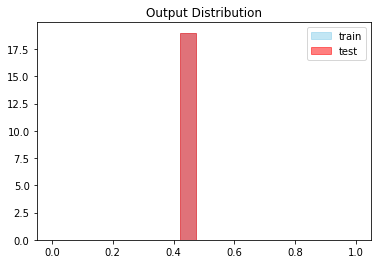




Global Iteration: (4/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.9071 - acc: 0.9775 - val_loss: 2.7271 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9235 - acc: 0.9775 - val_loss: 2.7249 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9062 - acc: 0.9775 - val_loss: 2.7225 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9132 - acc: 0.9775 - val_loss: 2.7207 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8900 - acc: 0.9775 - val_loss: 2.7201 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8884 - acc: 0.9

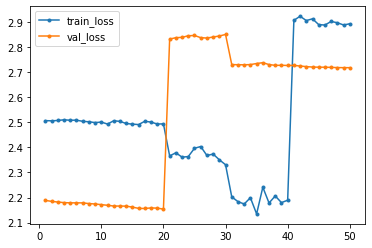

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_5_10


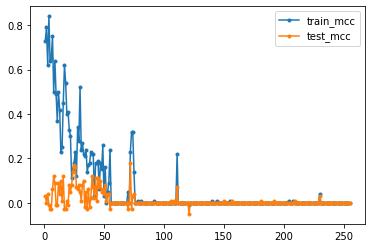

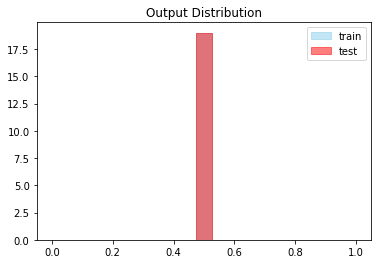




Global Iteration: (4/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1136 - acc: 0.9742 - val_loss: 2.6039 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1170 - acc: 0.9742 - val_loss: 2.6043 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1179 - acc: 0.9742 - val_loss: 2.6045 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1198 - acc: 0.9742 - val_loss: 2.6051 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1138 - acc: 0.9692 - val_loss: 2.6057 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1139 - acc: 0.7

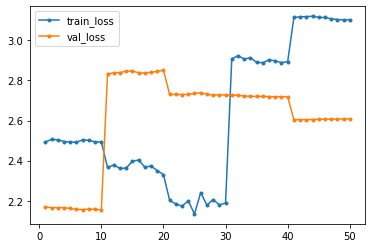

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_6_10


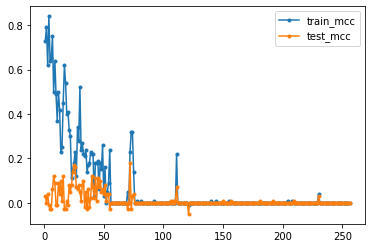

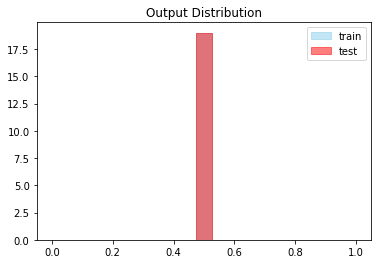




Global Iteration: (4/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8842 - acc: 0.0225 - val_loss: 3.0451 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8812 - acc: 0.0225 - val_loss: 3.0443 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8827 - acc: 0.0225 - val_loss: 3.0439 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8814 - acc: 0.0225 - val_loss: 3.0435 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8815 - acc: 0.0225 - val_loss: 3.0429 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8810 - acc: 0.0

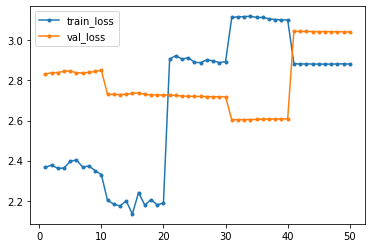

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_7_10


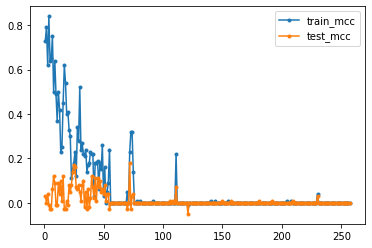

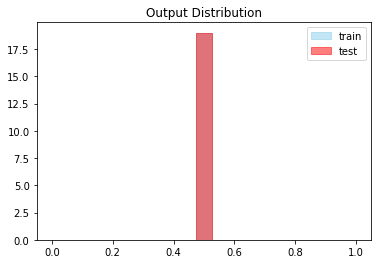




Global Iteration: (4/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.5029 - acc: 0.0167 - val_loss: 3.1486 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5051 - acc: 0.0167 - val_loss: 3.1496 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5033 - acc: 0.0167 - val_loss: 3.1505 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5014 - acc: 0.0167 - val_loss: 3.1519 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5010 - acc: 0.0167 - val_loss: 3.1528 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4999 - acc: 0.0

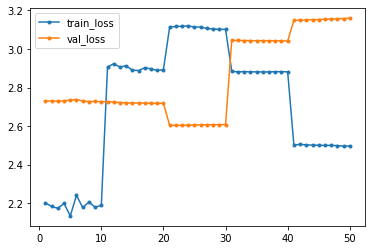

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_8_10


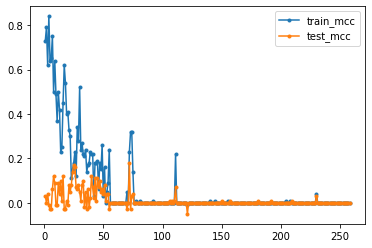

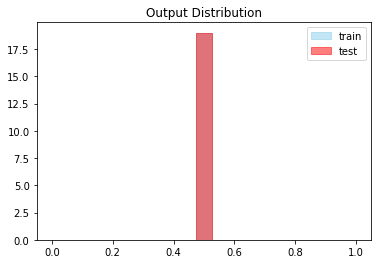




Global Iteration: (4/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5523 - acc: 0.2842 - val_loss: 2.1643 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5515 - acc: 0.4325 - val_loss: 2.1629 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5529 - acc: 0.6267 - val_loss: 2.1618 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5508 - acc: 0.7108 - val_loss: 2.1607 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5522 - acc: 0.7983 - val_loss: 2.1592 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5505 - acc: 0.8

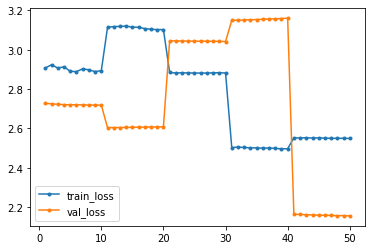

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_9_10


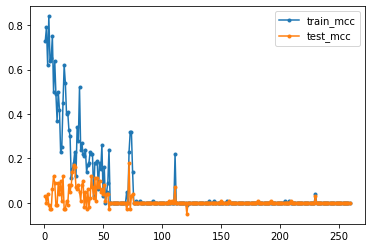

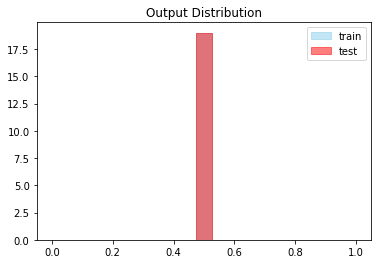




Global Iteration: (4/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8882 - acc: 0.9775 - val_loss: 2.8303 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8885 - acc: 0.9775 - val_loss: 2.8298 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8856 - acc: 0.9742 - val_loss: 2.8296 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8841 - acc: 0.8550 - val_loss: 2.8294 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8839 - acc: 0.8358 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8842 - acc: 0

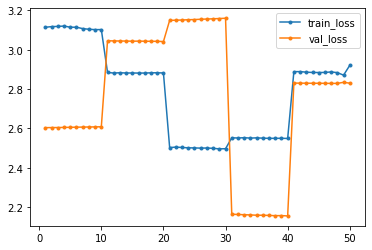

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_10_10


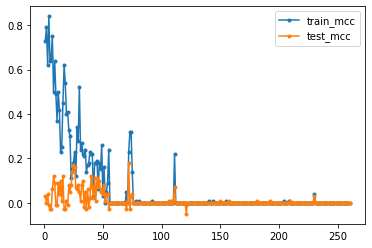

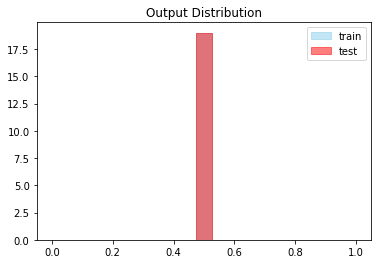




Global Iteration: (4/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 182ms/step - loss: 2.6600 - acc: 0.2567 - val_loss: 2.1643 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6626 - acc: 0.3425 - val_loss: 2.1646 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6633 - acc: 0.3600 - val_loss: 2.1641 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6607 - acc: 0.3933 - val_loss: 2.1617 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6575 - acc: 0.3775 - val_loss: 2.1583 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.6768 - acc: 0

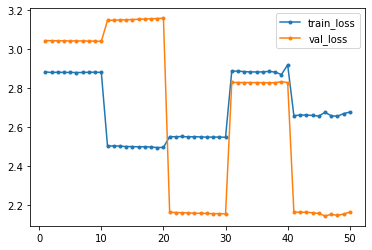

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_11_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_11_10


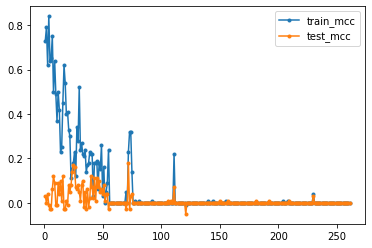

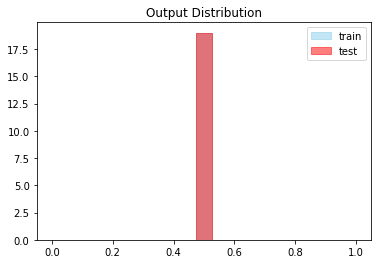




Global Iteration: (4/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.8839 - acc: 0.3258 - val_loss: 3.0493 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8798 - acc: 0.3492 - val_loss: 3.0486 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8833 - acc: 0.3583 - val_loss: 3.0489 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8816 - acc: 0.2583 - val_loss: 3.0474 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8852 - acc: 0.2217 - val_loss: 3.0469 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8818 - acc: 0

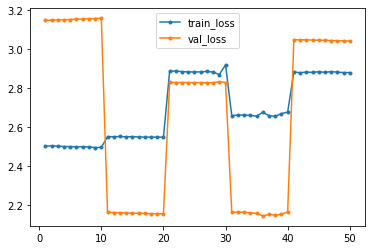

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_12_10


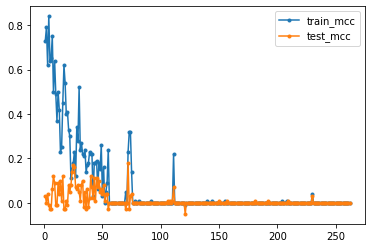

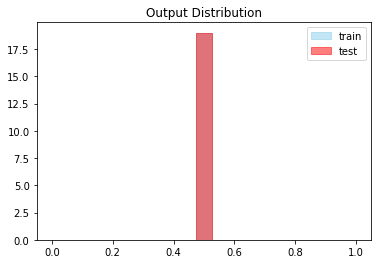




Global Iteration: (4/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8269 - acc: 0.0217 - val_loss: 2.1761 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8261 - acc: 0.0217 - val_loss: 2.1768 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8264 - acc: 0.0217 - val_loss: 2.1773 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8259 - acc: 0.0217 - val_loss: 2.1783 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8262 - acc: 0.0217 - val_loss: 2.1787 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8274 - acc: 0

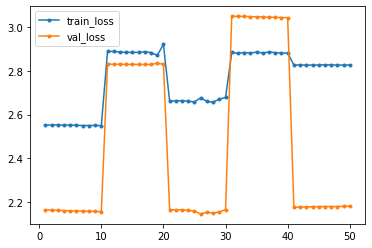

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_13_10


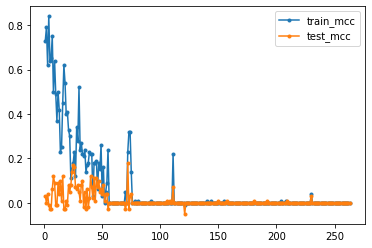

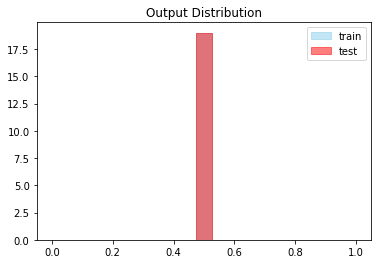




Global Iteration: (4/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8802 - acc: 0.0225 - val_loss: 2.3960 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8794 - acc: 0.0225 - val_loss: 2.3965 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.8793 - acc: 0.0225 - val_loss: 2.3970 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8796 - acc: 0.0225 - val_loss: 2.3969 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8796 - acc: 0.0225 - val_loss: 2.3983 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8804 - acc: 0

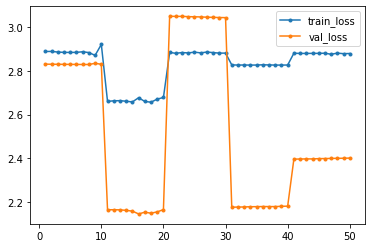

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_14_10


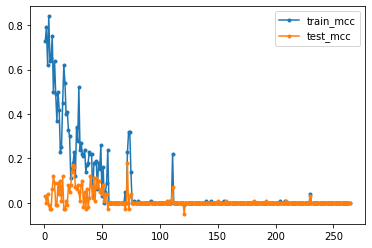

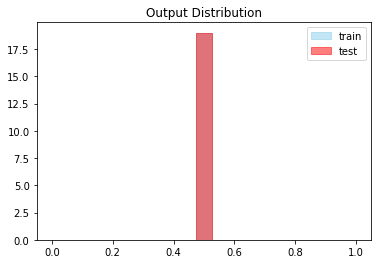




Global Iteration: (4/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.4539 - acc: 0.0158 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4528 - acc: 0.0158 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4518 - acc: 0.0158 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4512 - acc: 0.0158 - val_loss: 2.8261 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4493 - acc: 0.0158 - val_loss: 2.8263 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4484 - acc: 0

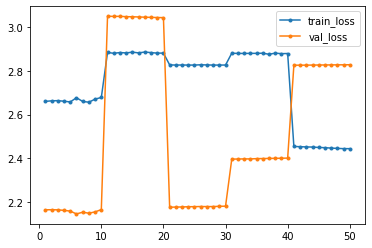

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_15_10


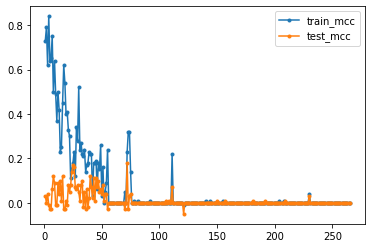

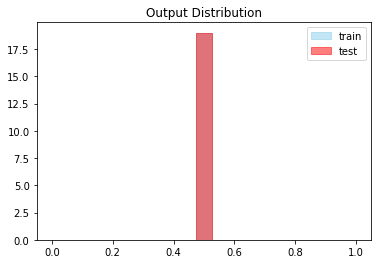




Global Iteration: (4/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7726 - acc: 0.0208 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7721 - acc: 0.0208 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7725 - acc: 0.0208 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7717 - acc: 0.0208 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7721 - acc: 0.0208 - val_loss: 2.8278 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7731 - acc: 0

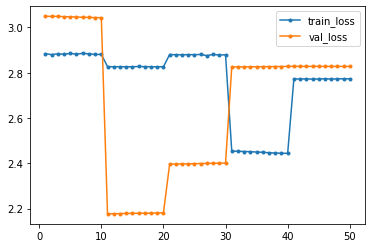

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_16_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_16_10


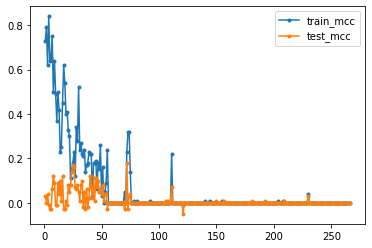

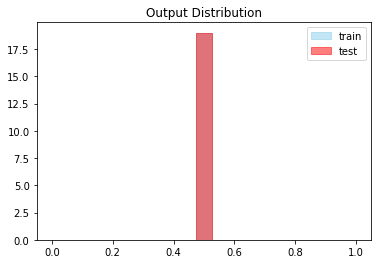




Global Iteration: (4/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9918 - acc: 0.0242 - val_loss: 2.8274 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 178ms/step - loss: 2.9905 - acc: 0.0242 - val_loss: 2.8271 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9898 - acc: 0.0242 - val_loss: 2.8270 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9908 - acc: 0.0242 - val_loss: 2.8267 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9899 - acc: 0.0242 - val_loss: 2.8264 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9879 - acc: 0

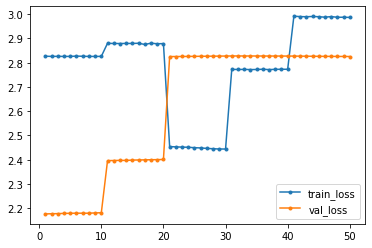

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_17_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_17_10


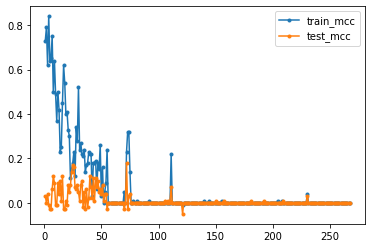

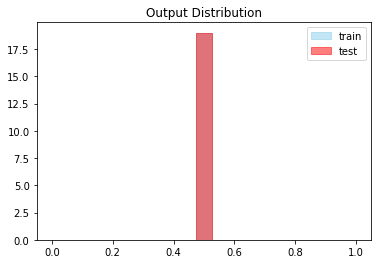




Global Iteration: (4/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 3.0388 - acc: 0.0250 - val_loss: 3.0388 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0365 - acc: 0.0250 - val_loss: 3.0378 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0367 - acc: 0.0250 - val_loss: 3.0371 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0378 - acc: 0.0250 - val_loss: 3.0364 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0352 - acc: 0.0250 - val_loss: 3.0354 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0380 - acc: 0

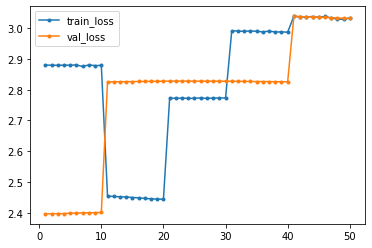

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_18_10


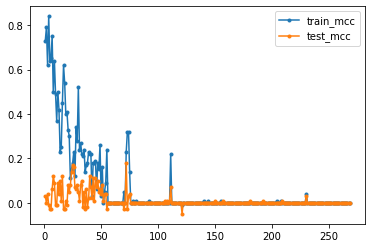

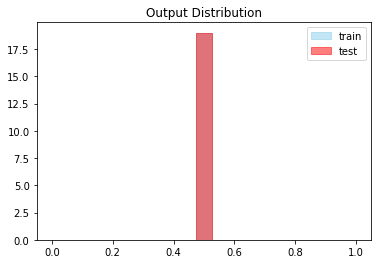




Global Iteration: (4/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 149ms/step - loss: 2.5682 - acc: 0.0175 - val_loss: 3.4098 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 148ms/step - loss: 2.5671 - acc: 0.0175 - val_loss: 3.4113 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 147ms/step - loss: 2.5700 - acc: 0.0175 - val_loss: 3.4140 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 155ms/step - loss: 2.5688 - acc: 0.0175 - val_loss: 3.4181 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 148ms/step - loss: 2.5628 - acc: 0.0175 - val_loss: 3.4205 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 149ms/step - loss: 2.5631 - acc: 0

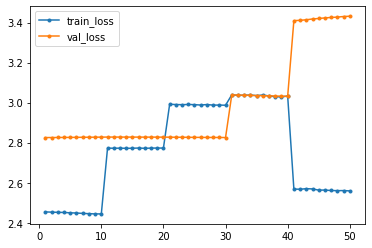

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_19_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_19_10


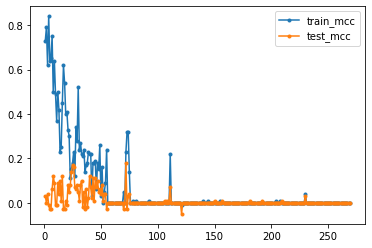

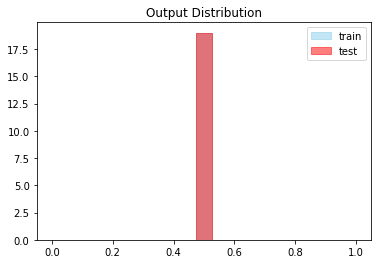




Global Iteration: (4/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 147ms/step - loss: 2.9846 - acc: 0.0242 - val_loss: 3.4311 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 151ms/step - loss: 2.9859 - acc: 0.0242 - val_loss: 3.4298 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 148ms/step - loss: 2.9854 - acc: 0.0242 - val_loss: 3.4285 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 150ms/step - loss: 2.9845 - acc: 0.0242 - val_loss: 3.4265 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 149ms/step - loss: 2.9847 - acc: 0.0242 - val_loss: 3.4252 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 148ms/step - loss: 2.9824 - acc: 0

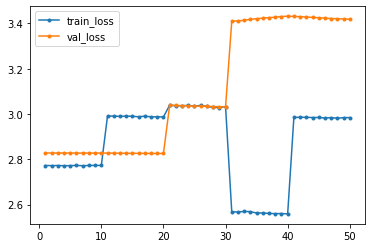

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_20_10


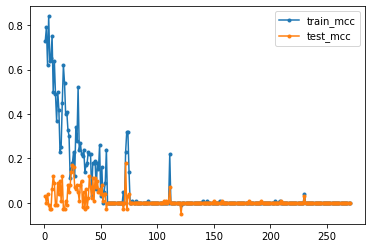

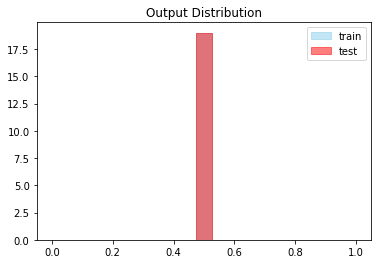




Global Iteration: (4/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.9798 - acc: 0.0242 - val_loss: 2.4077 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9841 - acc: 0.0242 - val_loss: 2.4094 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9814 - acc: 0.0242 - val_loss: 2.4095 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9812 - acc: 0.0242 - val_loss: 2.4096 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9825 - acc: 0.0242 - val_loss: 2.4112 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9856 - acc: 0

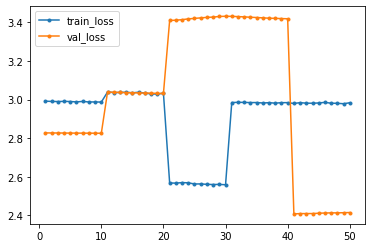

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_21_10


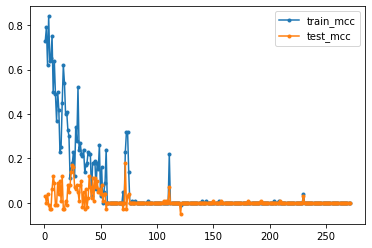

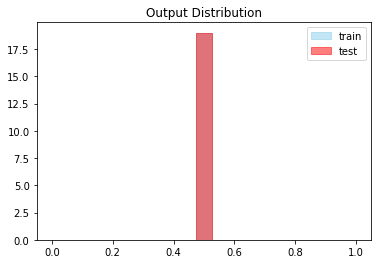




Global Iteration: (4/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0281 - acc: 0.0250 - val_loss: 2.2109 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0303 - acc: 0.0250 - val_loss: 2.2139 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 3.0277 - acc: 0.0250 - val_loss: 2.2145 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0264 - acc: 0.0250 - val_loss: 2.2174 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0293 - acc: 0.0250 - val_loss: 2.2189 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0306 - acc: 0

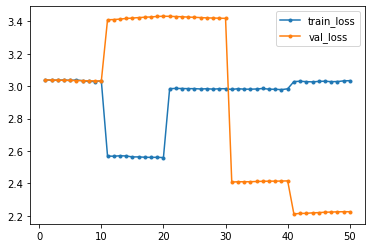

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_22_10


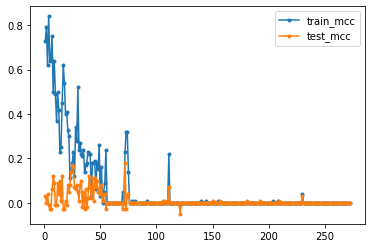

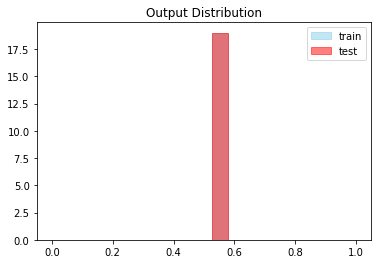




Global Iteration: (4/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8286 - acc: 0.0217 - val_loss: 2.8263 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8259 - acc: 0.0217 - val_loss: 2.8262 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8255 - acc: 0.0217 - val_loss: 2.8263 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8261 - acc: 0.0217 - val_loss: 2.8262 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8250 - acc: 0.0217 - val_loss: 2.8261 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8262 - acc: 0

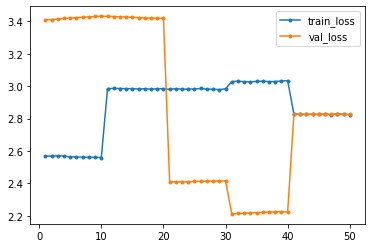

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_23_10


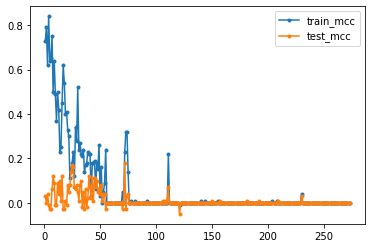

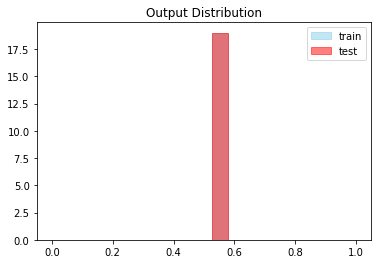




Global Iteration: (4/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5713 - acc: 0.0175 - val_loss: 2.4181 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5692 - acc: 0.0175 - val_loss: 2.4148 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 2.5663 - acc: 0.0175 - val_loss: 2.4120 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5640 - acc: 0.0175 - val_loss: 2.4088 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5626 - acc: 0.0175 - val_loss: 2.4030 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5684 - acc: 0

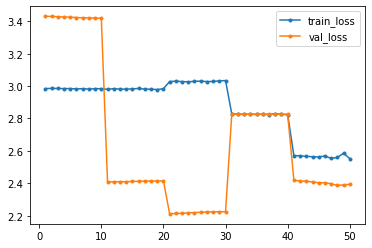

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_24_10


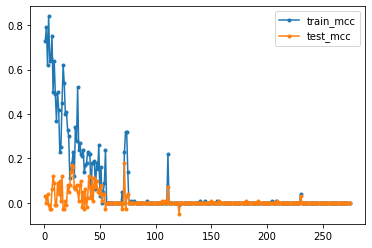

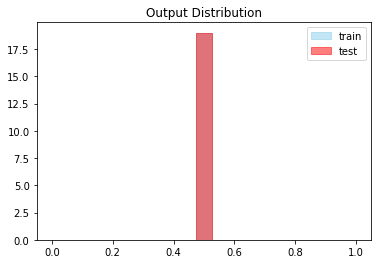




Global Iteration: (4/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 154ms/step - loss: 2.4008 - acc: 0.2517 - val_loss: 3.4478 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 147ms/step - loss: 2.3926 - acc: 0.2567 - val_loss: 3.4668 - val_acc: 0.9689
Epoch 3/10
12/12 [==============================] - 2s 149ms/step - loss: 2.4018 - acc: 0.2550 - val_loss: 3.4715 - val_acc: 0.9689
Epoch 4/10
12/12 [==============================] - 2s 152ms/step - loss: 2.4002 - acc: 0.2567 - val_loss: 3.4619 - val_acc: 0.9689
Epoch 5/10
12/12 [==============================] - 2s 151ms/step - loss: 2.3608 - acc: 0.2508 - val_loss: 3.4751 - val_acc: 0.9689
Epoch 6/10
12/12 [==============================] - 2s 150ms/step - loss: 2.3849 - acc: 0

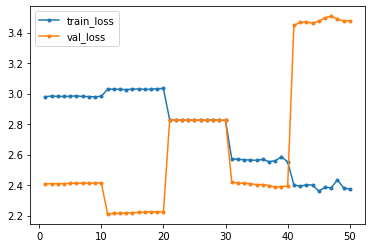

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_25_10


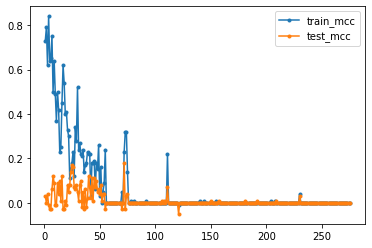

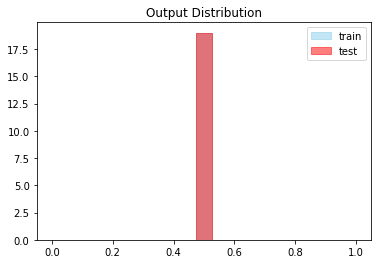




Global Iteration: (4/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8020 - acc: 0.2550 - val_loss: 2.8319 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7923 - acc: 0.2517 - val_loss: 2.8289 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7672 - acc: 0.2650 - val_loss: 2.8286 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7562 - acc: 0.2817 - val_loss: 2.8289 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7792 - acc: 0.2633 - val_loss: 2.8284 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7847 - acc: 0

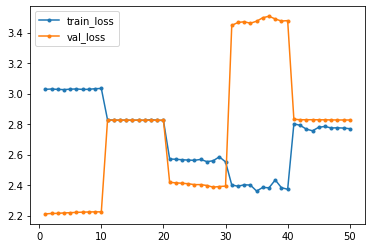

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_26_10


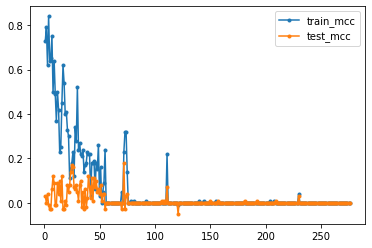

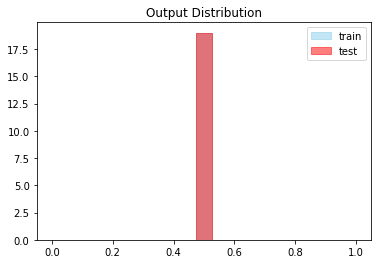




Global Iteration: (4/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1584 - acc: 0.2600 - val_loss: 3.0446 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1536 - acc: 0.1125 - val_loss: 3.0425 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1481 - acc: 0.0267 - val_loss: 3.0418 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1488 - acc: 0.0267 - val_loss: 3.0399 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1440 - acc: 0.0267 - val_loss: 3.0389 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1450 - acc: 0

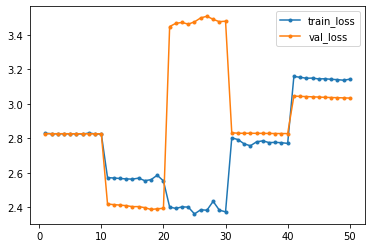

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_27_10


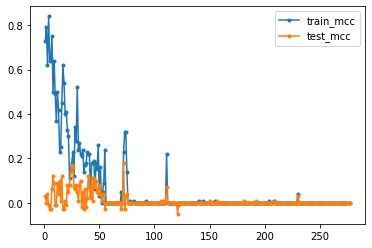

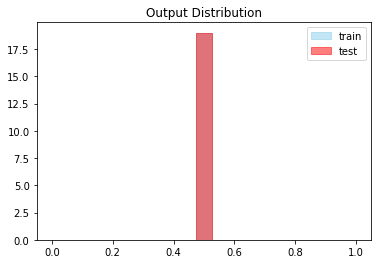




Global Iteration: (4/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 186ms/step - loss: 2.9795 - acc: 0.0242 - val_loss: 3.1358 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9802 - acc: 0.0242 - val_loss: 3.1355 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9808 - acc: 0.0242 - val_loss: 3.1351 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9782 - acc: 0.0242 - val_loss: 3.1348 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9804 - acc: 0.0242 - val_loss: 3.1345 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9767 - acc: 0

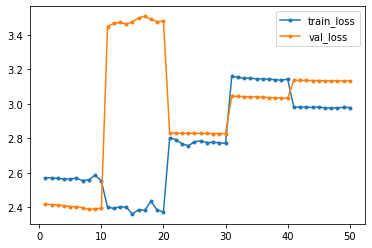

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_28_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_28_10


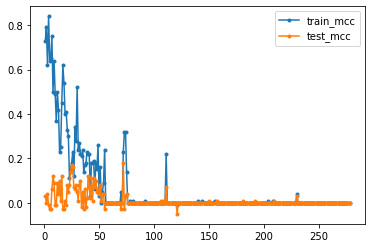

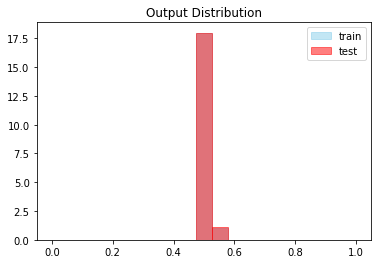




Global Iteration: (4/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9273 - acc: 0.0233 - val_loss: 2.2128 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9262 - acc: 0.0233 - val_loss: 2.2144 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9290 - acc: 0.0233 - val_loss: 2.2181 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9312 - acc: 0.0233 - val_loss: 2.2209 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9248 - acc: 0.0233 - val_loss: 2.2239 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9238 - acc: 0

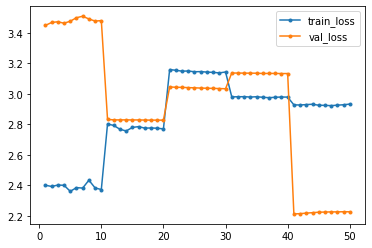

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_29_10


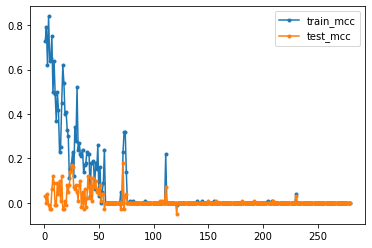

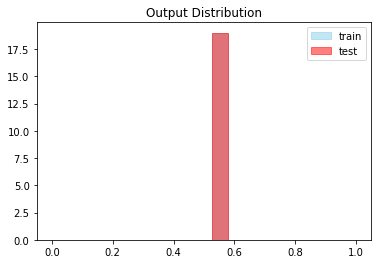




Global Iteration: (4/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8321 - acc: 0.0217 - val_loss: 3.0267 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8259 - acc: 0.0217 - val_loss: 3.0270 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8270 - acc: 0.0217 - val_loss: 3.0271 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8271 - acc: 0.0217 - val_loss: 3.0271 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8191 - acc: 0.0217 - val_loss: 3.0272 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8329 - acc: 0

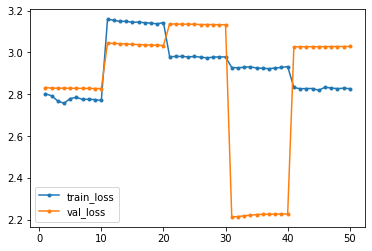

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_30_10


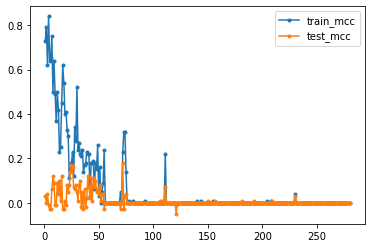

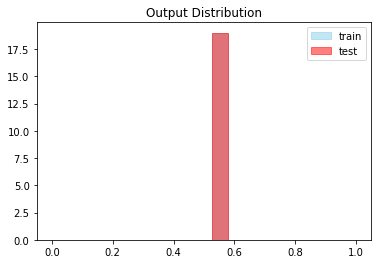




Global Iteration: (4/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.7230 - acc: 0.0200 - val_loss: 2.2173 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7231 - acc: 0.0200 - val_loss: 2.2147 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7283 - acc: 0.0200 - val_loss: 2.2131 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7257 - acc: 0.0200 - val_loss: 2.2119 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7232 - acc: 0.0200 - val_loss: 2.2096 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7206 - acc: 0

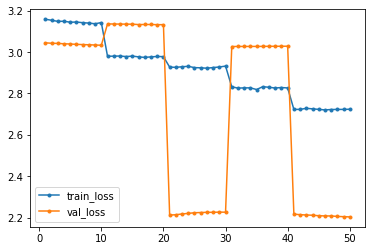

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_31_10


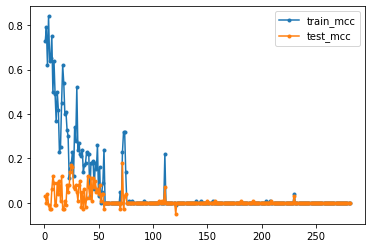

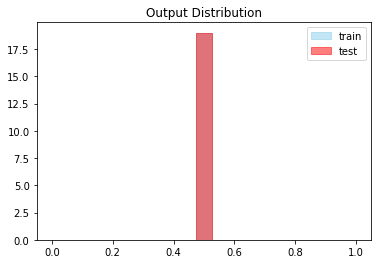




Global Iteration: (4/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.6194 - acc: 0.0183 - val_loss: 3.1364 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 181ms/step - loss: 2.6164 - acc: 0.0183 - val_loss: 3.1373 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.6166 - acc: 0.0183 - val_loss: 3.1381 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6142 - acc: 0.0183 - val_loss: 3.1390 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6154 - acc: 0.0183 - val_loss: 3.1399 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6131 - acc: 0

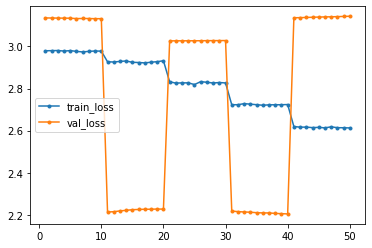

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_32_10


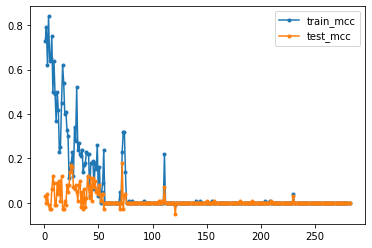

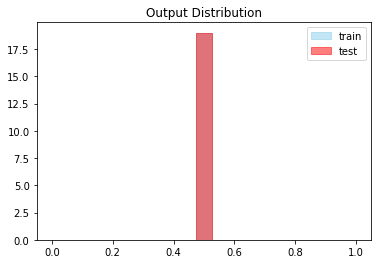




Global Iteration: (4/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3035 - acc: 0.0292 - val_loss: 2.7192 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 3.2992 - acc: 0.0292 - val_loss: 2.7196 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2971 - acc: 0.0292 - val_loss: 2.7202 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2909 - acc: 0.0292 - val_loss: 2.7210 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2906 - acc: 0.0292 - val_loss: 2.7221 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2859 - acc: 0

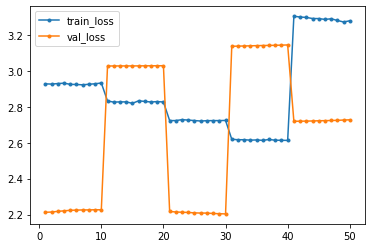

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_33_10


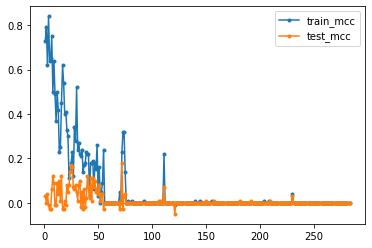

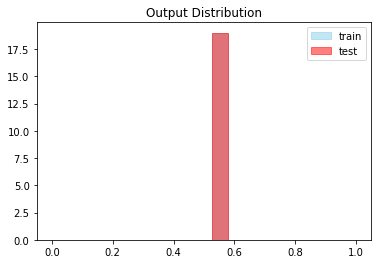




Global Iteration: (4/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5817 - acc: 0.0175 - val_loss: 3.0258 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5792 - acc: 0.0175 - val_loss: 3.0265 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5715 - acc: 0.0175 - val_loss: 3.0271 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5743 - acc: 0.0175 - val_loss: 3.0277 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5748 - acc: 0.0175 - val_loss: 3.0285 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5644 - acc: 0

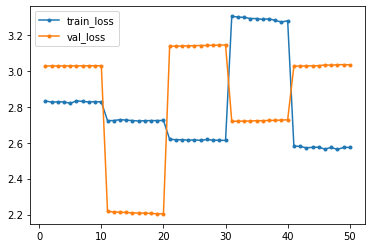

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_34_10


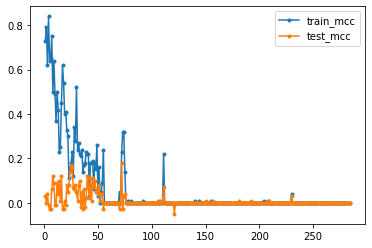

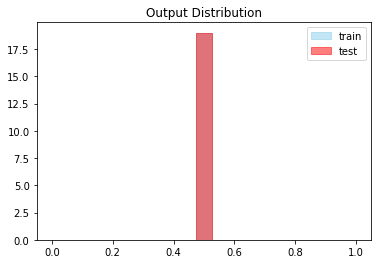




Global Iteration: (4/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 180ms/step - loss: 2.7689 - acc: 0.0208 - val_loss: 2.7210 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 178ms/step - loss: 2.7715 - acc: 0.0208 - val_loss: 2.7196 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7734 - acc: 0.0225 - val_loss: 2.7195 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7793 - acc: 0.0525 - val_loss: 2.7195 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7670 - acc: 0.0208 - val_loss: 2.7201 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7689 - acc: 0

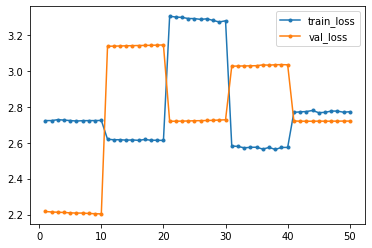

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_35_10


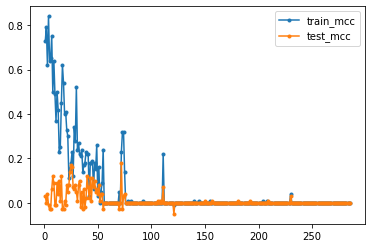

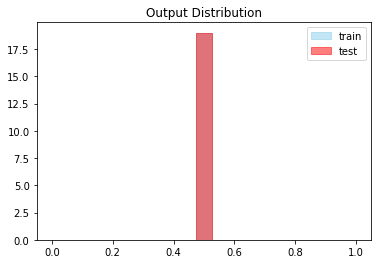




Global Iteration: (4/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.6169 - acc: 0.0183 - val_loss: 3.0367 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6091 - acc: 0.0183 - val_loss: 3.0389 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6190 - acc: 0.0800 - val_loss: 3.0398 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6207 - acc: 0.0417 - val_loss: 3.0379 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6152 - acc: 0.0183 - val_loss: 3.0384 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6118 - acc: 0

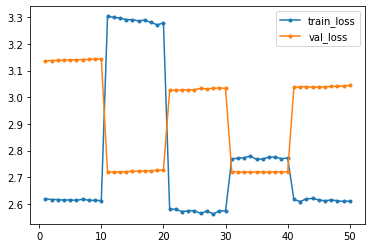

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_36_10


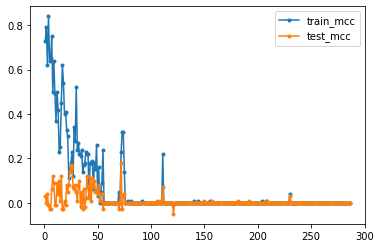

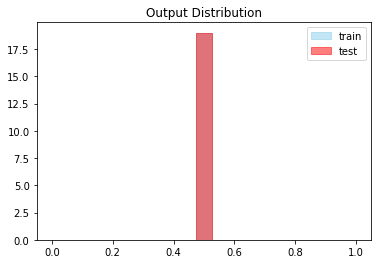




Global Iteration: (4/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5652 - acc: 0.2458 - val_loss: 2.1754 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5611 - acc: 0.2283 - val_loss: 2.1757 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 179ms/step - loss: 2.5536 - acc: 0.1533 - val_loss: 2.1754 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5421 - acc: 0.2175 - val_loss: 2.1684 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5685 - acc: 0.3767 - val_loss: 2.1629 - val_acc: 0.9000
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5521 - acc: 0

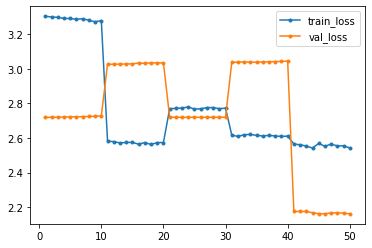

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_37_10


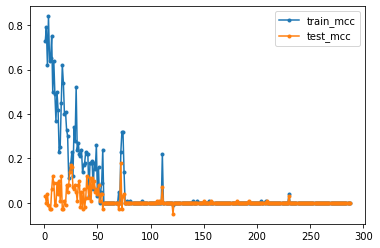

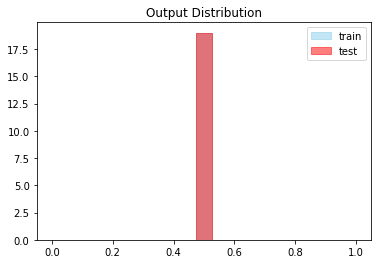




Global Iteration: (4/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4401 - acc: 0.4017 - val_loss: 3.1690 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 172ms/step - loss: 2.4256 - acc: 0.4050 - val_loss: 3.1778 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 180ms/step - loss: 2.4161 - acc: 0.5075 - val_loss: 3.2016 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4514 - acc: 0.5633 - val_loss: 3.2098 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4125 - acc: 0.5883 - val_loss: 3.2133 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4585 - acc: 0

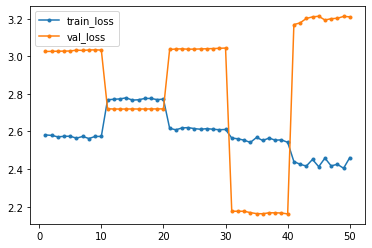

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_38_10


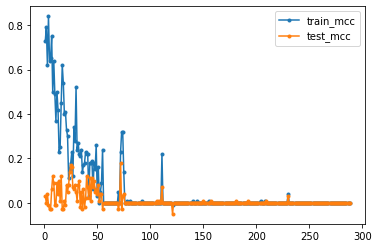

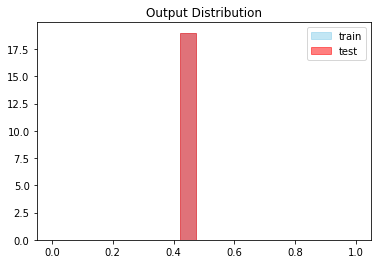




Global Iteration: (4/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 3.0458 - acc: 0.8692 - val_loss: 2.8363 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9980 - acc: 0.5733 - val_loss: 2.8302 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0007 - acc: 0.4225 - val_loss: 2.8285 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9866 - acc: 0.2667 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9913 - acc: 0.2300 - val_loss: 2.8280 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9904 - acc: 0

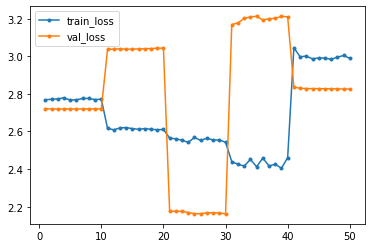

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_39_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_39_10


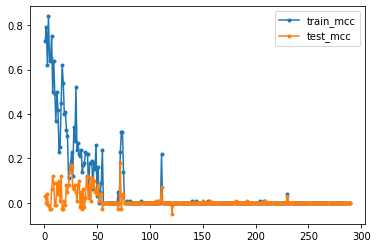

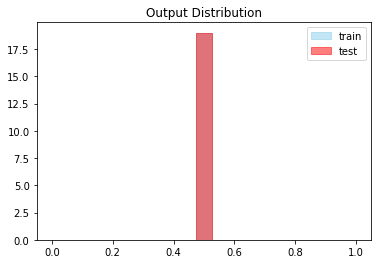




Global Iteration: (4/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5016 - acc: 0.0167 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5013 - acc: 0.0167 - val_loss: 2.8258 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.5021 - acc: 0.0167 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5061 - acc: 0.0167 - val_loss: 2.8262 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4996 - acc: 0.0167 - val_loss: 2.8265 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5002 - acc: 0

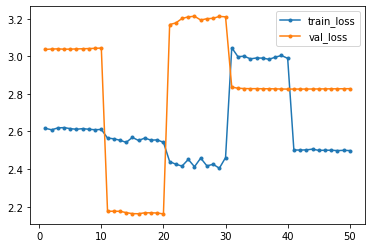

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_40_10


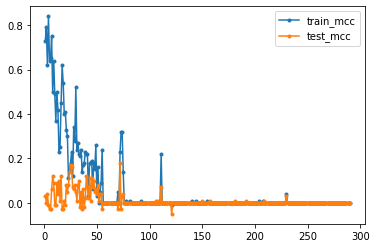

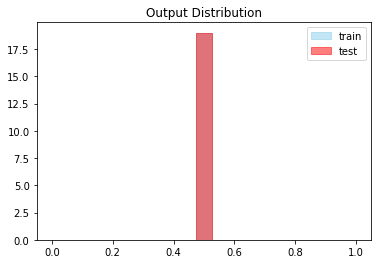




Global Iteration: (4/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 152ms/step - loss: 2.8836 - acc: 0.0225 - val_loss: 3.4549 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 149ms/step - loss: 2.8836 - acc: 0.0225 - val_loss: 3.4547 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 151ms/step - loss: 2.8839 - acc: 0.0225 - val_loss: 3.4543 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 153ms/step - loss: 2.8827 - acc: 0.0225 - val_loss: 3.4528 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 149ms/step - loss: 2.8830 - acc: 0.0225 - val_loss: 3.4511 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 150ms/step - loss: 2.8820 - acc: 0

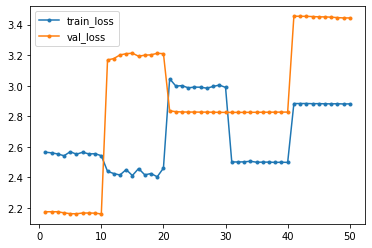

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_41_10


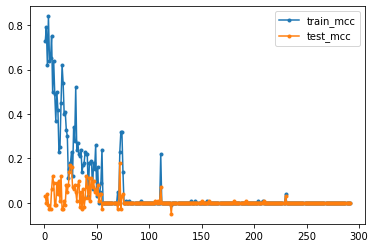

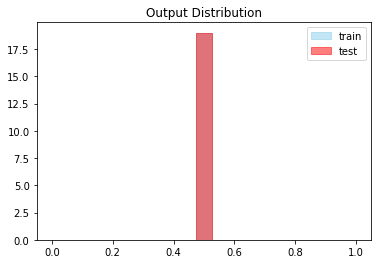




Global Iteration: (4/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.4991 - acc: 0.0167 - val_loss: 3.1529 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 181ms/step - loss: 2.5004 - acc: 0.0167 - val_loss: 3.1542 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4987 - acc: 0.0167 - val_loss: 3.1555 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4993 - acc: 0.0167 - val_loss: 3.1571 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4980 - acc: 0.0167 - val_loss: 3.1584 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4968 - acc: 0

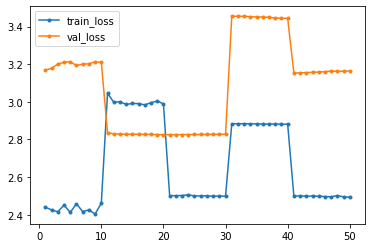

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_42_10


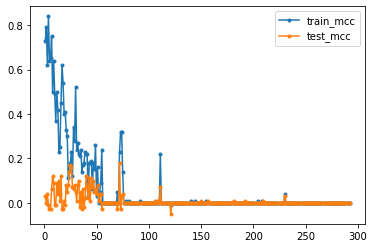

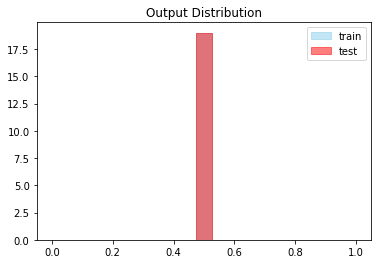




Global Iteration: (4/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.9417 - acc: 0.9542 - val_loss: 3.1638 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9404 - acc: 0.9367 - val_loss: 3.1627 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9405 - acc: 0.6933 - val_loss: 3.1612 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9396 - acc: 0.3858 - val_loss: 3.1604 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9379 - acc: 0.0933 - val_loss: 3.1589 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9373 - acc: 0

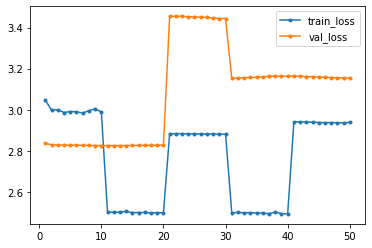

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_43_10


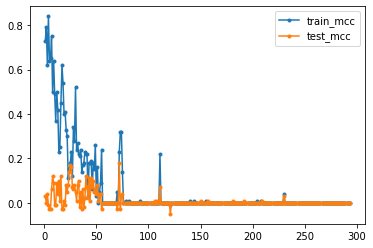

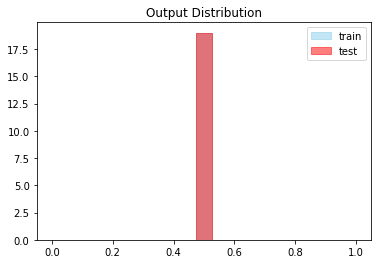




Global Iteration: (4/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.6091 - acc: 0.0183 - val_loss: 2.8268 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.6098 - acc: 0.0183 - val_loss: 2.8268 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6082 - acc: 0.0183 - val_loss: 2.8270 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6087 - acc: 0.0183 - val_loss: 2.8271 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6084 - acc: 0.0183 - val_loss: 2.8272 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6085 - acc: 0

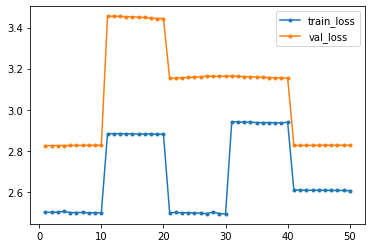

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_44_10


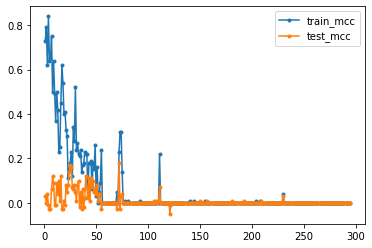

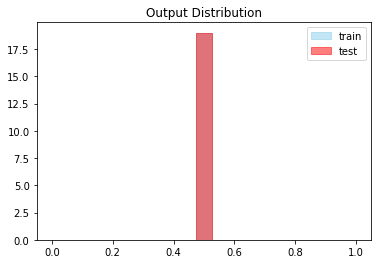




Global Iteration: (4/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.7174 - acc: 0.0200 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7173 - acc: 0.0200 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.7169 - acc: 0.0200 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7177 - acc: 0.0617 - val_loss: 2.8280 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7177 - acc: 0.0758 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7172 - acc: 0

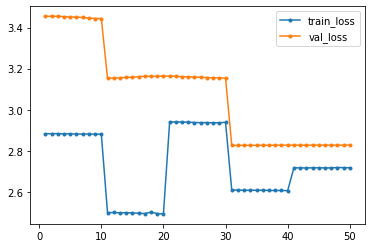

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_45_10


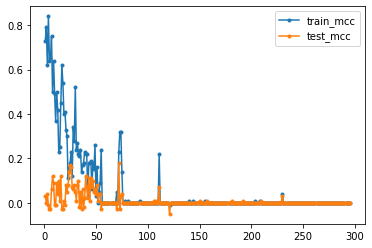

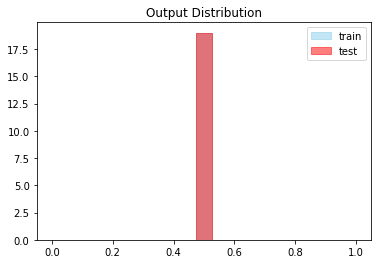




Global Iteration: (4/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 3.1593 - acc: 0.0375 - val_loss: 2.8277 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1575 - acc: 0.0267 - val_loss: 2.8273 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1556 - acc: 0.0267 - val_loss: 2.8269 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1515 - acc: 0.0267 - val_loss: 2.8265 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1506 - acc: 0.0267 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1498 - acc: 0

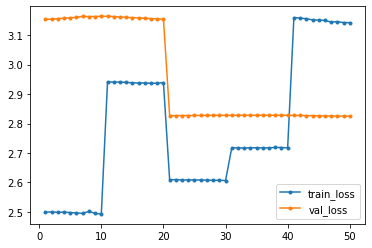

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_46_10


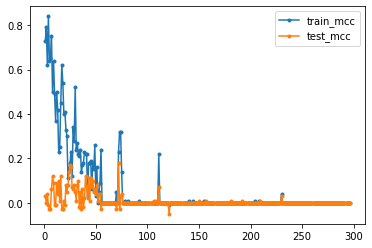

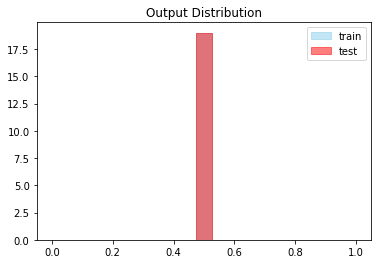




Global Iteration: (4/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9348 - acc: 0.0233 - val_loss: 3.0338 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9254 - acc: 0.0233 - val_loss: 3.0321 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9289 - acc: 0.0233 - val_loss: 3.0280 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9204 - acc: 0.0233 - val_loss: 3.0244 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9402 - acc: 0.0233 - val_loss: 3.0262 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9251 - acc: 0

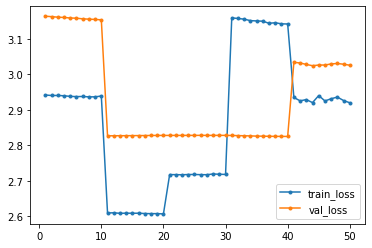

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_47_10


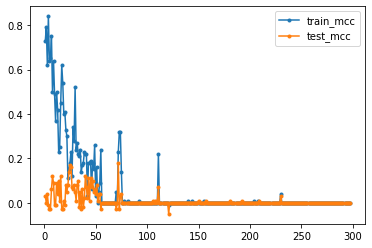

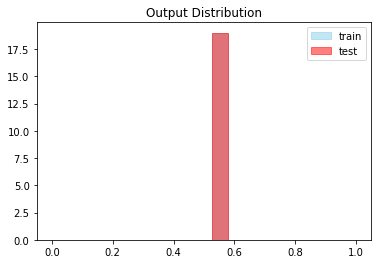




Global Iteration: (4/40) Set Number: (48/64) Epochs: 10  File: train48.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2060 - acc: 0.0283 - val_loss: 3.0216 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1639 - acc: 0.0283 - val_loss: 3.0260 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.2042 - acc: 0.0283 - val_loss: 3.0230 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 3.2231 - acc: 0.0283 - val_loss: 3.0215 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2416 - acc: 0.0283 - val_loss: 3.0237 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1696 - acc: 0

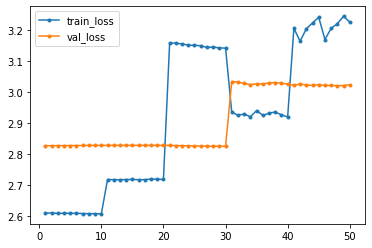

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_48_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_48_10


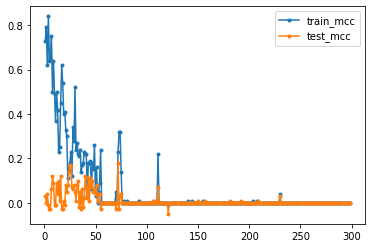

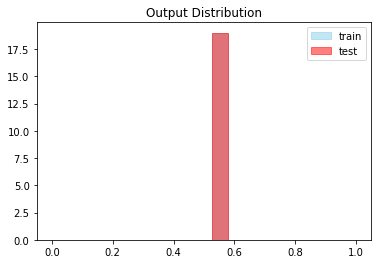




Global Iteration: (4/40) Set Number: (49/64) Epochs: 10  File: train49.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 185ms/step - loss: 3.2907 - acc: 0.0292 - val_loss: 2.5318 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2884 - acc: 0.0292 - val_loss: 2.5290 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2796 - acc: 0.0292 - val_loss: 2.5320 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2780 - acc: 0.0292 - val_loss: 2.5332 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.2631 - acc: 0.0292 - val_loss: 2.5432 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.2800 - acc: 0

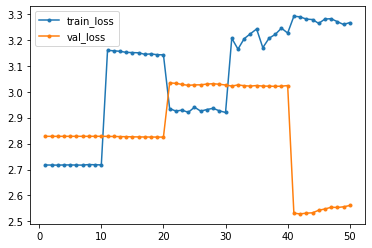

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_49_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_49_10


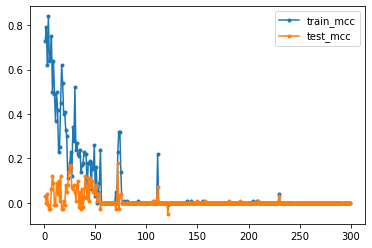

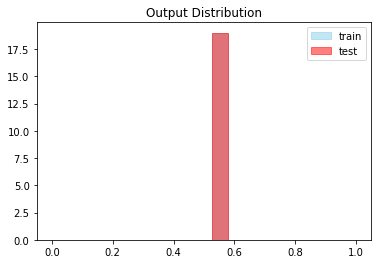




Global Iteration: (4/40) Set Number: (50/64) Epochs: 10  File: train50.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 152ms/step - loss: 2.6037 - acc: 0.0175 - val_loss: 3.3712 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 150ms/step - loss: 2.5854 - acc: 0.0175 - val_loss: 3.3793 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 149ms/step - loss: 2.5821 - acc: 0.0175 - val_loss: 3.3965 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 152ms/step - loss: 2.5685 - acc: 0.0175 - val_loss: 3.4009 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 150ms/step - loss: 2.5718 - acc: 0.0175 - val_loss: 3.4028 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 150ms/step - loss: 2.5713 - acc: 0

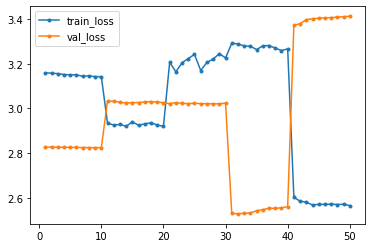

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_50_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_50_10


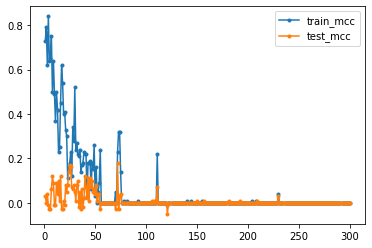

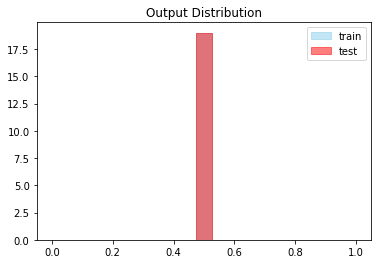




Global Iteration: (4/40) Set Number: (51/64) Epochs: 10  File: train51.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.52 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0249 - acc: 0.0250 - val_loss: 2.8251 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0310 - acc: 0.0250 - val_loss: 2.8253 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0316 - acc: 0.0250 - val_loss: 2.8259 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0293 - acc: 0.0250 - val_loss: 2.8260 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0266 - acc: 0.0250 - val_loss: 2.8261 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0308 - acc: 0

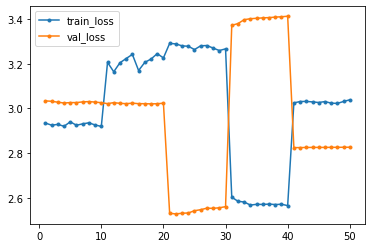

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_51_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_51_10


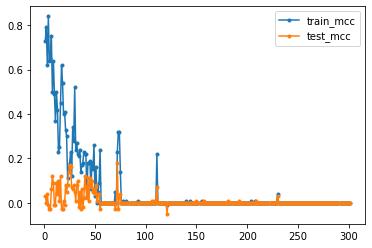

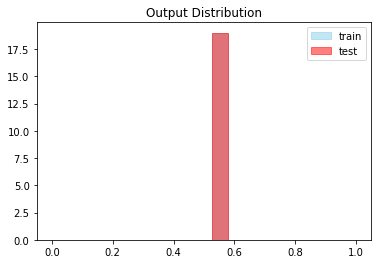




Global Iteration: (4/40) Set Number: (52/64) Epochs: 10  File: train52.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.3833 - acc: 0.0142 - val_loss: 2.7268 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3754 - acc: 0.0142 - val_loss: 2.7253 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.3723 - acc: 0.0142 - val_loss: 2.7240 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.3714 - acc: 0.0142 - val_loss: 2.7229 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.3690 - acc: 0.0142 - val_loss: 2.7220 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3597 - acc: 0

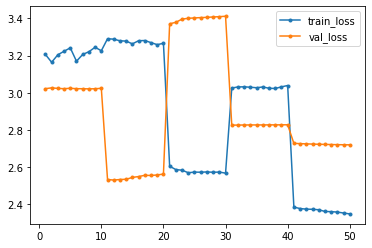

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_52_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_52_10


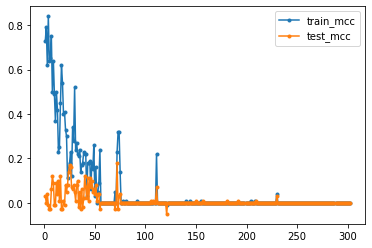

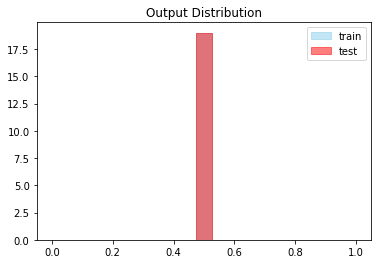




Global Iteration: (4/40) Set Number: (53/64) Epochs: 10  File: train53.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.9364 - acc: 0.0233 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9348 - acc: 0.0233 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9325 - acc: 0.0233 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9330 - acc: 0.0233 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9339 - acc: 0.0233 - val_loss: 2.8254 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9338 - acc: 0

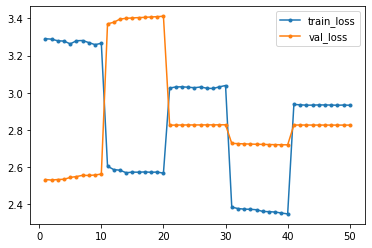

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_53_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_53_10


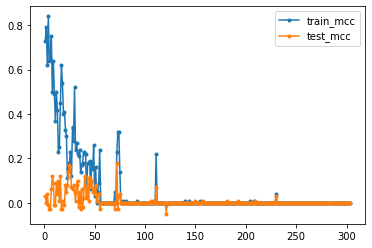

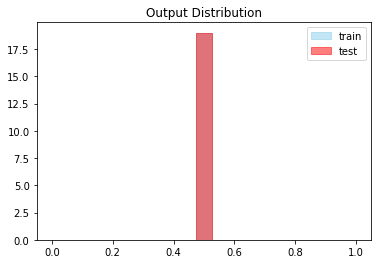




Global Iteration: (4/40) Set Number: (54/64) Epochs: 10  File: train54.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0367 - acc: 0.0250 - val_loss: 2.4025 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0359 - acc: 0.0250 - val_loss: 2.4037 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0351 - acc: 0.0250 - val_loss: 2.4046 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 3.0343 - acc: 0.0250 - val_loss: 2.4061 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0364 - acc: 0.0250 - val_loss: 2.4071 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0312 - acc: 0

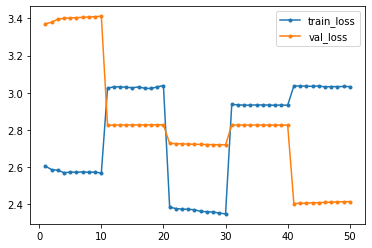

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_54_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_54_10


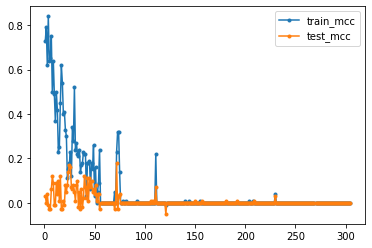

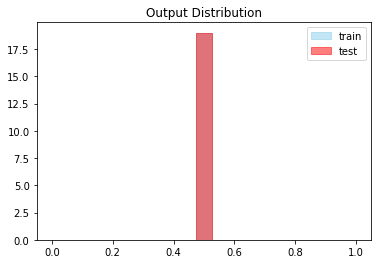




Global Iteration: (4/40) Set Number: (55/64) Epochs: 10  File: train55.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5188 - acc: 0.0167 - val_loss: 3.0313 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5146 - acc: 0.0167 - val_loss: 3.0321 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.5133 - acc: 0.0167 - val_loss: 3.0329 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5109 - acc: 0.0167 - val_loss: 3.0335 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 163ms/step - loss: 2.5103 - acc: 0.0167 - val_loss: 3.0344 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5113 - acc: 0

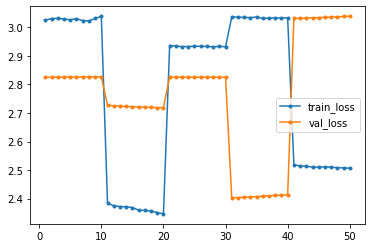

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_55_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_55_10


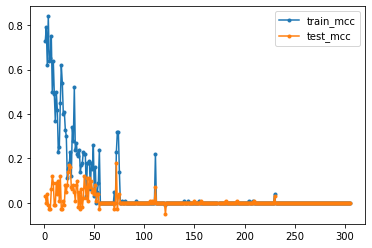

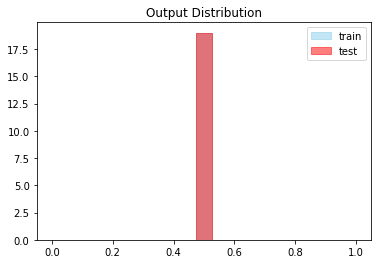




Global Iteration: (4/40) Set Number: (56/64) Epochs: 10  File: train56.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.2904 - acc: 0.0133 - val_loss: 3.0402 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2876 - acc: 0.0133 - val_loss: 3.0418 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.2860 - acc: 0.0133 - val_loss: 3.0434 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.2824 - acc: 0.0133 - val_loss: 3.0450 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2801 - acc: 0.0133 - val_loss: 3.0467 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2772 - acc: 0

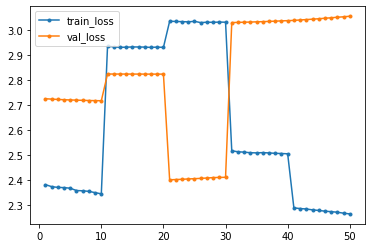

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_56_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_56_10


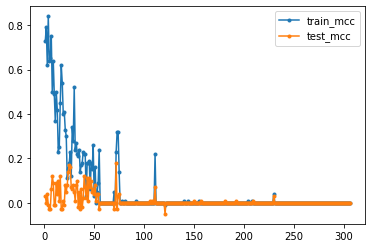

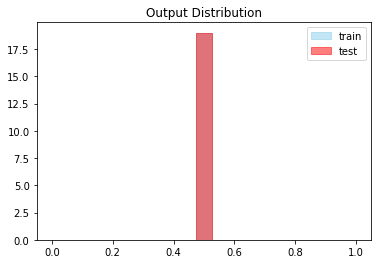




Global Iteration: (4/40) Set Number: (57/64) Epochs: 10  File: train57.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7175 - acc: 0.9800 - val_loss: 2.7179 - val_acc: 0.9800
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7161 - acc: 0.9800 - val_loss: 2.7179 - val_acc: 0.9800
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7190 - acc: 0.9800 - val_loss: 2.7179 - val_acc: 0.9800
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7187 - acc: 0.9800 - val_loss: 2.7179 - val_acc: 0.9800
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7188 - acc: 0.9800 - val_loss: 2.7178 - val_acc: 0.9800
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7167 - acc: 0

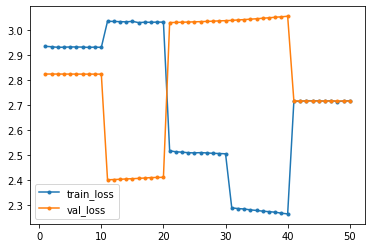

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_57_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_57_10


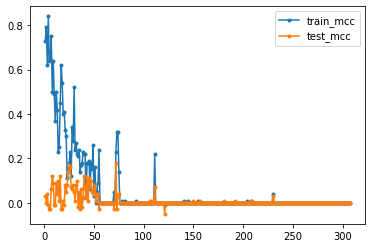

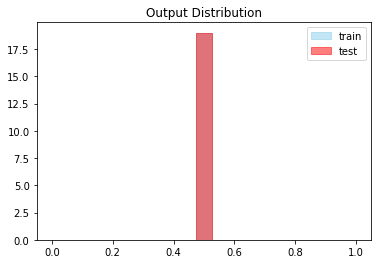




Global Iteration: (4/40) Set Number: (58/64) Epochs: 10  File: train58.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.6757 - acc: 0.9658 - val_loss: 2.6052 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.6683 - acc: 0.9417 - val_loss: 2.6061 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 3.6595 - acc: 0.4050 - val_loss: 2.6074 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6475 - acc: 0.0342 - val_loss: 2.6087 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 174ms/step - loss: 3.6396 - acc: 0.0342 - val_loss: 2.6104 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 3.6307 - acc: 0

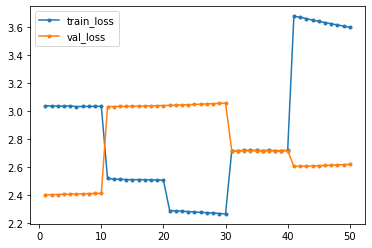

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_58_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_58_10


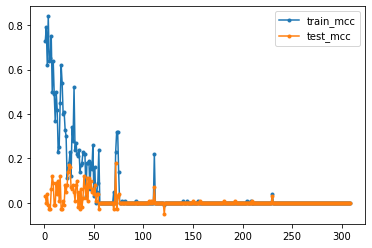

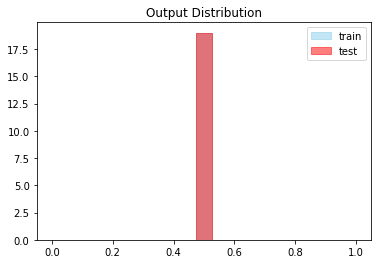




Global Iteration: (4/40) Set Number: (59/64) Epochs: 10  File: train59.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9760 - acc: 0.0242 - val_loss: 3.0296 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.9794 - acc: 0.0242 - val_loss: 3.0289 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9794 - acc: 0.0242 - val_loss: 3.0285 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9796 - acc: 0.0242 - val_loss: 3.0286 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9764 - acc: 0.0242 - val_loss: 3.0283 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9749 - acc: 0

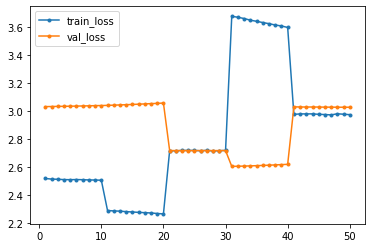

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_59_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_59_10


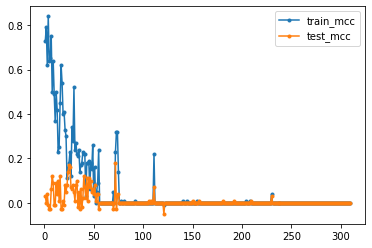

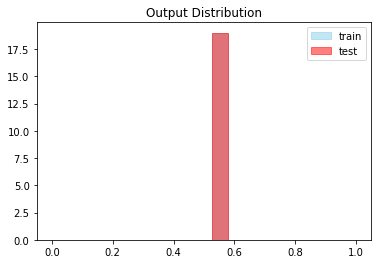




Global Iteration: (4/40) Set Number: (60/64) Epochs: 10  File: train60.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9277 - acc: 0.0233 - val_loss: 2.7259 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9228 - acc: 0.0233 - val_loss: 2.7263 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9294 - acc: 0.0233 - val_loss: 2.7263 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9246 - acc: 0.0233 - val_loss: 2.7264 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9307 - acc: 0.0233 - val_loss: 2.7266 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9255 - acc: 0

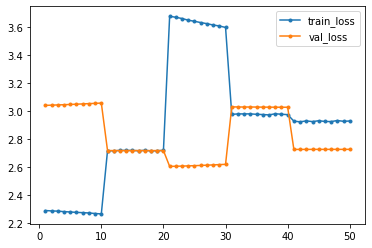

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_60_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_60_10


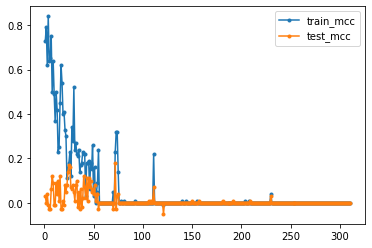

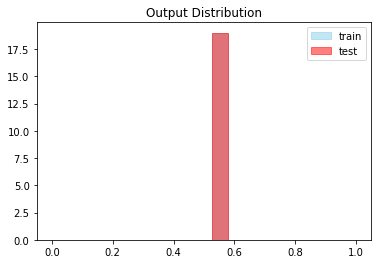




Global Iteration: (4/40) Set Number: (61/64) Epochs: 10  File: train61.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8261 - acc: 0.0217 - val_loss: 2.4270 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 176ms/step - loss: 2.8310 - acc: 0.0217 - val_loss: 2.4264 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8232 - acc: 0.0217 - val_loss: 2.4255 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8231 - acc: 0.0217 - val_loss: 2.4255 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8304 - acc: 0.0217 - val_loss: 2.4248 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8231 - acc: 0

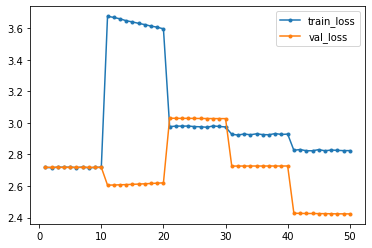

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_61_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_61_10


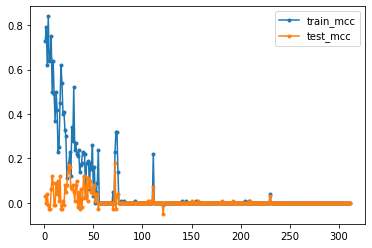

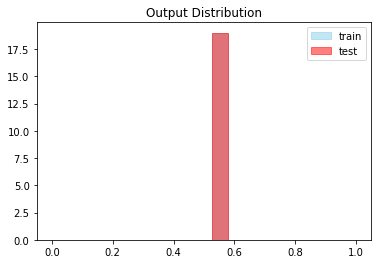




Global Iteration: (4/40) Set Number: (62/64) Epochs: 10  File: train62.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.01  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.2208 - acc: 0.0117 - val_loss: 2.2181 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2132 - acc: 0.0117 - val_loss: 2.2139 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2143 - acc: 0.0117 - val_loss: 2.2082 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.2065 - acc: 0.0117 - val_loss: 2.2027 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.2004 - acc: 0.0117 - val_loss: 2.1978 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1968 - acc: 0

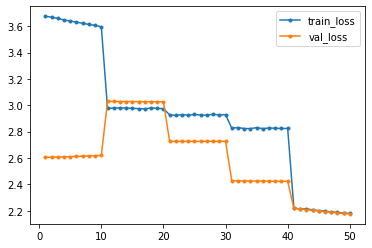

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_62_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_62_10


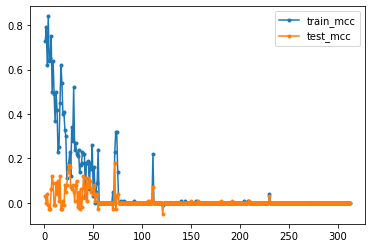

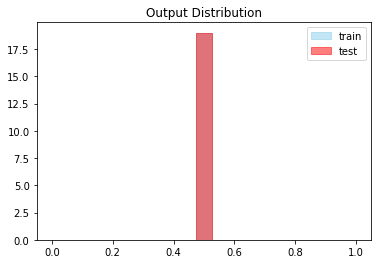




Global Iteration: (4/40) Set Number: (63/64) Epochs: 10  File: train63.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
11/11 [==============================] - 2s 155ms/step - loss: 2.8513 - acc: 0.0221 - val_loss: 3.4436 - val_acc: 0.0311
Epoch 2/10
11/11 [==============================] - 2s 141ms/step - loss: 2.8513 - acc: 0.0221 - val_loss: 3.4439 - val_acc: 0.0311
Epoch 3/10
11/11 [==============================] - 2s 142ms/step - loss: 2.8523 - acc: 0.0221 - val_loss: 3.4441 - val_acc: 0.0311
Epoch 4/10
11/11 [==============================] - 2s 143ms/step - loss: 2.8525 - acc: 0.0221 - val_loss: 3.4426 - val_acc: 0.0311
Epoch 5/10
11/11 [==============================] - 2s 142ms/step - loss: 2.8518 - acc: 0.0221 - val_loss: 3.4424 - val_acc: 0.0311
Epoch 6/10
11/11 [==============================] - 2s 143ms/step - loss: 2.8515 - acc: 0

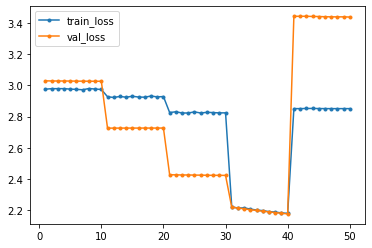

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_63_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_4_63_10


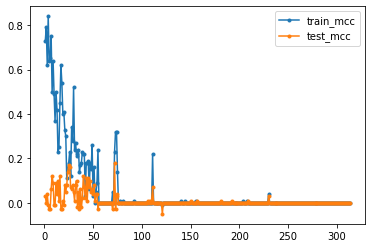

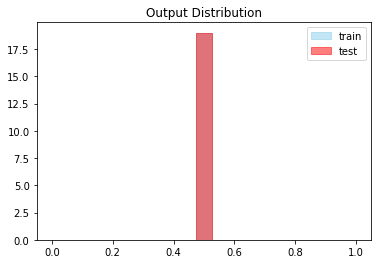




Global Iteration: (5/40) Set Number: (0/64) Epochs: 10  File: train0.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8801 - acc: 0.0225 - val_loss: 2.1793 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8793 - acc: 0.0225 - val_loss: 2.1801 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8800 - acc: 0.0225 - val_loss: 2.1810 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8786 - acc: 0.0225 - val_loss: 2.1817 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8787 - acc: 0.0225 - val_loss: 2.1835 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8789 - acc: 0.0

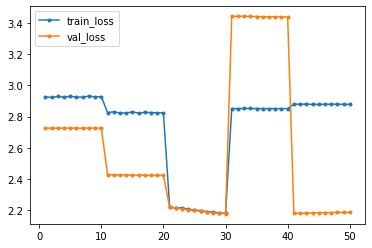

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_0_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_0_10


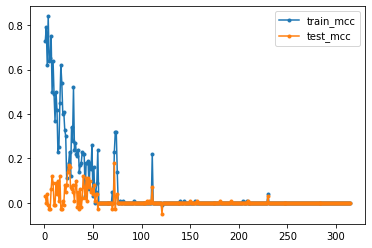

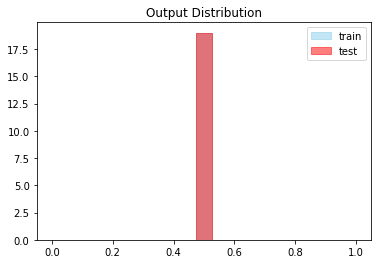




Global Iteration: (5/40) Set Number: (1/64) Epochs: 10  File: train1.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5055 - acc: 0.0167 - val_loss: 2.5055 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5054 - acc: 0.0167 - val_loss: 2.5047 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 176ms/step - loss: 2.5045 - acc: 0.0167 - val_loss: 2.5040 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5030 - acc: 0.0167 - val_loss: 2.5033 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5029 - acc: 0.0167 - val_loss: 2.5023 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5030 - acc: 0.0

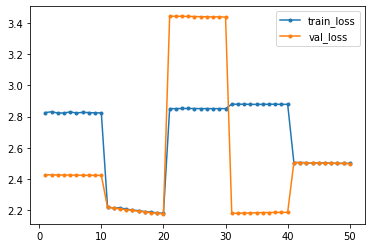

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_1_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_1_10


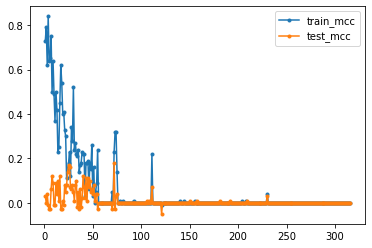

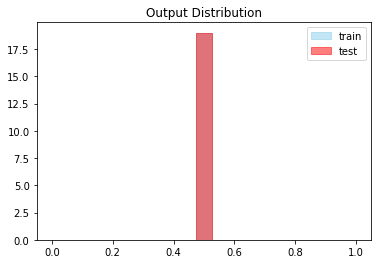




Global Iteration: (5/40) Set Number: (2/64) Epochs: 10  File: train2.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.4977 - acc: 0.0167 - val_loss: 2.3880 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4980 - acc: 0.0167 - val_loss: 2.3869 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4973 - acc: 0.0167 - val_loss: 2.3861 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4964 - acc: 0.3033 - val_loss: 2.3855 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4950 - acc: 0.5175 - val_loss: 2.3842 - val_acc: 0.9850
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4921 - acc: 0.5

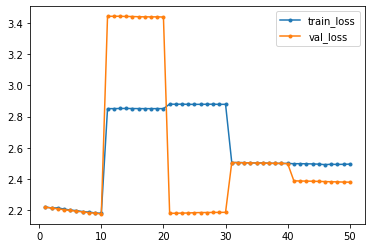

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_2_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_2_10


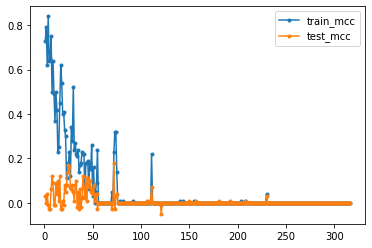

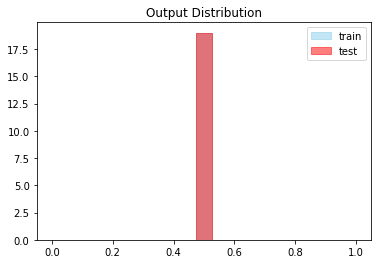




Global Iteration: (5/40) Set Number: (3/64) Epochs: 10  File: train3.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 165ms/step - loss: 2.3768 - acc: 0.9850 - val_loss: 2.3788 - val_acc: 0.9850
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3813 - acc: 0.9850 - val_loss: 2.3776 - val_acc: 0.9850
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3752 - acc: 0.9850 - val_loss: 2.3765 - val_acc: 0.9850
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.3801 - acc: 0.9850 - val_loss: 2.3757 - val_acc: 0.9850
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.3760 - acc: 0.9850 - val_loss: 2.3745 - val_acc: 0.9850
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.3750 - acc: 0.9

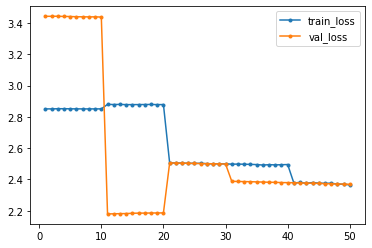

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_3_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_3_10


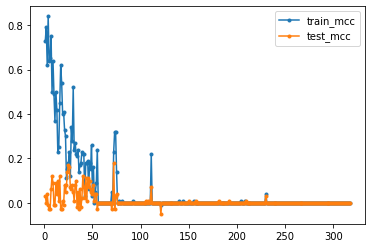

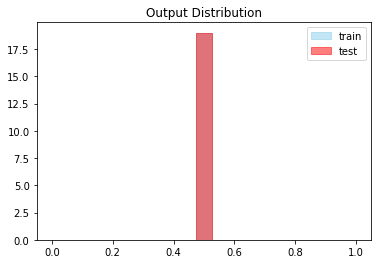




Global Iteration: (5/40) Set Number: (4/64) Epochs: 10  File: train4.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.01  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.1916 - acc: 0.9875 - val_loss: 2.8387 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1916 - acc: 0.9875 - val_loss: 2.8396 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 2.1856 - acc: 0.9875 - val_loss: 2.8417 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.1881 - acc: 0.9875 - val_loss: 2.8436 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.1828 - acc: 0.9875 - val_loss: 2.8454 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.1882 - acc: 0.9

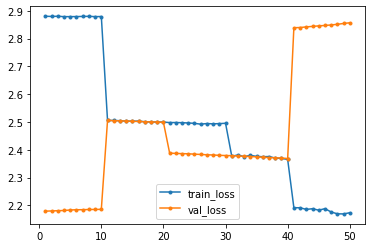

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_4_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_4_10


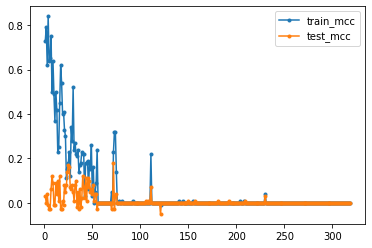

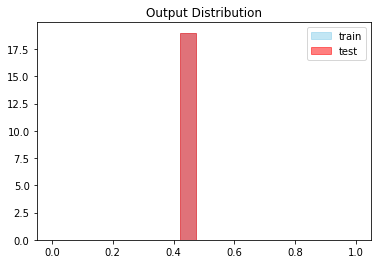




Global Iteration: (5/40) Set Number: (5/64) Epochs: 10  File: train5.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.9259 - acc: 0.9775 - val_loss: 2.6054 - val_acc: 0.9817
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9226 - acc: 0.9775 - val_loss: 2.6048 - val_acc: 0.9817
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9101 - acc: 0.9775 - val_loss: 2.6044 - val_acc: 0.9817
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9165 - acc: 0.9775 - val_loss: 2.6037 - val_acc: 0.9817
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9034 - acc: 0.9775 - val_loss: 2.6034 - val_acc: 0.9817
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9015 - acc: 0.9

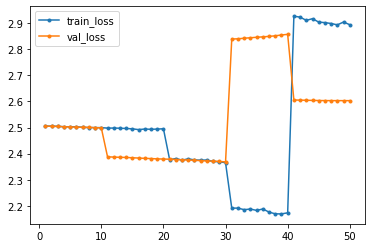

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_5_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_5_10


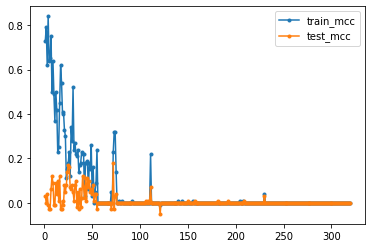

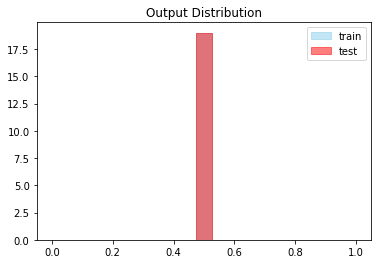




Global Iteration: (5/40) Set Number: (6/64) Epochs: 10  File: train6.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1304 - acc: 0.9742 - val_loss: 3.0752 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1390 - acc: 0.9742 - val_loss: 3.0717 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1279 - acc: 0.9742 - val_loss: 3.0687 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1262 - acc: 0.9742 - val_loss: 3.0657 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1197 - acc: 0.9742 - val_loss: 3.0636 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1221 - acc: 0.9

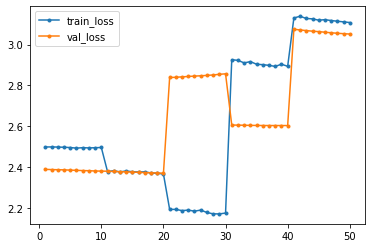

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_6_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_6_10


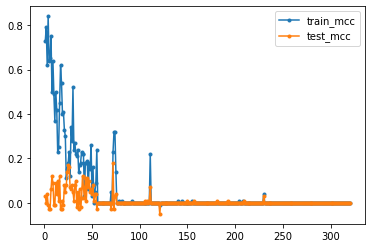

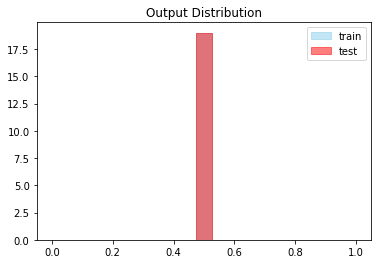




Global Iteration: (5/40) Set Number: (7/64) Epochs: 10  File: train7.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8829 - acc: 0.6417 - val_loss: 2.8288 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8824 - acc: 0.5192 - val_loss: 2.8283 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8837 - acc: 0.4675 - val_loss: 2.8281 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8855 - acc: 0.4017 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8817 - acc: 0.1367 - val_loss: 2.8277 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8829 - acc: 0.0

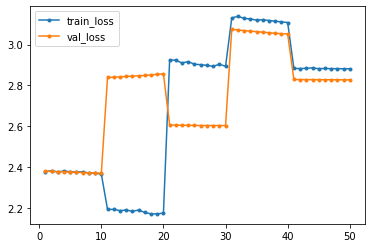

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_7_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_7_10


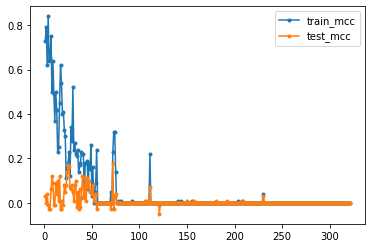

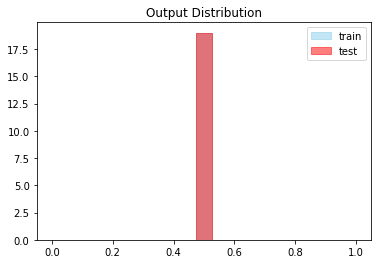




Global Iteration: (5/40) Set Number: (8/64) Epochs: 10  File: train8.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.4993 - acc: 0.0167 - val_loss: 2.4986 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5016 - acc: 0.0167 - val_loss: 2.4983 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4984 - acc: 0.0167 - val_loss: 2.4976 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4979 - acc: 0.0400 - val_loss: 2.4971 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4977 - acc: 0.2092 - val_loss: 2.4964 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4944 - acc: 0.4

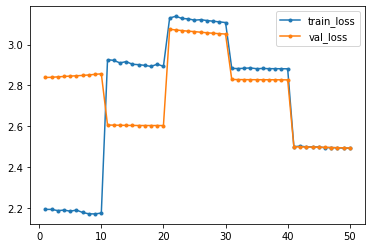

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_8_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_8_10


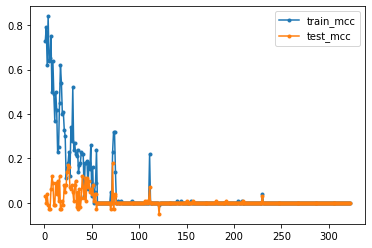

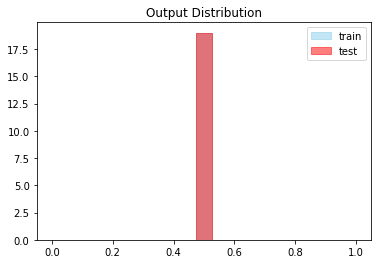




Global Iteration: (5/40) Set Number: (9/64) Epochs: 10  File: train9.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.5485 - acc: 0.9217 - val_loss: 2.8304 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5510 - acc: 0.9825 - val_loss: 2.8307 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5480 - acc: 0.9825 - val_loss: 2.8310 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5471 - acc: 0.9825 - val_loss: 2.8311 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5540 - acc: 0.9825 - val_loss: 2.8313 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5506 - acc: 0.9

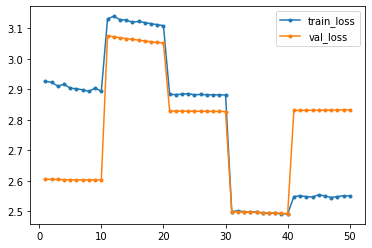

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_9_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_9_10


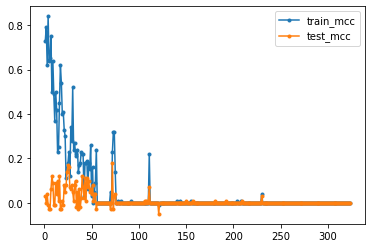

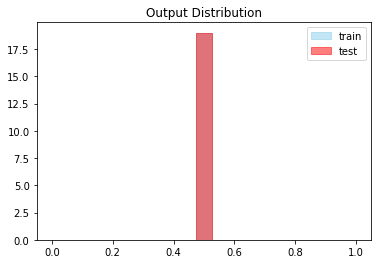




Global Iteration: (5/40) Set Number: (10/64) Epochs: 10  File: train10.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8896 - acc: 0.9775 - val_loss: 3.0602 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8908 - acc: 0.9775 - val_loss: 3.0593 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8858 - acc: 0.9775 - val_loss: 3.0580 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8898 - acc: 0.9775 - val_loss: 3.0563 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8820 - acc: 0.9775 - val_loss: 3.0563 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8837 - acc: 0

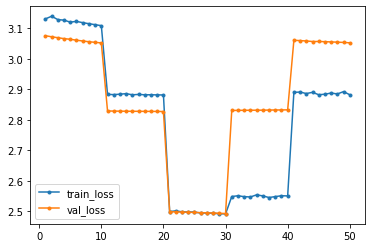

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_10_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_10_10


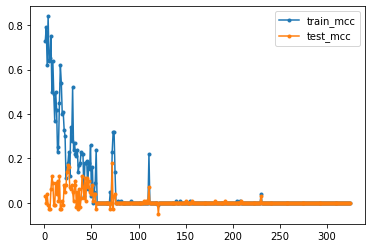

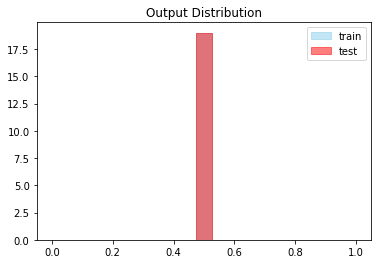




Global Iteration: (5/40) Set Number: (11/64) Epochs: 10  File: train11.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6610 - acc: 0.7433 - val_loss: 3.4607 - val_acc: 0.9689
Epoch 2/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6602 - acc: 0.7808 - val_loss: 3.4630 - val_acc: 0.9689
Epoch 3/10
12/12 [==============================] - 2s 155ms/step - loss: 2.6621 - acc: 0.7608 - val_loss: 3.4644 - val_acc: 0.9689
Epoch 4/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6614 - acc: 0.7433 - val_loss: 3.4641 - val_acc: 0.9689
Epoch 5/10
12/12 [==============================] - 2s 148ms/step - loss: 2.6612 - acc: 0.7792 - val_loss: 3.4711 - val_acc: 0.9689
Epoch 6/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6708 - acc: 0

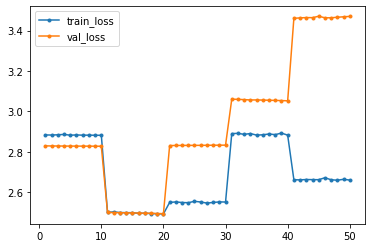

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_11_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_11_10


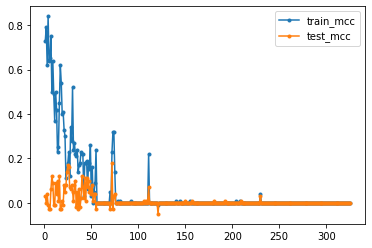

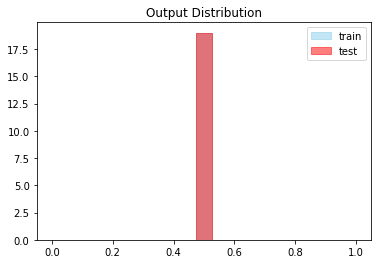




Global Iteration: (5/40) Set Number: (12/64) Epochs: 10  File: train12.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.8921 - acc: 0.8017 - val_loss: 3.1672 - val_acc: 0.9733
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8857 - acc: 0.8058 - val_loss: 3.1638 - val_acc: 0.9733
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.8871 - acc: 0.7492 - val_loss: 3.1622 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8826 - acc: 0.5708 - val_loss: 3.1613 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8867 - acc: 0.3675 - val_loss: 3.1591 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8831 - acc: 0

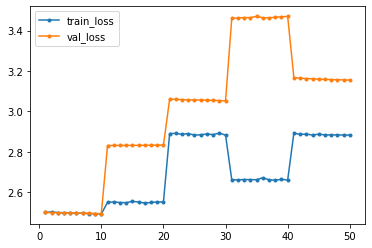

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_12_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_12_10


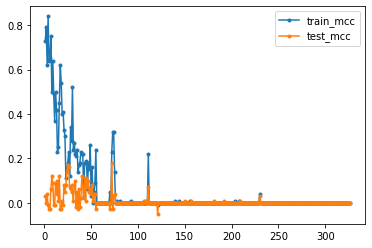

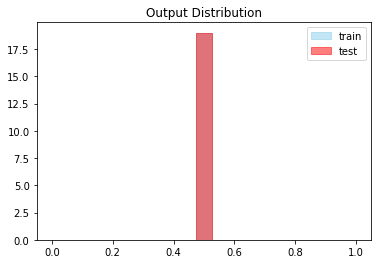




Global Iteration: (5/40) Set Number: (13/64) Epochs: 10  File: train13.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8284 - acc: 0.0217 - val_loss: 2.3905 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8279 - acc: 0.0217 - val_loss: 2.3907 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.8270 - acc: 0.0217 - val_loss: 2.3912 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8267 - acc: 0.0217 - val_loss: 2.3916 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.8267 - acc: 0.0217 - val_loss: 2.3920 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8261 - acc: 0

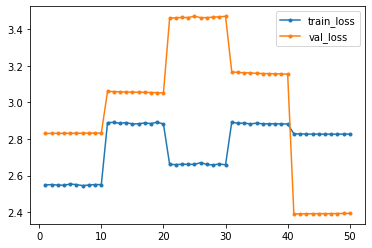

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_13_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_13_10


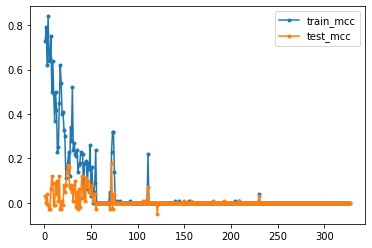

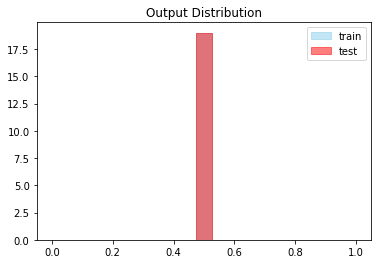




Global Iteration: (5/40) Set Number: (14/64) Epochs: 10  File: train14.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 174ms/step - loss: 2.8801 - acc: 0.0225 - val_loss: 2.7180 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8806 - acc: 0.0225 - val_loss: 2.7179 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8794 - acc: 0.0225 - val_loss: 2.7180 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8802 - acc: 0.0225 - val_loss: 2.7180 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8789 - acc: 0.0225 - val_loss: 2.7181 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8796 - acc: 0

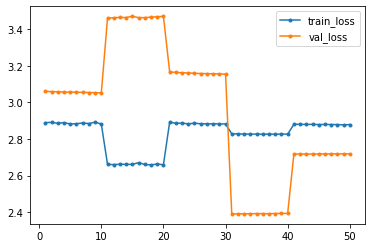

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_14_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_14_10


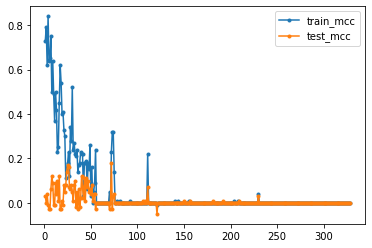

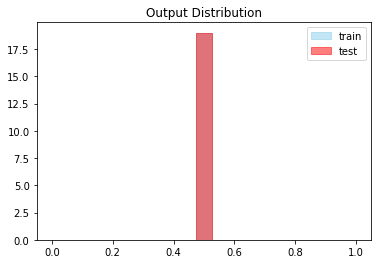




Global Iteration: (5/40) Set Number: (15/64) Epochs: 10  File: train15.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.4523 - acc: 0.0158 - val_loss: 3.0390 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4497 - acc: 0.0158 - val_loss: 3.0400 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 173ms/step - loss: 2.4507 - acc: 0.0158 - val_loss: 3.0409 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4496 - acc: 0.0158 - val_loss: 3.0412 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4471 - acc: 0.0158 - val_loss: 3.0424 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4464 - acc: 0

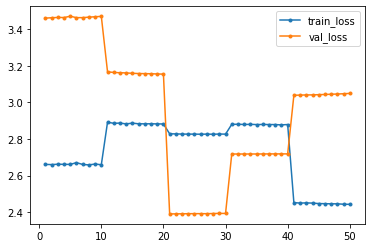

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_15_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_15_10


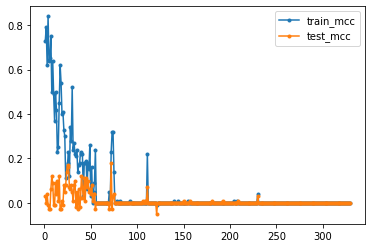

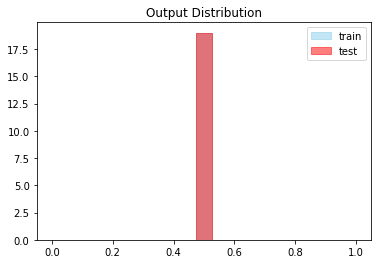




Global Iteration: (5/40) Set Number: (16/64) Epochs: 10  File: train16.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7716 - acc: 0.4458 - val_loss: 3.1603 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7731 - acc: 0.5033 - val_loss: 3.1606 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7718 - acc: 0.5183 - val_loss: 3.1611 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7719 - acc: 0.5067 - val_loss: 3.1607 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7728 - acc: 0.5008 - val_loss: 3.1602 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7726 - acc: 0

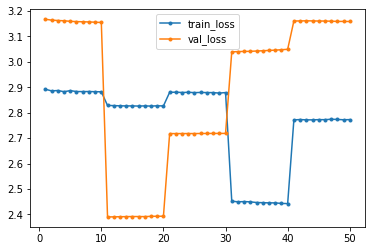

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_16_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_16_10


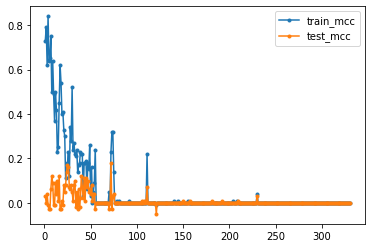

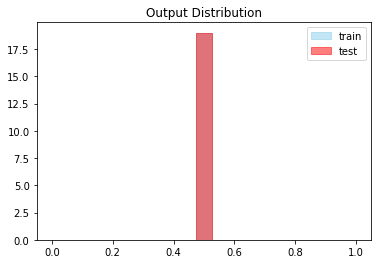




Global Iteration: (5/40) Set Number: (17/64) Epochs: 10  File: train17.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9927 - acc: 0.0242 - val_loss: 3.0475 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9916 - acc: 0.0242 - val_loss: 3.0469 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9913 - acc: 0.0242 - val_loss: 3.0460 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.9908 - acc: 0.0242 - val_loss: 3.0445 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9901 - acc: 0.0242 - val_loss: 3.0437 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9893 - acc: 0

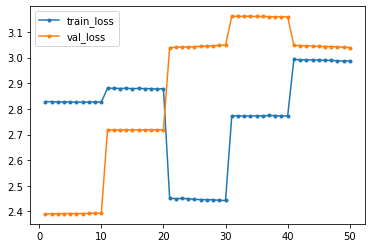

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_17_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_17_10


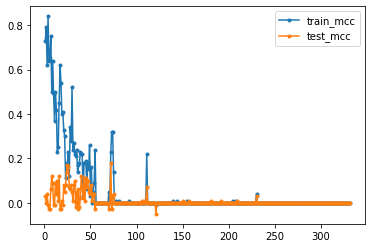

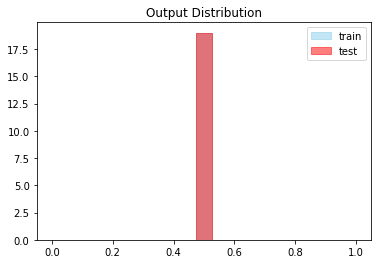




Global Iteration: (5/40) Set Number: (18/64) Epochs: 10  File: train18.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 3.0403 - acc: 0.0250 - val_loss: 2.8253 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0381 - acc: 0.0250 - val_loss: 2.8252 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0347 - acc: 0.0250 - val_loss: 2.8251 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 3.0377 - acc: 0.0250 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0363 - acc: 0.0250 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.0338 - acc: 0

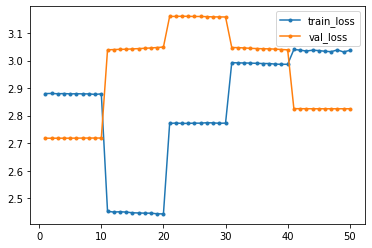

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_18_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_18_10


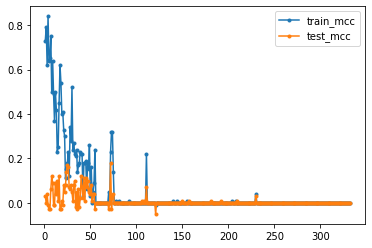

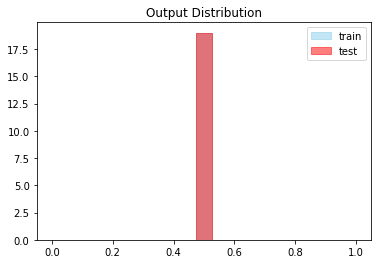




Global Iteration: (5/40) Set Number: (19/64) Epochs: 10  File: train19.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5676 - acc: 0.0175 - val_loss: 2.6178 - val_acc: 0.0183
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5675 - acc: 0.0175 - val_loss: 2.6174 - val_acc: 0.0183
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5688 - acc: 0.0175 - val_loss: 2.6162 - val_acc: 0.0183
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5642 - acc: 0.0175 - val_loss: 2.6151 - val_acc: 0.0183
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5629 - acc: 0.0175 - val_loss: 2.6144 - val_acc: 0.0183
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5597 - acc: 0

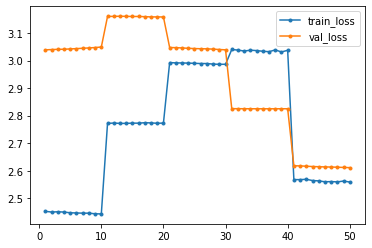

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_19_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_19_10


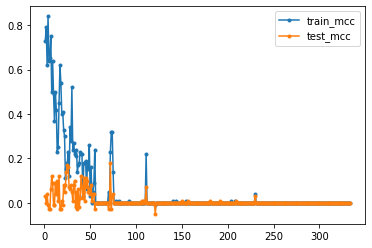

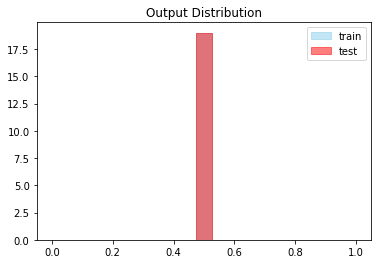




Global Iteration: (5/40) Set Number: (20/64) Epochs: 10  File: train20.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9864 - acc: 0.0242 - val_loss: 2.8256 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 175ms/step - loss: 2.9864 - acc: 0.0242 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9852 - acc: 0.0242 - val_loss: 2.8255 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 164ms/step - loss: 2.9851 - acc: 0.0242 - val_loss: 2.8253 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9851 - acc: 0.0242 - val_loss: 2.8252 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9847 - acc: 0

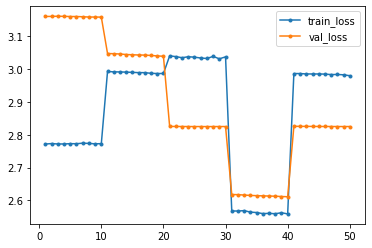

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_20_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_20_10


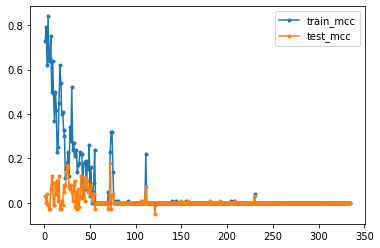

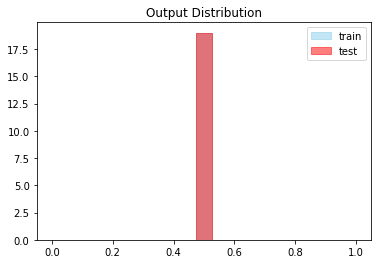




Global Iteration: (5/40) Set Number: (21/64) Epochs: 10  File: train21.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.9819 - acc: 0.0242 - val_loss: 2.1956 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9837 - acc: 0.0242 - val_loss: 2.1976 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.9764 - acc: 0.0242 - val_loss: 2.1998 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9797 - acc: 0.0242 - val_loss: 2.2005 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9797 - acc: 0.0242 - val_loss: 2.2016 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.9802 - acc: 0

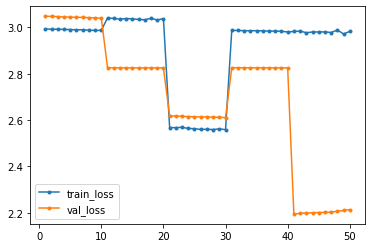

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_21_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_21_10


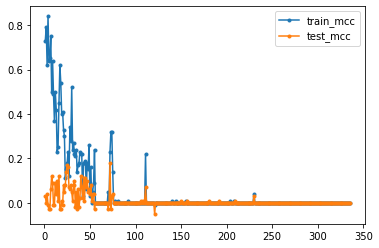

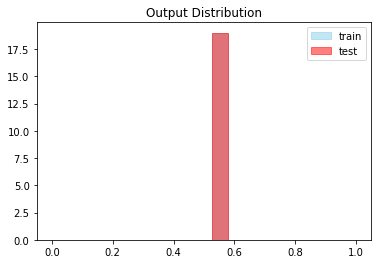




Global Iteration: (5/40) Set Number: (22/64) Epochs: 10  File: train22.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 186ms/step - loss: 3.0290 - acc: 0.0250 - val_loss: 3.1307 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 170ms/step - loss: 3.0198 - acc: 0.0250 - val_loss: 3.1273 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0269 - acc: 0.0250 - val_loss: 3.1264 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0166 - acc: 0.0250 - val_loss: 3.1239 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0319 - acc: 0.0250 - val_loss: 3.1231 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 3.0048 - acc: 0

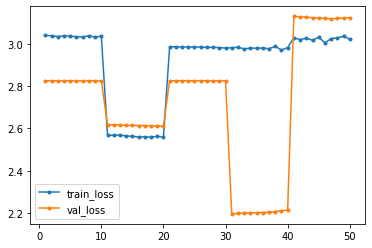

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_22_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_22_10


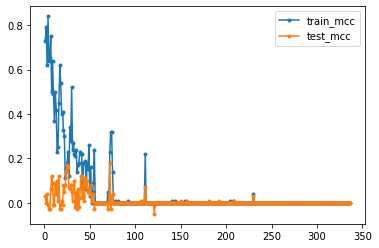

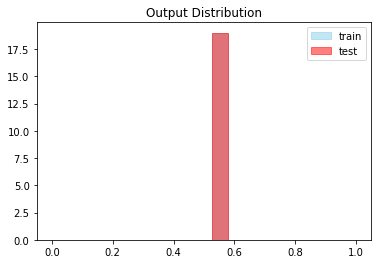




Global Iteration: (5/40) Set Number: (23/64) Epochs: 10  File: train23.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.8177 - acc: 0.0217 - val_loss: 3.0249 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8327 - acc: 0.0217 - val_loss: 3.0262 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 175ms/step - loss: 2.8398 - acc: 0.0217 - val_loss: 3.0279 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 171ms/step - loss: 2.8293 - acc: 0.0217 - val_loss: 3.0288 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8084 - acc: 0.0217 - val_loss: 3.0289 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8318 - acc: 0

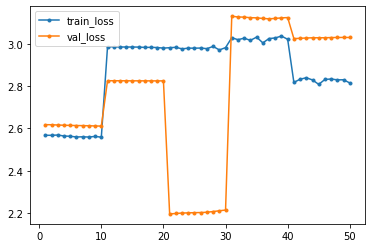

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_23_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_23_10


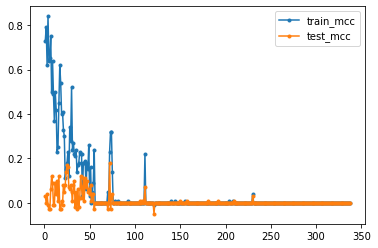

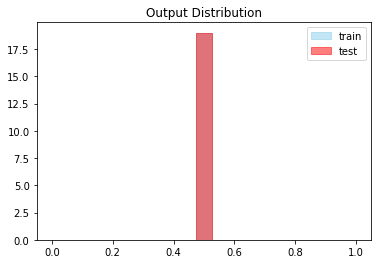




Global Iteration: (5/40) Set Number: (24/64) Epochs: 10  File: train24.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.5714 - acc: 0.0175 - val_loss: 2.4152 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5730 - acc: 0.0175 - val_loss: 2.4152 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.5763 - acc: 0.0175 - val_loss: 2.4124 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5727 - acc: 0.0175 - val_loss: 2.4090 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5691 - acc: 0.0175 - val_loss: 2.4074 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 170ms/step - loss: 2.5680 - acc: 0

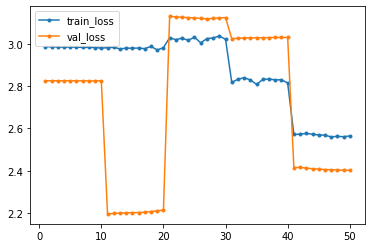

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_24_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_24_10


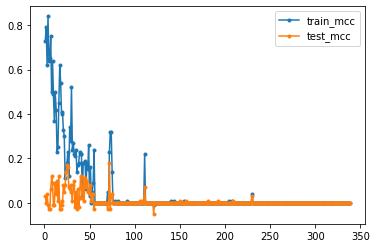

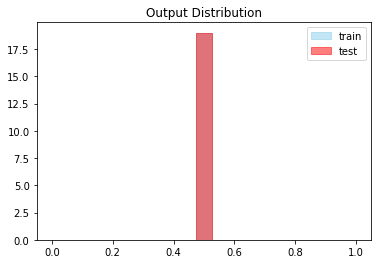




Global Iteration: (5/40) Set Number: (25/64) Epochs: 10  File: train25.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 179ms/step - loss: 2.3990 - acc: 0.0150 - val_loss: 2.3999 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3977 - acc: 0.0150 - val_loss: 2.3976 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 178ms/step - loss: 2.3970 - acc: 0.0150 - val_loss: 2.3959 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3957 - acc: 0.0150 - val_loss: 2.3936 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3972 - acc: 0.0150 - val_loss: 2.3924 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.3934 - acc: 0

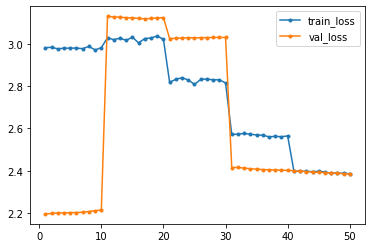

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_25_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_25_10


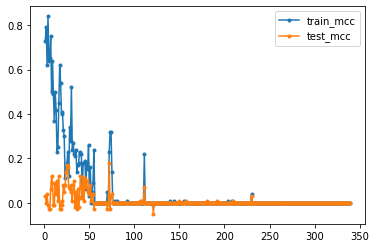

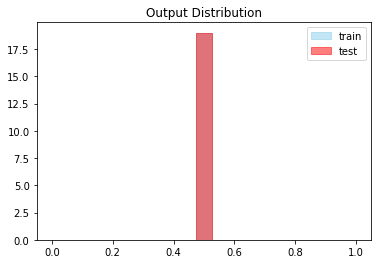




Global Iteration: (5/40) Set Number: (26/64) Epochs: 10  File: train26.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7691 - acc: 0.5117 - val_loss: 3.0513 - val_acc: 0.9750
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7738 - acc: 0.4917 - val_loss: 3.0515 - val_acc: 0.9750
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7694 - acc: 0.5117 - val_loss: 3.0517 - val_acc: 0.9750
Epoch 4/10
12/12 [==============================] - 2s 170ms/step - loss: 2.7731 - acc: 0.5167 - val_loss: 3.0515 - val_acc: 0.9750
Epoch 5/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7692 - acc: 0.5158 - val_loss: 3.0510 - val_acc: 0.9750
Epoch 6/10
12/12 [==============================] - 2s 169ms/step - loss: 2.7741 - acc: 0

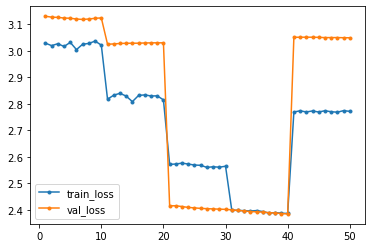

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_26_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_26_10


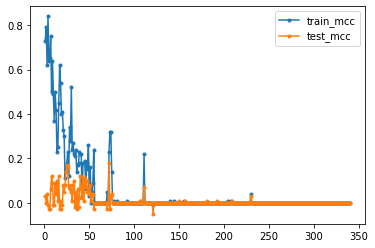

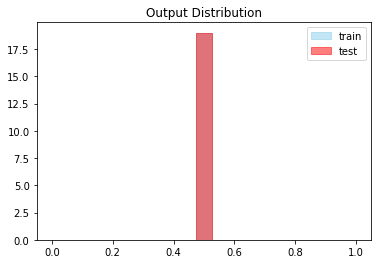




Global Iteration: (5/40) Set Number: (27/64) Epochs: 10  File: train27.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.03  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 170ms/step - loss: 3.1578 - acc: 0.3758 - val_loss: 3.1571 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1598 - acc: 0.2450 - val_loss: 3.1541 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1553 - acc: 0.0542 - val_loss: 3.1509 - val_acc: 0.0267
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 3.1472 - acc: 0.0267 - val_loss: 3.1483 - val_acc: 0.0267
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1460 - acc: 0.0267 - val_loss: 3.1460 - val_acc: 0.0267
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1487 - acc: 0

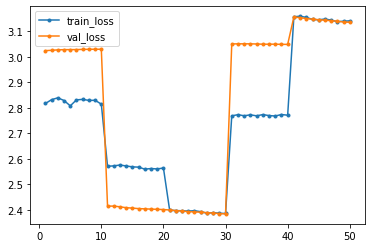

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_27_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_27_10


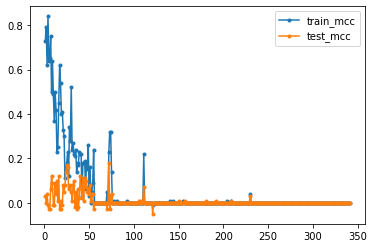

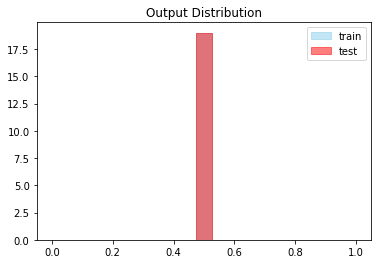




Global Iteration: (5/40) Set Number: (28/64) Epochs: 10  File: train28.h5 Version: MODEL_V101
Test features loaded
Failed:  (28, 'train28.h5')



Global Iteration: (5/40) Set Number: (29/64) Epochs: 10  File: train29.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9348 - acc: 0.0233 - val_loss: 2.5146 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9250 - acc: 0.0233 - val_loss: 2.5152 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9324 - acc: 0.0233 - val_loss: 2.5155 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9275 - acc: 0.0233 - val_loss: 2.5163 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2

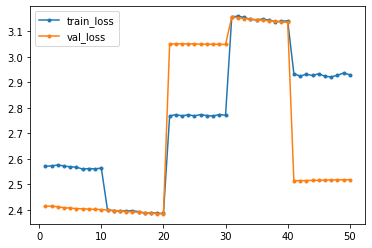

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_29_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_29_10


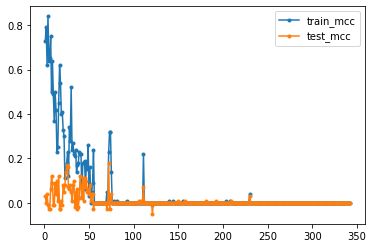

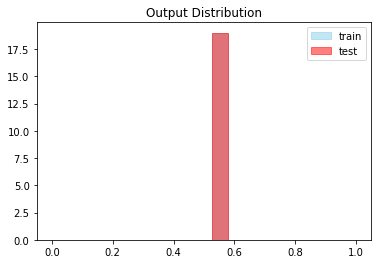




Global Iteration: (5/40) Set Number: (30/64) Epochs: 10  File: train30.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8263 - acc: 0.0217 - val_loss: 2.7232 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8208 - acc: 0.0217 - val_loss: 2.7226 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8281 - acc: 0.0217 - val_loss: 2.7227 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8183 - acc: 0.0217 - val_loss: 2.7226 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8176 - acc: 0.0217 - val_loss: 2.7229 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8281 - acc: 0

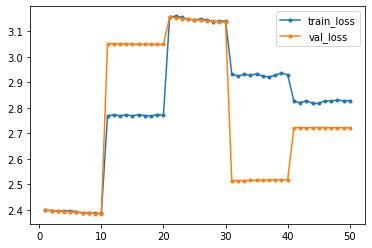

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_30_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_30_10


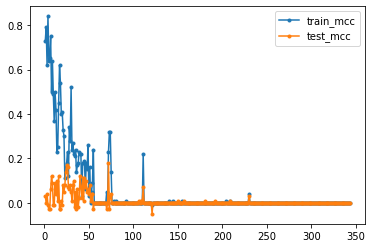

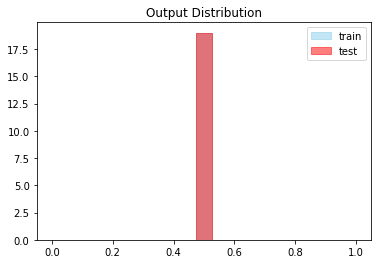




Global Iteration: (5/40) Set Number: (31/64) Epochs: 10  File: train31.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7195 - acc: 0.0200 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7202 - acc: 0.0200 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.7147 - acc: 0.0200 - val_loss: 2.8250 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7268 - acc: 0.0200 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7272 - acc: 0.0200 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7251 - acc: 0

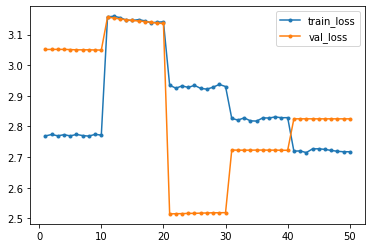

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_31_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_31_10


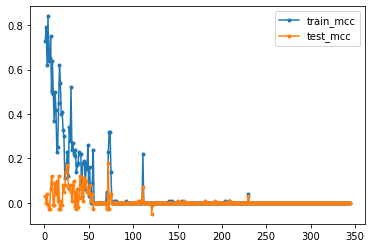

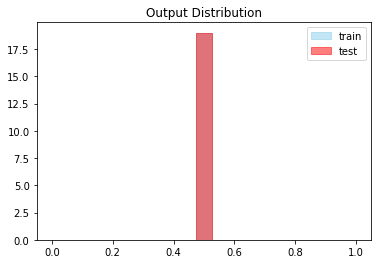




Global Iteration: (5/40) Set Number: (32/64) Epochs: 10  File: train32.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6105 - acc: 0.0183 - val_loss: 3.4198 - val_acc: 0.0311
Epoch 2/10
12/12 [==============================] - 2s 146ms/step - loss: 2.6180 - acc: 0.0183 - val_loss: 3.4215 - val_acc: 0.0311
Epoch 3/10
12/12 [==============================] - 2s 155ms/step - loss: 2.6142 - acc: 0.0183 - val_loss: 3.4233 - val_acc: 0.0311
Epoch 4/10
12/12 [==============================] - 2s 148ms/step - loss: 2.6181 - acc: 0.0183 - val_loss: 3.4256 - val_acc: 0.0311
Epoch 5/10
12/12 [==============================] - 2s 149ms/step - loss: 2.6144 - acc: 0.0183 - val_loss: 3.4270 - val_acc: 0.0311
Epoch 6/10
12/12 [==============================] - 2s 148ms/step - loss: 2.6088 - acc: 0

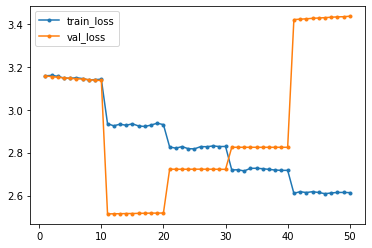

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_32_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_32_10


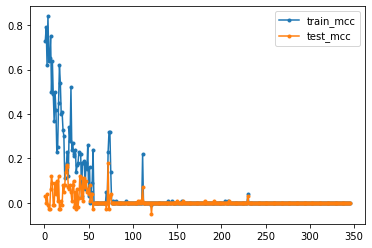

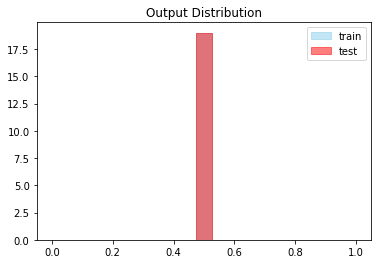




Global Iteration: (5/40) Set Number: (33/64) Epochs: 10  File: train33.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 166ms/step - loss: 3.3074 - acc: 0.0292 - val_loss: 3.0398 - val_acc: 0.0250
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 3.3087 - acc: 0.0292 - val_loss: 3.0381 - val_acc: 0.0250
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 3.3056 - acc: 0.0292 - val_loss: 3.0366 - val_acc: 0.0250
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 3.3002 - acc: 0.0292 - val_loss: 3.0351 - val_acc: 0.0250
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.3009 - acc: 0.0292 - val_loss: 3.0336 - val_acc: 0.0250
Epoch 6/10
12/12 [==============================] - 2s 164ms/step - loss: 3.2936 - acc: 0

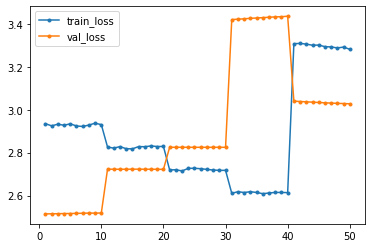

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_33_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_33_10


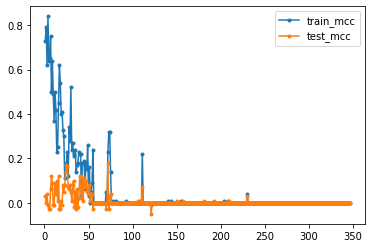

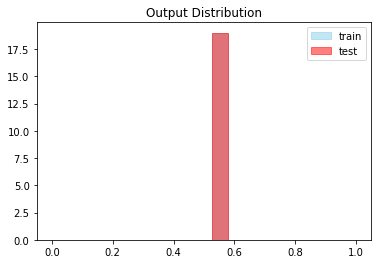




Global Iteration: (5/40) Set Number: (34/64) Epochs: 10  File: train34.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 176ms/step - loss: 2.5724 - acc: 0.0175 - val_loss: 2.5235 - val_acc: 0.0167
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5714 - acc: 0.0175 - val_loss: 2.5226 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 164ms/step - loss: 2.5678 - acc: 0.0175 - val_loss: 2.5215 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5744 - acc: 0.0175 - val_loss: 2.5197 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.5662 - acc: 0.0175 - val_loss: 2.5178 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.5678 - acc: 0

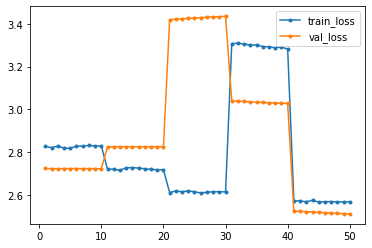

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_34_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_34_10


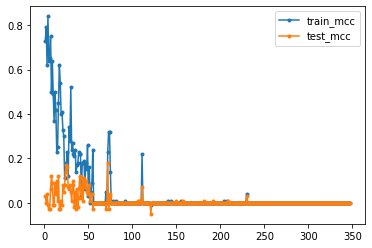

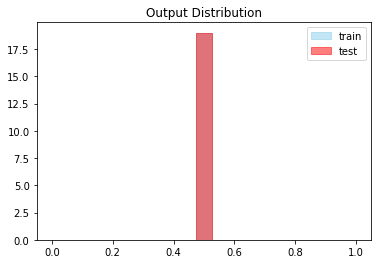




Global Iteration: (5/40) Set Number: (35/64) Epochs: 10  File: train35.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7722 - acc: 0.0208 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7723 - acc: 0.0208 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7753 - acc: 0.0208 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7762 - acc: 0.0208 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 5/10
12/12 [==============================] - 2s 166ms/step - loss: 2.7708 - acc: 0.0208 - val_loss: 2.8249 - val_acc: 0.0217
Epoch 6/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7708 - acc: 0

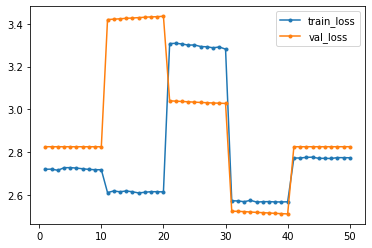

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_35_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_35_10


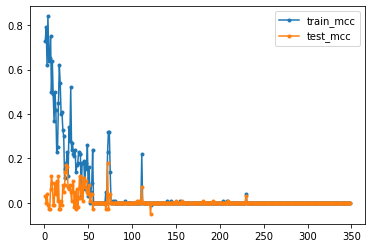

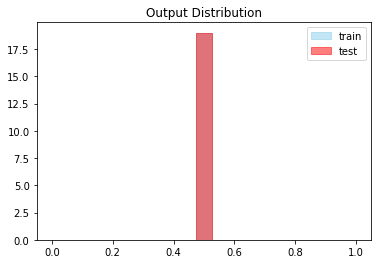




Global Iteration: (5/40) Set Number: (36/64) Epochs: 10  File: train36.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.6113 - acc: 0.0183 - val_loss: 2.7195 - val_acc: 0.0200
Epoch 2/10
12/12 [==============================] - 2s 169ms/step - loss: 2.6130 - acc: 0.0183 - val_loss: 2.7193 - val_acc: 0.0200
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6143 - acc: 0.0183 - val_loss: 2.7190 - val_acc: 0.0200
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6137 - acc: 0.0183 - val_loss: 2.7188 - val_acc: 0.0200
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6117 - acc: 0.0183 - val_loss: 2.7187 - val_acc: 0.0200
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6121 - acc: 0

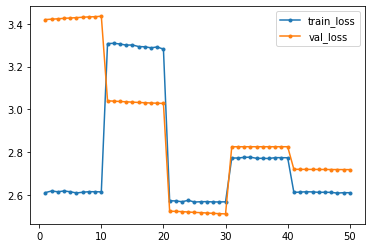

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_36_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_36_10


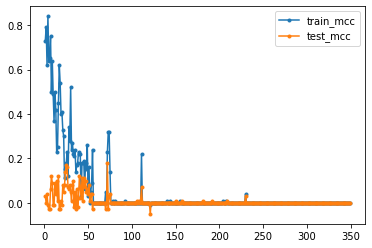

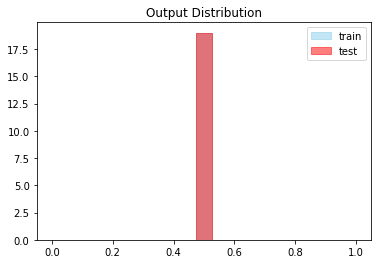




Global Iteration: (5/40) Set Number: (37/64) Epochs: 10  File: train37.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.5559 - acc: 0.0175 - val_loss: 2.1769 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5575 - acc: 0.0175 - val_loss: 2.1758 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 172ms/step - loss: 2.5582 - acc: 0.0175 - val_loss: 2.1744 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5536 - acc: 0.0175 - val_loss: 2.1729 - val_acc: 0.0117
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.5552 - acc: 0.0175 - val_loss: 2.1715 - val_acc: 0.0117
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.5524 - acc: 0

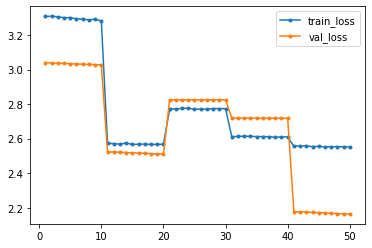

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_37_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_37_10


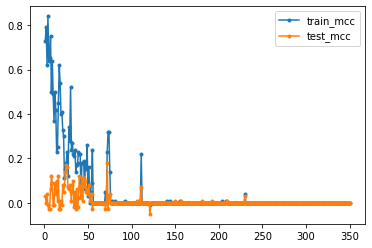

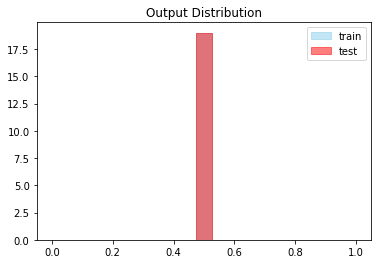




Global Iteration: (5/40) Set Number: (38/64) Epochs: 10  File: train38.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 148ms/step - loss: 2.4425 - acc: 0.3758 - val_loss: 3.4583 - val_acc: 0.9689
Epoch 2/10
12/12 [==============================] - 2s 149ms/step - loss: 2.4400 - acc: 0.7217 - val_loss: 3.4613 - val_acc: 0.9689
Epoch 3/10
12/12 [==============================] - 2s 148ms/step - loss: 2.4382 - acc: 0.8325 - val_loss: 3.4641 - val_acc: 0.9689
Epoch 4/10
12/12 [==============================] - 2s 146ms/step - loss: 2.4350 - acc: 0.9842 - val_loss: 3.4671 - val_acc: 0.9689
Epoch 5/10
12/12 [==============================] - 2s 147ms/step - loss: 2.4376 - acc: 0.9842 - val_loss: 3.4690 - val_acc: 0.9689
Epoch 6/10
12/12 [==============================] - 2s 148ms/step - loss: 2.4358 - acc: 0

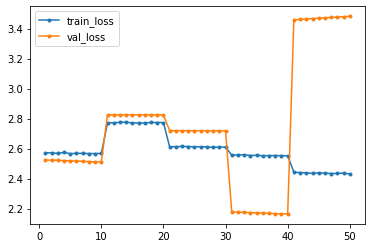

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_38_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_38_10


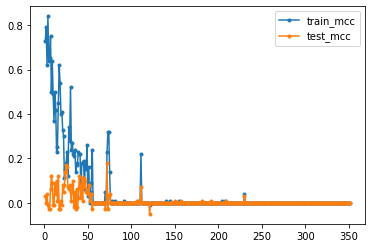

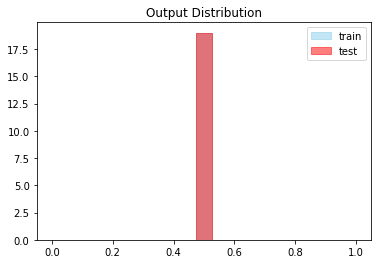




Global Iteration: (5/40) Set Number: (39/64) Epochs: 10  File: train39.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 164ms/step - loss: 3.0041 - acc: 0.9758 - val_loss: 2.1453 - val_acc: 0.9883
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 3.0050 - acc: 0.9758 - val_loss: 2.1473 - val_acc: 0.9883
Epoch 3/10
12/12 [==============================] - 2s 167ms/step - loss: 3.0035 - acc: 0.9758 - val_loss: 2.1488 - val_acc: 0.9883
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 3.0023 - acc: 0.9758 - val_loss: 2.1519 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 3.0023 - acc: 0.9758 - val_loss: 2.1547 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9994 - acc: 0

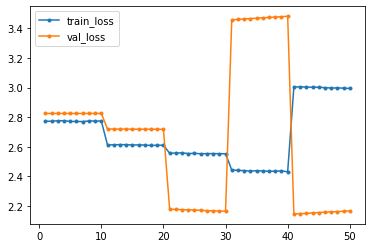

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_39_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_39_10


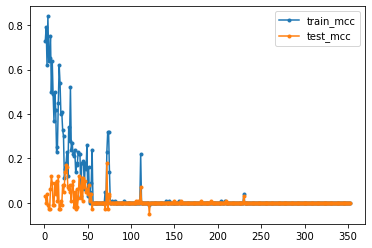

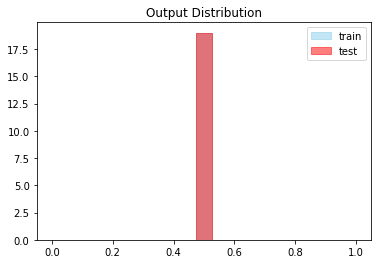




Global Iteration: (5/40) Set Number: (40/64) Epochs: 10  File: train40.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 175ms/step - loss: 2.4958 - acc: 0.1250 - val_loss: 2.8277 - val_acc: 0.0217
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4949 - acc: 0.2250 - val_loss: 2.8279 - val_acc: 0.0217
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4964 - acc: 0.2675 - val_loss: 2.8281 - val_acc: 0.0217
Epoch 4/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4948 - acc: 0.5033 - val_loss: 2.8284 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.4943 - acc: 0.7417 - val_loss: 2.8290 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4928 - acc: 0

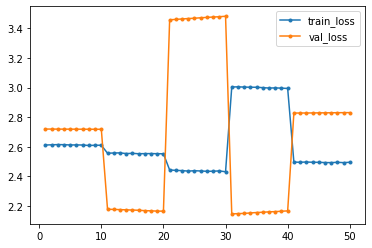

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_40_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_40_10


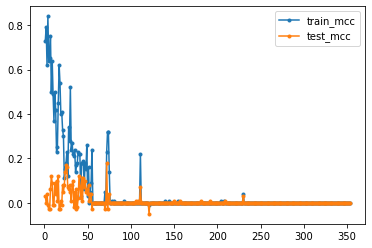

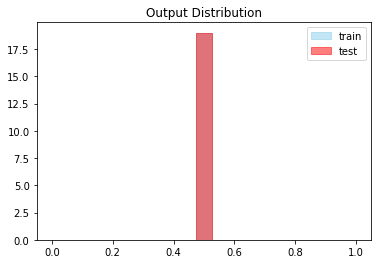




Global Iteration: (5/40) Set Number: (41/64) Epochs: 10  File: train41.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 182ms/step - loss: 2.8867 - acc: 0.9775 - val_loss: 2.3788 - val_acc: 0.9850
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8907 - acc: 0.9775 - val_loss: 2.3793 - val_acc: 0.9850
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.8860 - acc: 0.9775 - val_loss: 2.3798 - val_acc: 0.9850
Epoch 4/10
12/12 [==============================] - 2s 169ms/step - loss: 2.8884 - acc: 0.9775 - val_loss: 2.3808 - val_acc: 0.9850
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.8859 - acc: 0.9775 - val_loss: 2.3819 - val_acc: 0.9850
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.8841 - acc: 0

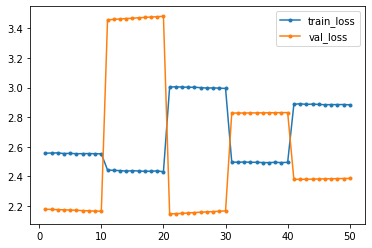

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_41_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_41_10


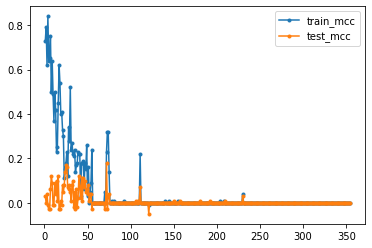

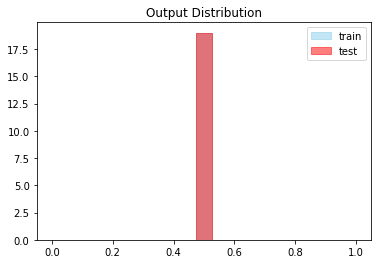




Global Iteration: (5/40) Set Number: (42/64) Epochs: 10  File: train42.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.03
Epoch 1/10
12/12 [==============================] - 2s 169ms/step - loss: 2.4964 - acc: 0.2608 - val_loss: 3.1596 - val_acc: 0.0267
Epoch 2/10
12/12 [==============================] - 2s 166ms/step - loss: 2.4969 - acc: 0.3208 - val_loss: 3.1609 - val_acc: 0.0267
Epoch 3/10
12/12 [==============================] - 2s 174ms/step - loss: 2.4954 - acc: 0.6450 - val_loss: 3.1622 - val_acc: 0.9733
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.4956 - acc: 0.8592 - val_loss: 3.1638 - val_acc: 0.9733
Epoch 5/10
12/12 [==============================] - 2s 164ms/step - loss: 2.4948 - acc: 0.9833 - val_loss: 3.1645 - val_acc: 0.9733
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.4947 - acc: 0

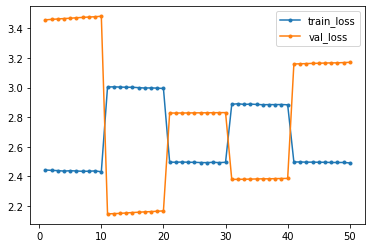

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_42_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_42_10


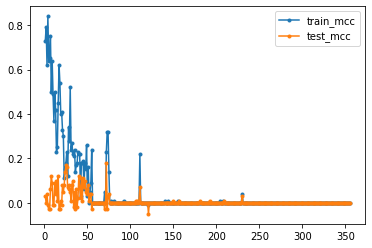

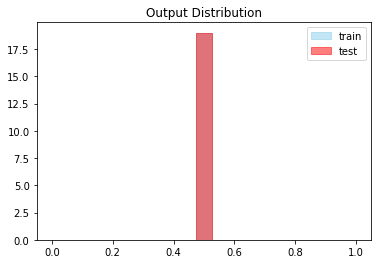




Global Iteration: (5/40) Set Number: (43/64) Epochs: 10  File: train43.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.53  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9427 - acc: 0.9767 - val_loss: 2.8311 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9442 - acc: 0.9767 - val_loss: 2.8306 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9442 - acc: 0.9767 - val_loss: 2.8301 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9435 - acc: 0.9767 - val_loss: 2.8298 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 2.9433 - acc: 0.9767 - val_loss: 2.8295 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9404 - acc: 0

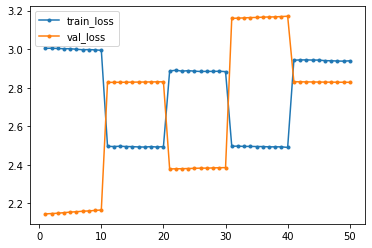

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_43_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_43_10


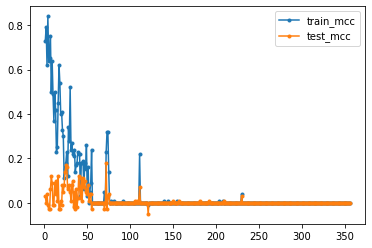

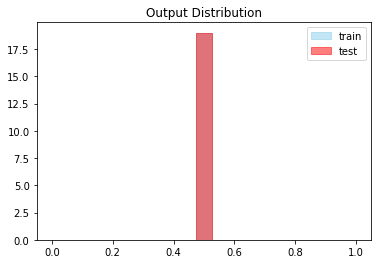




Global Iteration: (5/40) Set Number: (44/64) Epochs: 10  File: train44.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.01
Epoch 1/10
12/12 [==============================] - 2s 178ms/step - loss: 2.6069 - acc: 0.2750 - val_loss: 2.1646 - val_acc: 0.0117
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 2.6060 - acc: 0.2942 - val_loss: 2.1639 - val_acc: 0.0117
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.6049 - acc: 0.3992 - val_loss: 2.1630 - val_acc: 0.0117
Epoch 4/10
12/12 [==============================] - 2s 172ms/step - loss: 2.6045 - acc: 0.4975 - val_loss: 2.1622 - val_acc: 0.9883
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.6053 - acc: 0.5383 - val_loss: 2.1615 - val_acc: 0.9883
Epoch 6/10
12/12 [==============================] - 2s 166ms/step - loss: 2.6057 - acc: 0

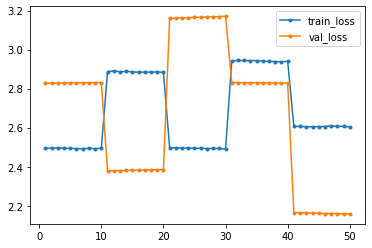

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_44_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_44_10


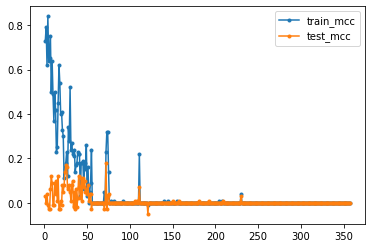

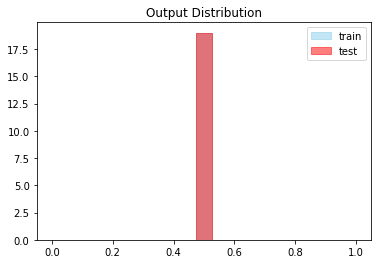




Global Iteration: (5/40) Set Number: (45/64) Epochs: 10  File: train45.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.52  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 171ms/step - loss: 2.7174 - acc: 0.9800 - val_loss: 2.8295 - val_acc: 0.9783
Epoch 2/10
12/12 [==============================] - 2s 174ms/step - loss: 2.7169 - acc: 0.9800 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 3/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7178 - acc: 0.9525 - val_loss: 2.8293 - val_acc: 0.9783
Epoch 4/10
12/12 [==============================] - 2s 167ms/step - loss: 2.7185 - acc: 0.8283 - val_loss: 2.8290 - val_acc: 0.9783
Epoch 5/10
12/12 [==============================] - 2s 168ms/step - loss: 2.7168 - acc: 0.7892 - val_loss: 2.8290 - val_acc: 0.9783
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 2.7171 - acc: 0

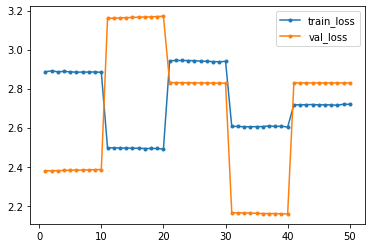

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_45_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_45_10


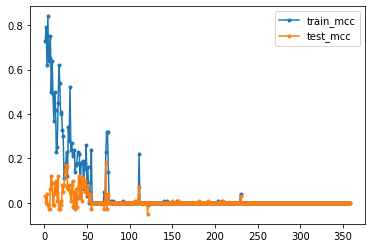

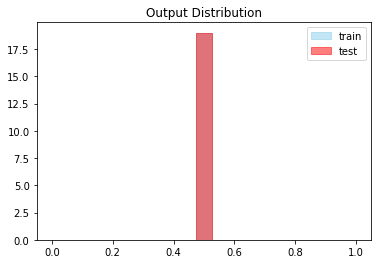




Global Iteration: (5/40) Set Number: (46/64) Epochs: 10  File: train46.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.53 Avg Test Wt: 0.54  Train Prop: 0.03  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 168ms/step - loss: 3.1617 - acc: 0.7600 - val_loss: 2.4945 - val_acc: 0.9833
Epoch 2/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1628 - acc: 0.5383 - val_loss: 2.4961 - val_acc: 0.0167
Epoch 3/10
12/12 [==============================] - 2s 166ms/step - loss: 3.1609 - acc: 0.2400 - val_loss: 2.4972 - val_acc: 0.0167
Epoch 4/10
12/12 [==============================] - 2s 176ms/step - loss: 3.1602 - acc: 0.0408 - val_loss: 2.4981 - val_acc: 0.0167
Epoch 5/10
12/12 [==============================] - 2s 167ms/step - loss: 3.1535 - acc: 0.0267 - val_loss: 2.4996 - val_acc: 0.0167
Epoch 6/10
12/12 [==============================] - 2s 165ms/step - loss: 3.1520 - acc: 0

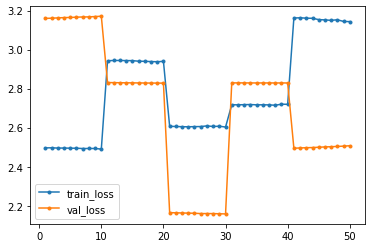

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_46_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_46_10


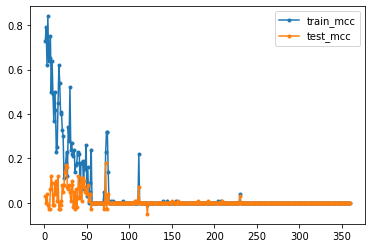

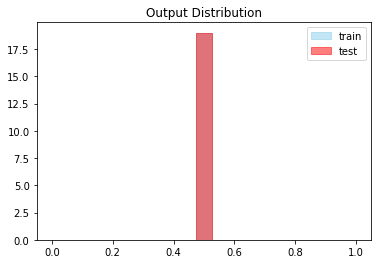




Global Iteration: (5/40) Set Number: (47/64) Epochs: 10  File: train47.h5 Version: MODEL_V101
Test features loaded
Train features loaded
Test Labels loaded
Train Labels loaded
Avg Train Wt: 0.54 Avg Test Wt: 0.54  Train Prop: 0.02  Test Prop: 0.02
Epoch 1/10
12/12 [==============================] - 2s 177ms/step - loss: 2.9249 - acc: 0.0233 - val_loss: 2.4033 - val_acc: 0.0150
Epoch 2/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9335 - acc: 0.0233 - val_loss: 2.4046 - val_acc: 0.0150
Epoch 3/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9316 - acc: 0.0233 - val_loss: 2.4040 - val_acc: 0.0150
Epoch 4/10
12/12 [==============================] - 2s 166ms/step - loss: 2.9328 - acc: 0.0233 - val_loss: 2.4052 - val_acc: 0.0150
Epoch 5/10
12/12 [==============================] - 2s 165ms/step - loss: 2.9273 - acc: 0.0233 - val_loss: 2.4062 - val_acc: 0.0150
Epoch 6/10
12/12 [==============================] - 2s 168ms/step - loss: 2.9358 - acc: 0

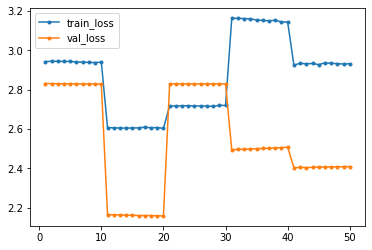

INFO:tensorflow:Assets written to: /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_47_10/assets
Model saved to :  /content/gdrive/My Drive/Google Colab Data/StallCatcher/mini/MODEL_FOLDER/MODEL_V101/MODEL_V101_5_47_10


In [ ]:
if TRAIN_MODEL:
  for iteration in range(iters_completed,GLOBAL_ITER):
    if do_once_:
      pass
    else:
      sets_completed = 0
    do_once_ = False
    failed_iterations = []
    for set_num_, choice_train_set in enumerate(train_options[sets_completed:]):

          try:
              set_num = set_num_ + sets_completed
              do_once = False
              print("\n\n\nGlobal Iteration: ({}/{}) Set Number: ({}/{}) Epochs: {}  File: {} Version: {}".format(iteration,
                                                        GLOBAL_ITER,
                                                        set_num,
                                                        n_sets,
                                                        EPOCH_PER_SET,
                                                        choice_train_set,
                                                        MODEL_VERSION[:-1]) )
              
              
              train_features, train_labels, test_features,\
                test_labels, train_wts, train_min_rec, test_wts, test_min_rec = load_data(choice_train_set,
                                                                                  VALIDATION_SIZE)
                
    
              print("Avg Train Wt: {} Avg Test Wt: {}  Train Prop: {}  Test Prop: {}".format(\
                            np.round(np.mean(train_wts),2), np.round(np.mean(test_wts),2),
                            np.round(np.mean(train_labels),2), np.round(np.mean(test_labels),2)))
              #shuffle train
              index = list(range(train_features.shape[0]))
              shuffle(index)
              train_features = train_features[index]
              train_labels   = train_labels[index]
              train_wts      = train_wts[index]

              #shuffle/sample test
              index = list(range(test_features.shape[0]))
              shuffle(index)
              test_features = test_features[index]
              test_labels   = test_labels[index]
              test_wts      = test_wts[index]


              if not FIT_1_SAMPLE:
                #subset frames for train
                train_features,train_labels = process_batch(train_features,
                                                            train_labels,
                                                            type_ = FRAME_SUBSET_TYPE) 
                #subset frames for test
                test_features,test_labels  = process_batch(test_features,
                                              test_labels,
                                              type_ = FRAME_SUBSET_TYPE)

              if WEIGHT_BY_FRAME:            
                test_wts        = np.array([CLASS_WTS[i]*test_wts[ind] for ind,i in enumerate(test_labels)])
                train_wts       = np.array([CLASS_WTS[i]*train_wts[ind] for ind,i in enumerate(train_labels)])
              else:
                test_wts    = np.array([CLASS_WTS[i] for i in test_labels])
                train_wts   = np.array([CLASS_WTS[i] for i in train_labels])

              if FIT_1_SAMPLE:            
                warnings.filterwarnings("ignore")
                history = {}
                flag = True
                for e_ in tqdm(list(range(EPOCH_PER_SET))):
                  for i,s_ in enumerate(train_features):
                            history_ = model.fit(np.array([s_]),
                                      np.array([train_labels[i]]),
                                      batch_size       = 1, 
                                      epochs           = 1,  
                                      #validation_data  = (test_features, 
                                      #                    test_labels,
                                      #                    test_wts),
                                      verbose = False)
                            history_ = history_.history
                            if flag:
                              for k,v in history_.items():
                                if k not in history.keys():
                                  history[k] = []
                                else:
                                  history[k].append(v)
                              flag = False
                            else:
                              for k,v in history_.items():
                                history[k].append(v)
                              

              elif MINI_BATCH_ITERATION:

                ind = [i[0] for i in sorted(enumerate(train_features), key=lambda x:x[1].shape[0])]
                train_features = train_features[ind]
                train_labels   = train_labels[ind]


                sample_count =  train_features.shape[0]
                index_list   =  list(range(0,sample_count,MINI_BATCH_SIZE))
                index_list   =  [ list(range(index_list[ind],index_list[ind+1])) for ind in range(len(index_list)-1)]
                index_list   += [list(range(index_list[-1][-1]+1, sample_count))]
                index_list   =  [np.array(i) for i in index_list]

                assert sum([i.shape[0] for i in index_list]) == sample_count

                history = {}
                flag = True
                test_features_,test_labels_   = process_batch(test_features,
                                    test_labels,
                                    type_ = FRAME_SUBSET_TYPE)
                for e_ in tqdm(list(range(EPOCH_PER_SET))):              
                    for index_set in index_list:
                      train_features_,train_labels_ = process_batch(train_features[index_set],
                                                                    train_labels[index_set],
                                                                    type_ = FRAME_SUBSET_TYPE)                   

                      
                      batch_size_ = min(MINI_BATCH_SIZE,train_features_.shape[0])
                      history_ = model.fit(train_features_,
                            train_labels_,
                            batch_size       = batch_size_, 
                            epochs           = 1, 
                            sample_weight    = train_wts[index_set],      
                            validation_data  = (test_features, 
                                                test_labels,
                                                test_wts),
                            verbose = False)
                      history_ = history_.history
                      if flag:
                            for k,v in history_.items():
                              if k not in history.keys():
                                history[k] = []
                              else:
                                history[k].append(v)
                            flag = False
                      else:
                        for k,v in history_.items():
                          history[k].append(v)             
              else:
                history = model.fit(train_features,
                                    train_labels,
                                    batch_size       = MINI_BATCH_SIZE, 
                                    epochs           = EPOCH_PER_SET, 
                                    sample_weight    = train_wts,      
                                    validation_data  = (test_features, 
                                                        test_labels,
                                                        test_wts),
                                    callbacks=[es])#,
                                    #callbacks=[tensorboard_callback])
                history = history.history
              
              #filename
              fname =  "{}_{}_{}".format(iteration,
                                                        set_num,
                                                        EPOCH_PER_SET)
              fname_list.append(fname)


              for key in history.keys():
                  HISTORY[key] += history[key]        


              #plot and save accuracy          
              #plot_tuple(tuple((k, HISTORY[k]) for k in ('acc', 'val_acc')),\
              #          path= ACC_IMAGE_NAME.format(fname),\
              #          save = True)
              
              #plot and save loss - train,test
              ylim_ =  (np.min(HISTORY['loss'][-20:]), np.max(HISTORY['loss'][-20:]))
              plot_tuple(tuple((k, HISTORY[k][-50:]) for k in ('loss', 'val_loss')),\
                            path= LOSS_IMAGE_NAME.format(fname),\
                            save = True)#,
                            #ylim_ = [int(ylim_[1]-1),int(ylim_[1]+2)])

                          
              #save model
              model.save(MODEL_FILENAME + fname)
              print("Model saved to : ", MODEL_FILENAME + fname)
              model_name = MODEL_VERSION + fname
              perf_df = pd.DataFrame(HISTORY)
              perf_df.to_csv(MODEL_PERF_FILE.format(fname), index = False)   

              #if set_num%5 == 0 or set_num == len(train_options) -1:
              if True:
                  #mcc calculations
                  test_mcc  = get_mcc(test_features,test_labels,
                                      type_   = FRAME_SUBSET_TYPE)
                  train_mcc = get_mcc(train_features,train_labels,
                                      type_   = FRAME_SUBSET_TYPE )

                  #append values to lists
                  test_mcc_list.append(test_mcc)
                  train_mcc_list.append(train_mcc)
                  check = len(fname_list) == len(train_mcc_list)
                  MCC_df = pd.DataFrame({'Test MCC':test_mcc_list,'Train MCC':train_mcc_list},
                                        index = fname_list if check else None)
                  MCC_df.to_csv(MODEL_MCC_FORMAT.format(fname), index = check)

                  #plot graphs
                  plot_tuple((('train_mcc',train_mcc_list),('test_mcc', test_mcc_list)),
                            path= MCC_IMAGE_NAME.format(fname),
                            save = True) 
                  
                  #plot output histogram
                  plot_output_hist(train_features,test_features,
                            path= OUT_DIST_IMAGE_NAME.format(fname),
                            save = True)

          except:
            failed_iterations.append((set_num_, choice_train_set))
            print("Failed: ",failed_iterations[-1] )

##XYZ

In [ ]:
#%tensorboard --logdir logs/fit